In [1]:
# Import our dependencies
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder
import pandas as pd
import tensorflow as tf

#  Import and read the charity_data.csv.
import pandas as pd 
application_df = pd.read_csv("charity_data.csv")
application_df.head()

,EIN,NAME,APPLICATION_TYPE,AFFILIATION,CLASSIFICATION,USE_CASE,ORGANIZATION,STATUS,INCOME_AMT,SPECIAL_CONSIDERATIONS,ASK_AMT,IS_SUCCESSFUL
0,10520599,BLUE KNIGHTS MOTORCYCLE CLUB,T10,Independent,C1000,ProductDev,Association,1,0,N,5000,1
1,10531628,AMERICAN CHESAPEAKE CLUB CHARITABLE TR,T3,Independent,C2000,Preservation,Co-operative,1,1-9999,N,108590,1
2,10547893,ST CLOUD PROFESSIONAL FIREFIGHTERS,T5,CompanySponsored,C3000,ProductDev,Association,1,0,N,5000,0
3,10553066,SOUTHSIDE ATHLETIC ASSOCIATION,T3,CompanySponsored,C2000,Preservation,Trust,1,10000-24999,N,6692,1
4,10556103,GENETIC RESEARCH INSTITUTE OF THE DESERT,T3,Independent,C1000,Heathcare,Trust,1,100000-499999,N,142590,1


In [2]:
# Drop the non-beneficial ID columns, 'EIN' and 'NAME'.
#app_df = application_df.drop(["EIN", "NAME"], 1)
app_df = application_df.drop(["EIN"], 1)
app_df.head()

/Users/bmr209/opt/anaconda3/envs/ts2/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


,NAME,APPLICATION_TYPE,AFFILIATION,CLASSIFICATION,USE_CASE,ORGANIZATION,STATUS,INCOME_AMT,SPECIAL_CONSIDERATIONS,ASK_AMT,IS_SUCCESSFUL
0,BLUE KNIGHTS MOTORCYCLE CLUB,T10,Independent,C1000,ProductDev,Association,1,0,N,5000,1
1,AMERICAN CHESAPEAKE CLUB CHARITABLE TR,T3,Independent,C2000,Preservation,Co-operative,1,1-9999,N,108590,1
2,ST CLOUD PROFESSIONAL FIREFIGHTERS,T5,CompanySponsored,C3000,ProductDev,Association,1,0,N,5000,0
3,SOUTHSIDE ATHLETIC ASSOCIATION,T3,CompanySponsored,C2000,Preservation,Trust,1,10000-24999,N,6692,1
4,GENETIC RESEARCH INSTITUTE OF THE DESERT,T3,Independent,C1000,Heathcare,Trust,1,100000-499999,N,142590,1


In [3]:
app_df.shape

(34299, 11)

In [4]:
app_df.nunique()

NAME                      19568
APPLICATION_TYPE             17
AFFILIATION                   6
CLASSIFICATION               71
USE_CASE                      5
ORGANIZATION                  4
STATUS                        2
INCOME_AMT                    9
SPECIAL_CONSIDERATIONS        2
ASK_AMT                    8747
IS_SUCCESSFUL                 2
dtype: int64

In [5]:
name_type_counts = app_df.NAME.value_counts()
name_type_counts

PARENT BOOSTER USA INC                                                  1260
TOPS CLUB INC                                                            765
UNITED STATES BOWLING CONGRESS INC                                       700
WASHINGTON STATE UNIVERSITY                                              492
AMATEUR ATHLETIC UNION OF THE UNITED STATES INC                          408
                                                                        ... 
ST LOUIS SLAM WOMENS FOOTBALL                                              1
AIESEC ALUMNI IBEROAMERICA CORP                                            1
WEALLBLEEDRED ORG INC                                                      1
AMERICAN SOCIETY FOR STANDARDS IN MEDIUMSHIP & PSYCHICAL INVESTIGATI       1
WATERHOUSE CHARITABLE TR                                                   1
Name: NAME, Length: 19568, dtype: int64

<AxesSubplot:ylabel='Density'>

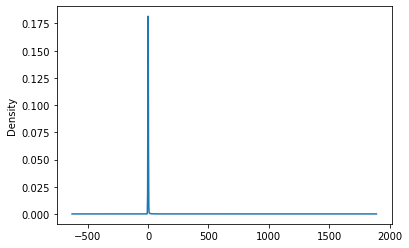

In [6]:
name_type_counts.plot.density()

In [7]:
# Determine which values to replace if counts are less than 300?
replace_name = list(name_type_counts[name_type_counts < 300].index)

# Replace in dataframe
for name in replace_name:
    app_df.NAME = app_df.NAME.replace(name,"Other")
    
# Check to make sure binning was successful
app_df.NAME.value_counts()

Other                                              29662
PARENT BOOSTER USA INC                              1260
TOPS CLUB INC                                        765
UNITED STATES BOWLING CONGRESS INC                   700
WASHINGTON STATE UNIVERSITY                          492
AMATEUR ATHLETIC UNION OF THE UNITED STATES INC      408
PTA TEXAS CONGRESS                                   368
SOROPTIMIST INTERNATIONAL OF THE AMERICAS INC        331
ALPHA PHI SIGMA                                      313
Name: NAME, dtype: int64

In [8]:
# Look at APPLICATION_TYPE value counts for binning
app_type_counts = app_df.APPLICATION_TYPE.value_counts()
app_type_counts

T3     27037
T4      1542
T6      1216
T5      1173
T19     1065
T8       737
T7       725
T10      528
T9       156
T13       66
T12       27
T2        16
T25        3
T14        3
T29        2
T15        2
T17        1
Name: APPLICATION_TYPE, dtype: int64

In [9]:
# Determine which values to replace if counts are less than 700?
replace_application = list(app_type_counts[app_type_counts < 700].index)

# Replace in dataframe
for app in replace_application:
    app_df.APPLICATION_TYPE = app_df.APPLICATION_TYPE.replace(app,"Other")
    
# Check to make sure binning was successful
app_df.APPLICATION_TYPE.value_counts()

T3       27037
T4        1542
T6        1216
T5        1173
T19       1065
Other      804
T8         737
T7         725
Name: APPLICATION_TYPE, dtype: int64

In [10]:
# Look at CLASSIFICATION value counts for binning
class_counts = app_df.CLASSIFICATION.value_counts()
class_counts

C1000    17326
C2000     6074
C1200     4837
C3000     1918
C2100     1883
         ...  
C4120        1
C8210        1
C2561        1
C4500        1
C2150        1
Name: CLASSIFICATION, Length: 71, dtype: int64

In [11]:
# Determine which values to replace if counts are less than 1883?
replace_class = list(class_counts[class_counts < 1883].index)

# Replace in dataframe
for cls in replace_class:
    app_df.CLASSIFICATION = app_df.CLASSIFICATION.replace(cls,"Other")
    
# Check to make sure binning was successful
app_df.CLASSIFICATION.value_counts()

C1000    17326
C2000     6074
C1200     4837
Other     2261
C3000     1918
C2100     1883
Name: CLASSIFICATION, dtype: int64

In [12]:
# Generate our categorical variable lists
app_cat = app_df.dtypes[app_df.dtypes == "object"].index.tolist()
app_cat

['NAME',
 'APPLICATION_TYPE',
 'AFFILIATION',
 'CLASSIFICATION',
 'USE_CASE',
 'ORGANIZATION',
 'INCOME_AMT',
 'SPECIAL_CONSIDERATIONS']

In [13]:
# Create a OneHotEncoder instance
enc = OneHotEncoder(sparse=False)

# Fit and transform the OneHotEncoder using the categorical variable list
encode_df = pd.DataFrame(enc.fit_transform(app_df[app_cat]))

# Add the encoded variable names to the dataframe
encode_df.columns = enc.get_feature_names(app_cat)
encode_df.head()

/Users/bmr209/opt/anaconda3/envs/ts2/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,NAME_ALPHA PHI SIGMA,NAME_AMATEUR ATHLETIC UNION OF THE UNITED STATES INC,NAME_Other,NAME_PARENT BOOSTER USA INC,NAME_PTA TEXAS CONGRESS,NAME_SOROPTIMIST INTERNATIONAL OF THE AMERICAS INC,NAME_TOPS CLUB INC,NAME_UNITED STATES BOWLING CONGRESS INC,NAME_WASHINGTON STATE UNIVERSITY,APPLICATION_TYPE_Other,...,INCOME_AMT_1-9999,INCOME_AMT_10000-24999,INCOME_AMT_100000-499999,INCOME_AMT_10M-50M,INCOME_AMT_1M-5M,INCOME_AMT_25000-99999,INCOME_AMT_50M+,INCOME_AMT_5M-10M,SPECIAL_CONSIDERATIONS_N,SPECIAL_CONSIDERATIONS_Y
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [14]:
# Merge one-hot encoded features and drop the originals
app_df = app_df.merge(encode_df, left_index=True, right_index=True)
app_df = app_df.drop(app_cat, 1)
app_df.head()

/Users/bmr209/opt/anaconda3/envs/ts2/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


,STATUS,ASK_AMT,IS_SUCCESSFUL,NAME_ALPHA PHI SIGMA,NAME_AMATEUR ATHLETIC UNION OF THE UNITED STATES INC,NAME_Other,NAME_PARENT BOOSTER USA INC,NAME_PTA TEXAS CONGRESS,NAME_SOROPTIMIST INTERNATIONAL OF THE AMERICAS INC,NAME_TOPS CLUB INC,...,INCOME_AMT_1-9999,INCOME_AMT_10000-24999,INCOME_AMT_100000-499999,INCOME_AMT_10M-50M,INCOME_AMT_1M-5M,INCOME_AMT_25000-99999,INCOME_AMT_50M+,INCOME_AMT_5M-10M,SPECIAL_CONSIDERATIONS_N,SPECIAL_CONSIDERATIONS_Y
0,1,5000,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1,108590,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,1,5000,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,1,6692,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,1,142590,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [15]:
# Split our preprocessed data into our features and target arrays
y = app_df["IS_SUCCESSFUL"].values
X = app_df.drop(["IS_SUCCESSFUL"], 1).values

# Split the preprocessed data into a training and testing dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

/Users/bmr209/opt/anaconda3/envs/ts2/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


In [16]:
# Create a StandardScaler instances
scaler = StandardScaler()

# Fit the StandardScaler
X_scaler = scaler.fit(X_train)

# Scale the data
X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)

In [17]:
# Define the model - deep neural net, i.e., the number of input features and hidden nodes for each layer.
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 50 
hidden_nodes_layer2 = 25
hidden_nodes_layer3 = 12

nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu"))

# Second hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))
nn.add(tf.keras.layers.Dropout(0.2))

# Third hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="relu"))
nn.add(tf.keras.layers.Dropout(0.2))

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 50)                2600      
_________________________________________________________________
dense_1 (Dense)              (None, 25)                1275      
_________________________________________________________________
dropout (Dropout)            (None, 25)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 12)                312       
_________________________________________________________________
dropout_1 (Dropout)          (None, 12)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 13        
Total params: 4,200
Trainable params: 4,200
Non-trainable params: 0
______________________________________________________

2022-06-15 16:28:46.829198: I tensorflow/core/platform/cpu_feature_guard.cc:145] This TensorFlow binary is optimized with Intel(R) MKL-DNN to use the following CPU instructions in performance critical operations:  SSE4.1 SSE4.2
To enable them in non-MKL-DNN operations, rebuild TensorFlow with the appropriate compiler flags.
2022-06-15 16:28:46.829908: I tensorflow/core/common_runtime/process_util.cc:115] Creating new thread pool with default inter op setting: 8. Tune using inter_op_parallelism_threads for best performance.


In [18]:
# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [19]:
# Train the model
import os
from tensorflow.keras.callbacks import ModelCheckpoint

os.makedirs("opt_checkpoints/", exist_ok=True)
checkpoint_path = "opt_checkpoints/weights.{epoch:02d}.hdf5"

cp_callback = ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_weights_only=True, save_freq=5)

fit_model = nn.fit(X_train_scaled, y_train, epochs=100, callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
   32/25724 [..............................] - ETA: 9:53 - loss: 0.7371 - accuracy: 0.4062
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
  256/25724 [..............................] - ETA: 1:18 - loss: 0.6969 - accuracy: 0.4492
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpo


Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
 3680/25724 [===>..........................] - ETA: 9s - loss: 0.6519 - accuracy: 0.5948
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
 3936/25724 [===>..........................] - ETA: 9s - loss: 0.6496 - accuracy: 0.6026
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi

 7104/25724 [=======>......................] - ETA: 6s - loss: 0.6207 - accuracy: 0.6474
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
 7328/25724 [=======>......................] - ETA: 6s - loss: 0.6198 - accuracy: 0.6482
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
 7520/25724 [=====


Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.6060 - accuracy: 0.6677
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6053 - accuracy: 0.6687
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi


Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.5942 - accuracy: 0.6829
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.5941 - accuracy: 0.6828
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi


Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.5871 - accuracy: 0.6923
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.5863 - accuracy: 0.6933
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi

21184/25724 [=======================>......] - ETA: 1s - loss: 0.5811 - accuracy: 0.6976
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.5807 - accuracy: 0.6979
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi


Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.5766 - accuracy: 0.7022
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5762 - accuracy: 0.7024
Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt_checkpoints/weights.01.hdf5

Epoch 00001: savi


Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 2592/25724 [==>...........................] - ETA: 5s - loss: 0.5533 - accuracy: 0.7110
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 2816/25724 [==>...........................] - ETA: 5s - loss: 0.5522 - accuracy: 0.7102
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi


Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 6208/25724 [======>.......................] - ETA: 4s - loss: 0.5451 - accuracy: 0.7208
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 6432/25724 [======>.......................] - ETA: 4s - loss: 0.5455 - accuracy: 0.7206
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi


Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 9664/25724 [==========>...................] - ETA: 3s - loss: 0.5447 - accuracy: 0.7258
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 0.5448 - accuracy: 0.7265
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi


Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
13152/25724 [==============>...............] - ETA: 2s - loss: 0.5398 - accuracy: 0.7282
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
13376/25724 [==============>...............] - ETA: 2s - loss: 0.5395 - accuracy: 0.7280
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi

16608/25724 [==================>...........] - ETA: 2s - loss: 0.5407 - accuracy: 0.7284
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.5407 - accuracy: 0.7283
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi


Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.5397 - accuracy: 0.7304
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.5395 - accuracy: 0.7305
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi

23648/25724 [==========================>...] - ETA: 0s - loss: 0.5390 - accuracy: 0.7307
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.5389 - accuracy: 0.7308
Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt_checkpoints/weights.02.hdf5

Epoch 00002: savi


Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 0.5101 - accuracy: 0.7557
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 1632/25724 [>.............................] - ETA: 5s - loss: 0.5123 - accuracy: 0.7500
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 4992/25724 [====>.........................] - ETA: 4s - loss: 0.5263 - accuracy: 0.7360
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 5216/25724 [=====>........................] - ETA: 4s - loss: 0.5268 - accuracy: 0.7356
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 8576/25724 [=========>....................] - ETA: 3s - loss: 0.5334 - accuracy: 0.7361
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
 8800/25724 [=========>....................] - ETA: 3s - loss: 0.5324 - accuracy: 0.7365
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi

12000/25724 [============>.................] - ETA: 3s - loss: 0.5323 - accuracy: 0.7398
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 0.5321 - accuracy: 0.7392
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 0.5304 - accuracy: 0.7400
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 0.5300 - accuracy: 0.7404
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi

19040/25724 [=====================>........] - ETA: 1s - loss: 0.5287 - accuracy: 0.7412
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 0.5289 - accuracy: 0.7407
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.5293 - accuracy: 0.7400
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.5299 - accuracy: 0.7394
Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.5344 - accuracy: 0.7266
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.5254 - accuracy: 0.7270
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi

 3808/25724 [===>..........................] - ETA: 5s - loss: 0.5338 - accuracy: 0.7369
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
 4032/25724 [===>..........................] - ETA: 5s - loss: 0.5332 - accuracy: 0.7374
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi


Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.5268 - accuracy: 0.7432
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5264 - accuracy: 0.7436
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi


Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
11040/25724 [===========>..................] - ETA: 3s - loss: 0.5254 - accuracy: 0.7437
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
11264/25724 [============>.................] - ETA: 3s - loss: 0.5268 - accuracy: 0.7434
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi


Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5278 - accuracy: 0.7442
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 0.5276 - accuracy: 0.7444
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi

18080/25724 [====================>.........] - ETA: 1s - loss: 0.5277 - accuracy: 0.7433
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 0.5273 - accuracy: 0.7433
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi

21600/25724 [========================>.....] - ETA: 0s - loss: 0.5272 - accuracy: 0.7423
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
21824/25724 [========================>.....] - ETA: 0s - loss: 0.5272 - accuracy: 0.7424
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi


Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 0.5288 - accuracy: 0.7395
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.5286 - accuracy: 0.7397
Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt_checkpoints/weights.04.hdf5

Epoch 00004: savi

 2816/25724 [==>...........................] - ETA: 5s - loss: 0.5195 - accuracy: 0.7482
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
 3040/25724 [==>...........................] - ETA: 5s - loss: 0.5190 - accuracy: 0.7487
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi

 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5185 - accuracy: 0.7489
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
 6528/25724 [======>.......................] - ETA: 4s - loss: 0.5178 - accuracy: 0.7498
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi


Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 0.5306 - accuracy: 0.7382
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
10208/25724 [==========>...................] - ETA: 3s - loss: 0.5309 - accuracy: 0.7380
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi

13408/25724 [==============>...............] - ETA: 2s - loss: 0.5307 - accuracy: 0.7371
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 0.5301 - accuracy: 0.7377
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi


Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.5270 - accuracy: 0.7407
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
17344/25724 [===================>..........] - ETA: 1s - loss: 0.5266 - accuracy: 0.7406
Epoch 00005: savi


Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.5271 - accuracy: 0.7402
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.5264 - accuracy: 0.7408
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi

24032/25724 [===========================>..] - ETA: 0s - loss: 0.5260 - accuracy: 0.7404
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5260 - accuracy: 0.7404
Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt_checkpoints/weights.05.hdf5

Epoch 00005: savi


Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.5265 - accuracy: 0.7484
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
 2048/25724 [=>............................] - ETA: 5s - loss: 0.5240 - accuracy: 0.7520
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: savi


Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
 5408/25724 [=====>........................] - ETA: 4s - loss: 0.5206 - accuracy: 0.7483
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 0.5194 - accuracy: 0.7496
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: savi

 8800/25724 [=========>....................] - ETA: 3s - loss: 0.5141 - accuracy: 0.7510
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
 9024/25724 [=========>....................] - ETA: 3s - loss: 0.5141 - accuracy: 0.7513
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: savi


Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5202 - accuracy: 0.7445
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.5196 - accuracy: 0.7450
Epoch 00006: savi

15808/25724 [=================>............] - ETA: 2s - loss: 0.5195 - accuracy: 0.7449
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.5193 - accuracy: 0.7451
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.5192 - accuracy: 0.7452
Epoch 00006: saving model to opt_checkpoints/weights.


Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5212 - accuracy: 0.7430
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5215 - accuracy: 0.7425
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: savi


Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.5233 - accuracy: 0.7411
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5237 - accuracy: 0.7408
Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt_checkpoints/weights.06.hdf5

Epoch 00006: savi

  704/25724 [..............................] - ETA: 5s - loss: 0.5274 - accuracy: 0.7472
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.5251 - accuracy: 0.7446
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
 4288/25724 [====>.........................] - ETA: 4s - loss: 0.5290 - accuracy: 0.7372
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
 4512/25724 [====>.........................] - ETA: 4s - loss: 0.5273 - accuracy: 0.7396
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.5213 - accuracy: 0.7453
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5206 - accuracy: 0.7459
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.5221 - accuracy: 0.7440
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
11680/25724 [============>.................] - ETA: 3s - loss: 0.5214 - accuracy: 0.7438
Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.5237 - accuracy: 0.7428
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.5244 - accuracy: 0.7427
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5267 - accuracy: 0.7399
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5271 - accuracy: 0.7394
Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 0.5257 - accuracy: 0.7397
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
22272/25724 [========================>.....] - ETA: 0s - loss: 0.5248 - accuracy: 0.7403
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: savi


Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.5246 - accuracy: 0.7402
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.5246 - accuracy: 0.7403
Epoch 00007: saving model to opt_checkpoints/weights.07.hdf5
25724/25724 [==============================] - 6s 231us/sample - loss: 0.5244 - accuracy: 0.7404
Epoch 8/100

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 0.4509 - accuracy: 0.8750
Epoch 


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
 3328/25724 [==>...........................] - ETA: 5s - loss: 0.5396 - accuracy: 0.7281
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
 3584/25724 [===>..........................]


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
 6848/25724 [======>.......................] - ETA: 4s - loss: 0.5213 - accuracy: 0.7385
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
 7072/25724 [=======>......................] - ETA: 4s - loss: 0.5230 - accuracy: 0.7377
Epoch 00008: savi


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
10272/25724 [==========>...................] - ETA: 3s - loss: 0.5198 - accuracy: 0.7427
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 0.5200 - accuracy: 0.7424
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: savi


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.5196 - accuracy: 0.7436
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 0.5199 - accuracy: 0.7440
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: savi


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5218 - accuracy: 0.7437
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.5217 - accuracy: 0.7439
Epoch 00008: savi


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.5193 - accuracy: 0.7457
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.5196 - accuracy: 0.7456
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: savi


Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5232 - accuracy: 0.7430
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.5228 - accuracy: 0.7434
Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt_checkpoints/weights.08.hdf5

Epoch 00008: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 2304/25724 [=>............................] - ETA: 5s - loss: 0.5002 - accuracy: 0.7656
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 2528/25724 [=>............................] - ETA: 5s - loss: 0.5000 - accuracy: 0.7650
Epoch 00009: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 5760/25724 [=====>........................] - ETA: 4s - loss: 0.5075 - accuracy: 0.7535
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 6016/25724 [======>.......................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7523
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 9312/25724 [=========>....................] - ETA: 3s - loss: 0.5120 - accuracy: 0.7518
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5110 - accuracy: 0.7531
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
12896/25724 [==============>...............] - ETA: 2s - loss: 0.5186 - accuracy: 0.7467
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
13120/25724 [==============>...............] - ETA: 2s - loss: 0.5180 - accuracy: 0.7471
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi

16256/25724 [=================>............] - ETA: 2s - loss: 0.5182 - accuracy: 0.7462
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.5183 - accuracy: 0.7462
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.5197 - accuracy: 0.7449
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.5195 - accuracy: 0.7446
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi


Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.5219 - accuracy: 0.7425
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.5222 - accuracy: 0.7423
Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt_checkpoints/weights.09.hdf5

Epoch 00009: savi


Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 1184/25724 [>.............................] - ETA: 5s - loss: 0.5429 - accuracy: 0.7086
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 0.5361 - accuracy: 0.7195
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi


Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 4608/25724 [====>.........................] - ETA: 4s - loss: 0.5305 - accuracy: 0.7368
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 4832/25724 [====>.........................] - ETA: 4s - loss: 0.5291 - accuracy: 0.7380
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 4992/25724 [====>


Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 8128/25724 [========>.....................] - ETA: 4s - loss: 0.5260 - accuracy: 0.7378
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.5242 - accuracy: 0.7386
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi


Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
11712/25724 [============>.................] - ETA: 3s - loss: 0.5195 - accuracy: 0.7440
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
11968/25724 [============>.................] - ETA: 3s - loss: 0.5186 - accuracy: 0.7447
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi

15168/25724 [================>.............] - ETA: 2s - loss: 0.5201 - accuracy: 0.7435
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
15392/25724 [================>.............] - ETA: 2s - loss: 0.5194 - accuracy: 0.7437
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi


Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
18784/25724 [====================>.........] - ETA: 1s - loss: 0.5181 - accuracy: 0.7446
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
19008/25724 [=====================>........] - ETA: 1s - loss: 0.5182 - accuracy: 0.7447
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi

22240/25724 [========================>.....] - ETA: 0s - loss: 0.5191 - accuracy: 0.7440
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.5192 - accuracy: 0.7441
Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt_checkpoints/weights.10.hdf5

Epoch 00010: savi

Epoch 11/100

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 0.4488 - accuracy: 0.7812
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.5560 - accuracy: 0.6836
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
 3616/25724 [===>..........................] - ETA: 5s - loss: 0.5187 - accuracy: 0.7450
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5190 - accuracy: 0.7456
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
 7168/25724 [=======>......................] - ETA: 4s - loss: 0.5158 - accuracy: 0.7478
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
 7392/25724 [=======>......................] - ETA: 4s - loss: 0.5139 - accuracy: 0.7493
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
10752/25724 [===========>..................] - ETA: 3s - loss: 0.5148 - accuracy: 0.7494
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 0.5165 - accuracy: 0.7478
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi

14144/25724 [===============>..............] - ETA: 2s - loss: 0.5164 - accuracy: 0.7476
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.5166 - accuracy: 0.7476
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
17792/25724 [===================>..........] - ETA: 1s - loss: 0.5198 - accuracy: 0.7459
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
18016/25724 [====================>.........] - ETA: 1s - loss: 0.5193 - accuracy: 0.7464
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5185 - accuracy: 0.7474
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
21600/25724 [========================>.....] - ETA: 0s - loss: 0.5188 - accuracy: 0.7470
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi


Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.5203 - accuracy: 0.7458
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5208 - accuracy: 0.7454
Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt_checkpoints/weights.11.hdf5

Epoch 00011: savi

 2496/25724 [=>............................] - ETA: 5s - loss: 0.5237 - accuracy: 0.7424
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.5295 - accuracy: 0.7426
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi

 6016/25724 [======>.......................] - ETA: 4s - loss: 0.5196 - accuracy: 0.7467
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
 6240/25724 [======>.......................] - ETA: 4s - loss: 0.5216 - accuracy: 0.7449
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi


Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
 9696/25724 [==========>...................] - ETA: 3s - loss: 0.5213 - accuracy: 0.7436
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
 9920/25724 [==========>...................] - ETA: 3s - loss: 0.5210 - accuracy: 0.7436
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi

13056/25724 [==============>...............] - ETA: 2s - loss: 0.5235 - accuracy: 0.7432
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
13280/25724 [==============>...............] - ETA: 2s - loss: 0.5229 - accuracy: 0.7436
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi


Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
16608/25724 [==================>...........] - ETA: 2s - loss: 0.5266 - accuracy: 0.7406
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.5270 - accuracy: 0.7400
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi


Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.5234 - accuracy: 0.7412
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.5233 - accuracy: 0.7414
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: savi


Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5218 - accuracy: 0.7416
Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt_checkpoints/weights.12.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5213 - accuracy: 0.7421
Epoch 00012: savi


Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
 1504/25724 [>.............................] - ETA: 6s - loss: 0.5247 - accuracy: 0.7367
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
 1728/25724 [=>............................] - ETA: 5s - loss: 0.5223 - accuracy: 0.7373
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi

 4992/25724 [====>.........................] - ETA: 4s - loss: 0.5154 - accuracy: 0.7440
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
 5216/25724 [=====>........................] - ETA: 4s - loss: 0.5163 - accuracy: 0.7425
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi


Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
 8576/25724 [=========>....................] - ETA: 3s - loss: 0.5247 - accuracy: 0.7348
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
 8800/25724 [=========>....................] - ETA: 3s - loss: 0.5249 - accuracy: 0.7351
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi


Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
12192/25724 [=============>................] - ETA: 3s - loss: 0.5226 - accuracy: 0.7377
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
12416/25724 [=============>................] - ETA: 3s - loss: 0.5222 - accuracy: 0.7390
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi


Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 0.5193 - accuracy: 0.7411
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.5200 - accuracy: 0.7411
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi


Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 0.5193 - accuracy: 0.7429
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.5189 - accuracy: 0.7430
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi

22656/25724 [=========================>....] - ETA: 0s - loss: 0.5202 - accuracy: 0.7417
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 0.5201 - accuracy: 0.7417
Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt_checkpoints/weights.13.hdf5

Epoch 00013: savi


Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5338 - accuracy: 0.7479
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.5446 - accuracy: 0.7386
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi


Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5244 - accuracy: 0.7446
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
 4320/25724 [====>.........................] - ETA: 4s - loss: 0.5232 - accuracy: 0.7468
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

 7456/25724 [=======>......................] - ETA: 4s - loss: 0.5203 - accuracy: 0.7441
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.5195 - accuracy: 0.7454
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

10976/25724 [===========>..................] - ETA: 3s - loss: 0.5164 - accuracy: 0.7455
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 0.5164 - accuracy: 0.7448
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

14464/25724 [===============>..............] - ETA: 2s - loss: 0.5183 - accuracy: 0.7450
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5181 - accuracy: 0.7448
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

17952/25724 [===================>..........] - ETA: 1s - loss: 0.5209 - accuracy: 0.7427
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
18176/25724 [====================>.........] - ETA: 1s - loss: 0.5210 - accuracy: 0.7429
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

21472/25724 [========================>.....] - ETA: 1s - loss: 0.5211 - accuracy: 0.7426
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
21696/25724 [========================>.....] - ETA: 0s - loss: 0.5206 - accuracy: 0.7432
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi


Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5194 - accuracy: 0.7440
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5191 - accuracy: 0.7444
Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt_checkpoints/weights.14.hdf5

Epoch 00014: savi

 2720/25724 [==>...........................] - ETA: 5s - loss: 0.5168 - accuracy: 0.7437
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5154 - accuracy: 0.7446
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi

 6208/25724 [======>.......................] - ETA: 4s - loss: 0.5132 - accuracy: 0.7502
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
 6432/25724 [======>.......................] - ETA: 4s - loss: 0.5134 - accuracy: 0.7500
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi


Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
 9792/25724 [==========>...................] - ETA: 3s - loss: 0.5130 - accuracy: 0.7516
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
10016/25724 [==========>...................] - ETA: 3s - loss: 0.5127 - accuracy: 0.7522
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi


Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
13408/25724 [==============>...............] - ETA: 2s - loss: 0.5150 - accuracy: 0.7468
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 0.5149 - accuracy: 0.7474
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi

16832/25724 [==================>...........] - ETA: 2s - loss: 0.5157 - accuracy: 0.7469
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.5158 - accuracy: 0.7471
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi


Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.5184 - accuracy: 0.7444
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5180 - accuracy: 0.7447
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi


Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5184 - accuracy: 0.7446
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5192 - accuracy: 0.7441
Epoch 00015: saving model to opt_checkpoints/weights.15.hdf5

Epoch 00015: savi

 1600/25724 [>.............................] - ETA: 5s - loss: 0.5129 - accuracy: 0.7487
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.5161 - accuracy: 0.7456
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi


Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
 5280/25724 [=====>........................] - ETA: 4s - loss: 0.5148 - accuracy: 0.7449
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
 5504/25724 [=====>........................] - ETA: 4s - loss: 0.5166 - accuracy: 0.7429
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi


Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
 8736/25724 [=========>....................] - ETA: 4s - loss: 0.5166 - accuracy: 0.7465
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
 8960/25724 [=========>....................] - ETA: 3s - loss: 0.5177 - accuracy: 0.7455
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi


Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
12320/25724 [=============>................] - ETA: 3s - loss: 0.5179 - accuracy: 0.7455
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 0.5188 - accuracy: 0.7450
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi


Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.5192 - accuracy: 0.7439
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.5194 - accuracy: 0.7440
Epoch 00016: savi

19264/25724 [=====================>........] - ETA: 1s - loss: 0.5177 - accuracy: 0.7439
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.5174 - accuracy: 0.7442
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi

22784/25724 [=========================>....] - ETA: 0s - loss: 0.5199 - accuracy: 0.7438
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.5196 - accuracy: 0.7438
Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt_checkpoints/weights.16.hdf5

Epoch 00016: savi

  480/25724 [..............................] - ETA: 5s - loss: 0.5680 - accuracy: 0.7167
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.5341 - accuracy: 0.7457
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5169 - accuracy: 0.7485
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
 4288/25724 [====>.........................] - ETA: 4s - loss: 0.5167 - accuracy: 0.7481
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5216 - accuracy: 0.7438
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.5210 - accuracy: 0.7441
Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 0.5209 - accuracy: 0.7417
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
11360/25724 [============>.................] - ETA: 3s - loss: 0.5211 - accuracy: 0.7415
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
14624/25724 [================>.............] - ETA: 2s - loss: 0.5207 - accuracy: 0.7413
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
14848/25724 [================>.............] - ETA: 2s - loss: 0.5206 - accuracy: 0.7416
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
18208/25724 [====================>.........] - ETA: 1s - loss: 0.5212 - accuracy: 0.7419
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 0.5208 - accuracy: 0.7424
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
21696/25724 [========================>.....] - ETA: 0s - loss: 0.5220 - accuracy: 0.7423
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
21920/25724 [========================>.....] - ETA: 0s - loss: 0.5220 - accuracy: 0.7422
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi


Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.5202 - accuracy: 0.7448
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5197 - accuracy: 0.7454
Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt_checkpoints/weights.17.hdf5

Epoch 00017: savi

 2976/25724 [==>...........................] - ETA: 5s - loss: 0.5131 - accuracy: 0.7540
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
 3200/25724 [==>...........................] - ETA: 5s - loss: 0.5119 - accuracy: 0.7534
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi

 6496/25724 [======>.......................] - ETA: 4s - loss: 0.5114 - accuracy: 0.7491
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
 6720/25724 [======>.......................] - ETA: 4s - loss: 0.5131 - accuracy: 0.7476
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi


Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 0.5189 - accuracy: 0.7418
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
10336/25724 [===========>..................] - ETA: 3s - loss: 0.5190 - accuracy: 0.7415
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi


Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 0.5213 - accuracy: 0.7411
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.5215 - accuracy: 0.7407
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi


Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
17248/25724 [===================>..........] - ETA: 1s - loss: 0.5213 - accuracy: 0.7403
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5204 - accuracy: 0.7411
Epoch 00018: savi


Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5194 - accuracy: 0.7427
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.5191 - accuracy: 0.7429
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi


Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5182 - accuracy: 0.7440
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5186 - accuracy: 0.7437
Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt_checkpoints/weights.18.hdf5

Epoch 00018: savi


Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
 2080/25724 [=>............................] - ETA: 5s - loss: 0.5112 - accuracy: 0.7563
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
 2304/25724 [=>............................] - ETA: 5s - loss: 0.5117 - accuracy: 0.7587
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi

 5440/25724 [=====>........................] - ETA: 4s - loss: 0.5167 - accuracy: 0.7513
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
 5664/25724 [=====>........................] - ETA: 4s - loss: 0.5135 - accuracy: 0.7530
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi


Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
 9120/25724 [=========>....................] - ETA: 3s - loss: 0.5134 - accuracy: 0.7520
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
 9344/25724 [=========>....................] - ETA: 3s - loss: 0.5133 - accuracy: 0.7511
Epoch 00019: savi

12448/25724 [=============>................] - ETA: 3s - loss: 0.5144 - accuracy: 0.7478
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
12672/25724 [=============>................] - ETA: 3s - loss: 0.5137 - accuracy: 0.7480
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi


Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.5187 - accuracy: 0.7441
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5188 - accuracy: 0.7438
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi


Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
19616/25724 [=====================>........] - ETA: 1s - loss: 0.5192 - accuracy: 0.7446
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.5189 - accuracy: 0.7449
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi


Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.5181 - accuracy: 0.7455
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.5175 - accuracy: 0.7461
Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt_checkpoints/weights.19.hdf5

Epoch 00019: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.5320 - accuracy: 0.7338
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.5297 - accuracy: 0.7318
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
 4512/25724 [====>.........................] - ETA: 4s - loss: 0.5217 - accuracy: 0.7425
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
 4736/25724 [====>.........................] - ETA: 4s - loss: 0.5237 - accuracy: 0.7416
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5211 - accuracy: 0.7423
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
 8320/25724 [========>.....................] - ETA: 4s - loss: 0.5212 - accuracy: 0.7418
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 0.5233 - accuracy: 0.7405
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5236 - accuracy: 0.7405
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.5215 - accuracy: 0.7430
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.5218 - accuracy: 0.7425
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 0.5192 - accuracy: 0.7443
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.5193 - accuracy: 0.7440
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
22272/25724 [========================>.....] - ETA: 0s - loss: 0.5181 - accuracy: 0.7454
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.5178 - accuracy: 0.7455
Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: savi


Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt_checkpoints/weights.20.hdf5
25724/25724 [==============================] - 6s 237us/sample - loss: 0.5181 - accuracy: 0.7454
Epoch 21/100

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.6800 - accuracy: 0.7188
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.5328 - accuracy: 0.7500
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to op


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
 3552/25724 [===>..........................] - ETA: 5s - loss: 0.5255 - accuracy: 0.7435
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
 3776/25724 [===>..........................] - ETA: 5s - loss: 0.5235 - accuracy: 0.7452
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
 7072/25724 [=======>......................] - ETA: 4s - loss: 0.5223 - accuracy: 0.7445
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 0.5218 - accuracy: 0.7455
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi

10464/25724 [===========>..................] - ETA: 3s - loss: 0.5220 - accuracy: 0.7439
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
10688/25724 [===========>..................] - ETA: 3s - loss: 0.5220 - accuracy: 0.7436
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
14048/25724 [===============>..............] - ETA: 2s - loss: 0.5191 - accuracy: 0.7455
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
14272/25724 [===============>..............] - ETA: 2s - loss: 0.5194 - accuracy: 0.7450
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
17600/25724 [===================>..........] - ETA: 1s - loss: 0.5188 - accuracy: 0.7472
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
17824/25724 [===================>..........] - ETA: 1s - loss: 0.5180 - accuracy: 0.7476
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.5174 - accuracy: 0.7464
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 0.5172 - accuracy: 0.7466
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi


Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5171 - accuracy: 0.7451
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.5169 - accuracy: 0.7453
Epoch 00021: saving model to opt_checkpoints/weights.21.hdf5

Epoch 00021: savi

 2304/25724 [=>............................] - ETA: 5s - loss: 0.5140 - accuracy: 0.7378
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
 2528/25724 [=>............................] - ETA: 5s - loss: 0.5162 - accuracy: 0.7377
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi


Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
 5888/25724 [=====>........................] - ETA: 4s - loss: 0.5151 - accuracy: 0.7420
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
 6112/25724 [======>.......................] - ETA: 4s - loss: 0.5147 - accuracy: 0.7413
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi


Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
 9472/25724 [==========>...................] - ETA: 3s - loss: 0.5171 - accuracy: 0.7401
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
 9696/25724 [==========>...................] - ETA: 3s - loss: 0.5157 - accuracy: 0.7411
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi

12896/25724 [==============>...............] - ETA: 3s - loss: 0.5143 - accuracy: 0.7424
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
13088/25724 [==============>...............] - ETA: 3s - loss: 0.5140 - accuracy: 0.7427
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
13312/25724 [=====


Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.5180 - accuracy: 0.7409
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.5182 - accuracy: 0.7408
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi


Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.5180 - accuracy: 0.7419
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.5182 - accuracy: 0.7424
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi

23456/25724 [==========================>...] - ETA: 0s - loss: 0.5171 - accuracy: 0.7430
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.5170 - accuracy: 0.7431
Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt_checkpoints/weights.22.hdf5

Epoch 00022: savi

 1184/25724 [>.............................] - ETA: 5s - loss: 0.5080 - accuracy: 0.7584
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 0.5083 - accuracy: 0.7564
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi

 4672/25724 [====>.........................] - ETA: 5s - loss: 0.5258 - accuracy: 0.7429
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
 4896/25724 [====>.........................] - ETA: 5s - loss: 0.5241 - accuracy: 0.7439
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi


Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.5218 - accuracy: 0.7420
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.5201 - accuracy: 0.7436
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi


Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5171 - accuracy: 0.7468
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 0.5166 - accuracy: 0.7473
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi


Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 0.5161 - accuracy: 0.7485
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
15680/25724 [=================>............] - ETA: 2s - loss: 0.5171 - accuracy: 0.7478
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi

18816/25724 [====================>.........] - ETA: 1s - loss: 0.5164 - accuracy: 0.7465
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.5173 - accuracy: 0.7464
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi


Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.5167 - accuracy: 0.7466
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 0.5171 - accuracy: 0.7464
Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt_checkpoints/weights.23.hdf5

Epoch 00023: savi

   32/25724 [..............................] - ETA: 6s - loss: 0.4284 - accuracy: 0.8438
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.4857 - accuracy: 0.7695
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
 3712/25724 [===>..........................] - ETA: 5s - loss: 0.5061 - accuracy: 0.7497
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.5065 - accuracy: 0.7503
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi

 7104/25724 [=======>......................] - ETA: 4s - loss: 0.5083 - accuracy: 0.7477
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
 7328/25724 [=======>......................] - ETA: 4s - loss: 0.5083 - accuracy: 0.7477
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi

10592/25724 [===========>..................] - ETA: 3s - loss: 0.5115 - accuracy: 0.7471
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
10816/25724 [===========>..................] - ETA: 3s - loss: 0.5123 - accuracy: 0.7459
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
14208/25724 [===============>..............] - ETA: 2s - loss: 0.5148 - accuracy: 0.7468
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
14432/25724 [===============>..............] - ETA: 2s - loss: 0.5155 - accuracy: 0.7461
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
17664/25724 [===================>..........] - ETA: 1s - loss: 0.5176 - accuracy: 0.7446
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
17888/25724 [===================>..........] - ETA: 1s - loss: 0.5181 - accuracy: 0.7443
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5168 - accuracy: 0.7452
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.5171 - accuracy: 0.7448
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.5172 - accuracy: 0.7448
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5170 - accuracy: 0.7449
Epoch 00024: saving model to opt_checkpoints/weights.24.hdf5

Epoch 00024: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 2592/25724 [==>...........................] - ETA: 6s - loss: 0.5257 - accuracy: 0.7431
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 2816/25724 [==>...........................] - ETA: 6s - loss: 0.5277 - accuracy: 0.7397
Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 6016/25724 [======>.......................] - ETA: 4s - loss: 0.5251 - accuracy: 0.7392
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 6240/25724 [======>.......................] - ETA: 4s - loss: 0.5250 - accuracy: 0.7389
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5208 - accuracy: 0.7434
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
 9760/25724 [==========>...................] - ETA: 3s - loss: 0.5196 - accuracy: 0.7437
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
13088/25724 [==============>...............] - ETA: 3s - loss: 0.5175 - accuracy: 0.7448
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
13312/25724 [==============>...............] - ETA: 3s - loss: 0.5185 - accuracy: 0.7441
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.5160 - accuracy: 0.7463
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.5163 - accuracy: 0.7457
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.5153 - accuracy: 0.7449
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 0.5151 - accuracy: 0.7449
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi


Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.5160 - accuracy: 0.7450
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.5159 - accuracy: 0.7450
Epoch 00025: saving model to opt_checkpoints/weights.25.hdf5

Epoch 00025: savi

 1312/25724 [>.............................] - ETA: 6s - loss: 0.5098 - accuracy: 0.7439
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
 1536/25724 [>.............................] - ETA: 6s - loss: 0.5154 - accuracy: 0.7448
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi


Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
 4896/25724 [====>.........................] - ETA: 4s - loss: 0.5140 - accuracy: 0.7490
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
 5120/25724 [====>.........................] - ETA: 4s - loss: 0.5161 - accuracy: 0.7484
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi


Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.5157 - accuracy: 0.7482
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 0.5158 - accuracy: 0.7475
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi


Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
12000/25724 [============>.................] - ETA: 3s - loss: 0.5172 - accuracy: 0.7464
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 0.5161 - accuracy: 0.7473
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi

15392/25724 [================>.............] - ETA: 2s - loss: 0.5153 - accuracy: 0.7473
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 0.5156 - accuracy: 0.7467
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi


Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 0.5165 - accuracy: 0.7458
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.5167 - accuracy: 0.7456
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi


Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.5172 - accuracy: 0.7465
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.5166 - accuracy: 0.7471
Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt_checkpoints/weights.26.hdf5

Epoch 00026: savi

  256/25724 [..............................] - ETA: 6s - loss: 0.5029 - accuracy: 0.7812
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5083 - accuracy: 0.7750
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5168 - accuracy: 0.7487
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5143 - accuracy: 0.7510
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
 7392/25724 [=======>......................] - ETA: 4s - loss: 0.5201 - accuracy: 0.7432
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
 7616/25724 [=======>......................] - ETA: 4s - loss: 0.5212 - accuracy: 0.7426
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 0.5195 - accuracy: 0.7437
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 0.5190 - accuracy: 0.7443
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
14432/25724 [===============>..............] - ETA: 2s - loss: 0.5210 - accuracy: 0.7429
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
14624/25724 [================>.............] - ETA: 2s - loss: 0.5205 - accuracy: 0.7434
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
18016/25724 [====================>.........] - ETA: 1s - loss: 0.5201 - accuracy: 0.7439
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.5202 - accuracy: 0.7437
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
21664/25724 [========================>.....] - ETA: 0s - loss: 0.5175 - accuracy: 0.7467
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
21888/25724 [========================>.....] - ETA: 0s - loss: 0.5171 - accuracy: 0.7470
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: savi


Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5165 - accuracy: 0.7468
Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt_checkpoints/weights.27.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.5162 - accuracy: 0.7473
Epoch 00027: savi


Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5223 - accuracy: 0.7422
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5222 - accuracy: 0.7412
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi

 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5257 - accuracy: 0.7397
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
 6528/25724 [======>.......................] - ETA: 4s - loss: 0.5269 - accuracy: 0.7391
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi


Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 0.5150 - accuracy: 0.7481
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 0.5152 - accuracy: 0.7486
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi


Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
13472/25724 [==============>...............] - ETA: 2s - loss: 0.5147 - accuracy: 0.7474
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 0.5143 - accuracy: 0.7478
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi


Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.5138 - accuracy: 0.7495
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
17280/25724 [===================>..........] - ETA: 1s - loss: 0.5134 - accuracy: 0.7497
Epoch 00028: savi

20416/25724 [======================>.......] - ETA: 1s - loss: 0.5153 - accuracy: 0.7476
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.5154 - accuracy: 0.7477
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi


Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5154 - accuracy: 0.7465
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5153 - accuracy: 0.7467
Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt_checkpoints/weights.28.hdf5

Epoch 00028: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
 1856/25724 [=>............................] - ETA: 5s - loss: 0.5217 - accuracy: 0.7414
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
 2080/25724 [=>............................] - ETA: 5s - loss: 0.5216 - accuracy: 0.7418
Epoch 00029: savi

 5216/25724 [=====>........................] - ETA: 4s - loss: 0.5151 - accuracy: 0.7406
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
 5440/25724 [=====>........................] - ETA: 4s - loss: 0.5149 - accuracy: 0.7408
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
 8800/25724 [=========>....................] - ETA: 3s - loss: 0.5155 - accuracy: 0.7443
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
 9024/25724 [=========>....................] - ETA: 3s - loss: 0.5153 - accuracy: 0.7449
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.5118 - accuracy: 0.7481
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.5128 - accuracy: 0.7471
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.5146 - accuracy: 0.7465
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.5148 - accuracy: 0.7462
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5175 - accuracy: 0.7441
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5171 - accuracy: 0.7443
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.5161 - accuracy: 0.7455
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.5155 - accuracy: 0.7461
Epoch 00029: saving model to opt_checkpoints/weights.29.hdf5

Epoch 00029: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.5001 - accuracy: 0.7457
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.4993 - accuracy: 0.7478
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.5096 - accuracy: 0.7549
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
 4512/25724 [====>.........................] - ETA: 4s - loss: 0.5100 - accuracy: 0.7535
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.5083 - accuracy: 0.7524
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
 8000/25724 [========>.....................] - ETA: 4s - loss: 0.5092 - accuracy: 0.7523
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi

11232/25724 [============>.................] - ETA: 3s - loss: 0.5113 - accuracy: 0.7522
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.5119 - accuracy: 0.7515
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
14816/25724 [================>.............] - ETA: 2s - loss: 0.5144 - accuracy: 0.7493
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5143 - accuracy: 0.7493
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 0.5169 - accuracy: 0.7477
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.5167 - accuracy: 0.7480
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
21984/25724 [========================>.....] - ETA: 0s - loss: 0.5160 - accuracy: 0.7467
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.5160 - accuracy: 0.7468
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: savi


Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.5168 - accuracy: 0.7462
Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt_checkpoints/weights.30.hdf5
25724/25724 [==============================] - 6s 237us/sample - loss: 0.5170 - accuracy: 0.7460
Epoch 31/100

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.4216 - accuracy: 0.7812
Epoch 00031: saving model to op

 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5121 - accuracy: 0.7497
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5117 - accuracy: 0.7512
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi


Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
 6752/25724 [======>.......................] - ETA: 4s - loss: 0.5094 - accuracy: 0.7494
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
 6976/25724 [=======>......................] - ETA: 4s - loss: 0.5095 - accuracy: 0.7494
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi


Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
10336/25724 [===========>..................] - ETA: 3s - loss: 0.5116 - accuracy: 0.7476
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 0.5109 - accuracy: 0.7481
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi


Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.5160 - accuracy: 0.7450
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 0.5160 - accuracy: 0.7450
Epoch 00031: savi

17280/25724 [===================>..........] - ETA: 2s - loss: 0.5162 - accuracy: 0.7447
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5167 - accuracy: 0.7446
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi

20800/25724 [=======================>......] - ETA: 1s - loss: 0.5160 - accuracy: 0.7445
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.5161 - accuracy: 0.7445
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi


Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.5144 - accuracy: 0.7459
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.5144 - accuracy: 0.7460
Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt_checkpoints/weights.31.hdf5

Epoch 00031: savi


Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
 2208/25724 [=>............................] - ETA: 5s - loss: 0.5093 - accuracy: 0.7437
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
 2432/25724 [=>............................] - ETA: 5s - loss: 0.5105 - accuracy: 0.7451
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi

 5568/25724 [=====>........................] - ETA: 4s - loss: 0.5104 - accuracy: 0.7473
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
 5792/25724 [=====>........................] - ETA: 4s - loss: 0.5097 - accuracy: 0.7484
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi


Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
 9152/25724 [=========>....................] - ETA: 3s - loss: 0.5149 - accuracy: 0.7457
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 0.5159 - accuracy: 0.7446
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi


Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.5126 - accuracy: 0.7498
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.5117 - accuracy: 0.7505
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi


Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.5138 - accuracy: 0.7493
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.5144 - accuracy: 0.7488
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi

19680/25724 [=====================>........] - ETA: 1s - loss: 0.5152 - accuracy: 0.7480
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.5150 - accuracy: 0.7483
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi


Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.5166 - accuracy: 0.7478
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.5167 - accuracy: 0.7473
Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt_checkpoints/weights.32.hdf5

Epoch 00032: savi

  928/25724 [>.............................] - ETA: 5s - loss: 0.5038 - accuracy: 0.7629
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.5090 - accuracy: 0.7561
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi

 4448/25724 [====>.........................] - ETA: 5s - loss: 0.5178 - accuracy: 0.7473
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
 4672/25724 [====>.........................] - ETA: 4s - loss: 0.5169 - accuracy: 0.7481
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi


Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
 8032/25724 [========>.....................] - ETA: 4s - loss: 0.5185 - accuracy: 0.7468
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.5193 - accuracy: 0.7466
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi


Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 0.5180 - accuracy: 0.7464
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5180 - accuracy: 0.7459
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi


Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5182 - accuracy: 0.7457
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
15232/25724 [================>.............] - ETA: 2s - loss: 0.5178 - accuracy: 0.7459
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi


Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5176 - accuracy: 0.7472
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5172 - accuracy: 0.7477
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: savi

21952/25724 [========================>.....] - ETA: 0s - loss: 0.5160 - accuracy: 0.7482
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 0.5159 - accuracy: 0.7482
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
22368/25724 [=====


Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.5161 - accuracy: 0.7478
Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt_checkpoints/weights.33.hdf5
25724/25724 [==============================] - 6s 252us/sample - loss: 0.5161 - accuracy: 0.7479
Epoch 34/100

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.5622 - accuracy: 0.6875
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to op

 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5097 - accuracy: 0.7582
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5116 - accuracy: 0.7574
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: savi


Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.5149 - accuracy: 0.7513
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
 6976/25724 [=======>......................] - ETA: 5s - loss: 0.5157 - accuracy: 0.7507
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: savi


Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 0.5133 - accuracy: 0.7503
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.5141 - accuracy: 0.7495
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: savi


Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
13856/25724 [===============>..............] - ETA: 3s - loss: 0.5151 - accuracy: 0.7478
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
14080/25724 [===============>..............] - ETA: 2s - loss: 0.5142 - accuracy: 0.7479
Epoch 00034: savi

17216/25724 [===================>..........] - ETA: 2s - loss: 0.5143 - accuracy: 0.7470
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.5155 - accuracy: 0.7463
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: savi


Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.5146 - accuracy: 0.7476
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.5145 - accuracy: 0.7478
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.5146 - accuracy: 0.7478
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.


Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.5129 - accuracy: 0.7479
Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt_checkpoints/weights.34.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5132 - accuracy: 0.7477
Epoch 00034: savi


Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 2048/25724 [=>............................] - ETA: 5s - loss: 0.4950 - accuracy: 0.7563
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 2272/25724 [=>............................] - ETA: 5s - loss: 0.4959 - accuracy: 0.7562
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: savi


Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 5600/25724 [=====>........................] - ETA: 4s - loss: 0.5040 - accuracy: 0.7582
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 5824/25724 [=====>........................] - ETA: 4s - loss: 0.5066 - accuracy: 0.7564
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: savi


Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 9184/25724 [=========>....................] - ETA: 3s - loss: 0.5113 - accuracy: 0.7528
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 0.5126 - accuracy: 0.7518
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: savi


Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.5139 - accuracy: 0.7505
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.5143 - accuracy: 0.7503
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: savi


Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.5170 - accuracy: 0.7466
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.5166 - accuracy: 0.7467
Epoch 00035: savi

19648/25724 [=====================>........] - ETA: 1s - loss: 0.5161 - accuracy: 0.7479
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.5163 - accuracy: 0.7478
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5167 - accuracy: 0.7472
Epoch 00035: saving model to opt_checkpoints/weights.

23136/25724 [=========================>....] - ETA: 0s - loss: 0.5153 - accuracy: 0.7469
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.5154 - accuracy: 0.7466
Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt_checkpoints/weights.35.hdf5

Epoch 00035: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.4772 - accuracy: 0.7705
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.4943 - accuracy: 0.7526
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
 4416/25724 [====>.........................] - ETA: 5s - loss: 0.4979 - accuracy: 0.7552
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.4998 - accuracy: 0.7526
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
 8000/25724 [========>.....................] - ETA: 4s - loss: 0.5030 - accuracy: 0.7523
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
 8224/25724 [========>.....................] - ETA: 4s - loss: 0.5018 - accuracy: 0.7528
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 0.5076 - accuracy: 0.7492
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
11808/25724 [============>.................] - ETA: 3s - loss: 0.5074 - accuracy: 0.7502
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi

14944/25724 [================>.............] - ETA: 2s - loss: 0.5102 - accuracy: 0.7490
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
15168/25724 [================>.............] - ETA: 2s - loss: 0.5107 - accuracy: 0.7484
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5116 - accuracy: 0.7501
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5122 - accuracy: 0.7499
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
22112/25724 [========================>.....] - ETA: 0s - loss: 0.5145 - accuracy: 0.7477
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 0.5144 - accuracy: 0.7479
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: savi


Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.5156 - accuracy: 0.7469
Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt_checkpoints/weights.36.hdf5
25724/25724 [==============================] - 6s 239us/sample - loss: 0.5157 - accuracy: 0.7468
Epoch 37/100

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.4743 - accuracy: 0.8750
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to op


Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5111 - accuracy: 0.7556
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
 3616/25724 [===>..........................] - ETA: 5s - loss: 0.5100 - accuracy: 0.7539
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi

 6784/25724 [======>.......................] - ETA: 4s - loss: 0.5092 - accuracy: 0.7513
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
 7008/25724 [=======>......................] - ETA: 4s - loss: 0.5087 - accuracy: 0.7516
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi


Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
10400/25724 [===========>..................] - ETA: 3s - loss: 0.5074 - accuracy: 0.7522
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
10624/25724 [===========>..................] - ETA: 3s - loss: 0.5084 - accuracy: 0.7509
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi


Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
13984/25724 [===============>..............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7498
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
14208/25724 [===============>..............] - ETA: 2s - loss: 0.5105 - accuracy: 0.7496
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi


Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5125 - accuracy: 0.7491
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.5126 - accuracy: 0.7488
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi

20864/25724 [=======================>......] - ETA: 1s - loss: 0.5159 - accuracy: 0.7467
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5157 - accuracy: 0.7466
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi

24416/25724 [===========================>..] - ETA: 0s - loss: 0.5130 - accuracy: 0.7481
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5127 - accuracy: 0.7483
Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt_checkpoints/weights.37.hdf5

Epoch 00037: savi


Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
 2304/25724 [=>............................] - ETA: 5s - loss: 0.5110 - accuracy: 0.7565
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
 2528/25724 [=>............................] - ETA: 5s - loss: 0.5131 - accuracy: 0.7544
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi

 5760/25724 [=====>........................] - ETA: 4s - loss: 0.5204 - accuracy: 0.7424
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
 5984/25724 [=====>........................] - ETA: 4s - loss: 0.5198 - accuracy: 0.7433
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi

 9280/25724 [=========>....................] - ETA: 3s - loss: 0.5207 - accuracy: 0.7404
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
 9504/25724 [==========>...................] - ETA: 3s - loss: 0.5202 - accuracy: 0.7402
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi


Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
12896/25724 [==============>...............] - ETA: 2s - loss: 0.5184 - accuracy: 0.7422
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
13120/25724 [==============>...............] - ETA: 2s - loss: 0.5182 - accuracy: 0.7425
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi


Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.5155 - accuracy: 0.7462
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
16608/25724 [==================>...........] - ETA: 2s - loss: 0.5147 - accuracy: 0.7466
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi


Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5154 - accuracy: 0.7464
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5155 - accuracy: 0.7463
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi

23360/25724 [==========================>...] - ETA: 0s - loss: 0.5164 - accuracy: 0.7460
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.5163 - accuracy: 0.7462
Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt_checkpoints/weights.38.hdf5

Epoch 00038: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 1184/25724 [>.............................] - ETA: 5s - loss: 0.5161 - accuracy: 0.7584
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.5175 - accuracy: 0.7558
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 4736/25724 [====>.........................] - ETA: 4s - loss: 0.5095 - accuracy: 0.7559
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 4960/25724 [====>.........................] - ETA: 4s - loss: 0.5112 - accuracy: 0.7540
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 8320/25724 [========>.....................] - ETA: 4s - loss: 0.5112 - accuracy: 0.7530
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
 8544/25724 [========>.....................] - ETA: 3s - loss: 0.5097 - accuracy: 0.7536
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
11904/25724 [============>.................] - ETA: 3s - loss: 0.5121 - accuracy: 0.7499
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
12128/25724 [=============>................] - ETA: 3s - loss: 0.5131 - accuracy: 0.7488
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.5117 - accuracy: 0.7496
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 0.5126 - accuracy: 0.7488
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
19008/25724 [=====================>........] - ETA: 1s - loss: 0.5134 - accuracy: 0.7481
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.5133 - accuracy: 0.7481
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi

22400/25724 [=========================>....] - ETA: 0s - loss: 0.5139 - accuracy: 0.7474
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.5139 - accuracy: 0.7474
Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt_checkpoints/weights.39.hdf5

Epoch 00039: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.4887 - accuracy: 0.7461
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5001 - accuracy: 0.7563
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5164 - accuracy: 0.7469
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.5144 - accuracy: 0.7472
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 0.5104 - accuracy: 0.7495
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
 7584/25724 [=======>......................] - ETA: 4s - loss: 0.5113 - accuracy: 0.7489
Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.5146 - accuracy: 0.7446
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
11040/25724 [===========>..................] - ETA: 3s - loss: 0.5155 - accuracy: 0.7438
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
14400/25724 [===============>..............] - ETA: 2s - loss: 0.5189 - accuracy: 0.7431
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
14624/25724 [================>.............] - ETA: 2s - loss: 0.5192 - accuracy: 0.7429
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
17888/25724 [===================>..........] - ETA: 1s - loss: 0.5167 - accuracy: 0.7450
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
18112/25724 [====================>.........] - ETA: 1s - loss: 0.5169 - accuracy: 0.7446
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi

21312/25724 [=======================>......] - ETA: 1s - loss: 0.5153 - accuracy: 0.7462
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
21568/25724 [========================>.....] - ETA: 0s - loss: 0.5155 - accuracy: 0.7460
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 0.5141 - accuracy: 0.7478
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5139 - accuracy: 0.7482
Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt_checkpoints/weights.40.hdf5

Epoch 00040: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
 2752/25724 [==>...........................] - ETA: 5s - loss: 0.5194 - accuracy: 0.7475
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
 3008/25724 [==>...........................] - ETA: 5s - loss: 0.5175 - accuracy: 0.7483
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
 6240/25724 [======>.......................] - ETA: 4s - loss: 0.5112 - accuracy: 0.7521
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
 6496/25724 [======>.......................] - ETA: 4s - loss: 0.5119 - accuracy: 0.7522
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
 9824/25724 [==========>...................] - ETA: 3s - loss: 0.5118 - accuracy: 0.7535
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
10048/25724 [==========>...................] - ETA: 3s - loss: 0.5129 - accuracy: 0.7518
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
13376/25724 [==============>...............] - ETA: 2s - loss: 0.5151 - accuracy: 0.7494
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
13600/25724 [==============>...............] - ETA: 2s - loss: 0.5148 - accuracy: 0.7494
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi

16832/25724 [==================>...........] - ETA: 2s - loss: 0.5176 - accuracy: 0.7466
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
17088/25724 [==================>...........] - ETA: 1s - loss: 0.5177 - accuracy: 0.7459
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.5158 - accuracy: 0.7469
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.5156 - accuracy: 0.7470
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.5145 - accuracy: 0.7479
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.5143 - accuracy: 0.7481
Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt_checkpoints/weights.41.hdf5

Epoch 00041: savi


Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.5073 - accuracy: 0.7588
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 2080/25724 [=>............................] - ETA: 5s - loss: 0.5031 - accuracy: 0.7620
Epoch 00042: savi


Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 5280/25724 [=====>........................] - ETA: 4s - loss: 0.5053 - accuracy: 0.7551
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 5504/25724 [=====>........................] - ETA: 4s - loss: 0.5071 - accuracy: 0.7533
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi


Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 8864/25724 [=========>....................] - ETA: 3s - loss: 0.5142 - accuracy: 0.7458
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
 9088/25724 [=========>....................] - ETA: 3s - loss: 0.5141 - accuracy: 0.7463
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi

12256/25724 [=============>................] - ETA: 3s - loss: 0.5120 - accuracy: 0.7479
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5121 - accuracy: 0.7480
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi


Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.5126 - accuracy: 0.7476
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.5135 - accuracy: 0.7469
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi


Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.5112 - accuracy: 0.7487
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 0.5113 - accuracy: 0.7487
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi

22848/25724 [=========================>....] - ETA: 0s - loss: 0.5116 - accuracy: 0.7489
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5114 - accuracy: 0.7490
Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt_checkpoints/weights.42.hdf5

Epoch 00042: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
  736/25724 [..............................] - ETA: 5s - loss: 0.5015 - accuracy: 0.7486
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
  960/25724 [>.............................] - ETA: 5s - loss: 0.4942 - accuracy: 0.7573
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi

 4160/25724 [===>..........................] - ETA: 4s - loss: 0.5075 - accuracy: 0.7505
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
 4384/25724 [====>.........................] - ETA: 4s - loss: 0.5100 - accuracy: 0.7495
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
 7744/25724 [========>.....................] - ETA: 4s - loss: 0.5159 - accuracy: 0.7454
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 0.5157 - accuracy: 0.7459
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
11264/25724 [============>.................] - ETA: 3s - loss: 0.5109 - accuracy: 0.7488
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 0.5105 - accuracy: 0.7495
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
14816/25724 [================>.............] - ETA: 2s - loss: 0.5115 - accuracy: 0.7477
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5116 - accuracy: 0.7477
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
18464/25724 [====================>.........] - ETA: 1s - loss: 0.5114 - accuracy: 0.7496
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 0.5111 - accuracy: 0.7496
Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
21984/25724 [========================>.....] - ETA: 0s - loss: 0.5127 - accuracy: 0.7501
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.5132 - accuracy: 0.7496
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: savi


Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5138 - accuracy: 0.7491
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.5139 - accuracy: 0.7490
Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt_checkpoints/weights.43.hdf5
25724/25724 [==============================] - 6s 231us/sample - loss: 0.5140 - accuracy: 0.7488
Epoch 44/100

Epoch 00044: saving model to op


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
 3264/25724 [==>...........................] - ETA: 5s - loss: 0.5057 - accuracy: 0.7540
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
 3488/25724 [===>..........................] - ETA: 5s - loss: 0.5073 - accuracy: 0.7520
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi

 6656/25724 [======>.......................] - ETA: 4s - loss: 0.5052 - accuracy: 0.7512
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
 6880/25724 [=======>......................] - ETA: 4s - loss: 0.5066 - accuracy: 0.7500
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
10240/25724 [==========>...................] - ETA: 3s - loss: 0.5169 - accuracy: 0.7463
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
10464/25724 [===========>..................] - ETA: 3s - loss: 0.5177 - accuracy: 0.7457
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
13856/25724 [===============>..............] - ETA: 2s - loss: 0.5159 - accuracy: 0.7478
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
14080/25724 [===============>..............] - ETA: 2s - loss: 0.5160 - accuracy: 0.7471
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
17344/25724 [===================>..........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7483
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5143 - accuracy: 0.7483
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.5126 - accuracy: 0.7489
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5124 - accuracy: 0.7494
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi


Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.5126 - accuracy: 0.7487
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5123 - accuracy: 0.7487
Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt_checkpoints/weights.44.hdf5

Epoch 00044: savi

 2048/25724 [=>............................] - ETA: 5s - loss: 0.5101 - accuracy: 0.7520
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
 2272/25724 [=>............................] - ETA: 5s - loss: 0.5052 - accuracy: 0.7562
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi


Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
 5696/25724 [=====>........................] - ETA: 4s - loss: 0.5067 - accuracy: 0.7525
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
 5920/25724 [=====>........................] - ETA: 4s - loss: 0.5069 - accuracy: 0.7524
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi


Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
 9312/25724 [=========>....................] - ETA: 3s - loss: 0.5123 - accuracy: 0.7458
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5128 - accuracy: 0.7454
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi

12672/25724 [=============>................] - ETA: 3s - loss: 0.5118 - accuracy: 0.7462
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
12896/25724 [==============>...............] - ETA: 2s - loss: 0.5116 - accuracy: 0.7464
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi


Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.5126 - accuracy: 0.7459
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.5127 - accuracy: 0.7461
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi


Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.5115 - accuracy: 0.7484
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5120 - accuracy: 0.7480
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi

23296/25724 [==========================>...] - ETA: 0s - loss: 0.5141 - accuracy: 0.7479
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.5142 - accuracy: 0.7475
Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt_checkpoints/weights.45.hdf5

Epoch 00045: savi


Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.4967 - accuracy: 0.7760
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.5057 - accuracy: 0.7747
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi

 4544/25724 [====>.........................] - ETA: 4s - loss: 0.5135 - accuracy: 0.7564
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
 4768/25724 [====>.........................] - ETA: 4s - loss: 0.5131 - accuracy: 0.7561
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi


Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
 8192/25724 [========>.....................] - ETA: 4s - loss: 0.5134 - accuracy: 0.7550
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
 8416/25724 [========>.....................] - ETA: 4s - loss: 0.5127 - accuracy: 0.7562
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi


Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
11744/25724 [============>.................] - ETA: 3s - loss: 0.5123 - accuracy: 0.7550
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
11968/25724 [============>.................] - ETA: 3s - loss: 0.5125 - accuracy: 0.7540
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi


Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.5129 - accuracy: 0.7516
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 0.5128 - accuracy: 0.7518
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi

18688/25724 [====================>.........] - ETA: 1s - loss: 0.5139 - accuracy: 0.7525
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.5140 - accuracy: 0.7523
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: savi


Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.5127 - accuracy: 0.7519
Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt_checkpoints/weights.46.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.5130 - accuracy: 0.7517
Epoch 00046: savi

Epoch 47/100

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.5506 - accuracy: 0.7500
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.4926 - accuracy: 0.7539
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
 3584/25724 [===>..........................] - ETA: 5s - loss: 0.5161 - accuracy: 0.7458
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
 3808/25724 [===>..........................] - ETA: 5s - loss: 0.5168 - accuracy: 0.7450
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
 7168/25724 [=======>......................] - ETA: 4s - loss: 0.5155 - accuracy: 0.7465
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
 7392/25724 [=======>......................] - ETA: 4s - loss: 0.5151 - accuracy: 0.7465
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.5159 - accuracy: 0.7458
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 0.5165 - accuracy: 0.7453
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
14272/25724 [===============>..............] - ETA: 2s - loss: 0.5162 - accuracy: 0.7433
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
14496/25724 [===============>..............] - ETA: 2s - loss: 0.5159 - accuracy: 0.7437
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi

17664/25724 [===================>..........] - ETA: 1s - loss: 0.5143 - accuracy: 0.7467
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
17888/25724 [===================>..........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7461
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5147 - accuracy: 0.7467
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
21472/25724 [========================>.....] - ETA: 0s - loss: 0.5148 - accuracy: 0.7465
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.5132 - accuracy: 0.7476
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5132 - accuracy: 0.7474
Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt_checkpoints/weights.47.hdf5

Epoch 00047: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 2496/25724 [=>............................] - ETA: 5s - loss: 0.5194 - accuracy: 0.7332
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.5226 - accuracy: 0.7316
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 6080/25724 [======>.......................] - ETA: 4s - loss: 0.5210 - accuracy: 0.7378
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 6176/25724 [======>.......................] - ETA: 4s - loss: 0.5204 - accuracy: 0.7379
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5187 - accuracy: 0.7428
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
 9760/25724 [==========>...................] - ETA: 3s - loss: 0.5188 - accuracy: 0.7434
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 0.5145 - accuracy: 0.7448
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
13408/25724 [==============>...............] - ETA: 2s - loss: 0.5144 - accuracy: 0.7452
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.5161 - accuracy: 0.7437
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.5166 - accuracy: 0.7434
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: savi


Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.5158 - accuracy: 0.7443
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5160 - accuracy: 0.7441
Epoch 00048: savi

23616/25724 [==========================>...] - ETA: 0s - loss: 0.5144 - accuracy: 0.7451
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 0.5138 - accuracy: 0.7458
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.5139 - accuracy: 0.7457
Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt_checkpoints/weights.


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 0.5061 - accuracy: 0.7486
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 1632/25724 [>.............................] - ETA: 5s - loss: 0.5088 - accuracy: 0.7482
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 5024/25724 [====>.........................] - ETA: 4s - loss: 0.5135 - accuracy: 0.7498
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 5248/25724 [=====>........................] - ETA: 4s - loss: 0.5130 - accuracy: 0.7490
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 8608/25724 [=========>....................] - ETA: 4s - loss: 0.5069 - accuracy: 0.7509
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
 8832/25724 [=========>....................] - ETA: 4s - loss: 0.5087 - accuracy: 0.7498
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
12160/25724 [=============>................] - ETA: 3s - loss: 0.5097 - accuracy: 0.7493
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.5105 - accuracy: 0.7498
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.5089 - accuracy: 0.7502
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 0.5084 - accuracy: 0.7509
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.5096 - accuracy: 0.7516
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 0.5101 - accuracy: 0.7510
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi


Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 0.5109 - accuracy: 0.7505
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5116 - accuracy: 0.7499
Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt_checkpoints/weights.49.hdf5

Epoch 00049: savi

  480/25724 [..............................] - ETA: 6s - loss: 0.4910 - accuracy: 0.7604
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.5122 - accuracy: 0.7443
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi


Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.5154 - accuracy: 0.7493
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
 4320/25724 [====>.........................] - ETA: 5s - loss: 0.5153 - accuracy: 0.7498
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi

 7488/25724 [=======>......................] - ETA: 4s - loss: 0.5170 - accuracy: 0.7444
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5170 - accuracy: 0.7448
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi


Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
11104/25724 [===========>..................] - ETA: 3s - loss: 0.5152 - accuracy: 0.7458
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.5158 - accuracy: 0.7451
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi


Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5156 - accuracy: 0.7464
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 0.5153 - accuracy: 0.7462
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi

18048/25724 [====================>.........] - ETA: 1s - loss: 0.5181 - accuracy: 0.7447
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
18272/25724 [====================>.........] - ETA: 1s - loss: 0.5176 - accuracy: 0.7453
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi

21536/25724 [========================>.....] - ETA: 0s - loss: 0.5160 - accuracy: 0.7464
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
21760/25724 [========================>.....] - ETA: 0s - loss: 0.5158 - accuracy: 0.7467
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi


Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5144 - accuracy: 0.7479
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5142 - accuracy: 0.7480
Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt_checkpoints/weights.50.hdf5

Epoch 00050: savi


Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5125 - accuracy: 0.7544
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5111 - accuracy: 0.7541
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: savi


Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
 6528/25724 [======>.......................] - ETA: 4s - loss: 0.5116 - accuracy: 0.7538
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
 6752/25724 [======>.......................] - ETA: 4s - loss: 0.5123 - accuracy: 0.7543
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: savi

 9920/25724 [==========>...................] - ETA: 3s - loss: 0.5119 - accuracy: 0.7526
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
10016/25724 [==========>...................] - ETA: 3s - loss: 0.5131 - accuracy: 0.7521
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
10240/25724 [==========>...................] - ETA: 3s - loss: 0.5122 - accuracy: 0.7521
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.


Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
13568/25724 [==============>...............] - ETA: 2s - loss: 0.5149 - accuracy: 0.7511
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
13792/25724 [===============>..............] - ETA: 2s - loss: 0.5146 - accuracy: 0.7515
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: savi


Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.5124 - accuracy: 0.7532
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 0.5120 - accuracy: 0.7533
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: savi


Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5135 - accuracy: 0.7494
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.5140 - accuracy: 0.7491
Epoch 00051: savi

24032/25724 [===========================>..] - ETA: 0s - loss: 0.5146 - accuracy: 0.7474
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5149 - accuracy: 0.7472
Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt_checkpoints/weights.51.hdf5

Epoch 00051: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.5227 - accuracy: 0.7456
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 2048/25724 [=>............................] - ETA: 5s - loss: 0.5235 - accuracy: 0.7427
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 5408/25724 [=====>........................] - ETA: 4s - loss: 0.5201 - accuracy: 0.7428
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 0.5181 - accuracy: 0.7436
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 8928/25724 [=========>....................] - ETA: 3s - loss: 0.5135 - accuracy: 0.7451
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
 9152/25724 [=========>....................] - ETA: 3s - loss: 0.5144 - accuracy: 0.7454
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5121 - accuracy: 0.7470
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.5127 - accuracy: 0.7470
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.5132 - accuracy: 0.7473
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.5131 - accuracy: 0.7474
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi

19424/25724 [=====================>........] - ETA: 1s - loss: 0.5136 - accuracy: 0.7474
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5136 - accuracy: 0.7476
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi


Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.5155 - accuracy: 0.7466
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.5156 - accuracy: 0.7465
Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt_checkpoints/weights.52.hdf5

Epoch 00052: savi

  672/25724 [..............................] - ETA: 7s - loss: 0.5171 - accuracy: 0.7307
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
  896/25724 [>.............................] - ETA: 6s - loss: 0.5066 - accuracy: 0.7400
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi


Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
 4256/25724 [===>..........................] - ETA: 5s - loss: 0.5144 - accuracy: 0.7500
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
 4480/25724 [====>.........................] - ETA: 5s - loss: 0.5118 - accuracy: 0.7522
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi


Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 0.5061 - accuracy: 0.7575
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
 8064/25724 [========>.....................] - ETA: 4s - loss: 0.5049 - accuracy: 0.7578
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi

11232/25724 [============>.................] - ETA: 3s - loss: 0.5064 - accuracy: 0.7554
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.5059 - accuracy: 0.7555
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi


Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
14816/25724 [================>.............] - ETA: 2s - loss: 0.5056 - accuracy: 0.7551
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5065 - accuracy: 0.7539
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi


Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
18336/25724 [====================>.........] - ETA: 1s - loss: 0.5102 - accuracy: 0.7513
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
18560/25724 [====================>.........] - ETA: 1s - loss: 0.5101 - accuracy: 0.7509
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi


Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
21920/25724 [========================>.....] - ETA: 0s - loss: 0.5126 - accuracy: 0.7484
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
22144/25724 [========================>.....] - ETA: 0s - loss: 0.5126 - accuracy: 0.7482
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: savi

25312/25724 [============================>.] - ETA: 0s - loss: 0.5136 - accuracy: 0.7481
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.5134 - accuracy: 0.7484
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.5134 - accuracy: 0.7485
Epoch 00053: saving model to opt_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt_checkpoints/weights.


Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
 3072/25724 [==>...........................] - ETA: 5s - loss: 0.5051 - accuracy: 0.7578
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
 3296/25724 [==>...........................] - ETA: 5s - loss: 0.5007 - accuracy: 0.7585
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi


Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
 6720/25724 [======>.......................] - ETA: 4s - loss: 0.5092 - accuracy: 0.7522
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
 6944/25724 [=======>......................] - ETA: 4s - loss: 0.5110 - accuracy: 0.7516
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi


Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
10368/25724 [===========>..................] - ETA: 3s - loss: 0.5110 - accuracy: 0.7503
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
10592/25724 [===========>..................] - ETA: 3s - loss: 0.5117 - accuracy: 0.7504
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi

13728/25724 [===============>..............] - ETA: 2s - loss: 0.5138 - accuracy: 0.7483
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
13952/25724 [===============>..............] - ETA: 2s - loss: 0.5142 - accuracy: 0.7481
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi


Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
17376/25724 [===================>..........] - ETA: 1s - loss: 0.5134 - accuracy: 0.7501
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
17600/25724 [===================>..........] - ETA: 1s - loss: 0.5141 - accuracy: 0.7501
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi

20736/25724 [=======================>......] - ETA: 1s - loss: 0.5148 - accuracy: 0.7499
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 0.5145 - accuracy: 0.7502
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: savi


Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.5142 - accuracy: 0.7494
Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt_checkpoints/weights.54.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.5137 - accuracy: 0.7498
Epoch 00054: savi

 2048/25724 [=>............................] - ETA: 5s - loss: 0.5253 - accuracy: 0.7441
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
 2272/25724 [=>............................] - ETA: 5s - loss: 0.5252 - accuracy: 0.7434
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 0.5134 - accuracy: 0.7477
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
 5856/25724 [=====>........................] - ETA: 4s - loss: 0.5131 - accuracy: 0.7478
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
 9216/25724 [=========>....................] - ETA: 3s - loss: 0.5139 - accuracy: 0.7482
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 0.5135 - accuracy: 0.7487
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
12800/25724 [=============>................] - ETA: 3s - loss: 0.5107 - accuracy: 0.7495
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
13024/25724 [==============>...............] - ETA: 2s - loss: 0.5110 - accuracy: 0.7486
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi

16160/25724 [=================>............] - ETA: 2s - loss: 0.5107 - accuracy: 0.7490
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.5113 - accuracy: 0.7482
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.5102 - accuracy: 0.7489
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.5105 - accuracy: 0.7489
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.5131 - accuracy: 0.7469
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.5134 - accuracy: 0.7468
Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt_checkpoints/weights.55.hdf5

Epoch 00055: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.5205 - accuracy: 0.7491
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.5066 - accuracy: 0.7587
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.5171 - accuracy: 0.7468
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 4864/25724 [====>.........................] - ETA: 4s - loss: 0.5168 - accuracy: 0.7467
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5162 - accuracy: 0.7467
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
 8288/25724 [========>.....................] - ETA: 4s - loss: 0.5164 - accuracy: 0.7459
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 0.5178 - accuracy: 0.7463
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5171 - accuracy: 0.7470
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
15200/25724 [================>.............] - ETA: 2s - loss: 0.5156 - accuracy: 0.7464
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
15424/25724 [================>.............] - ETA: 2s - loss: 0.5163 - accuracy: 0.7455
Epoch 00056: savi

18560/25724 [====================>.........] - ETA: 1s - loss: 0.5136 - accuracy: 0.7483
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
18784/25724 [====================>.........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7472
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
22144/25724 [========================>.....] - ETA: 0s - loss: 0.5151 - accuracy: 0.7467
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 0.5151 - accuracy: 0.7467
Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: savi


Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt_checkpoints/weights.56.hdf5
25724/25724 [==============================] - 6s 245us/sample - loss: 0.5143 - accuracy: 0.7484
Epoch 57/100

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.5699 - accuracy: 0.7188
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.5022 - accuracy: 0.7188
Epoch 00057: saving model to op

 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5205 - accuracy: 0.7453
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
 3616/25724 [===>..........................] - ETA: 5s - loss: 0.5188 - accuracy: 0.7453
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
 6976/25724 [=======>......................] - ETA: 4s - loss: 0.5141 - accuracy: 0.7522
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
 7200/25724 [=======>......................] - ETA: 4s - loss: 0.5141 - accuracy: 0.7532
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 0.5137 - accuracy: 0.7522
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.5138 - accuracy: 0.7521
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi

14016/25724 [===============>..............] - ETA: 2s - loss: 0.5103 - accuracy: 0.7537
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
14240/25724 [===============>..............] - ETA: 2s - loss: 0.5107 - accuracy: 0.7541
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
17600/25724 [===================>..........] - ETA: 1s - loss: 0.5120 - accuracy: 0.7525
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
17824/25724 [===================>..........] - ETA: 1s - loss: 0.5116 - accuracy: 0.7527
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.5112 - accuracy: 0.7522
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.5113 - accuracy: 0.7521
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.5122 - accuracy: 0.7497
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5125 - accuracy: 0.7496
Epoch 00057: saving model to opt_checkpoints/weights.57.hdf5

Epoch 00057: savi


Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
 2496/25724 [=>............................] - ETA: 5s - loss: 0.4965 - accuracy: 0.7564
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.4960 - accuracy: 0.7577
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi

 5856/25724 [=====>........................] - ETA: 4s - loss: 0.5062 - accuracy: 0.7522
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
 6080/25724 [======>.......................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7525
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi

 9344/25724 [=========>....................] - ETA: 3s - loss: 0.5048 - accuracy: 0.7516
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
 9568/25724 [==========>...................] - ETA: 3s - loss: 0.5038 - accuracy: 0.7525
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi


Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
12896/25724 [==============>...............] - ETA: 3s - loss: 0.5098 - accuracy: 0.7498
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
13120/25724 [==============>...............] - ETA: 3s - loss: 0.5092 - accuracy: 0.7502
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi


Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 0.5113 - accuracy: 0.7508
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.5108 - accuracy: 0.7513
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi


Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5105 - accuracy: 0.7499
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5110 - accuracy: 0.7494
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi


Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.5120 - accuracy: 0.7489
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5118 - accuracy: 0.7493
Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt_checkpoints/weights.58.hdf5

Epoch 00058: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.5418 - accuracy: 0.7238
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.5352 - accuracy: 0.7287
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 0.5133 - accuracy: 0.7506
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 0.5138 - accuracy: 0.7504
Epoch 00059: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 8384/25724 [========>.....................] - ETA: 4s - loss: 0.5120 - accuracy: 0.7508
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
 8608/25724 [=========>....................] - ETA: 4s - loss: 0.5123 - accuracy: 0.7507
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
11968/25724 [============>.................] - ETA: 3s - loss: 0.5122 - accuracy: 0.7513
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
12192/25724 [=============>................] - ETA: 3s - loss: 0.5123 - accuracy: 0.7511
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 0.5141 - accuracy: 0.7500
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 0.5136 - accuracy: 0.7504
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: savi


Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
19104/25724 [=====================>........] - ETA: 1s - loss: 0.5138 - accuracy: 0.7498
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.5138 - accuracy: 0.7499
Epoch 00059: savi

22464/25724 [=========================>....] - ETA: 0s - loss: 0.5155 - accuracy: 0.7477
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.5157 - accuracy: 0.7475
Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt_checkpoints/weights.59.hdf5

Epoch 00059: savi

  256/25724 [..............................] - ETA: 6s - loss: 0.5181 - accuracy: 0.7461
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5163 - accuracy: 0.7500
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5031 - accuracy: 0.7534
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5052 - accuracy: 0.7527
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.5057 - accuracy: 0.7531
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.5054 - accuracy: 0.7530
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.5054 - accuracy: 0.7535
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.5059 - accuracy: 0.7529
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
14464/25724 [===============>..............] - ETA: 2s - loss: 0.5059 - accuracy: 0.7529
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5056 - accuracy: 0.7532
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 0.5101 - accuracy: 0.7506
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 0.5106 - accuracy: 0.7501
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
21536/25724 [========================>.....] - ETA: 0s - loss: 0.5137 - accuracy: 0.7474
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
21760/25724 [========================>.....] - ETA: 0s - loss: 0.5140 - accuracy: 0.7477
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi


Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5137 - accuracy: 0.7473
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.5137 - accuracy: 0.7476
Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt_checkpoints/weights.60.hdf5

Epoch 00060: savi

 2560/25724 [=>............................] - ETA: 9s - loss: 0.5205 - accuracy: 0.7422 
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 2784/25724 [==>...........................] - ETA: 9s - loss: 0.5225 - accuracy: 0.7407
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: sav


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 6112/25724 [======>.......................] - ETA: 6s - loss: 0.5168 - accuracy: 0.7456
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 6272/25724 [======>.......................] - ETA: 6s - loss: 0.5159 - accuracy: 0.7460
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 6496/25724 [=====


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 9632/25724 [==========>...................] - ETA: 4s - loss: 0.5177 - accuracy: 0.7447
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
 9856/25724 [==========>...................] - ETA: 4s - loss: 0.5191 - accuracy: 0.7439
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: savi


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
13216/25724 [==============>...............] - ETA: 3s - loss: 0.5120 - accuracy: 0.7489
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 0.5110 - accuracy: 0.7501
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: savi


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.5108 - accuracy: 0.7503
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.5113 - accuracy: 0.7499
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: savi


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.5117 - accuracy: 0.7496
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.5118 - accuracy: 0.7495
Epoch 00061: savi


Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.5122 - accuracy: 0.7495
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5122 - accuracy: 0.7498
Epoch 00061: saving model to opt_checkpoints/weights.61.hdf5

Epoch 00061: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.4889 - accuracy: 0.7600
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.4941 - accuracy: 0.7555
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 5184/25724 [=====>........................] - ETA: 4s - loss: 0.5050 - accuracy: 0.7510
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 5408/25724 [=====>........................] - ETA: 4s - loss: 0.5062 - accuracy: 0.7498
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 8672/25724 [=========>....................] - ETA: 4s - loss: 0.5123 - accuracy: 0.7465
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
 8896/25724 [=========>....................] - ETA: 3s - loss: 0.5123 - accuracy: 0.7465
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
12256/25724 [=============>................] - ETA: 3s - loss: 0.5086 - accuracy: 0.7510
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5083 - accuracy: 0.7510
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5103 - accuracy: 0.7494
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.5107 - accuracy: 0.7488
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi


Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5096 - accuracy: 0.7505
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5097 - accuracy: 0.7505
Epoch 00062: savi

22784/25724 [=========================>....] - ETA: 0s - loss: 0.5096 - accuracy: 0.7498
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.5099 - accuracy: 0.7497
Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt_checkpoints/weights.62.hdf5

Epoch 00062: savi

  672/25724 [..............................] - ETA: 6s - loss: 0.4884 - accuracy: 0.7768
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
  896/25724 [>.............................] - ETA: 6s - loss: 0.4907 - accuracy: 0.7746
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 0.5040 - accuracy: 0.7564
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
 4576/25724 [====>.........................] - ETA: 4s - loss: 0.5038 - accuracy: 0.7557
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.5117 - accuracy: 0.7535
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
 8160/25724 [========>.....................] - ETA: 4s - loss: 0.5118 - accuracy: 0.7534
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 0.5133 - accuracy: 0.7529
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.5135 - accuracy: 0.7530
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi

14816/25724 [================>.............] - ETA: 2s - loss: 0.5123 - accuracy: 0.7516
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5124 - accuracy: 0.7511
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7499
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.5148 - accuracy: 0.7496
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
21984/25724 [========================>.....] - ETA: 0s - loss: 0.5156 - accuracy: 0.7475
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.5154 - accuracy: 0.7477
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: savi


Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.5120 - accuracy: 0.7502
Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt_checkpoints/weights.63.hdf5
25724/25724 [==============================] - 6s 235us/sample - loss: 0.5120 - accuracy: 0.7502
Epoch 64/100

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.3665 - accuracy: 0.9062
Epoch 00064: saving model to op

 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5097 - accuracy: 0.7551
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5129 - accuracy: 0.7506
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
 6752/25724 [======>.......................] - ETA: 4s - loss: 0.5117 - accuracy: 0.7525
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
 6976/25724 [=======>......................] - ETA: 4s - loss: 0.5123 - accuracy: 0.7519
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
10336/25724 [===========>..................] - ETA: 3s - loss: 0.5155 - accuracy: 0.7515
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
10592/25724 [===========>..................] - ETA: 3s - loss: 0.5152 - accuracy: 0.7513
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
13824/25724 [===============>..............] - ETA: 2s - loss: 0.5125 - accuracy: 0.7510
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
14048/25724 [===============>..............] - ETA: 2s - loss: 0.5112 - accuracy: 0.7516
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.5111 - accuracy: 0.7514
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.5106 - accuracy: 0.7519
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.5111 - accuracy: 0.7506
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5112 - accuracy: 0.7505
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi


Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.5126 - accuracy: 0.7500
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.5127 - accuracy: 0.7500
Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt_checkpoints/weights.64.hdf5

Epoch 00064: savi

 2048/25724 [=>............................] - ETA: 5s - loss: 0.5014 - accuracy: 0.7588
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
 2272/25724 [=>............................] - ETA: 5s - loss: 0.5013 - accuracy: 0.7592
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi


Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 0.5037 - accuracy: 0.7582
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
 5856/25724 [=====>........................] - ETA: 4s - loss: 0.5049 - accuracy: 0.7572
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi


Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
 9216/25724 [=========>....................] - ETA: 3s - loss: 0.5105 - accuracy: 0.7517
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 0.5107 - accuracy: 0.7515
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi


Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.5097 - accuracy: 0.7510
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
12800/25724 [=============>................] - ETA: 3s - loss: 0.5099 - accuracy: 0.7511
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
13024/25724 [=====

16096/25724 [=================>............] - ETA: 2s - loss: 0.5113 - accuracy: 0.7484
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.5123 - accuracy: 0.7479
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi


Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5109 - accuracy: 0.7495
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.5114 - accuracy: 0.7492
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi


Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.5126 - accuracy: 0.7492
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.5131 - accuracy: 0.7491
Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt_checkpoints/weights.65.hdf5

Epoch 00065: savi

  928/25724 [>.............................] - ETA: 5s - loss: 0.4927 - accuracy: 0.7597
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.4948 - accuracy: 0.7595
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi


Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
 4512/25724 [====>.........................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7484
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
 4736/25724 [====>.........................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7500
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi

 8000/25724 [========>.....................] - ETA: 4s - loss: 0.5068 - accuracy: 0.7514
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
 8224/25724 [========>.....................] - ETA: 4s - loss: 0.5073 - accuracy: 0.7510
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi


Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 0.5125 - accuracy: 0.7485
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
11808/25724 [============>.................] - ETA: 3s - loss: 0.5127 - accuracy: 0.7479
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi


Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
15168/25724 [================>.............] - ETA: 2s - loss: 0.5132 - accuracy: 0.7477
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
15392/25724 [================>.............] - ETA: 2s - loss: 0.5134 - accuracy: 0.7475
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi


Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7473
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 0.5147 - accuracy: 0.7477
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi

22144/25724 [========================>.....] - ETA: 0s - loss: 0.5121 - accuracy: 0.7501
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 0.5121 - accuracy: 0.7502
Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: savi


Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt_checkpoints/weights.66.hdf5
25724/25724 [==============================] - 6s 234us/sample - loss: 0.5109 - accuracy: 0.7507
Epoch 67/100

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.5292 - accuracy: 0.8125
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.4672 - accuracy: 0.7969
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to op


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
 3424/25724 [==>...........................] - ETA: 5s - loss: 0.5022 - accuracy: 0.7544
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
 3648/25724 [===>..........................] - ETA: 5s - loss: 0.5030 - accuracy: 0.7541
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
 7008/25724 [=======>......................] - ETA: 4s - loss: 0.5051 - accuracy: 0.7567
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
 7232/25724 [=======>......................] - ETA: 4s - loss: 0.5054 - accuracy: 0.7573
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
10592/25724 [===========>..................] - ETA: 3s - loss: 0.5086 - accuracy: 0.7531
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
10816/25724 [===========>..................] - ETA: 3s - loss: 0.5090 - accuracy: 0.7525
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
14176/25724 [===============>..............] - ETA: 2s - loss: 0.5106 - accuracy: 0.7511
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
14400/25724 [===============>..............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7515
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
17632/25724 [===================>..........] - ETA: 1s - loss: 0.5086 - accuracy: 0.7516
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
17856/25724 [===================>..........] - ETA: 1s - loss: 0.5088 - accuracy: 0.7514
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.5081 - accuracy: 0.7508
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5081 - accuracy: 0.7506
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5107 - accuracy: 0.7485
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.5107 - accuracy: 0.7484
Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt_checkpoints/weights.67.hdf5

Epoch 00067: savi


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 2496/25724 [=>............................] - ETA: 5s - loss: 0.5117 - accuracy: 0.7512
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 2688/25724 [==>...........................] - ETA: 5s - loss: 0.5142 - accuracy: 0.7489
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: savi


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 5920/25724 [=====>........................] - ETA: 5s - loss: 0.5163 - accuracy: 0.7481
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.5155 - accuracy: 0.7489
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: savi


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 0.5155 - accuracy: 0.7483
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 9632/25724 [==========>...................] - ETA: 4s - loss: 0.5156 - accuracy: 0.7485
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.5149 - accuracy


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
12896/25724 [==============>...............] - ETA: 3s - loss: 0.5127 - accuracy: 0.7495
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.5118 - accuracy: 0.7503
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
13216/25724 [=====

16192/25724 [=================>............] - ETA: 2s - loss: 0.5125 - accuracy: 0.7495
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.5128 - accuracy: 0.7493
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.5122 - accuracy


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5115 - accuracy: 0.7506
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.5117 - accuracy: 0.7503
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: savi


Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5126 - accuracy: 0.7488
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.5130 - accuracy: 0.7484
Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt_checkpoints/weights.68.hdf5

Epoch 00068: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.4963 - accuracy: 0.7608
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.4941 - accuracy: 0.7622
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi

 4384/25724 [====>.........................] - ETA: 5s - loss: 0.4954 - accuracy: 0.7571
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
 4608/25724 [====>.........................] - ETA: 5s - loss: 0.4989 - accuracy: 0.7543
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 0.5053 - accuracy: 0.7511
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
 8192/25724 [========>.....................] - ETA: 4s - loss: 0.5059 - accuracy: 0.7506
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
11552/25724 [============>.................] - ETA: 3s - loss: 0.5094 - accuracy: 0.7490
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
11776/25724 [============>.................] - ETA: 3s - loss: 0.5093 - accuracy: 0.7493
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.5103 - accuracy: 0.7501
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.5103 - accuracy: 0.7497
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
18656/25724 [====================>.........] - ETA: 1s - loss: 0.5078 - accuracy: 0.7519
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
18880/25724 [=====================>........] - ETA: 1s - loss: 0.5080 - accuracy: 0.7520
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 0.5092 - accuracy: 0.7518
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.5091 - accuracy: 0.7516
Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: savi


Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt_checkpoints/weights.69.hdf5
25724/25724 [==============================] - 6s 239us/sample - loss: 0.5111 - accuracy: 0.7498
Epoch 70/100

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.4645 - accuracy: 0.7812
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
  256/25724 [..............................] - ETA: 5s - l

 3392/25724 [==>...........................] - ETA: 5s - loss: 0.5126 - accuracy: 0.7429
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
 3616/25724 [===>..........................] - ETA: 5s - loss: 0.5086 - accuracy: 0.7461
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi


Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
 7072/25724 [=======>......................] - ETA: 4s - loss: 0.5094 - accuracy: 0.7482
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 0.5096 - accuracy: 0.7479
Epoch 00070: savi


Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
10592/25724 [===========>..................] - ETA: 3s - loss: 0.5138 - accuracy: 0.7469
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
10816/25724 [===========>..................] - ETA: 3s - loss: 0.5146 - accuracy: 0.7462
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi

13952/25724 [===============>..............] - ETA: 2s - loss: 0.5128 - accuracy: 0.7477
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
14176/25724 [===============>..............] - ETA: 2s - loss: 0.5121 - accuracy: 0.7481
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi

17440/25724 [===================>..........] - ETA: 1s - loss: 0.5111 - accuracy: 0.7492
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
17664/25724 [===================>..........] - ETA: 1s - loss: 0.5114 - accuracy: 0.7490
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi


Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.5115 - accuracy: 0.7488
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5114 - accuracy: 0.7486
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi


Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.5118 - accuracy: 0.7489
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.5120 - accuracy: 0.7489
Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt_checkpoints/weights.70.hdf5

Epoch 00070: savi

 2272/25724 [=>............................] - ETA: 5s - loss: 0.5147 - accuracy: 0.7465
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
 2496/25724 [=>............................] - ETA: 5s - loss: 0.5154 - accuracy: 0.7460
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi


Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
 5920/25724 [=====>........................] - ETA: 4s - loss: 0.5187 - accuracy: 0.7404
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
 6144/25724 [======>.......................] - ETA: 4s - loss: 0.5177 - accuracy: 0.7414
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi


Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 0.5116 - accuracy: 0.7483
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
 9664/25724 [==========>...................] - ETA: 3s - loss: 0.5110 - accuracy: 0.7491
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi


Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.5102 - accuracy: 0.7495
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
13280/25724 [==============>...............] - ETA: 2s - loss: 0.5100 - accuracy: 0.7499
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi


Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 0.5118 - accuracy: 0.7480
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.5120 - accuracy: 0.7477
Epoch 00071: savi

20000/25724 [======================>.......] - ETA: 1s - loss: 0.5114 - accuracy: 0.7484
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5112 - accuracy: 0.7485
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi


Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.5106 - accuracy: 0.7490
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5111 - accuracy: 0.7487
Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt_checkpoints/weights.71.hdf5

Epoch 00071: savi

 1216/25724 [>.............................] - ETA: 7s - loss: 0.5142 - accuracy: 0.7434
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
 1440/25724 [>.............................] - ETA: 6s - loss: 0.5151 - accuracy: 0.7437
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.5053 - accuracy: 0.7569
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 0.5067 - accuracy: 0.7562
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.5064 - accuracy: 0.7556
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
 8576/25724 [=========>....................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7551
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
11936/25724 [============>.................] - ETA: 3s - loss: 0.5082 - accuracy: 0.7526
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
12160/25724 [=============>................] - ETA: 3s - loss: 0.5086 - accuracy: 0.7523
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.5092 - accuracy: 0.7524
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.5091 - accuracy: 0.7527
Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.5093 - accuracy: 0.7529
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 0.5092 - accuracy: 0.7533
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
22528/25724 [=========================>....] - ETA: 0s - loss: 0.5107 - accuracy: 0.7517
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5102 - accuracy: 0.7518
Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt_checkpoints/weights.72.hdf5

Epoch 00072: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.4999 - accuracy: 0.7773
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5344 - accuracy: 0.7479
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5043 - accuracy: 0.7542
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5010 - accuracy: 0.7566
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7511
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7514
Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 0.5058 - accuracy: 0.7523
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.5068 - accuracy: 0.7516
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi

14336/25724 [===============>..............] - ETA: 2s - loss: 0.5147 - accuracy: 0.7446
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 0.5136 - accuracy: 0.7453
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
17920/25724 [===================>..........] - ETA: 1s - loss: 0.5103 - accuracy: 0.7482
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
18144/25724 [====================>.........] - ETA: 1s - loss: 0.5097 - accuracy: 0.7490
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.5104 - accuracy: 0.7497
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
21728/25724 [========================>.....] - ETA: 0s - loss: 0.5107 - accuracy: 0.7496
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: savi


Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5099 - accuracy: 0.7500
Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt_checkpoints/weights.73.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.5100 - accuracy: 0.7502
Epoch 00073: savi

 2720/25724 [==>...........................] - ETA: 5s - loss: 0.5095 - accuracy: 0.7500
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5100 - accuracy: 0.7490
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: savi


Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
 6368/25724 [======>.......................] - ETA: 4s - loss: 0.5160 - accuracy: 0.7450
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
 6624/25724 [======>.......................] - ETA: 4s - loss: 0.5166 - accuracy: 0.7443
Epoch 00074: savi

 9760/25724 [==========>...................] - ETA: 3s - loss: 0.5173 - accuracy: 0.7434
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
 9920/25724 [==========>...................] - ETA: 3s - loss: 0.5173 - accuracy: 0.7432
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 0.5160 - accuracy: 0.7442
Epoch 00074: saving model to opt_checkpoints/weights.

13216/25724 [==============>...............] - ETA: 3s - loss: 0.5124 - accuracy: 0.7483
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.5120 - accuracy: 0.7491
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
13632/25724 [=====


Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.5134 - accuracy: 0.7499
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
16992/25724 [==================>...........] - ETA: 2s - loss: 0.5135 - accuracy: 0.7498
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: savi


Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 0.5130 - accuracy: 0.7496
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.5126 - accuracy: 0.7500
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: savi


Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.5135 - accuracy: 0.7486
Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt_checkpoints/weights.74.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5137 - accuracy: 0.7485
Epoch 00074: savi


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 1536/25724 [>.............................] - ETA: 7s - loss: 0.4914 - accuracy: 0.7637
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 0.4975 - accuracy: 0.7614
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: savi


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.5001 - accuracy: 0.7574
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 0.5017 - accuracy: 0.7558
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 0.5018 - accuracy: 0.7558
Epoch 00075: saving model to opt_checkpoints/weights.


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 8640/25724 [=========>....................] - ETA: 4s - loss: 0.5091 - accuracy: 0.7517
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
 8864/25724 [=========>....................] - ETA: 4s - loss: 0.5097 - accuracy: 0.7515
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: savi


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
12032/25724 [=============>................] - ETA: 3s - loss: 0.5067 - accuracy: 0.7530
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
12256/25724 [=============>................] - ETA: 3s - loss: 0.5067 - accuracy: 0.7529
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: savi


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 0.5080 - accuracy: 0.7519
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5082 - accuracy: 0.7514
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: savi


Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.5120 - accuracy: 0.7486
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5116 - accuracy: 0.7492
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: savi

22560/25724 [=========================>....] - ETA: 0s - loss: 0.5123 - accuracy: 0.7495
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5122 - accuracy: 0.7496
Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt_checkpoints/weights.75.hdf5
22976/25724 [=====

  256/25724 [..............................] - ETA: 6s - loss: 0.4975 - accuracy: 0.7773
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.5239 - accuracy: 0.7417
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.5086 - accuracy: 0.7513
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5093 - accuracy: 0.7495
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.4974 - accuracy: 0.7567
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.4981 - accuracy: 0.7558
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 0.5061 - accuracy: 0.7509
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 0.5064 - accuracy: 0.7505
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.5071 - accuracy: 0.7521
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 0.5072 - accuracy: 0.7518
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi

17856/25724 [===================>..........] - ETA: 1s - loss: 0.5106 - accuracy: 0.7500
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 0.5114 - accuracy: 0.7493
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 0.5116 - accuracy: 0.7482
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
21664/25724 [========================>.....] - ETA: 0s - loss: 0.5110 - accuracy: 0.7485
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.5107 - accuracy: 0.7490
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.5110 - accuracy: 0.7490
Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.5122 - accuracy: 0.7526
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5096 - accuracy: 0.7548
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5080 - accuracy: 0.7549
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
 6528/25724 [======>.......................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7535
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
 9792/25724 [==========>...................] - ETA: 3s - loss: 0.5105 - accuracy: 0.7496
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
10016/25724 [==========>...................] - ETA: 3s - loss: 0.5105 - accuracy: 0.7501
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
13312/25724 [==============>...............] - ETA: 3s - loss: 0.5078 - accuracy: 0.7521
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
13536/25724 [==============>...............] - ETA: 2s - loss: 0.5076 - accuracy: 0.7526
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.5071 - accuracy: 0.7517
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.5072 - accuracy: 0.7516
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5081 - accuracy: 0.7513
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5082 - accuracy: 0.7514
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi

23840/25724 [==========================>...] - ETA: 0s - loss: 0.5092 - accuracy: 0.7496
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.5096 - accuracy: 0.7490
Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt_checkpoints/weights.77.hdf5

Epoch 00077: savi


Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 1696/25724 [>.............................] - ETA: 6s - loss: 0.5087 - accuracy: 0.7524
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 1888/25724 [=>............................] - ETA: 6s - loss: 0.5108 - accuracy: 0.7500
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi


Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 5248/25724 [=====>........................] - ETA: 5s - loss: 0.5113 - accuracy: 0.7551
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 5472/25724 [=====>........................] - ETA: 5s - loss: 0.5108 - accuracy: 0.7551
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi


Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 8768/25724 [=========>....................] - ETA: 4s - loss: 0.5133 - accuracy: 0.7527
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
 8992/25724 [=========>....................] - ETA: 4s - loss: 0.5126 - accuracy: 0.7533
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi

12064/25724 [=============>................] - ETA: 3s - loss: 0.5101 - accuracy: 0.7541
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
12256/25724 [=============>................] - ETA: 3s - loss: 0.5103 - accuracy: 0.7542
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
12448/25724 [=============>................] - ETA: 3s - loss: 0.5106 - accuracy


Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 0.5126 - accuracy: 0.7504
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5123 - accuracy: 0.7505
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi


Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.5104 - accuracy: 0.7512
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 0.5106 - accuracy: 0.7510
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi

22528/25724 [=========================>....] - ETA: 0s - loss: 0.5113 - accuracy: 0.7501
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5116 - accuracy: 0.7501
Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt_checkpoints/weights.78.hdf5

Epoch 00078: savi

  256/25724 [..............................] - ETA: 6s - loss: 0.5266 - accuracy: 0.7617
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
  480/25724 [..............................] - ETA: 6s - loss: 0.5363 - accuracy: 0.7542
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: savi

 3744/25724 [===>..........................] - ETA: 5s - loss: 0.5210 - accuracy: 0.7396
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.5219 - accuracy: 0.7388
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.5223 - accuracy


Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.5236 - accuracy: 0.7373
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
 7456/25724 [=======>......................] - ETA: 4s - loss: 0.5229 - accuracy: 0.7387
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
 7584/25724 [=====

10624/25724 [===========>..................] - ETA: 4s - loss: 0.5174 - accuracy: 0.7448
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
10816/25724 [===========>..................] - ETA: 4s - loss: 0.5182 - accuracy: 0.7446
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
11008/25724 [===========>..................] - ETA: 4s - loss: 0.5164 - accuracy

14080/25724 [===============>..............] - ETA: 3s - loss: 0.5123 - accuracy: 0.7474
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
14304/25724 [===============>..............] - ETA: 3s - loss: 0.5120 - accuracy: 0.7476
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
14496/25724 [=====

17600/25724 [===================>..........] - ETA: 2s - loss: 0.5120 - accuracy: 0.7472
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.5117 - accuracy: 0.7478
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.5117 - accuracy

21024/25724 [=======================>......] - ETA: 1s - loss: 0.5106 - accuracy: 0.7489
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.5108 - accuracy: 0.7485
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
21440/25724 [=====


Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.5120 - accuracy: 0.7485
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5116 - accuracy: 0.7492
Epoch 00079: saving model to opt_checkpoints/weights.79.hdf5

Epoch 00079: savi


Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
 2368/25724 [=>............................] - ETA: 6s - loss: 0.5027 - accuracy: 0.7530
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
 2560/25724 [=>............................] - ETA: 6s - loss: 0.5040 - accuracy: 0.7520
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: savi

 5760/25724 [=====>........................] - ETA: 5s - loss: 0.5006 - accuracy: 0.7580
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.5015 - accuracy: 0.7552
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: savi

 9280/25724 [=========>....................] - ETA: 4s - loss: 0.5007 - accuracy: 0.7577
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
 9504/25724 [==========>...................] - ETA: 4s - loss: 0.5010 - accuracy: 0.7575
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
 9600/25724 [==========>...................] - ETA: 4s - loss: 0.5012 - accuracy: 0.7567
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.

12704/25724 [=============>................] - ETA: 3s - loss: 0.5055 - accuracy: 0.7539
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
12896/25724 [==============>...............] - ETA: 3s - loss: 0.5053 - accuracy: 0.7539
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
13120/25724 [=====

16160/25724 [=================>............] - ETA: 2s - loss: 0.5051 - accuracy: 0.7548
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.5053 - accuracy: 0.7546
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: savi


Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.5090 - accuracy: 0.7514
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.5093 - accuracy: 0.7514
Epoch 00080: savi

23200/25724 [==========================>...] - ETA: 0s - loss: 0.5112 - accuracy: 0.7492
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.5110 - accuracy: 0.7493
Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt_checkpoints/weights.80.hdf5

Epoch 00080: savi


Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
  960/25724 [>.............................] - ETA: 5s - loss: 0.4866 - accuracy: 0.7760
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.4840 - accuracy: 0.7786
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: savi


Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
 4544/25724 [====>.........................] - ETA: 5s - loss: 0.5103 - accuracy: 0.7511
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.5087 - accuracy: 0.7523
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: savi

 7872/25724 [========>.....................] - ETA: 4s - loss: 0.5113 - accuracy: 0.7495
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
 8064/25724 [========>.....................] - ETA: 4s - loss: 0.5121 - accuracy: 0.7485
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.5124 - accuracy

11360/25724 [============>.................] - ETA: 3s - loss: 0.5079 - accuracy: 0.7494
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
11552/25724 [============>.................] - ETA: 3s - loss: 0.5073 - accuracy: 0.7504
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
11776/25724 [=====


Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.5058 - accuracy: 0.7528
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 0.5058 - accuracy: 0.7531
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
15264/25724 [=====


Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5102 - accuracy: 0.7505
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5103 - accuracy: 0.7502
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: savi

21856/25724 [========================>.....] - ETA: 1s - loss: 0.5090 - accuracy: 0.7503
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 0.5088 - accuracy: 0.7505
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 0.5086 - accuracy


Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.5106 - accuracy: 0.7501
Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt_checkpoints/weights.81.hdf5
25724/25724 [==============================] - 7s 261us/sample - loss: 0.5107 - accuracy: 0.7501
Epoch 82/100

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
   32/25724 [..............................] - ETA: 7s - l

 3072/25724 [==>...........................] - ETA: 6s - loss: 0.4906 - accuracy: 0.7588
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
 3264/25724 [==>...........................] - ETA: 6s - loss: 0.4908 - accuracy: 0.7604
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
 3488/25724 [===>.


Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 0.5046 - accuracy: 0.7524
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.5044 - accuracy: 0.7531
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: savi

10016/25724 [==========>...................] - ETA: 4s - loss: 0.5109 - accuracy: 0.7500
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.5112 - accuracy: 0.7493
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
10400/25724 [===========>..................] - ETA: 4s - loss: 0.5118 - accuracy


Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
13568/25724 [==============>...............] - ETA: 3s - loss: 0.5089 - accuracy: 0.7488
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
13760/25724 [===============>..............] - ETA: 3s - loss: 0.5096 - accuracy: 0.7483
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: savi


Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.5096 - accuracy: 0.7486
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.5095 - accuracy: 0.7487
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
17408/25724 [=====


Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.5099 - accuracy: 0.7478
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.5103 - accuracy: 0.7469
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: savi


Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.5102 - accuracy: 0.7478
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5105 - accuracy: 0.7479
Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt_checkpoints/weights.82.hdf5

Epoch 00082: savi

 1792/25724 [=>............................] - ETA: 5s - loss: 0.5147 - accuracy: 0.7489
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 1984/25724 [=>............................] - ETA: 5s - loss: 0.5165 - accuracy: 0.7445
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 2208/25724 [=>...


Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 0.5066 - accuracy: 0.7515
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 5568/25724 [=====>........................] - ETA: 4s - loss: 0.5076 - accuracy: 0.7514
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi


Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 8800/25724 [=========>....................] - ETA: 4s - loss: 0.5124 - accuracy: 0.7465
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.5126 - accuracy: 0.7465
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi

12256/25724 [=============>................] - ETA: 3s - loss: 0.5114 - accuracy: 0.7493
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5109 - accuracy: 0.7494
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi


Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5108 - accuracy: 0.7494
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.5108 - accuracy: 0.7493
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi


Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5103 - accuracy: 0.7491
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5099 - accuracy: 0.7494
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi


Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.5104 - accuracy: 0.7491
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5105 - accuracy: 0.7489
Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt_checkpoints/weights.83.hdf5

Epoch 00083: savi


Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
  704/25724 [..............................] - ETA: 6s - loss: 0.4954 - accuracy: 0.7685
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
  928/25724 [>.............................] - ETA: 6s - loss: 0.4949 - accuracy: 0.7683
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi

 4096/25724 [===>..........................] - ETA: 5s - loss: 0.5116 - accuracy: 0.7544
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
 4320/25724 [====>.........................] - ETA: 5s - loss: 0.5090 - accuracy: 0.7556
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi


Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.5077 - accuracy: 0.7543
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.5077 - accuracy: 0.7539
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi


Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 0.5079 - accuracy: 0.7546
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.5084 - accuracy: 0.7540
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi

14496/25724 [===============>..............] - ETA: 3s - loss: 0.5050 - accuracy: 0.7558
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5054 - accuracy: 0.7555
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.5063 - accuracy


Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5095 - accuracy: 0.7515
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
18368/25724 [====================>.........] - ETA: 1s - loss: 0.5096 - accuracy: 0.7511
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi

21472/25724 [========================>.....] - ETA: 1s - loss: 0.5111 - accuracy: 0.7505
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.5113 - accuracy: 0.7500
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi


Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5110 - accuracy: 0.7506
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5109 - accuracy: 0.7507
Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt_checkpoints/weights.84.hdf5

Epoch 00084: savi

 2720/25724 [==>...........................] - ETA: 5s - loss: 0.4982 - accuracy: 0.7592
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5009 - accuracy: 0.7554
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi

 6240/25724 [======>.......................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7521
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
 6464/25724 [======>.......................] - ETA: 4s - loss: 0.5045 - accuracy: 0.7520
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
 9824/25724 [==========>...................] - ETA: 3s - loss: 0.5091 - accuracy: 0.7489
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
10048/25724 [==========>...................] - ETA: 3s - loss: 0.5094 - accuracy: 0.7484
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.5110 - accuracy: 0.7479
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 0.5098 - accuracy: 0.7492
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.5080 - accuracy: 0.7515
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.5078 - accuracy: 0.7518
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5102 - accuracy: 0.7499
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5102 - accuracy: 0.7496
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5094 - accuracy: 0.7493
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5095 - accuracy: 0.7493
Epoch 00085: saving model to opt_checkpoints/weights.85.hdf5

Epoch 00085: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 1696/25724 [>.............................] - ETA: 6s - loss: 0.5116 - accuracy: 0.7500
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 1920/25724 [=>............................] - ETA: 6s - loss: 0.5022 - accuracy: 0.7594
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 5280/25724 [=====>........................] - ETA: 5s - loss: 0.5098 - accuracy: 0.7527
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 5504/25724 [=====>........................] - ETA: 5s - loss: 0.5093 - accuracy: 0.7533
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 8832/25724 [=========>....................] - ETA: 4s - loss: 0.5182 - accuracy: 0.7442
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.5167 - accuracy: 0.7467
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
12416/25724 [=============>................] - ETA: 3s - loss: 0.5156 - accuracy: 0.7465
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 0.5164 - accuracy: 0.7460
Epoch 00086: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.5149 - accuracy: 0.7495
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.5145 - accuracy: 0.7497
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: savi


Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.5144 - accuracy: 0.7497
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 0.5155 - accuracy: 0.7490
Epoch 00086: savi

22848/25724 [=========================>....] - ETA: 0s - loss: 0.5141 - accuracy: 0.7480
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5137 - accuracy: 0.7484
Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt_checkpoints/weights.86.hdf5

Epoch 00086: savi


Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
  704/25724 [..............................] - ETA: 6s - loss: 0.5099 - accuracy: 0.7415
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
  928/25724 [>.............................] - ETA: 6s - loss: 0.5213 - accuracy: 0.7403
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi


Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.5122 - accuracy: 0.7493
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
 4512/25724 [====>.........................] - ETA: 5s - loss: 0.5115 - accuracy: 0.7520
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi


Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
 7808/25724 [========>.....................] - ETA: 4s - loss: 0.5098 - accuracy: 0.7499
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
 8032/25724 [========>.....................] - ETA: 4s - loss: 0.5098 - accuracy: 0.7498
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi

11072/25724 [===========>..................] - ETA: 3s - loss: 0.5090 - accuracy: 0.7503
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
11264/25724 [============>.................] - ETA: 3s - loss: 0.5088 - accuracy: 0.7507
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.5093 - accuracy


Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
14720/25724 [================>.............] - ETA: 2s - loss: 0.5110 - accuracy: 0.7496
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 0.5106 - accuracy: 0.7495
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi


Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 0.5112 - accuracy: 0.7496
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5113 - accuracy: 0.7496
Epoch 00087: savi

21664/25724 [========================>.....] - ETA: 1s - loss: 0.5096 - accuracy: 0.7509
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
21888/25724 [========================>.....] - ETA: 0s - loss: 0.5092 - accuracy: 0.7514
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi

25152/25724 [============================>.] - ETA: 0s - loss: 0.5097 - accuracy: 0.7512
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.5098 - accuracy: 0.7508
Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt_checkpoints/weights.87.hdf5

Epoch 00087: savi


Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
 2944/25724 [==>...........................] - ETA: 5s - loss: 0.5058 - accuracy: 0.7520
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
 3168/25724 [==>...........................] - ETA: 5s - loss: 0.5050 - accuracy: 0.7532
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi


Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
 6496/25724 [======>.......................] - ETA: 4s - loss: 0.5130 - accuracy: 0.7462
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
 6720/25724 [======>.......................] - ETA: 4s - loss: 0.5119 - accuracy: 0.7470
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi


Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
10080/25724 [==========>...................] - ETA: 3s - loss: 0.5147 - accuracy: 0.7463
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
10304/25724 [===========>..................] - ETA: 3s - loss: 0.5148 - accuracy: 0.7462
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi

13472/25724 [==============>...............] - ETA: 3s - loss: 0.5123 - accuracy: 0.7483
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 0.5125 - accuracy: 0.7483
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi


Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.5140 - accuracy: 0.7472
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.5134 - accuracy: 0.7477
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi

20512/25724 [======================>.......] - ETA: 1s - loss: 0.5134 - accuracy: 0.7473
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.5129 - accuracy: 0.7476
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi


Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 0.5129 - accuracy: 0.7484
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 0.5126 - accuracy: 0.7486
Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt_checkpoints/weights.88.hdf5

Epoch 00088: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 1792/25724 [=>............................] - ETA: 5s - loss: 0.5024 - accuracy: 0.7478
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 2016/25724 [=>............................] - ETA: 5s - loss: 0.5020 - accuracy: 0.7465
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 5376/25724 [=====>........................] - ETA: 4s - loss: 0.4993 - accuracy: 0.7506
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 5600/25724 [=====>........................] - ETA: 4s - loss: 0.4989 - accuracy: 0.7518
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 9024/25724 [=========>....................] - ETA: 4s - loss: 0.5041 - accuracy: 0.7494
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
 9248/25724 [=========>....................] - ETA: 4s - loss: 0.5037 - accuracy: 0.7501
Epoch 00089: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
12512/25724 [=============>................] - ETA: 3s - loss: 0.5065 - accuracy: 0.7482
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.5074 - accuracy: 0.7480
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi

15872/25724 [=================>............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7483
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.5090 - accuracy: 0.7490
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.5124 - accuracy: 0.7489
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5127 - accuracy: 0.7487
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi


Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.5101 - accuracy: 0.7497
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.5104 - accuracy: 0.7494
Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt_checkpoints/weights.89.hdf5

Epoch 00089: savi


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
  704/25724 [..............................] - ETA: 6s - loss: 0.5165 - accuracy: 0.7557
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.5100 - accuracy: 0.7586
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: savi


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
 4192/25724 [===>..........................] - ETA: 5s - loss: 0.5036 - accuracy: 0.7595
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
 4416/25724 [====>.........................] - ETA: 5s - loss: 0.5005 - accuracy: 0.7611
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: savi


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5067 - accuracy: 0.7567
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.5079 - accuracy: 0.7555
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
 8032/25724 [========>.....................] - ETA: 4s - loss: 0.5084 - accuracy: 0.7549
Epoch 00090: saving model to opt_checkpoints/weights.


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
11104/25724 [===========>..................] - ETA: 3s - loss: 0.5101 - accuracy: 0.7533
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.5097 - accuracy: 0.7537
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: savi


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
14368/25724 [===============>..............] - ETA: 3s - loss: 0.5097 - accuracy: 0.7526
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.5098 - accuracy: 0.7525
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
14656/25724 [================>.............] - ETA: 3s - loss: 0.5101 - accuracy: 0.7523
Epoch 00090: saving model to opt_checkpoints/weights.


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.5109 - accuracy: 0.7507
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 0.5112 - accuracy: 0.7504
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.5116 - accuracy: 0.7500
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.5108 - accuracy: 0.7516
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.5112 - accuracy: 0.7514
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5115 - accuracy: 0.7513
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.5116 - accuracy: 0.7512
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
20832/25724 [===============


Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.5122 - accuracy: 0.7505
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5122 - accuracy: 0.7503
Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt_checkpoints/weights.90.hdf5
24000/25724 [=====

 1216/25724 [>.............................] - ETA: 7s - loss: 0.4902 - accuracy: 0.7656
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 1376/25724 [>.............................] - ETA: 7s - loss: 0.4870 - accuracy: 0.7682
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 1536/25724 [>.............................] - ETA: 7s - loss: 0.4957 - accuracy: 0.7598
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.


Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.5012 - accuracy: 0.7496
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 4864/25724 [====>.........................] - ETA: 6s - loss: 0.5035 - accuracy: 0.7473
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: savi


Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 8064/25724 [========>.....................] - ETA: 5s - loss: 0.5107 - accuracy: 0.7453
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 8192/25724 [========>.....................] - ETA: 5s - loss: 0.5115 - accuracy: 0.7446
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
 8352/25724 [========>.....................] - ETA: 5s - loss: 0.5129 - accuracy: 0.7439
Epoch 00091: saving model to opt_checkpoints/weights.

11328/25724 [============>.................] - ETA: 4s - loss: 0.5144 - accuracy: 0.7437
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.5145 - accuracy: 0.7443
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
11680/25724 [============>.................] - ETA: 4s - loss: 0.5130 - accuracy: 0.7453
Epoch 00091: saving model to opt_checkpoints/weights.

14592/25724 [================>.............] - ETA: 3s - loss: 0.5124 - accuracy: 0.7440
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.5120 - accuracy: 0.7445
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
14880/25724 [================>.............] - ETA: 3s - loss: 0.5121 - accuracy: 0.7446
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.


Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 0.5112 - accuracy: 0.7458
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.5110 - accuracy: 0.7460
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.5107 - accuracy: 0.7464
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.


Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.5088 - accuracy: 0.7486
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.5093 - accuracy: 0.7484
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.5093 - accuracy: 0.7485
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.

24064/25724 [===========================>..] - ETA: 0s - loss: 0.5103 - accuracy: 0.7482
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.5104 - accuracy: 0.7481
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5101 - accuracy: 0.7484
Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt_checkpoints/weights.


Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 1440/25724 [>.............................] - ETA: 12s - loss: 0.4928 - accuracy: 0.7694
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 1568/25724 [>.............................] - ETA: 12s - loss: 0.4947 - accuracy: 0.7698
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 1696/25724 [>.............................] - ETA: 12s - loss: 0.4970 - accuracy: 0.7700
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weigh


Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 4544/25724 [====>.........................] - ETA: 10s - loss: 0.4986 - accuracy: 0.7601
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 4672/25724 [====>.........................] - ETA: 10s - loss: 0.4965 - accuracy: 0.7611
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 4800/25724 [====>.........................] - ETA: 10s - loss: 0.4960 - accuracy: 0.7600
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weigh

 7584/25724 [=======>......................] - ETA: 8s - loss: 0.4950 - accuracy: 0.7591
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 7680/25724 [=======>......................] - ETA: 8s - loss: 0.4947 - accuracy: 0.7592
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 7808/25724 [========>.....................] - ETA: 8s - loss: 0.4944 - accuracy: 0.7601
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
 7904/25724 [========>.....................] - ETA: 8s - loss: 0.4958 - accuracy: 0.7591
Epoch 00092: saving model t

10592/25724 [===========>..................] - ETA: 7s - loss: 0.4999 - accuracy: 0.7576
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
10720/25724 [===========>..................] - ETA: 7s - loss: 0.5007 - accuracy: 0.7573
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
10848/25724 [===========>..................] - ETA: 7s - loss: 0.5001 - accuracy: 0.7580
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.

13568/25724 [==============>...............] - ETA: 6s - loss: 0.5032 - accuracy: 0.7552
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
13696/25724 [==============>...............] - ETA: 6s - loss: 0.5032 - accuracy: 0.7550
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
13792/25724 [===============>..............] - ETA: 6s - loss: 0.5037 - accuracy: 0.7546
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
13888/25724 [===============>..............] - ETA: 5s - loss: 0.5046 - accuracy: 0.7539
Epoch 00092: saving model t

16544/25724 [==================>...........] - ETA: 4s - loss: 0.5047 - accuracy: 0.7542
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
16640/25724 [==================>...........] - ETA: 4s - loss: 0.5044 - accuracy: 0.7543
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
16704/25724 [==================>...........] - ETA: 4s - loss: 0.5041 - accuracy: 0.7546
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
16832/25724 [==================>...........] - ETA: 4s - loss: 0.5039 - accuracy: 0.7548
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model t


Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
19488/25724 [=====================>........] - ETA: 3s - loss: 0.5041 - accuracy: 0.7545
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
19552/25724 [=====================>........] - ETA: 3s - loss: 0.5043 - accuracy: 0.7544
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
19648/25724 [=====================>........] - ETA: 3s - loss: 0.5045 - accuracy: 0.7542
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
19744/25724 [======================>.......] - ETA: 3s - loss: 0.5047 - accuracy: 0.7543
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model t

22432/25724 [=========================>....] - ETA: 1s - loss: 0.5081 - accuracy: 0.7515
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.5080 - accuracy: 0.7515
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
22592/25724 [=========================>....] - ETA: 1s - loss: 0.5080 - accuracy: 0.7514
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.5081 - accuracy: 0.7512
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model t


Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.5089 - accuracy: 0.7512
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5090 - accuracy: 0.7512
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5091 - accuracy: 0.7511
Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt_checkpoints/weights.92.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.5090 - accuracy: 0.7511
Epoch 00092: saving model t

 2400/25724 [=>............................] - ETA: 15s - loss: 0.5069 - accuracy: 0.7583
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 2496/25724 [=>............................] - ETA: 15s - loss: 0.5050 - accuracy: 0.7584
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 2624/25724 [==>...........................] - ETA: 15s - loss: 0.5046 - accuracy: 0.7584
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 2720/25724 [==>...........................] - ETA: 14s - loss: 0.5029 - accuracy: 0.7596
Epoch 00093: saving mod

 5312/25724 [=====>........................] - ETA: 13s - loss: 0.5143 - accuracy: 0.7491
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 5504/25724 [=====>........................] - ETA: 13s - loss: 0.5127 - accuracy: 0.7511
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 5632/25724 [=====>........................] - ETA: 13s - loss: 0.5130 - accuracy: 0.7505
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weigh


Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 8224/25724 [========>.....................] - ETA: 11s - loss: 0.5143 - accuracy: 0.7488
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 8352/25724 [========>.....................] - ETA: 11s - loss: 0.5131 - accuracy: 0.7494
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 8416/25724 [========>.....................] - ETA: 11s - loss: 0.5122 - accuracy: 0.7501
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
 8480/25724 [========>.....................] - ETA: 11s - loss: 0.5122 - accuracy: 0.7499
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving mod

11040/25724 [===========>..................] - ETA: 9s - loss: 0.5090 - accuracy: 0.7536 
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
11136/25724 [===========>..................] - ETA: 9s - loss: 0.5091 - accuracy: 0.7534
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
11200/25724 [============>.................] - ETA: 9s - loss: 0.5090 - accuracy: 0.7531
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
11328/25724 [============>.................] - ETA: 9s - loss: 0.5087 - accuracy: 0.7534
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model 

13888/25724 [===============>..............] - ETA: 8s - loss: 0.5100 - accuracy: 0.7517
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
14016/25724 [===============>..............] - ETA: 7s - loss: 0.5097 - accuracy: 0.7519
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
14080/25724 [===============>..............] - ETA: 7s - loss: 0.5099 - accuracy: 0.7520
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
14176/25724 [===============>..............] - ETA: 7s - loss: 0.5099 - accuracy: 0.7520
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model t

16768/25724 [==================>...........] - ETA: 6s - loss: 0.5100 - accuracy: 0.7511
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
16832/25724 [==================>...........] - ETA: 6s - loss: 0.5097 - accuracy: 0.7515
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
16896/25724 [==================>...........] - ETA: 6s - loss: 0.5097 - accuracy: 0.7515
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
16960/25724 [==================>...........] - ETA: 6s - loss: 0.5097 - accuracy: 0.7517
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
17024/25724 [==================>...........] - ETA: 5s - loss: 0.5100 - accuracy: 0.7513
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

E

19552/25724 [=====================>........] - ETA: 4s - loss: 0.5098 - accuracy: 0.7520
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
19680/25724 [=====================>........] - ETA: 4s - loss: 0.5101 - accuracy: 0.7517
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
19808/25724 [======================>.......] - ETA: 4s - loss: 0.5102 - accuracy: 0.7513
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.

22432/25724 [=========================>....] - ETA: 2s - loss: 0.5116 - accuracy: 0.7501
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
22528/25724 [=========================>....] - ETA: 2s - loss: 0.5114 - accuracy: 0.7503
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
22592/25724 [=========================>....] - ETA: 2s - loss: 0.5112 - accuracy: 0.7504
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
22688/25724 [=========================>....] - ETA: 2s - loss: 0.5113 - accuracy: 0.7504
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model t

25216/25724 [============================>.] - ETA: 0s - loss: 0.5116 - accuracy: 0.7496
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5113 - accuracy: 0.7498
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5113 - accuracy: 0.7498
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.5115 - accuracy: 0.7496
Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt_checkpoints/weights.93.hdf5
25536/25724 [===============


Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 2240/25724 [=>............................] - ETA: 17s - loss: 0.4973 - accuracy: 0.7625
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 2336/25724 [=>............................] - ETA: 17s - loss: 0.4956 - accuracy: 0.7637
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 2464/25724 [=>............................] - ETA: 17s - loss: 0.4959 - accuracy: 0.7630
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weigh

 5056/25724 [====>.........................] - ETA: 14s - loss: 0.4979 - accuracy: 0.7609
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 5152/25724 [=====>........................] - ETA: 14s - loss: 0.4979 - accuracy: 0.7609
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 5216/25724 [=====>........................] - ETA: 14s - loss: 0.4967 - accuracy: 0.7621
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 5312/25724 [=====>........................] - ETA: 14s - loss: 0.4978 - accuracy: 0.7607
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 5376/25724 [=====>.....


Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 7904/25724 [========>.....................] - ETA: 12s - loss: 0.4972 - accuracy: 0.7629
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 8032/25724 [========>.....................] - ETA: 12s - loss: 0.4971 - accuracy: 0.7628
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 8160/25724 [========>.....................] - ETA: 12s - loss: 0.4973 - accuracy: 0.7623
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
 8224/25724 [========>.....................] - ETA:

10688/25724 [===========>..................] - ETA: 10s - loss: 0.5048 - accuracy: 0.7551
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
10784/25724 [===========>..................] - ETA: 10s - loss: 0.5044 - accuracy: 0.7555
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
10880/25724 [===========>..................] - ETA: 10s - loss: 0.5044 - accuracy: 0.7554
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
11008/25724 [===========>..................] - ETA: 10s - loss: 0.5043 - accuracy: 0.7555
Epoch 00094: saving mod

13536/25724 [==============>...............] - ETA: 8s - loss: 0.5049 - accuracy: 0.7535
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
13632/25724 [==============>...............] - ETA: 8s - loss: 0.5051 - accuracy: 0.7531
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
13696/25724 [==============>...............] - ETA: 8s - loss: 0.5052 - accuracy: 0.7531
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
13760/25724 [===============>..............] - ETA: 8s - loss: 0.5050 - accuracy: 0.7533
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
13856/25724 [===============

16384/25724 [==================>...........] - ETA: 6s - loss: 0.5047 - accuracy: 0.7535
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
16480/25724 [==================>...........] - ETA: 6s - loss: 0.5049 - accuracy: 0.7533
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
16640/25724 [==================>...........] - ETA: 6s - loss: 0.5055 - accuracy: 0.7528
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
16704/25724 [==================>...........] - ETA: 6s - loss: 0.5053 - accuracy: 0.7531
Epoch 00094: saving model t

19168/25724 [=====================>........] - ETA: 4s - loss: 0.5073 - accuracy: 0.7511
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
19232/25724 [=====================>........] - ETA: 4s - loss: 0.5070 - accuracy: 0.7512
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
19296/25724 [=====================>........] - ETA: 4s - loss: 0.5073 - accuracy: 0.7510
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
19360/25724 [=====================>........] - ETA: 4s - loss: 0.5076 - accuracy: 0.7508
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
19424/25724 [=====================>........] - ETA: 4s - loss: 0.5076 - accuracy: 0.7508
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

E

21888/25724 [========================>.....] - ETA: 2s - loss: 0.5074 - accuracy: 0.7518
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
21920/25724 [========================>.....] - ETA: 2s - loss: 0.5074 - accuracy: 0.7518
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
22016/25724 [========================>.....] - ETA: 2s - loss: 0.5076 - accuracy: 0.7515
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
22144/25724 [========================>.....] - ETA: 2s - loss: 0.5073 - accuracy: 0.7517
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
22208/25724 [===============

24672/25724 [===========================>..] - ETA: 0s - loss: 0.5099 - accuracy: 0.7499
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.5100 - accuracy: 0.7498
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5098 - accuracy: 0.7500
Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt_checkpoints/weights.94.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5094 - accuracy: 0.7502
Epoch 00094: saving model t


Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 1760/25724 [=>............................] - ETA: 18s - loss: 0.5198 - accuracy: 0.7347
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 1824/25724 [=>............................] - ETA: 19s - loss: 0.5178 - accuracy: 0.7357
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 1920/25724 [=>............................] - ETA: 18s - loss: 0.5155 - accuracy: 0.7391
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 1984/25724 [=>............................] - ETA: 19s - loss: 0.5183 - accuracy: 0.7399
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving mod


Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 4992/25724 [====>.........................] - ETA: 12s - loss: 0.5170 - accuracy: 0.7456
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 5248/25724 [=====>........................] - ETA: 11s - loss: 0.5203 - accuracy: 0.7437
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: sa

 8064/25724 [========>.....................] - ETA: 9s - loss: 0.5151 - accuracy: 0.7459
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 8160/25724 [========>.....................] - ETA: 9s - loss: 0.5140 - accuracy: 0.7468
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 8256/25724 [========>.....................] - ETA: 9s - loss: 0.5152 - accuracy: 0.7462
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
 8352/25724 [========>.....................] - ETA: 9s - loss: 0.5147 - accuracy: 0.7469
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model t

11328/25724 [============>.................] - ETA: 7s - loss: 0.5160 - accuracy: 0.7452
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
11552/25724 [============>.................] - ETA: 7s - loss: 0.5157 - accuracy: 0.7457
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
11744/25724 [=====


Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
14912/25724 [================>.............] - ETA: 4s - loss: 0.5169 - accuracy: 0.7458
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
15104/25724 [================>.............] - ETA: 4s - loss: 0.5169 - accuracy: 0.7454
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: savi

18240/25724 [====================>.........] - ETA: 3s - loss: 0.5150 - accuracy: 0.7474
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
18432/25724 [====================>.........] - ETA: 3s - loss: 0.5146 - accuracy: 0.7479
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 0.5141 - accuracy


Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.5131 - accuracy: 0.7493
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.5130 - accuracy: 0.7494
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.5130 - accuracy

24896/25724 [============================>.] - ETA: 0s - loss: 0.5108 - accuracy: 0.7517
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5107 - accuracy: 0.7518
Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt_checkpoints/weights.95.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5105 - accuracy

 2400/25724 [=>............................] - ETA: 8s - loss: 0.5182 - accuracy: 0.7442
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 2560/25724 [=>............................] - ETA: 8s - loss: 0.5173 - accuracy: 0.7449
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 2688/25724 [==>...........................] - ETA: 8s - loss: 0.5150 - accuracy: 0.7481
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.


Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 5728/25724 [=====>........................] - ETA: 7s - loss: 0.5168 - accuracy: 0.7481
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 5920/25724 [=====>........................] - ETA: 7s - loss: 0.5161 - accuracy: 0.7490
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 6080/25724 [======>.......................] - ETA: 7s - loss: 0.5138 - accuracy

 8800/25724 [=========>....................] - ETA: 6s - loss: 0.5095 - accuracy: 0.7518
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 8928/25724 [=========>....................] - ETA: 6s - loss: 0.5095 - accuracy: 0.7517
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
 9056/25724 [=========>....................] - ETA: 6s - loss: 0.5085 - accuracy: 0.7524
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.

11840/25724 [============>.................] - ETA: 5s - loss: 0.5097 - accuracy: 0.7519
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
11968/25724 [============>.................] - ETA: 5s - loss: 0.5107 - accuracy: 0.7512
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 0.5109 - accuracy: 0.7506
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
12192/25724 [=============>................] - ETA: 5s

14912/25724 [================>.............] - ETA: 4s - loss: 0.5116 - accuracy: 0.7501
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
15040/25724 [================>.............] - ETA: 4s - loss: 0.5112 - accuracy: 0.7503
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
15168/25724 [================>.............] - ETA: 4s - loss: 0.5112 - accuracy: 0.7502
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
15200/25724 [================>.............] - ETA: 4s - loss: 0.5111 - accuracy: 0.7503
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model t

17952/25724 [===================>..........] - ETA: 3s - loss: 0.5110 - accuracy: 0.7498
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
18080/25724 [====================>.........] - ETA: 3s - loss: 0.5110 - accuracy: 0.7500
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
18208/25724 [====================>.........] - ETA: 3s - loss: 0.5108 - accuracy: 0.7502
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
18304/25724 [====================>.........] - ETA: 3s

20960/25724 [=======================>......] - ETA: 2s - loss: 0.5102 - accuracy: 0.7518
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
21024/25724 [=======================>......] - ETA: 2s - loss: 0.5099 - accuracy: 0.7520
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
21152/25724 [=======================>......] - ETA: 2s - loss: 0.5103 - accuracy: 0.7517
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
21280/25724 [=======================>......] - ETA: 2s - loss: 0.5101 - accuracy: 0.7517
Epoch 00096: saving model t

23936/25724 [==========================>...] - ETA: 0s - loss: 0.5103 - accuracy: 0.7507
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5106 - accuracy: 0.7504
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5107 - accuracy: 0.7503
Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt_checkpoints/weights.96.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5106 - accuracy: 0.7504
Epoch 00096: saving model t

 1088/25724 [>.............................] - ETA: 17s - loss: 0.4954 - accuracy: 0.7426
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 1216/25724 [>.............................] - ETA: 16s - loss: 0.4998 - accuracy: 0.7451
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 1312/25724 [>.............................] - ETA: 16s - loss: 0.5019 - accuracy: 0.7424
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 1376/25724 [>.............................] - ETA: 16s - loss: 0.5014 - accuracy: 0.7478
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving mod

 4000/25724 [===>..........................] - ETA: 14s - loss: 0.5052 - accuracy: 0.7513
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 4096/25724 [===>..........................] - ETA: 14s - loss: 0.5039 - accuracy: 0.7512
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 4192/25724 [===>..........................] - ETA: 14s - loss: 0.5056 - accuracy: 0.7505
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 4288/25724 [====>.........................] - ETA: 14s - loss: 0.5077 - accuracy: 0.7484
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving mod

 6880/25724 [=======>......................] - ETA: 12s - loss: 0.5083 - accuracy: 0.7516
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 7008/25724 [=======>......................] - ETA: 12s - loss: 0.5077 - accuracy: 0.7529
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 7072/25724 [=======>......................] - ETA: 12s - loss: 0.5078 - accuracy: 0.7534
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 7168/25724 [=======>......................] - ETA: 11s - loss: 0.5082 - accuracy: 0.7531
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving mod

 9600/25724 [==========>...................] - ETA: 10s - loss: 0.5114 - accuracy: 0.7514
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 9696/25724 [==========>...................] - ETA: 10s - loss: 0.5116 - accuracy: 0.7510
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 9792/25724 [==========>...................] - ETA: 10s - loss: 0.5122 - accuracy: 0.7499
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
 9888/25724 [==========>...................] - ETA: 10s - loss: 0.5117 - accuracy: 0.7503
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving mod


Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
12640/25724 [=============>................] - ETA: 8s - loss: 0.5124 - accuracy: 0.7493
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
12768/25724 [=============>................] - ETA: 8s - loss: 0.5117 - accuracy: 0.7496
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
12864/25724 [==============>...............] - ETA: 8s - loss: 0.5116 - accuracy: 0.7497
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
12928/25724 [==============>...............] - ETA: 8s - loss: 0.5119 - accuracy: 0.7498
Epoch 00097: saving model t

16000/25724 [=================>............] - ETA: 5s - loss: 0.5121 - accuracy: 0.7483
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
16192/25724 [=================>............] - ETA: 5s - loss: 0.5119 - accuracy: 0.7481
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
16384/25724 [==================>...........] - ETA: 5s - loss: 0.5113 - accuracy


Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
19456/25724 [=====================>........] - ETA: 3s - loss: 0.5126 - accuracy: 0.7478
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
19648/25724 [=====================>........] - ETA: 3s - loss: 0.5125 - accuracy: 0.7476
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
19840/25724 [=====

22816/25724 [=========================>....] - ETA: 1s - loss: 0.5101 - accuracy: 0.7494
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
23008/25724 [=========================>....] - ETA: 1s - loss: 0.5104 - accuracy: 0.7494
Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt_checkpoints/weights.97.hdf5
23200/25724 [==========================>...] - ETA: 1s - loss: 0.5102 - accuracy

  352/25724 [..............................] - ETA: 8s - loss: 0.5647 - accuracy: 0.7074
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 0.5491 - accuracy: 0.7168
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
  704/25724 [..............................] - ETA: 8s - loss: 0.5332 - accuracy: 0.7301
Epoch 00098: saving model to opt_checkpoints/weights.

 3648/25724 [===>..........................] - ETA: 7s - loss: 0.5114 - accuracy: 0.7484
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
 3808/25724 [===>..........................] - ETA: 7s - loss: 0.5126 - accuracy: 0.7479
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
 3936/25724 [===>..........................] - ETA: 7s - loss: 0.5130 - accuracy: 0.7467
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.


Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
 6976/25724 [=======>......................] - ETA: 6s - loss: 0.5155 - accuracy: 0.7451
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
 7136/25724 [=======>......................] - ETA: 6s - loss: 0.5164 - accuracy: 0.7437
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
 7264/25724 [=======>......................] - ETA: 6s - loss: 0.5150 - accuracy: 0.7442
Epoch 00098: saving model to opt_checkpoints/weights.

10080/25724 [==========>...................] - ETA: 6s - loss: 0.5149 - accuracy: 0.7434
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
10240/25724 [==========>...................] - ETA: 6s - loss: 0.5138 - accuracy: 0.7442
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
10368/25724 [===========>..................] - ETA: 6s - loss: 0.5137 - accuracy: 0.7444
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.

13248/25724 [==============>...............] - ETA: 5s - loss: 0.5147 - accuracy: 0.7458
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
13344/25724 [==============>...............] - ETA: 5s - loss: 0.5145 - accuracy: 0.7460
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
13472/25724 [==============>...............] - ETA: 4s - loss: 0.5142 - accuracy: 0.7463
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 0.5134 - accuracy: 0.7470
Epoch 00098: saving model t

16320/25724 [==================>...........] - ETA: 3s - loss: 0.5122 - accuracy: 0.7479
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 0.5120 - accuracy: 0.7481
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
16608/25724 [==================>...........] - ETA: 3s - loss: 0.5115 - accuracy: 0.7481
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.


Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 0.5119 - accuracy: 0.7473
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
19488/25724 [=====================>........] - ETA: 2s - loss: 0.5118 - accuracy: 0.7475
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 0.5116 - accuracy: 0.7477
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.

22304/25724 [=========================>....] - ETA: 1s - loss: 0.5113 - accuracy: 0.7477
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 0.5114 - accuracy: 0.7475
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
22496/25724 [=========================>....] - ETA: 1s - loss: 0.5117 - accuracy: 0.7473
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
22592/25724 [=========================>....] - ETA: 1s - loss: 0.5115 - accuracy: 0.7473
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model t


Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5106 - accuracy: 0.7480
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.5105 - accuracy: 0.7481
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.5104 - accuracy: 0.7481
Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt_checkpoints/weights.98.hdf5
25568/25724 [============================>.] - ETA: 0s

 2336/25724 [=>............................] - ETA: 14s - loss: 0.5121 - accuracy: 0.7517
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 2432/25724 [=>............................] - ETA: 14s - loss: 0.5126 - accuracy: 0.7492
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 2528/25724 [=>............................] - ETA: 14s - loss: 0.5123 - accuracy: 0.7488
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 2656/25724 [==>...........................] - ETA: 13s - loss: 0.5126 - accuracy: 0.7489
Epoch 00099: saving mod

 5248/25724 [=====>........................] - ETA: 12s - loss: 0.5076 - accuracy: 0.7508
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 5376/25724 [=====>........................] - ETA: 12s - loss: 0.5077 - accuracy: 0.7498
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 5440/25724 [=====>........................] - ETA: 12s - loss: 0.5063 - accuracy: 0.7509
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 5600/25724 [=====>........................] - ETA:

 8160/25724 [========>.....................] - ETA: 11s - loss: 0.5096 - accuracy: 0.7494
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 8224/25724 [========>.....................] - ETA: 11s - loss: 0.5099 - accuracy: 0.7493
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 8288/25724 [========>.....................] - ETA: 11s - loss: 0.5096 - accuracy: 0.7494
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 8384/25724 [========>.....................] - ETA: 10s - loss: 0.5095 - accuracy: 0.7496
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
 8448/25724 [========>.....................] - ETA: 10s - loss: 0.5091 - accuracy: 0.7


Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
11072/25724 [===========>..................] - ETA: 9s - loss: 0.5084 - accuracy: 0.7524
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
11168/25724 [============>.................] - ETA: 9s - loss: 0.5087 - accuracy: 0.7524
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
11360/25724 [============>.................] - ETA: 9s - loss: 0.5086 - accuracy: 0.7528
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.


Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
13952/25724 [===============>..............] - ETA: 7s - loss: 0.5115 - accuracy: 0.7490
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
14048/25724 [===============>..............] - ETA: 7s - loss: 0.5109 - accuracy: 0.7494
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
14112/25724 [===============>..............] - ETA: 7s - loss: 0.5111 - accuracy: 0.7493
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
14240/25724 [===============>..............] - ETA: 7s - loss: 0.5118 - accuracy: 0.7491
Epoch 00099: saving model t

16800/25724 [==================>...........] - ETA: 5s - loss: 0.5084 - accuracy: 0.7509
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
16864/25724 [==================>...........] - ETA: 5s - loss: 0.5081 - accuracy: 0.7512
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
16960/25724 [==================>...........] - ETA: 5s - loss: 0.5080 - accuracy: 0.7512
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
17024/25724 [==================>...........] - ETA: 5s - loss: 0.5075 - accuracy: 0.7515
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model t

19680/25724 [=====================>........] - ETA: 3s - loss: 0.5098 - accuracy: 0.7499
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
19744/25724 [======================>.......] - ETA: 3s - loss: 0.5103 - accuracy: 0.7495
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
19872/25724 [======================>.......] - ETA: 3s - loss: 0.5101 - accuracy: 0.7494
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
19936/25724 [======================>.......] - ETA: 3s - loss: 0.5099 - accuracy: 0.7494
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model t


Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
22592/25724 [=========================>....] - ETA: 2s - loss: 0.5099 - accuracy: 0.7499
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.5100 - accuracy: 0.7497
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
22720/25724 [=========================>....] - ETA: 1s - loss: 0.5102 - accuracy: 0.7496
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
22816/25724 [=========================>....] - ETA: 1s - loss: 0.5101 - accuracy: 0.7496
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
22880/25724 [===============

25312/25724 [============================>.] - ETA: 0s - loss: 0.5106 - accuracy: 0.7491
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5104 - accuracy: 0.7493
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5106 - accuracy: 0.7490
Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt_checkpoints/weights.99.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.5105 - accuracy: 0.7489
Epoch 00099: saving model t

 2368/25724 [=>............................] - ETA: 16s - loss: 0.5056 - accuracy: 0.7606
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 2464/25724 [=>............................] - ETA: 16s - loss: 0.5065 - accuracy: 0.7597
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 2528/25724 [=>............................] - ETA: 16s - loss: 0.5039 - accuracy: 0.7623
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 2624/25724 [==>...........................] - ETA: 16s - loss: 0.5036 - accuracy: 0.7633
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: 

 5120/25724 [====>.........................] - ETA: 14s - loss: 0.5042 - accuracy: 0.7566
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 5216/25724 [=====>........................] - ETA: 14s - loss: 0.5028 - accuracy: 0.7573
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 5344/25724 [=====>........................] - ETA: 14s - loss: 0.5035 - accuracy: 0.7569
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 5440/25724 [=====>........................] - ETA: 14s - loss: 0.5053 - accuracy: 0.7555
Epoch 00100: 

 7840/25724 [========>.....................] - ETA: 13s - loss: 0.5073 - accuracy: 0.7515
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 7904/25724 [========>.....................] - ETA: 13s - loss: 0.5078 - accuracy: 0.7514
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 7968/25724 [========>.....................] - ETA: 13s - loss: 0.5072 - accuracy: 0.7516
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
 8096/25724 [========>.....................] - ETA: 13s - loss: 0.5070 - accuracy: 0.7520
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: 


Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
10528/25724 [===========>..................] - ETA: 11s - loss: 0.5098 - accuracy: 0.7521
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
10592/25724 [===========>..................] - ETA: 11s - loss: 0.5095 - accuracy: 0.7521
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
10656/25724 [===========>..................] - ETA: 11s - loss: 0.5092 - accuracy: 0.7521
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
10720/25724 [===========>..................] - ETA: 11s - loss: 0.5092 - accuracy: 0.7519
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: 

13280/25724 [==============>...............] - ETA: 9s - loss: 0.5085 - accuracy: 0.7523
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
13376/25724 [==============>...............] - ETA: 9s - loss: 0.5088 - accuracy: 0.7520
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
13504/25724 [==============>...............] - ETA: 9s - loss: 0.5091 - accuracy: 0.7519
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
13568/25724 [==============>...............] - ETA: 9s - loss: 0.5092 - accuracy: 0.7516
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: savi

16128/25724 [=================>............] - ETA: 7s - loss: 0.5102 - accuracy: 0.7523
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
16192/25724 [=================>............] - ETA: 7s - loss: 0.5100 - accuracy: 0.7523
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
16256/25724 [=================>............] - ETA: 7s - loss: 0.5097 - accuracy: 0.7526
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
16320/25724 [==================>...........] - ETA: 7s - loss: 0.5098 - accuracy: 0.7523
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
16416/25724 [==================>...........] - ETA: 7s - loss: 0.5097 - accuracy:


Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
19008/25724 [=====================>........] - ETA: 4s - loss: 0.5088 - accuracy: 0.7534
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
19072/25724 [=====================>........] - ETA: 4s - loss: 0.5092 - accuracy: 0.7530
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
19168/25724 [=====================>........] - ETA: 4s - loss: 0.5093 - accuracy: 0.7529
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
19264/25724 [=====================>........] - ETA: 4s - loss: 0.5095 - accuracy: 0.7528
Epoch 00100: savi

21696/25724 [========================>.....] - ETA: 3s - loss: 0.5094 - accuracy: 0.7525
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
21824/25724 [========================>.....] - ETA: 2s - loss: 0.5097 - accuracy: 0.7526
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
21920/25724 [========================>.....] - ETA: 2s - loss: 0.5097 - accuracy: 0.7525
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
21984/25724 [========================>.....] - ETA: 2s - loss: 0.5098 - accuracy: 0.7524
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: savi


Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.5108 - accuracy: 0.7514
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.5110 - accuracy: 0.7513
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.5111 - accuracy: 0.7512
Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt_checkpoin

In [20]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test_scaled,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 1s - loss: 0.5267 - accuracy: 0.7357
Loss: 0.5282895529443946, Accuracy: 0.7357434630393982


In [21]:
# Define the model - deep neural net, i.e., the number of input features and hidden nodes for each layer.
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 25
hidden_nodes_layer2 = 12
hidden_nodes_layer3 = 6

nn2 = tf.keras.models.Sequential()

# First hidden layer
nn2.add(tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu"))

# Second hidden layer
nn2.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))
nn.add(tf.keras.layers.Dropout(0.2))

# Third hidden layer
nn2.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="relu"))
nn.add(tf.keras.layers.Dropout(0.2))

# Output layer
nn2.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 25)                1300      
_________________________________________________________________
dense_5 (Dense)              (None, 12)                312       
_________________________________________________________________
dense_6 (Dense)              (None, 6)                 78        
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 7         
Total params: 1,697
Trainable params: 1,697
Non-trainable params: 0
_________________________________________________________________


In [22]:
# Compile the model
nn2.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [23]:
# Train the model
os.makedirs("opt2_checkpoints/", exist_ok=True)
checkpoint_path = "opt2_checkpoints/weights.{epoch:02d}.hdf5"

cp_callback = ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_weights_only=True, save_freq=5)

fit_model = nn2.fit(X_train_scaled, y_train, epochs=100, callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
   32/25724 [..............................] - ETA: 7:33 - loss: 0.7284 - accuracy: 0.5000
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
  192/25724 [..............................] - ETA: 1:22 - loss: 0.6928 - accuracy: 0.5365
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to

 3456/25724 [===>..........................] - ETA: 8s - loss: 0.6389 - accuracy: 0.6502
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 0.6339 - accuracy: 0.6549
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
 7072/25724 [=======>......................] - ETA: 5s - loss: 0.6008 - accuracy: 0.6783
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
 7296/25724 [=======>......................] - ETA: 5s - loss: 0.6002 - accuracy: 0.6785
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc

10400/25724 [===========>..................] - ETA: 4s - loss: 0.5805 - accuracy: 0.6954
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
10656/25724 [===========>..................] - ETA: 4s - loss: 0.5807 - accuracy: 0.6960
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
13920/25724 [===============>..............] - ETA: 3s - loss: 0.5716 - accuracy: 0.7040
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.5721 - accuracy: 0.7036
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.5654 - accuracy: 0.7104
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.5653 - accuracy: 0.7104
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.5643 - accuracy: 0.7106
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.5634 - accuracy: 0.7115
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 0.5594 - accuracy: 0.7154
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.5592 - accuracy: 0.7157
Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt2_checkpoints/weights.01.hdf5
24448

 1568/25724 [>.............................] - ETA: 8s - loss: 0.5307 - accuracy: 0.7392
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 0.5304 - accuracy: 0.7409
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 1888/25724 [=>............................] - ETA: 8s - loss: 0.5318 - accuracy: 0.7415
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi


Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 4896/25724 [====>.........................] - ETA: 7s - loss: 0.5243 - accuracy: 0.7416
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 5056/25724 [====>.........................] - ETA: 7s - loss: 0.5236 - accuracy: 0.7429
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 5216/25724 [=====>........................] - ETA: 7s - loss: 0.521

 8128/25724 [========>.....................] - ETA: 6s - loss: 0.5199 - accuracy: 0.7480
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 8256/25724 [========>.....................] - ETA: 6s - loss: 0.5199 - accuracy: 0.7481
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
 8416/25724 [========>.....................] - ETA: 6s - loss: 0.5215 - accuracy: 0.7466
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi

11360/25724 [============>.................] - ETA: 5s - loss: 0.5240 - accuracy: 0.7443
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
11456/25724 [============>.................] - ETA: 5s - loss: 0.5240 - accuracy: 0.7439
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 0.5236 - accuracy: 0.7440
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi


Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
14624/25724 [================>.............] - ETA: 4s - loss: 0.5229 - accuracy: 0.7437
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.5231 - accuracy: 0.7434
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
14912/25724 [================>.............] - ETA: 3s - loss: 0.5232 - accuracy: 0.7434
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi


Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.5243 - accuracy: 0.7401
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.5243 - accuracy: 0.7400
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5252 - accuracy: 0.7395
Epoch 00002: saving model to opt2_checkpoi

20992/25724 [=======================>......] - ETA: 1s - loss: 0.5267 - accuracy: 0.7379
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.5267 - accuracy: 0.7378
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.5269 - accuracy: 0.7376
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi


Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.5254 - accuracy: 0.7395
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.5252 - accuracy: 0.7395
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 0.5254 - accuracy: 0.7394
Epoch 00002: saving model to opt2_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt2_checkpoi


Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 1632/25724 [>.............................] - ETA: 10s - loss: 0.5225 - accuracy: 0.7402
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 1760/25724 [=>............................] - ETA: 10s - loss: 0.5164 - accuracy: 0.7443
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 19

 4672/25724 [====>.........................] - ETA: 8s - loss: 0.5299 - accuracy: 0.7324
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 4896/25724 [====>.........................] - ETA: 8s - loss: 0.5295 - accuracy: 0.7322
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 5024/25724 [====>.........................] - ETA: 8s - loss: 0.5285 - accuracy: 0.7337
Epoch 00003: saving model to opt2_checkpoi

 7808/25724 [========>.....................] - ETA: 7s - loss: 0.5242 - accuracy: 0.7382
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 7968/25724 [========>.....................] - ETA: 7s - loss: 0.5252 - accuracy: 0.7378
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
 8064/25724 [========>.....................] - ETA: 7s - loss: 0.5245 - accuracy: 0.7381
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoi

10944/25724 [===========>..................] - ETA: 6s - loss: 0.5221 - accuracy: 0.7401
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
11072/25724 [===========>..................] - ETA: 6s - loss: 0.5230 - accuracy: 0.7395
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
11232/25724 [============>.................] - ETA: 6s - loss: 0.5234 - accuracy: 0.7392
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoi


Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
14240/25724 [===============>..............] - ETA: 5s - loss: 0.5210 - accuracy: 0.7419
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
14400/25724 [===============>..............] - ETA: 4s - loss: 0.5219 - accuracy: 0.7412
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
14496/25724 [===============>..............] - ETA: 4s - loss: 0.521


Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 0.5231 - accuracy: 0.7401
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
17440/25724 [===================>..........] - ETA: 3s - loss: 0.5234 - accuracy: 0.7397
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
17536/25724 [===================>..........] - ETA: 3s - loss: 0.5233 - accuracy: 0.7396
Epoch 00003: saving model to opt2_checkpoi

20416/25724 [======================>.......] - ETA: 2s - loss: 0.5234 - accuracy: 0.7393
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
20544/25724 [======================>.......] - ETA: 2s - loss: 0.5234 - accuracy: 0.7392
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
20640/25724 [=======================>......] - ETA: 2s - loss: 0.5231 - accuracy: 0.7394
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
20768/25724 [=======================>......


Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.5225 - accuracy: 0.7395
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.5223 - accuracy: 0.7396
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.5223 - accuracy: 0.7394
Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt2_checkpoi

  768/25724 [..............................] - ETA: 14s - loss: 0.5182 - accuracy: 0.7409
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
 1056/25724 [>.............................] - ETA: 11s - loss: 0.5131 - accuracy: 0.7386
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Ep


Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
 4512/25724 [====>.........................] - ETA: 5s - loss: 0.5135 - accuracy: 0.7440
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
 4832/25724 [====>............


Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
 8128/25724 [========>.....................] - ETA: 3s - loss: 0.5181 - accuracy: 0.7438
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
 8448/25724 [========>.....................] - ETA: 3s - loss: 0.5194 - accuracy: 0.7431
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoc


Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
11744/25724 [============>.................] - ETA: 2s - loss: 0.5225 - accuracy: 0.7412
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
12032/25724 [=============>................] - ETA: 2s - loss: 0.5219 - accuracy: 0.7413
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoc


Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.5190 - accuracy: 0.7443
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
15808/25724 [=================


Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.5191 - accuracy: 0.7436
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to 

22560/25724 [=========================>....] - ETA: 0s - loss: 0.5189 - accuracy: 0.7424
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 0.5192 - accuracy: 0.7422
Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt2_checkpoints/weights.04.hdf5

Epoc

  320/25724 [..............................] - ETA: 4s - loss: 0.5607 - accuracy: 0.6938
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
  608/25724 [..............................] - ETA: 4s - loss: 0.5284 - accuracy: 0.7270
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoc


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
 4064/25724 [===>..........................] - ETA: 3s - loss: 0.5082 - accuracy: 0.7495
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
 4352/25724 [====>.........................] - ETA: 3s - loss: 0.5082 - accuracy: 0.7493
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoc


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
 7808/25724 [========>.....................] - ETA: 3s - loss: 0.5149 - accuracy: 0.7456
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to 


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
11328/25724 [============>.................] - ETA: 2s - loss: 0.5129 - accuracy: 0.7473
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
11616/25724 [============>.................] - ETA: 2s - loss: 0.5131 - accuracy: 0.7472
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoc


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
14912/25724 [================>.............] - ETA: 1s - loss: 0.5149 - accuracy: 0.7450
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
15136/25724 [================>.............] - ETA: 1s - loss: 0.5158 - accuracy: 0.7446
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoc


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
18592/25724 [====================>.........] - ETA: 1s - loss: 0.5169 - accuracy: 0.7421
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to 

22048/25724 [========================>.....] - ETA: 0s - loss: 0.5176 - accuracy: 0.7419
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 0.5174 - accuracy: 0.7418
Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoc


Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt2_checkpoints/weights.05.hdf5
25724/25724 [==============================] - 5s 181us/sample - loss: 0.5181 - accuracy: 0.7425
Epoch 6/100

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
   32/25724 [..............................] - ETA: 4s - loss: 0.3949 - accuracy: 0.8438
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
  320/25724 [..............................] - 

 3520/25724 [===>..........................] - ETA: 3s - loss: 0.5160 - accuracy: 0.7437
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
 3808/25724 [===>..........................] - ETA: 3s - loss: 0.5158 - accuracy: 0.7434
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoc


Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
 7296/25724 [=======>......................] - ETA: 3s - loss: 0.5181 - accuracy: 0.7431
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
 7584/25724 [=======>.........


Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
10976/25724 [===========>..................] - ETA: 2s - loss: 0.5167 - accuracy: 0.7451
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to 


Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
14496/25724 [===============>..............] - ETA: 2s - loss: 0.5173 - accuracy: 0.7450
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
14784/25724 [================>.............] - ETA: 1s - loss: 0.5169 - accuracy: 0.7455
Epoc

18016/25724 [====================>.........] - ETA: 1s - loss: 0.5168 - accuracy: 0.7447
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 0.5169 - accuracy: 0.7450
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoc


Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
21664/25724 [========================>.....] - ETA: 0s - loss: 0.5164 - accuracy: 0.7448
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
21952/25724 [========================>.....] - ETA: 0s - loss: 0.5167 - accuracy: 0.7447
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoc


Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.5168 - accuracy: 0.7443
Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt2_checkpoints/weights.06.hdf5
25724/25724 [=================


Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
 3200/25724 [==>...........................] - ETA: 4s - loss: 0.5257 - accuracy: 0.7353
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
 3488/25724 [===>.............


Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
 6752/25724 [======>.......................] - ETA: 3s - loss: 0.5154 - accuracy: 0.7399
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
 6976/25724 [=======>......................] - ETA: 3s - loss: 0.5156 - accuracy: 0.7410
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoc


Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
10336/25724 [===========>..................] - ETA: 3s - loss: 0.5189 - accuracy: 0.7377
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 0.5196 - accuracy: 0.7369
Epoc

13728/25724 [===============>..............] - ETA: 2s - loss: 0.5154 - accuracy: 0.7421
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
13984/25724 [===============>..............] - ETA: 2s - loss: 0.5153 - accuracy: 0.7418
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoc

17216/25724 [===================>..........] - ETA: 1s - loss: 0.5151 - accuracy: 0.7435
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
17408/25724 [===================>..........] - ETA: 1s - loss: 0.5146 - accuracy: 0.7439
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
17600/25724 [===================>..........] - ETA: 1s - loss: 0.514


Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.5143 - accuracy: 0.7442
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 0.5141 - accuracy: 0.7442
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoc

24096/25724 [===========================>..] - ETA: 0s - loss: 0.5153 - accuracy: 0.7429
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 0.5149 - accuracy: 0.7432
Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt2_checkpoints/weights.07.hdf5

Epoc


Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 1824/25724 [=>............................] - ETA: 6s - loss: 0.5307 - accuracy: 0.7423
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 1984/25724 [=>............................] - ETA: 6s - loss: 0.5301 - accuracy: 0.7419
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoc

 5024/25724 [====>.........................] - ETA: 6s - loss: 0.5331 - accuracy: 0.7377
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 5184/25724 [=====>........................] - ETA: 6s - loss: 0.5317 - accuracy: 0.7388
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 5344/25724 [=====>........................] - ETA: 6s - loss: 0.5328 - accuracy: 0.7384
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoi


Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.5245 - accuracy: 0.7415
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
 8640/25724 [=========>....................] - ETA: 5s - loss: 0.5238 - accuracy: 0.7419
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoc


Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
11712/25724 [============>.................] - ETA: 4s - loss: 0.5213 - accuracy: 0.7431
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.5209 - accuracy: 0.7436
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.5213 - accuracy: 0.7425
Epoch 00008: saving model to opt2_checkpoi

14944/25724 [================>.............] - ETA: 3s - loss: 0.5198 - accuracy: 0.7430
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
15136/25724 [================>.............] - ETA: 3s - loss: 0.5196 - accuracy: 0.7429
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.5197 - accuracy: 0.7428
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoi


Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.5168 - accuracy: 0.7445
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 0.5167 - accuracy: 0.7446
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 0.516

21472/25724 [========================>.....] - ETA: 1s - loss: 0.5157 - accuracy: 0.7451
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.5154 - accuracy: 0.7452
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.5153 - accuracy: 0.7454
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoi

24800/25724 [===========================>..] - ETA: 0s - loss: 0.5155 - accuracy: 0.7452
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5153 - accuracy: 0.7453
Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt2_checkpoints/weights.08.hdf5

Epoc

 2528/25724 [=>............................] - ETA: 4s - loss: 0.4997 - accuracy: 0.7579
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
 2752/25724 [==>...........................] - ETA: 4s - loss: 0.4991 - accuracy: 0.7573
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoc

 6048/25724 [======>.......................] - ETA: 4s - loss: 0.5104 - accuracy: 0.7482
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5101 - accuracy: 0.7490
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoc

 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5124 - accuracy: 0.7458
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
 9760/25724 [==========>...................] - ETA: 3s - loss: 0.5132 - accuracy: 0.7449
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoc

13024/25724 [==============>...............] - ETA: 2s - loss: 0.5133 - accuracy: 0.7435
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
13312/25724 [==============>...............] - ETA: 2s - loss: 0.5133 - accuracy: 0.7441
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoc

16480/25724 [==================>...........] - ETA: 2s - loss: 0.5114 - accuracy: 0.7469
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.5114 - accuracy: 0.7466
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
16896

19872/25724 [======================>.......] - ETA: 1s - loss: 0.5124 - accuracy: 0.7448
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.5122 - accuracy: 0.7448
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.512


Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.5144 - accuracy: 0.7441
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.5145 - accuracy: 0.7438
Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt2_checkpoints/weights.09.hdf5

Epoc

  768/25724 [..............................] - ETA: 7s - loss: 0.5238 - accuracy: 0.7435
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
  928/25724 [>.............................] - ETA: 7s - loss: 0.5160 - accuracy: 0.7532
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
 1120/25724 [>.............................] - ETA: 7s - loss: 0.5198 - accuracy: 0.7464
Epoch 00010: saving model to opt2_checkpoi


Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.5133 - accuracy: 0.7502
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
 4416/25724 [====>.........................] - ETA: 6s - loss: 0.5134 - accuracy: 0.7507
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoc

 7360/25724 [=======>......................] - ETA: 5s - loss: 0.5166 - accuracy: 0.7427
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 0.5167 - accuracy: 0.7427
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
 7648/25724 [=======>......................] - ETA: 5s - loss: 0.5166 - accuracy: 0.7425
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoi

10496/25724 [===========>..................] - ETA: 5s - loss: 0.5192 - accuracy: 0.7431
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 0.5202 - accuracy: 0.7417
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 0.5194 - accuracy: 0.7426
Epoch 00010: saving model to opt2_checkpoi

13696/25724 [==============>...............] - ETA: 4s - loss: 0.5182 - accuracy: 0.7432
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 0.5184 - accuracy: 0.7431
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
13920/25724 [===============>..............] - ETA: 4s - loss: 0.5185 - accuracy: 0.7432
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
14048/25724 [===============>..............

16832/25724 [==================>...........] - ETA: 3s - loss: 0.5155 - accuracy: 0.7458
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
16992/25724 [==================>...........] - ETA: 3s - loss: 0.5155 - accuracy: 0.7458
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
17216/25724 [===================>..........] - ETA: 3s - loss: 0.514

20064/25724 [======================>.......] - ETA: 1s - loss: 0.5153 - accuracy: 0.7452
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5159 - accuracy: 0.7453
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 0.5153 - accuracy: 0.7457
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoi

23264/25724 [==========================>...] - ETA: 0s - loss: 0.5151 - accuracy: 0.7452
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.5150 - accuracy: 0.7450
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.5147 - accuracy: 0.7453
Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt2_checkpoi

  704/25724 [..............................] - ETA: 10s - loss: 0.5342 - accuracy: 0.7344
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
  896/25724 [>.............................] - ETA: 9s - loss: 0.5217 - accuracy: 0.7478 
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
  992/25724 [>.............................] - ETA: 9s - loss: 0.5225 - accuracy: 0.7500
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkp


Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 4000/25724 [===>..........................] - ETA: 8s - loss: 0.5130 - accuracy: 0.7442
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 4128/25724 [===>..........................] - ETA: 8s - loss: 0.5140 - accuracy: 0.7442
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 4256/25724 [===>..........................] - ETA: 8s - loss: 0.5143 - accuracy: 0.7437
Epoch 00011: saving model to opt2_checkpoi

 7072/25724 [=======>......................] - ETA: 7s - loss: 0.5170 - accuracy: 0.7393
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 7168/25724 [=======>......................] - ETA: 7s - loss: 0.5167 - accuracy: 0.7391
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 7264/25724 [=======>......................] - ETA: 7s - loss: 0.5162 - accuracy: 0.7397
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
 7360/25724 [=======>......................] - ETA: 7s - loss: 0.5165 - accuracy: 0.7401
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: savi

10112/25724 [==========>...................] - ETA: 6s - loss: 0.5183 - accuracy: 0.7390
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
10272/25724 [==========>...................] - ETA: 6s - loss: 0.5182 - accuracy: 0.7390
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
10400/25724 [===========>..................] - ETA: 6s - loss: 0.5176 - accuracy: 0.7392
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoi


Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 0.5184 - accuracy: 0.7393
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
13824/25724 [===============>..............] - ETA: 4s - loss: 0.5175 - accuracy: 0.7400
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 0.5147 - accuracy: 0.7428
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
17376/25724 [===================>..........] - ETA: 3s - loss: 0.5142 - accuracy: 0.7432
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.5135 - accuracy: 0.7454
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5135 - accuracy: 0.7456
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5139 - accuracy: 0.7455
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.5136 - accuracy: 0.7458
Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt2_checkpoints/weights.11.hdf5

Epoc


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 0.5031 - accuracy: 0.7483
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 1952/25724 [=>............................] - ETA: 7s - loss: 0.5080 - accuracy: 0.7480
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 2144


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 5184/25724 [=====>........................] - ETA: 5s - loss: 0.5135 - accuracy: 0.7429
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.5125 - accuracy: 0.7446
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoc


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 8640/25724 [=========>....................] - ETA: 4s - loss: 0.5119 - accuracy: 0.7437
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
 8896/25724 [=========>....................] - ETA: 4s - loss: 0.5111 - accuracy: 0.7449
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoc


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
12128/25724 [=============>................] - ETA: 3s - loss: 0.5108 - accuracy: 0.7463
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
12320/25724 [=============>................] - ETA: 3s - loss: 0.5118 - accuracy: 0.7455
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoc


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 0.5130 - accuracy: 0.7455
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
15648/25724 [=================>............] - ETA: 2s - loss: 0.5129 - accuracy: 0.7453
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoc


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 0.5138 - accuracy: 0.7450
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.5140 - accuracy: 0.7448
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
19072


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5143 - accuracy: 0.7438
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.5142 - accuracy: 0.7436
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
22368


Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5137 - accuracy: 0.7442
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5132 - accuracy: 0.7446
Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt2_checkpoints/weights.12.hdf5

Epoc


Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
 2784/25724 [==>...........................] - ETA: 9s - loss: 0.5167 - accuracy: 0.7385
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
 2944/25724 [==>...........................] - ETA: 9s - loss: 0.5154 - accuracy: 0.7418
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc

 5952/25724 [=====>........................] - ETA: 7s - loss: 0.5160 - accuracy: 0.7416
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
 6112/25724 [======>.......................] - ETA: 7s - loss: 0.5171 - accuracy: 0.7403
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
 6304/25724 [======>.......................] - ETA: 7s - loss: 0.5154 - accuracy: 0.7416
Epoch 00013: saving model to opt2_checkpoi

 9312/25724 [=========>....................] - ETA: 5s - loss: 0.5183 - accuracy: 0.7369
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
 9568/25724 [==========>...................] - ETA: 5s - loss: 0.5177 - accuracy: 0.7374
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc


Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
12896/25724 [==============>...............] - ETA: 4s - loss: 0.5164 - accuracy: 0.7400
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.5165 - accuracy: 0.7403
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc


Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.5148 - accuracy: 0.7428
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.5145 - accuracy: 0.7431
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc

19808/25724 [======================>.......] - ETA: 1s - loss: 0.5144 - accuracy: 0.7435
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 0.5141 - accuracy: 0.7439
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc


Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.5136 - accuracy: 0.7438
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5132 - accuracy: 0.7441
Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt2_checkpoints/weights.13.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 1024/25724 [>.............................] - ETA: 6s - loss: 0.5301 - accuracy: 0.7422
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 1248/25724 [>.............................] - ETA: 6s - loss: 0.5279 - accuracy: 0.7412
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 4480/25724 [====>.........................] - ETA: 5s - loss: 0.5129 - accuracy: 0.7453
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.5101 - accuracy: 0.7479
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 7584/25724 [=======>......................] - ETA: 6s - loss: 0.5049 - accuracy: 0.7533
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
 7840/25724 [========>.....................] - ETA: 6s - loss: 0.5059 - accuracy: 0.7514
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc

10976/25724 [===========>..................] - ETA: 4s - loss: 0.5080 - accuracy: 0.7506
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
11200/25724 [============>.................] - ETA: 4s - loss: 0.5084 - accuracy: 0.7504
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.5113 - accuracy: 0.7484
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.5119 - accuracy: 0.7480
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc

17952/25724 [===================>..........] - ETA: 2s - loss: 0.5126 - accuracy: 0.7461
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.5124 - accuracy: 0.7464
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.5131 - accuracy: 0.7464
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.5135 - accuracy: 0.7458
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoc


Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.5129 - accuracy: 0.7461
Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt2_checkpoints/weights.14.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5123 - accuracy: 0.7465
Epoc

 2656/25724 [==>...........................] - ETA: 5s - loss: 0.5182 - accuracy: 0.7421
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
 2912/25724 [==>...........................] - ETA: 5s - loss: 0.5164 - accuracy: 0.7462
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
 6368/25724 [======>.......................] - ETA: 4s - loss: 0.5080 - accuracy: 0.7528
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
 6624/25724 [======>..........


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 0.5112 - accuracy: 0.7472
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 0.5112 - accuracy: 0.7471
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
13376/25724 [==============>...............] - ETA: 2s - loss: 0.5131 - accuracy: 0.7443
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 0.5122 - accuracy: 0.7455
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.5084 - accuracy: 0.7476
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
17088/25724 [==================>...........] - ETA: 1s - loss: 0.5081 - accuracy: 0.7479
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.5086 - accuracy: 0.7480
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5086 - accuracy: 0.7478
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.5117 - accuracy: 0.7455
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.5118 - accuracy: 0.7451
Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt2_checkpoints/weights.15.hdf5

Epoc


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.5110 - accuracy: 0.7552
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 1504/25724 [>.............................] - ETA: 7s - loss: 0.5115 - accuracy: 0.7560
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoc


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 4640/25724 [====>.........................] - ETA: 6s - loss: 0.5238 - accuracy: 0.7369
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 4832/25724 [====>.........................] - ETA: 6s - loss: 0.5239 - accuracy: 0.7374
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 4992


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 7936/25724 [========>.....................] - ETA: 5s - loss: 0.5192 - accuracy: 0.7395
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 0.5200 - accuracy: 0.7379
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
 8288


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
11200/25724 [============>.................] - ETA: 4s - loss: 0.5153 - accuracy: 0.7431
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 0.5162 - accuracy: 0.7422
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
11520

14336/25724 [===============>..............] - ETA: 3s - loss: 0.5154 - accuracy: 0.7437
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.5155 - accuracy: 0.7434
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
14592/25724 [================>.............] - ETA: 3s - loss: 0.5154 - accuracy: 0.7433
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoi


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.5135 - accuracy: 0.7444
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.5136 - accuracy: 0.7442
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
17952


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.5137 - accuracy: 0.7446
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.5137 - accuracy: 0.7447
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.5133 - accuracy: 0.7449
Epoch 00016: saving model to opt2_checkpoi


Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.5115 - accuracy: 0.7470
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.5118 - accuracy: 0.7464
Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt2_checkpoints/weights.16.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.511

 1376/25724 [>.............................] - ETA: 9s - loss: 0.5120 - accuracy: 0.7544
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 1536/25724 [>.............................] - ETA: 9s - loss: 0.5102 - accuracy: 0.7539
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 0.5194 - accuracy: 0.7469
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoi


Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 4576/25724 [====>.........................] - ETA: 8s - loss: 0.5129 - accuracy: 0.7485
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 4704/25724 [====>.........................] - ETA: 8s - loss: 0.5144 - accuracy: 0.7474
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 4864/25724 [====>.........................] - ETA: 8s - loss: 0.5129 - accuracy: 0.7486
Epoch 00017: saving model to opt2_checkpoi


Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 7776/25724 [========>.....................] - ETA: 7s - loss: 0.5133 - accuracy: 0.7445
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 7936/25724 [========>.....................] - ETA: 7s - loss: 0.5129 - accuracy: 0.7446
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
 8064/25724 [========>.....................] - ETA: 7s - loss: 0.5137 - accuracy: 0.7440
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoi

10944/25724 [===========>..................] - ETA: 5s - loss: 0.5112 - accuracy: 0.7471
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
11040/25724 [===========>..................] - ETA: 5s - loss: 0.5115 - accuracy: 0.7468
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
11200/25724 [============>.................] - ETA: 5s - loss: 0.5114 - accuracy: 0.7472
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoi


Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
14208/25724 [===============>..............] - ETA: 4s - loss: 0.5110 - accuracy: 0.7488
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
14304/25724 [===============>..............] - ETA: 4s - loss: 0.5112 - accuracy: 0.7488
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
14464/25724 [===============>..............] - ETA: 4s - loss: 0.5108 - accuracy: 0.7490
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoi

17408/25724 [===================>..........] - ETA: 3s - loss: 0.5124 - accuracy: 0.7478
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
17536/25724 [===================>..........] - ETA: 3s - loss: 0.5127 - accuracy: 0.7478
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
17632/25724 [===================>..........] - ETA: 3s - loss: 0.5125 - accuracy: 0.7479
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
17728/25724 [===================>..........] - ETA: 3s - loss: 0.5125 - accuracy: 0.7477
Epoch 00017: savi


Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
20640/25724 [=======================>......] - ETA: 2s - loss: 0.5112 - accuracy: 0.7479
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
20768/25724 [=======================>......] - ETA: 2s - loss: 0.5107 - accuracy: 0.7482
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoc

23680/25724 [==========================>...] - ETA: 0s - loss: 0.5106 - accuracy: 0.7480
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.5101 - accuracy: 0.7482
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5105 - accuracy: 0.7477
Epoch 00017: saving model to opt2_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt2_checkpoi


Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 1088/25724 [>.............................] - ETA: 10s - loss: 0.4952 - accuracy: 0.7537
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 1184/25724 [>.............................] - ETA: 10s - loss: 0.4996 - accuracy: 0.7517
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 1312/25724 [>.............................] - ETA: 10s - loss: 0.4962 - accuracy: 0.7538
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_check

 4160/25724 [===>..........................] - ETA: 9s - loss: 0.5022 - accuracy: 0.7524
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 4320/25724 [====>.........................] - ETA: 9s - loss: 0.5040 - accuracy: 0.7507
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 4416/25724 [====>.........................] - ETA: 9s - loss: 0.5043 - accuracy: 0.7507
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 4512/25724 [====>.........................


Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 7328/25724 [=======>......................] - ETA: 8s - loss: 0.5069 - accuracy: 0.7477
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
 7552/25724 [=======>......................] - ETA: 7s - loss: 0.5080 - accuracy: 0.7467
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoc


Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
10688/25724 [===========>..................] - ETA: 6s - loss: 0.5076 - accuracy: 0.7474
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
10752/25724 [===========>..................] - ETA: 6s - loss: 0.5080 - accuracy: 0.7471
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
10880/25724 [===========>..................] - ETA: 6s - loss: 0.5084 - accuracy: 0.7466
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoi

13664/25724 [==============>...............] - ETA: 5s - loss: 0.5083 - accuracy: 0.7460
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
13824/25724 [===============>..............] - ETA: 5s - loss: 0.5087 - accuracy: 0.7459
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
13888/25724 [===============>..............] - ETA: 5s - loss: 0.5084 - accuracy: 0.7460
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoi


Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 0.5093 - accuracy: 0.7461
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
17152/25724 [===================>..........] - ETA: 3s - loss: 0.5091 - accuracy: 0.7461
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoc

20000/25724 [======================>.......] - ETA: 2s - loss: 0.5096 - accuracy: 0.7463
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
20064/25724 [======================>.......] - ETA: 2s - loss: 0.5092 - accuracy: 0.7467
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
20192/25724 [======================>.......] - ETA: 2s - loss: 0.5090 - accuracy: 0.7469
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 0.5093 - accuracy: 0.7469
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: savi

23136/25724 [=========================>....] - ETA: 1s - loss: 0.5101 - accuracy: 0.7467
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
23264/25724 [==========================>...] - ETA: 1s - loss: 0.5100 - accuracy: 0.7468
Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt2_checkpoints/weights.18.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.5102 - accuracy: 0.7467
Epoch 00018: saving model to opt2_checkpoi


Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
  576/25724 [..............................] - ETA: 11s - loss: 0.5195 - accuracy: 0.7361
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
  672/25724 [..............................] - ETA: 11s - loss: 0.5190 - accuracy: 0.7411
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
  800/25724 [..............................] - ETA: 11s - loss: 0.5168 - accuracy: 0.7437
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_check

 3584/25724 [===>..........................] - ETA: 11s - loss: 0.5031 - accuracy: 0.7547
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 3712/25724 [===>..........................] - ETA: 11s - loss: 0.5027 - accuracy: 0.7554
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 3840/25724 [===>..........................] - ETA: 10s - loss: 0.5039 - accuracy: 0.7544
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_check

 6624/25724 [======>.......................] - ETA: 9s - loss: 0.5092 - accuracy: 0.7497
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 6752/25724 [======>.......................] - ETA: 9s - loss: 0.5085 - accuracy: 0.7500
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 6848/25724 [======>.......................] - ETA: 9s - loss: 0.5080 - accuracy: 0.7503
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 6944/25724 [=======>......................] - ETA: 9s - loss: 0.5087 - accuracy: 0.7499
Epoch 00019: savi

 9728/25724 [==========>...................] - ETA: 7s - loss: 0.5115 - accuracy: 0.7456
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 9792/25724 [==========>...................] - ETA: 7s - loss: 0.5115 - accuracy: 0.7458
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
 9952/25724 [==========>...................] - ETA: 7s - loss: 0.5114 - accuracy: 0.7463
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
10048/25724 [==========>...................] - ETA: 7s - loss: 0.5120 - accuracy: 0.7458
Epoch 00019: savi


Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
12864/25724 [==============>...............] - ETA: 6s - loss: 0.5099 - accuracy: 0.7475
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
12960/25724 [==============>...............] - ETA: 6s - loss: 0.5097 - accuracy: 0.7480
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
13088/25724 [==============>...............] - ETA: 6s - loss: 0.5097 - accuracy: 0.7483
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoi

16000/25724 [=================>............] - ETA: 4s - loss: 0.5087 - accuracy: 0.7490
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
16160/25724 [=================>............] - ETA: 4s - loss: 0.5087 - accuracy: 0.7491
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
16256/25724 [=================>............] - ETA: 4s - loss: 0.5089 - accuracy: 0.7493
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoi

19008/25724 [=====================>........] - ETA: 3s - loss: 0.5112 - accuracy: 0.7484
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
19104/25724 [=====================>........] - ETA: 3s - loss: 0.5109 - accuracy: 0.7487
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
19264/25724 [=====================>........] - ETA: 3s - loss: 0.5110 - accuracy: 0.7479
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoi

22080/25724 [========================>.....] - ETA: 1s - loss: 0.5115 - accuracy: 0.7464
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.5114 - accuracy: 0.7465
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.5112 - accuracy: 0.7467
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoi

25152/25724 [============================>.] - ETA: 0s - loss: 0.5116 - accuracy: 0.7469
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5115 - accuracy: 0.7469
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.5113 - accuracy: 0.7470
Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt2_checkpoi


Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
 2912/25724 [==>...........................] - ETA: 5s - loss: 0.5146 - accuracy: 0.7428
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
 3200/25724 [==>...........................] - ETA: 5s - loss: 0.5177 - accuracy: 0.7425
Epoc

 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5108 - accuracy: 0.7497
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
 6496/25724 [======>.......................] - ETA: 4s - loss: 0.5096 - accuracy: 0.7500
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
 6688/25724 [======>.......................] - ETA: 4s - loss: 0.509


Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
 9856/25724 [==========>...................] - ETA: 3s - loss: 0.5083 - accuracy: 0.7493
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
10080/25724 [==========>...................] - ETA: 3s - loss: 0.5072 - accuracy: 0.7497
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoc


Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
13472/25724 [==============>...............] - ETA: 2s - loss: 0.5080 - accuracy: 0.7490
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
13760/25724 [===============>..............] - ETA: 2s - loss: 0.5078 - accuracy: 0.7486
Epoc


Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
17120/25724 [==================>...........] - ETA: 1s - loss: 0.5074 - accuracy: 0.7499
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to 


Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5083 - accuracy: 0.7493
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5089 - accuracy: 0.7486
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoc

23904/25724 [==========================>...] - ETA: 0s - loss: 0.5106 - accuracy: 0.7474
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.5106 - accuracy: 0.7474
Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt2_checkpoints/weights.20.hdf5

Epoc

 1632/25724 [>.............................] - ETA: 5s - loss: 0.5127 - accuracy: 0.7457
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
 1888/25724 [=>............................] - ETA: 5s - loss: 0.5078 - accuracy: 0.7500
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
 5280/25724 [=====>........................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7527
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
 5536/25724 [=====>........................] - ETA: 4s - loss: 0.5058 - accuracy: 0.7513
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
 8864/25724 [=========>....................] - ETA: 3s - loss: 0.5126 - accuracy: 0.7456
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
 9088/25724 [=========>....................] - ETA: 3s - loss: 0.5120 - accuracy: 0.7459
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.5092 - accuracy: 0.7478
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
12512/25724 [=============>................] - ETA: 3s - loss: 0.5094 - accuracy: 0.7477
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 0.5096 - accuracy: 0.7473
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7474
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc

19200/25724 [=====================>........] - ETA: 1s - loss: 0.5112 - accuracy: 0.7476
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5111 - accuracy: 0.7478
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5129 - accuracy: 0.7460
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.5126 - accuracy: 0.7463
Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt2_checkpoints/weights.21.hdf5

Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
  512/25724 [..............................] - ETA: 5s - loss: 0.5386 - accuracy: 0.7207
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 0.5332 - accuracy: 0.7250
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
 4128/25724 [===>..........................] - ETA: 4s - loss: 0.5256 - accuracy: 0.7398
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
 4384/25724 [====>.........................] - ETA: 4s - loss: 0.5263 - accuracy: 0.7384
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoc

 7520/25724 [=======>......................] - ETA: 4s - loss: 0.5132 - accuracy: 0.7439
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.5117 - accuracy: 0.7445
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.5097 - accuracy: 0.7468
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 0.5104 - accuracy: 0.7460
Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
14784/25724 [================>.............] - ETA: 2s - loss: 0.5092 - accuracy: 0.7474
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.5091 - accuracy: 0.7473
Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.5095 - accuracy: 0.7473
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 0.5097 - accuracy: 0.7477
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoc


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
21920/25724 [========================>.....] - ETA: 0s - loss: 0.5110 - accuracy: 0.7470
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to 


Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5100 - accuracy: 0.7479
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.5099 - accuracy: 0.7483
Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt2_checkpoints/weights.22.hdf5

Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
 3136/25724 [==>...........................] - ETA: 4s - loss: 0.5090 - accuracy: 0.7462
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
 3392/25724 [==>...........................] - ETA: 4s - loss: 0.5109 - accuracy: 0.7432
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
 6720/25724 [======>.......................] - ETA: 4s - loss: 0.5111 - accuracy: 0.7433
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
 6976/25724 [=======>......................] - ETA: 4s - loss: 0.5111 - accuracy: 0.7434
Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
10176/25724 [==========>...................] - ETA: 3s - loss: 0.5138 - accuracy: 0.7422
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
10432/25724 [===========>..................] - ETA: 3s - loss: 0.5140 - accuracy: 0.7420
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
13760/25724 [===============>..............] - ETA: 2s - loss: 0.5144 - accuracy: 0.7415
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
14016/25724 [===============>..............] - ETA: 2s - loss: 0.5146 - accuracy: 0.7415
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
17344/25724 [===================>..........] - ETA: 1s - loss: 0.5133 - accuracy: 0.7436
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
17568/25724 [===================>..........] - ETA: 1s - loss: 0.5139 - accuracy: 0.7433
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc

20736/25724 [=======================>......] - ETA: 1s - loss: 0.5122 - accuracy: 0.7459
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.5113 - accuracy: 0.7468
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.5085 - accuracy: 0.7493
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.5086 - accuracy: 0.7490
Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt2_checkpoints/weights.23.hdf5

Epoc


Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
 2080/25724 [=>............................] - ETA: 5s - loss: 0.5044 - accuracy: 0.7572
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
 2304/25724 [=>............................] - ETA: 5s - loss: 0.5030 - accuracy: 0.7569
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc

 5536/25724 [=====>........................] - ETA: 4s - loss: 0.4993 - accuracy: 0.7581
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
 5792/25724 [=====>........................] - ETA: 4s - loss: 0.4997 - accuracy: 0.7578
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc


Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
 9216/25724 [=========>....................] - ETA: 3s - loss: 0.5087 - accuracy: 0.7486
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
 9472/25724 [==========>...................] - ETA: 3s - loss: 0.5089 - accuracy: 0.7490
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc


Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 0.5078 - accuracy: 0.7500
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
12928/25724 [==============>...............] - ETA: 2s - loss: 0.5071 - accuracy: 0.7505
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc

16160/25724 [=================>............] - ETA: 2s - loss: 0.5070 - accuracy: 0.7491
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.5062 - accuracy: 0.7497
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc


Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.5075 - accuracy: 0.7494
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to 


Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.5084 - accuracy: 0.7497
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.5085 - accuracy: 0.7498
Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt2_checkpoints/weights.24.hdf5

Epoc

 1024/25724 [>.............................] - ETA: 5s - loss: 0.4977 - accuracy: 0.7656
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
 1280/25724 [>.............................] - ETA: 5s - loss: 0.4980 - accuracy: 0.7648
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoc

 4544/25724 [====>.........................] - ETA: 4s - loss: 0.5013 - accuracy: 0.7590
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
 4832/25724 [====>.........................] - ETA: 4s - loss: 0.5017 - accuracy: 0.7591
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoc

 8096/25724 [========>.....................] - ETA: 3s - loss: 0.4991 - accuracy: 0.7595
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
 8352/25724 [========>.....................] - ETA: 3s - loss: 0.4992 - accuracy: 0.7598
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoc


Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
11744/25724 [============>.................] - ETA: 3s - loss: 0.5032 - accuracy: 0.7554
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
12000/25724 [============>.................] - ETA: 3s - loss: 0.5033 - accuracy: 0.7548
Epoc

15136/25724 [================>.............] - ETA: 2s - loss: 0.5067 - accuracy: 0.7497
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.5067 - accuracy: 0.7501
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoc


Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 0.5085 - accuracy: 0.7488
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 0.5085 - accuracy: 0.7491
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoc


Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.5100 - accuracy: 0.7471
Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt2_checkpoints/weights.25.hdf5
22656/25724 [=================

Epoch 26/100

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.4969 - accuracy: 0.7500
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.5634 - accuracy: 0.6953
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.


Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
 3680/25724 [===>..........................] - ETA: 5s - loss: 0.5091 - accuracy: 0.7467
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to 

 7040/25724 [=======>......................] - ETA: 4s - loss: 0.5130 - accuracy: 0.7442
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
 7264/25724 [=======>......................] - ETA: 4s - loss: 0.5131 - accuracy: 0.7438
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.5102 - accuracy: 0.7462
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 0.5093 - accuracy: 0.7468
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 0.5088 - accuracy: 0.7463
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 0.5088 - accuracy: 0.7463
Epoc

17696/25724 [===================>..........] - ETA: 1s - loss: 0.5076 - accuracy: 0.7468
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
17920/25724 [===================>..........] - ETA: 1s - loss: 0.5073 - accuracy: 0.7473
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
21312/25724 [=======================>......] - ETA: 0s - loss: 0.5083 - accuracy: 0.7472
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
21568/25724 [========================>.....] - ETA: 0s - loss: 0.5085 - accuracy: 0.7473
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5096 - accuracy: 0.7464
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5097 - accuracy: 0.7463
Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt2_checkpoints/weights.26.hdf5

Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
 2688/25724 [==>...........................] - ETA: 5s - loss: 0.5118 - accuracy: 0.7463
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
 2944/25724 [==>...........................] - ETA: 4s - loss: 0.5134 - accuracy: 0.7452
Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
 6112/25724 [======>.......................] - ETA: 4s - loss: 0.5088 - accuracy: 0.7507
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
 6304/25724 [======>.......................] - ETA: 4s - loss: 0.5095 - accuracy: 0.7505
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc

 9600/25724 [==========>...................] - ETA: 3s - loss: 0.5077 - accuracy: 0.7513
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
 9856/25724 [==========>...................] - ETA: 3s - loss: 0.5080 - accuracy: 0.7503
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 0.5071 - accuracy: 0.7499
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
13376/25724 [==============>...............] - ETA: 2s - loss: 0.5086 - accuracy: 0.7488
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.5084 - accuracy: 0.7484
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.5085 - accuracy: 0.7489
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5078 - accuracy: 0.7483
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.5080 - accuracy: 0.7483
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc


Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.5087 - accuracy: 0.7484
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.5086 - accuracy: 0.7486
Epoch 00027: saving model to opt2_checkpoints/weights.27.hdf5

Epoc


Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
 1472/25724 [>.............................] - ETA: 5s - loss: 0.5243 - accuracy: 0.7337
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
 1728/25724 [=>............................] - ETA: 5s - loss: 0.5298 - accuracy: 0.7257
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoc


Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
 5152/25724 [=====>........................] - ETA: 4s - loss: 0.5139 - accuracy: 0.7457
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to 

 8480/25724 [========>.....................] - ETA: 3s - loss: 0.5116 - accuracy: 0.7450
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
 8704/25724 [=========>....................] - ETA: 3s - loss: 0.5107 - accuracy: 0.7449
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
 8896


Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.5127 - accuracy: 0.7442
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
12384/25724 [=============>...

15488/25724 [=================>............] - ETA: 2s - loss: 0.5107 - accuracy: 0.7476
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.5104 - accuracy: 0.7478
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoc

19008/25724 [=====================>........] - ETA: 1s - loss: 0.5119 - accuracy: 0.7472
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 0.5121 - accuracy: 0.7472
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoc


Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.5114 - accuracy: 0.7474
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 0.5111 - accuracy: 0.7476
Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt2_checkpoints/weights.28.hdf5

Epoc

  256/25724 [..............................] - ETA: 5s - loss: 0.4887 - accuracy: 0.7539
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
  512/25724 [..............................] - ETA: 5s - loss: 0.4821 - accuracy: 0.7559
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
 3968/25724 [===>..........................] - ETA: 4s - loss: 0.4915 - accuracy: 0.7571
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
 4192/25724 [===>..........................] - ETA: 4s - loss: 0.4926 - accuracy: 0.7560
Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
 7392/25724 [=======>......................] - ETA: 3s - loss: 0.5002 - accuracy: 0.7503
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
 7648/25724 [=======>......................] - ETA: 3s - loss: 0.5015 - accuracy: 0.7496
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
10880/25724 [===========>..................] - ETA: 3s - loss: 0.5083 - accuracy: 0.7450
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
11104/25724 [===========>..................] - ETA: 3s - loss: 0.5089 - accuracy: 0.7445
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
14496/25724 [===============>..............] - ETA: 2s - loss: 0.5105 - accuracy: 0.7442
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
14752/25724 [================>.............] - ETA: 2s - loss: 0.5100 - accuracy: 0.7450
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 0.5081 - accuracy: 0.7459
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
18336/25724 [=================


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
21536/25724 [========================>.....] - ETA: 0s - loss: 0.5073 - accuracy: 0.7467
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
21760/25724 [========================>.....] - ETA: 0s - loss: 0.5079 - accuracy: 0.7463
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5094 - accuracy: 0.7453
Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt2_checkpoints/weights.29.hdf5

Epoch 00029: saving model to 


Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
 2880/25724 [==>...........................] - ETA: 4s - loss: 0.5046 - accuracy: 0.7493
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to 

 6176/25724 [======>.......................] - ETA: 4s - loss: 0.5083 - accuracy: 0.7497
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
 6432/25724 [======>.......................] - ETA: 4s - loss: 0.5071 - accuracy: 0.7512
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoc

 9728/25724 [==========>...................] - ETA: 3s - loss: 0.5038 - accuracy: 0.7559
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
 9952/25724 [==========>...................] - ETA: 3s - loss: 0.5039 - accuracy: 0.7555
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoc


Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
13280/25724 [==============>...............] - ETA: 2s - loss: 0.5099 - accuracy: 0.7501
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
13536/25724 [==============>...............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7505
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoc

16768/25724 [==================>...........] - ETA: 1s - loss: 0.5097 - accuracy: 0.7504
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
17024/25724 [==================>...........] - ETA: 1s - loss: 0.5107 - accuracy: 0.7496
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoc

20320/25724 [======================>.......] - ETA: 1s - loss: 0.5080 - accuracy: 0.7511
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.5077 - accuracy: 0.7511
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoc

23776/25724 [==========================>...] - ETA: 0s - loss: 0.5074 - accuracy: 0.7505
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5073 - accuracy: 0.7505
Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt2_checkpoints/weights.30.hdf5
24192


Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 1440/25724 [>.............................] - ETA: 7s - loss: 0.5195 - accuracy: 0.7306
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 1600/25724 [>.............................] - ETA: 7s - loss: 0.5173 - accuracy: 0.7319
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoc


Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 4672/25724 [====>.........................] - ETA: 7s - loss: 0.5086 - accuracy: 0.7474
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 4832/25724 [====>.........................] - ETA: 7s - loss: 0.5076 - accuracy: 0.7488
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 0.508


Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 7904/25724 [========>.....................] - ETA: 6s - loss: 0.5064 - accuracy: 0.7489
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
 8160/25724 [========>.....................] - ETA: 6s - loss: 0.5053 - accuracy: 0.7490
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoc

11328/25724 [============>.................] - ETA: 4s - loss: 0.5036 - accuracy: 0.7495
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.5036 - accuracy: 0.7497
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
11712/25724 [============>.................] - ETA: 4s - loss: 0.504

14688/25724 [================>.............] - ETA: 3s - loss: 0.5081 - accuracy: 0.7464
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
14848/25724 [================>.............] - ETA: 3s - loss: 0.5076 - accuracy: 0.7468
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.5070 - accuracy: 0.7473
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoi

17984/25724 [===================>..........] - ETA: 2s - loss: 0.5058 - accuracy: 0.7497
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7499
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.5053 - accuracy: 0.7498
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoi


Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5096 - accuracy: 0.7465
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.5090 - accuracy: 0.7469
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoc

24864/25724 [===========================>..] - ETA: 0s - loss: 0.5089 - accuracy: 0.7477
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5089 - accuracy: 0.7476
Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt2_checkpoints/weights.31.hdf5

Epoc


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
 2624/25724 [==>...........................] - ETA: 5s - loss: 0.4927 - accuracy: 0.7572
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
 2848/25724 [==>...........................] - ETA: 5s - loss: 0.4964 - accuracy: 0.7549
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoc

 6112/25724 [======>.......................] - ETA: 4s - loss: 0.5009 - accuracy: 0.7543
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
 6368/25724 [======>.......................] - ETA: 4s - loss: 0.5035 - accuracy: 0.7524
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoc


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
 9760/25724 [==========>...................] - ETA: 3s - loss: 0.5085 - accuracy: 0.7461
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 0.5086 - accuracy: 0.7459
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoc


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
13216/25724 [==============>...............] - ETA: 2s - loss: 0.5074 - accuracy: 0.7485
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
13472/25724 [==============>...............] - ETA: 2s - loss: 0.5074 - accuracy: 0.7483
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoc


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
16704/25724 [==================>...........] - ETA: 2s - loss: 0.5047 - accuracy: 0.7498
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.5050 - accuracy: 0.7497
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoc


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.5064 - accuracy: 0.7484
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.5065 - accuracy: 0.7480
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5067 - accuracy: 0.7480
Epoch 00032: saving model to opt2_checkpoi


Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.5093 - accuracy: 0.7464
Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt2_checkpoints/weights.32.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.5089 - accuracy: 0.7468
Epoc

 1024/25724 [>.............................] - ETA: 7s - loss: 0.4961 - accuracy: 0.7637
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 1216/25724 [>.............................] - ETA: 6s - loss: 0.4931 - accuracy: 0.7689
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 1408/25724 [>.............................] - ETA: 6s - loss: 0.491

 4448/25724 [====>.........................] - ETA: 5s - loss: 0.4950 - accuracy: 0.7612
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.4952 - accuracy: 0.7612
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.498

 7776/25724 [========>.....................] - ETA: 5s - loss: 0.5037 - accuracy: 0.7555
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.5033 - accuracy: 0.7555
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5028 - accuracy: 0.7559
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoi

11136/25724 [===========>..................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7518
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
11392/25724 [============>.................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7521
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoc


Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
14656/25724 [================>.............] - ETA: 3s - loss: 0.5083 - accuracy: 0.7496
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
14848/25724 [================>.............] - ETA: 2s - loss: 0.5083 - accuracy: 0.7497
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoc

17888/25724 [===================>..........] - ETA: 2s - loss: 0.5084 - accuracy: 0.7499
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.5083 - accuracy: 0.7499
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 0.5082 - accuracy: 0.7501
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoi


Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.5087 - accuracy: 0.7498
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.5090 - accuracy: 0.7493
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoc


Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5083 - accuracy: 0.7496
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.5085 - accuracy: 0.7496
Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt2_checkpoints/weights.33.hdf5

Epoc


Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.5111 - accuracy: 0.7440
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 2336/25724 [=>............................] - ETA: 7s - loss: 0.5060 - accuracy: 0.7483
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 2528/25724 [=>............................] - ETA: 7s - loss: 0.503

 5344/25724 [=====>........................] - ETA: 7s - loss: 0.5051 - accuracy: 0.7504
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 5472/25724 [=====>........................] - ETA: 7s - loss: 0.5038 - accuracy: 0.7515
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 5600/25724 [=====>........................] - ETA: 7s - loss: 0.5054 - accuracy: 0.7493
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 5696/25724 [=====>........................


Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 8480/25724 [========>.....................] - ETA: 7s - loss: 0.5083 - accuracy: 0.7483
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 8576/25724 [=========>....................] - ETA: 6s - loss: 0.5090 - accuracy: 0.7474
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
 8672/25724 [=========>....................] - ETA: 6s - loss: 0.5087 - accuracy: 0.7479
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoi


Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
11488/25724 [============>.................] - ETA: 6s - loss: 0.5048 - accuracy: 0.7522
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
11616/25724 [============>.................] - ETA: 6s - loss: 0.5045 - accuracy: 0.7523
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
11712/25724 [============>.................] - ETA: 6s - loss: 0.5046 - accuracy: 0.7521
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoi


Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
14816/25724 [================>.............] - ETA: 4s - loss: 0.5048 - accuracy: 0.7523
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
15104/25724 [================>.............] - ETA: 4s - loss: 0.5046 - accuracy: 0.7524
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoc

18304/25724 [====================>.........] - ETA: 2s - loss: 0.5089 - accuracy: 0.7495
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.5086 - accuracy: 0.7498
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 0.508


Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.5080 - accuracy: 0.7496
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5080 - accuracy: 0.7494
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoc

24992/25724 [============================>.] - ETA: 0s - loss: 0.5085 - accuracy: 0.7498
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.5086 - accuracy: 0.7497
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.5085 - accuracy: 0.7496
Epoch 00034: saving model to opt2_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt2_checkpoi

 2368/25724 [=>............................] - ETA: 9s - loss: 0.4948 - accuracy: 0.7783
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 2528/25724 [=>............................] - ETA: 9s - loss: 0.4982 - accuracy: 0.7741
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 2752/25724 [==>...........................] - ETA: 8s - loss: 0.496


Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 6016/25724 [======>.......................] - ETA: 5s - loss: 0.4961 - accuracy: 0.7623
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 6240/25724 [======>.......................] - ETA: 5s - loss: 0.4977 - accuracy: 0.7609
Epoc


Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.5012 - accuracy: 0.7574
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
 9600/25724 [==========>...................] - ETA: 4s - loss: 0.5009 - accuracy: 0.7570
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoc


Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.5058 - accuracy: 0.7520
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.5056 - accuracy: 0.7522
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoc

16192/25724 [=================>............] - ETA: 2s - loss: 0.5054 - accuracy: 0.7515
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 0.5055 - accuracy: 0.7513
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoc

19680/25724 [=====================>........] - ETA: 1s - loss: 0.5075 - accuracy: 0.7493
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.5073 - accuracy: 0.7494
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.508

23008/25724 [=========================>....] - ETA: 0s - loss: 0.5067 - accuracy: 0.7493
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.5071 - accuracy: 0.7491
Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt2_checkpoints/weights.35.hdf5

Epoc


Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
  768/25724 [..............................] - ETA: 5s - loss: 0.5072 - accuracy: 0.7474
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
  992/25724 [>.............................] - ETA: 5s - loss: 0.5076 - accuracy: 0.7440
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoc


Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
 4224/25724 [===>..........................] - ETA: 5s - loss: 0.5034 - accuracy: 0.7486
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
 4416/25724 [====>.........................] - ETA: 5s - loss: 0.5044 - accuracy: 0.7475
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoc

 7456/25724 [=======>......................] - ETA: 4s - loss: 0.5050 - accuracy: 0.7524
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
 7616/25724 [=======>......................] - ETA: 4s - loss: 0.5061 - accuracy: 0.7512
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.5057 - accuracy: 0.7521
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoi

10688/25724 [===========>..................] - ETA: 4s - loss: 0.5041 - accuracy: 0.7542
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
10848/25724 [===========>..................] - ETA: 4s - loss: 0.5035 - accuracy: 0.7547
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
11104


Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 0.5066 - accuracy: 0.7534
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.5064 - accuracy: 0.7535
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoc


Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.5078 - accuracy: 0.7510
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.5080 - accuracy: 0.7509
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
17856


Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.5077 - accuracy: 0.7510
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.5077 - accuracy: 0.7507
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoc

24192/25724 [===========================>..] - ETA: 0s - loss: 0.5075 - accuracy: 0.7502
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5073 - accuracy: 0.7505
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 0.5074 - accuracy: 0.7505
Epoch 00036: saving model to opt2_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt2_checkpoi

 1600/25724 [>.............................] - ETA: 9s - loss: 0.4991 - accuracy: 0.7494
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 1728/25724 [=>............................] - ETA: 9s - loss: 0.5069 - accuracy: 0.7454
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 1856/25724 [=>............................] - ETA: 9s - loss: 0.5063 - accuracy: 0.7478
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoi


Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 4768/25724 [====>.........................] - ETA: 8s - loss: 0.4987 - accuracy: 0.7580
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 4896/25724 [====>.........................] - ETA: 8s - loss: 0.4990 - accuracy: 0.7571
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 5024/25724 [====>.........................] - ETA: 8s - loss: 0.5004 - accuracy: 0.7568
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoi

 7776/25724 [========>.....................] - ETA: 7s - loss: 0.5030 - accuracy: 0.7521
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 7872/25724 [========>.....................] - ETA: 7s - loss: 0.5018 - accuracy: 0.7532
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 8032/25724 [========>.....................] - ETA: 7s - loss: 0.5028 - accuracy: 0.7532
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
 8128/25724 [========>.....................

10880/25724 [===========>..................] - ETA: 6s - loss: 0.5030 - accuracy: 0.7506
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
11104/25724 [===========>..................] - ETA: 6s - loss: 0.5042 - accuracy: 0.7501
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoc


Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 0.5042 - accuracy: 0.7501
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
14624/25724 [================>.............] - ETA: 4s - loss: 0.5047 - accuracy: 0.7497
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoc


Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.5063 - accuracy: 0.7491
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 0.5064 - accuracy: 0.7488
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoc

21184/25724 [=======================>......] - ETA: 1s - loss: 0.5101 - accuracy: 0.7461
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.5094 - accuracy: 0.7465
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
21600


Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.5070 - accuracy: 0.7491
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5072 - accuracy: 0.7492
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.5074 - accuracy: 0.7491
Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt2_checkpoints/weights.37.hdf5
24864/25724 [===========================>..


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 2240/25724 [=>............................] - ETA: 5s - loss: 0.5024 - accuracy: 0.7469
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 2464/25724 [=>............................] - ETA: 5s - loss: 0.4995 - accuracy: 0.7496
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 5728/25724 [=====>........................] - ETA: 4s - loss: 0.5025 - accuracy: 0.7544
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 5920/25724 [=====>........................] - ETA: 4s - loss: 0.5029 - accuracy: 0.7546
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 9152/25724 [=========>....................] - ETA: 4s - loss: 0.5056 - accuracy: 0.7505
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7515
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc

12576/25724 [=============>................] - ETA: 3s - loss: 0.5059 - accuracy: 0.7514
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.5065 - accuracy: 0.7507
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.5061 - accuracy: 0.7496
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
16352/25724 [==================>...........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7499
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5056 - accuracy: 0.7502
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.5058 - accuracy: 0.7499
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoc


Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5074 - accuracy: 0.7489
Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt2_checkpoints/weights.38.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.5076 - accuracy: 0.7488
Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
  736/25724 [..............................] - ETA: 5s - loss: 0.5132 - accuracy: 0.7595
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
  960/25724 [>.............................] - ETA: 5s - loss: 0.5209 - accuracy: 0.7490
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc

 4128/25724 [===>..........................] - ETA: 5s - loss: 0.5089 - accuracy: 0.7490
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
 4384/25724 [====>.........................] - ETA: 5s - loss: 0.5091 - accuracy: 0.7500
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7521
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
 7904/25724 [========>.....................] - ETA: 4s - loss: 0.5057 - accuracy: 0.7529
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
11008/25724 [===========>..................] - ETA: 4s - loss: 0.5043 - accuracy: 0.7525
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7521
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.5058 - accuracy: 0.7508
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
14624/25724 [================>.............] - ETA: 3s - loss: 0.5056 - accuracy: 0.7512
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.5062 - accuracy: 0.7515
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.5066 - accuracy: 0.7513
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoc


Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.5078 - accuracy: 0.7501
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
21568/25724 [=================

24576/25724 [===========================>..] - ETA: 0s - loss: 0.5078 - accuracy: 0.7498
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.5081 - accuracy: 0.7496
Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt2_checkpoints/weights.39.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.507

 2112/25724 [=>............................] - ETA: 7s - loss: 0.4910 - accuracy: 0.7585
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 2272/25724 [=>............................] - ETA: 7s - loss: 0.4940 - accuracy: 0.7535
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 2432/25724 [=>............................] - ETA: 7s - loss: 0.4970 - accuracy: 0.7525
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoi


Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 5600/25724 [=====>........................] - ETA: 5s - loss: 0.5102 - accuracy: 0.7486
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 5824/25724 [=====>........................] - ETA: 5s - loss: 0.5083 - accuracy: 0.7500
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoc


Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 9088/25724 [=========>....................] - ETA: 4s - loss: 0.5058 - accuracy: 0.7511
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7525
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoc

12320/25724 [=============>................] - ETA: 3s - loss: 0.5106 - accuracy: 0.7480
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.5110 - accuracy: 0.7478
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
12672/25724 [=============>................] - ETA: 3s - loss: 0.5108 - accuracy: 0.7479
Epoch 00040: saving model to opt2_checkpoi

15776/25724 [=================>............] - ETA: 2s - loss: 0.5095 - accuracy: 0.7489
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 0.5097 - accuracy: 0.7485
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.509

19104/25724 [=====================>........] - ETA: 1s - loss: 0.5098 - accuracy: 0.7480
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 0.5095 - accuracy: 0.7482
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoc


Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.5087 - accuracy: 0.7484
Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt2_checkpoints/weights.40.hdf5
23040/25724 [=================


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
  512/25724 [..............................] - ETA: 5s - loss: 0.5220 - accuracy: 0.7344
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
  768/25724 [.................

 3776/25724 [===>..........................] - ETA: 5s - loss: 0.5136 - accuracy: 0.7466
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.5142 - accuracy: 0.7462
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.5136 - accuracy: 0.7459
Epoch 00041: saving model to opt2_checkpoi


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
 7136/25724 [=======>......................] - ETA: 5s - loss: 0.5049 - accuracy: 0.7527
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
 7264/25724 [=======>......................] - ETA: 5s - loss: 0.5054 - accuracy: 0.7528
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
 7488


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7500
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
10784/25724 [===========>..................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7498
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoc


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
13920/25724 [===============>..............] - ETA: 3s - loss: 0.5095 - accuracy: 0.7494
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
14080/25724 [===============>..............] - ETA: 3s - loss: 0.5090 - accuracy: 0.7496
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.509


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.5076 - accuracy: 0.7514
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.5073 - accuracy: 0.7516
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoc


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.5091 - accuracy: 0.7499
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 0.5089 - accuracy: 0.7500
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoc


Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.5081 - accuracy: 0.7497
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.5083 - accuracy: 0.7493
Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt2_checkpoints/weights.41.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5083 - accuracy: 0.7493
Epoch 00041: saving model to opt2_checkpoi

 1376/25724 [>.............................] - ETA: 10s - loss: 0.5103 - accuracy: 0.7500
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
 1504/25724 [>.............................] - ETA: 10s - loss: 0.5084 - accuracy: 0.7493
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
 1632/25724 [>.............................] - ETA: 10s - loss: 0.5021 - accuracy: 0.7525
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_check


Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
 4864/25724 [====>.........................] - ETA: 6s - loss: 0.5155 - accuracy: 0.7442
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
 5120/25724 [====>.........................] - ETA: 6s - loss: 0.5140 - accuracy: 0.7449
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc

 8256/25724 [========>.....................] - ETA: 4s - loss: 0.5084 - accuracy: 0.7466
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.5072 - accuracy: 0.7478
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc


Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5096 - accuracy: 0.7470
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 0.5095 - accuracy: 0.7471
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc


Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 0.5095 - accuracy: 0.7472
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.5098 - accuracy: 0.7468
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc


Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
18784/25724 [====================>.........] - ETA: 1s - loss: 0.5086 - accuracy: 0.7476
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 0.5087 - accuracy: 0.7476
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc


Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
22144/25724 [========================>.....] - ETA: 0s - loss: 0.5083 - accuracy: 0.7476
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
22304/25724 [=========================>....] - ETA: 0s - loss: 0.5081 - accuracy: 0.7478
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoc

25280/25724 [============================>.] - ETA: 0s - loss: 0.5074 - accuracy: 0.7493
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5074 - accuracy: 0.7493
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.5074 - accuracy: 0.7495
Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt2_checkpoi

 2880/25724 [==>...........................] - ETA: 6s - loss: 0.4963 - accuracy: 0.7615
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 3072/25724 [==>...........................] - ETA: 6s - loss: 0.4952 - accuracy: 0.7624
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 3232/25724 [==>...........................] - ETA: 6s - loss: 0.4977 - accuracy: 0.7602
Epoch 00043: saving model to opt2_checkpoi


Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 6208/25724 [======>.......................] - ETA: 5s - loss: 0.5028 - accuracy: 0.7548
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.5024 - accuracy: 0.7544
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 6592


Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.5056 - accuracy: 0.7496
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.5047 - accuracy: 0.7498
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoc


Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
13248/25724 [==============>...............] - ETA: 3s - loss: 0.5045 - accuracy: 0.7508
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 0.5047 - accuracy: 0.7509
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoc


Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.5048 - accuracy: 0.7517
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.5050 - accuracy: 0.7514
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoc

19872/25724 [======================>.......] - ETA: 1s - loss: 0.5044 - accuracy: 0.7521
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.5046 - accuracy: 0.7522
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoc


Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.5058 - accuracy: 0.7503
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5057 - accuracy: 0.7505
Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt2_checkpoints/weights.43.hdf5

Epoc

  992/25724 [>.............................] - ETA: 7s - loss: 0.5245 - accuracy: 0.7319
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
 1216/25724 [>.............................] - ETA: 7s - loss: 0.5245 - accuracy: 0.7352
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
 4544/25724 [====>.........................] - ETA: 5s - loss: 0.5133 - accuracy: 0.7502
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.5115 - accuracy: 0.7519
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5091 - accuracy: 0.7490
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
 8320/25724 [========>........


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
11520/25724 [============>.................] - ETA: 3s - loss: 0.5081 - accuracy: 0.7483
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
11712/25724 [============>.................] - ETA: 3s - loss: 0.5081 - accuracy: 0.7486
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 0.5090 - accuracy: 0.7473
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.5087 - accuracy: 0.7479
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 0.5083 - accuracy: 0.7486
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5079 - accuracy: 0.7490
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc


Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.5068 - accuracy: 0.7496
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
21952/25724 [========================>.....] - ETA: 0s - loss: 0.5069 - accuracy: 0.7495
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoc

24960/25724 [============================>.] - ETA: 0s - loss: 0.5061 - accuracy: 0.7510
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5061 - accuracy: 0.7510
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5066 - accuracy: 0.7508
Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt2_checkpoi

 2432/25724 [=>............................] - ETA: 7s - loss: 0.5077 - accuracy: 0.7467
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 0.5091 - accuracy: 0.7443
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 2816/25724 [==>...........................] - ETA: 7s - loss: 0.510


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.5050 - accuracy: 0.7519
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 6016/25724 [======>.......................] - ETA: 6s - loss: 0.5059 - accuracy: 0.7508
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoc


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 9088/25724 [=========>....................] - ETA: 5s - loss: 0.5076 - accuracy: 0.7487
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.5078 - accuracy: 0.7489
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoc


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
12512/25724 [=============>................] - ETA: 4s - loss: 0.5068 - accuracy: 0.7496
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 0.5065 - accuracy: 0.7502
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoc


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.5099 - accuracy: 0.7481
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.5095 - accuracy: 0.7486
Epoc


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 0.5060 - accuracy: 0.7517
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to 


Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.5048 - accuracy: 0.7527
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.5043 - accuracy: 0.7530
Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt2_checkpoints/weights.45.hdf5

Epoc


Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
  480/25724 [..............................] - ETA: 6s - loss: 0.4994 - accuracy: 0.7625
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.5102 - accuracy: 0.7500
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc

 3936/25724 [===>..........................] - ETA: 4s - loss: 0.5132 - accuracy: 0.7462
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
 4160/25724 [===>..........................] - ETA: 4s - loss: 0.5136 - accuracy: 0.7452
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc

 7456/25724 [=======>......................] - ETA: 4s - loss: 0.5111 - accuracy: 0.7485
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.5112 - accuracy: 0.7491
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc

10976/25724 [===========>..................] - ETA: 3s - loss: 0.5118 - accuracy: 0.7485
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.5127 - accuracy: 0.7474
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc

14432/25724 [===============>..............] - ETA: 2s - loss: 0.5099 - accuracy: 0.7485
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
14720/25724 [================>.............] - ETA: 2s - loss: 0.5092 - accuracy: 0.7493
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc


Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
18048/25724 [====================>.........] - ETA: 1s - loss: 0.5067 - accuracy: 0.7497
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
18272/25724 [====================>.........] - ETA: 1s - loss: 0.5059 - accuracy: 0.7505
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoc

21376/25724 [=======================>......] - ETA: 1s - loss: 0.5064 - accuracy: 0.7500
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
21568/25724 [========================>.....] - ETA: 0s - loss: 0.5062 - accuracy: 0.7501
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
21792

24736/25724 [===========================>..] - ETA: 0s - loss: 0.5069 - accuracy: 0.7494
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.5065 - accuracy: 0.7498
Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt2_checkpoints/weights.46.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.506


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 2400/25724 [=>............................] - ETA: 7s - loss: 0.5149 - accuracy: 0.7437
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 2656/25724 [==>...........................] - ETA: 7s - loss: 0.5129 - accuracy: 0.7470
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc

 5760/25724 [=====>........................] - ETA: 5s - loss: 0.5063 - accuracy: 0.7536
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 5952/25724 [=====>........................] - ETA: 5s - loss: 0.5049 - accuracy: 0.7540
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.503


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.5041 - accuracy: 0.7543
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
 9536/25724 [==========>...................] - ETA: 4s - loss: 0.5045 - accuracy: 0.7540
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.5052 - accuracy: 0.7523
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.5056 - accuracy: 0.7519
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.5048 - accuracy: 0.7520
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.5048 - accuracy: 0.7520
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.5050 - accuracy: 0.7509
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5052 - accuracy: 0.7505
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.5057 - accuracy: 0.7504
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.5050 - accuracy: 0.7511
Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt2_checkpoints/weights.47.hdf5

Epoc


Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
  768/25724 [..............................] - ETA: 5s - loss: 0.5130 - accuracy: 0.7474
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
  992/25724 [>.............................] - ETA: 5s - loss: 0.5103 - accuracy: 0.7520
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc

 4224/25724 [===>..........................] - ETA: 4s - loss: 0.5044 - accuracy: 0.7552
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
 4448/25724 [====>.........................] - ETA: 4s - loss: 0.5033 - accuracy: 0.7570
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc


Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 0.5028 - accuracy: 0.7526
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
 8064/25724 [========>.....................] - ETA: 4s - loss: 0.5032 - accuracy: 0.7522
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc


Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
11264/25724 [============>.................] - ETA: 3s - loss: 0.5079 - accuracy: 0.7499
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 0.5076 - accuracy: 0.7496
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc

14560/25724 [===============>..............] - ETA: 2s - loss: 0.5078 - accuracy: 0.7490
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
14752/25724 [================>.............] - ETA: 2s - loss: 0.5072 - accuracy: 0.7495
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 0.506


Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 0.5046 - accuracy: 0.7522
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
18272/25724 [====================>.........] - ETA: 1s - loss: 0.5044 - accuracy: 0.7522
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc


Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.5060 - accuracy: 0.7500
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.5056 - accuracy: 0.7504
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoc

24736/25724 [===========================>..] - ETA: 0s - loss: 0.5057 - accuracy: 0.7502
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.5063 - accuracy: 0.7497
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 0.5066 - accuracy: 0.7497
Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt2_checkpoi

 2368/25724 [=>............................] - ETA: 5s - loss: 0.5014 - accuracy: 0.7563
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
 2592/25724 [==>...........................] - ETA: 5s - loss: 0.4998 - accuracy: 0.7573
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoc

 5888/25724 [=====>........................] - ETA: 4s - loss: 0.5017 - accuracy: 0.7558
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
 6144/25724 [======>.......................] - ETA: 4s - loss: 0.5029 - accuracy: 0.7546
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoc

 9408/25724 [=========>....................] - ETA: 3s - loss: 0.5025 - accuracy: 0.7543
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
 9536/25724 [==========>...................] - ETA: 3s - loss: 0.5033 - accuracy: 0.7542
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
 9696/25724 [==========>...................] - ETA: 3s - loss: 0.5045 - accuracy: 0.7527
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoi


Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.5054 - accuracy: 0.7506
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.5056 - accuracy: 0.7503
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoc

16128/25724 [=================>............] - ETA: 2s - loss: 0.5052 - accuracy: 0.7498
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.5045 - accuracy: 0.7501
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoc


Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.5060 - accuracy: 0.7487
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.5062 - accuracy: 0.7484
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoc


Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 0.5083 - accuracy: 0.7468
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.5083 - accuracy: 0.7468
Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt2_checkpoints/weights.49.hdf5
23456/25724 [==========================>...] - ETA: 0s - loss: 0.508


Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
  736/25724 [..............................] - ETA: 7s - loss: 0.4957 - accuracy: 0.7582
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
  928/25724 [>.............................] - ETA: 7s - loss: 0.5068 - accuracy: 0.7478
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoc

 4128/25724 [===>..........................] - ETA: 5s - loss: 0.4806 - accuracy: 0.7631
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
 4224/25724 [===>..........................] - ETA: 5s - loss: 0.4811 - accuracy: 0.7625
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
 4416/25724 [====>.........................] - ETA: 5s - loss: 0.4825 - accuracy: 0.7620
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoi


Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
 7744/25724 [========>.....................] - ETA: 4s - loss: 0.4902 - accuracy: 0.7568
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.4906 - accuracy: 0.7566
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoc

11040/25724 [===========>..................] - ETA: 3s - loss: 0.4946 - accuracy: 0.7537
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.4946 - accuracy: 0.7538
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
11392/25724 [============>.................] - ETA: 3s - loss: 0.4949 - accuracy: 0.7540
Epoch 00050: saving model to opt2_checkpoi

14496/25724 [===============>..............] - ETA: 2s - loss: 0.4959 - accuracy: 0.7543
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
14656/25724 [================>.............] - ETA: 2s - loss: 0.4961 - accuracy: 0.7544
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
14912

17920/25724 [===================>..........] - ETA: 2s - loss: 0.4962 - accuracy: 0.7547
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
18048/25724 [====================>.........] - ETA: 1s - loss: 0.4971 - accuracy: 0.7543
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.4971 - accuracy: 0.7538
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoi


Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.5013 - accuracy: 0.7505
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.5017 - accuracy: 0.7505
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoc


Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5044 - accuracy: 0.7495
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.5046 - accuracy: 0.7496
Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt2_checkpoints/weights.50.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 2368/25724 [=>............................] - ETA: 6s - loss: 0.5010 - accuracy: 0.7593
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 2560/25724 [=>............................] - ETA: 6s - loss: 0.5069 - accuracy: 0.7555
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.5082 - accuracy: 0.7505
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.5062 - accuracy: 0.7522
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.5058 - accuracy: 0.7519
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
 9504/25724 [==========>...................] - ETA: 4s - loss: 0.5052 - accuracy: 0.7522
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.5030 - accuracy: 0.7530
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.5020 - accuracy: 0.7536
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.5054 - accuracy: 0.7509
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
16352/25724 [==================>...........] - ETA: 2s - loss: 0.5057 - accuracy: 0.7508
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.5079 - accuracy: 0.7500
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5075 - accuracy: 0.7503
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
19808


Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.5057 - accuracy: 0.7507
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5059 - accuracy: 0.7504
Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt2_checkpoints/weights.51.hdf5

Epoc

  352/25724 [..............................] - ETA: 8s - loss: 0.4937 - accuracy: 0.7557
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
  544/25724 [..............................] - ETA: 8s - loss: 0.5075 - accuracy: 0.7445
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
  704/25724 [..............................] - ETA: 8s - loss: 0.5088 - accuracy: 0.7571
Epoch 00052: saving model to opt2_checkpoi

 3648/25724 [===>..........................] - ETA: 7s - loss: 0.5006 - accuracy: 0.7560
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
 3808/25724 [===>..........................] - ETA: 7s - loss: 0.4991 - accuracy: 0.7576
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
 4032/25724 [===>..........................] - ETA: 7s - loss: 0.499

 7072/25724 [=======>......................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7582
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
 7264/25724 [=======>......................] - ETA: 5s - loss: 0.4997 - accuracy: 0.7578
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
 7456/25724 [=======>......................] - ETA: 5s - loss: 0.499


Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.5055 - accuracy: 0.7543
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.5071 - accuracy: 0.7526
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.5068 - accuracy: 0.7527
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoi


Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
13920/25724 [===============>..............] - ETA: 3s - loss: 0.5060 - accuracy: 0.7521
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.5055 - accuracy: 0.7527
Epoc


Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 0.5075 - accuracy: 0.7502
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.5075 - accuracy: 0.7499
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoc

20544/25724 [======================>.......] - ETA: 1s - loss: 0.5080 - accuracy: 0.7484
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5081 - accuracy: 0.7483
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.5082 - accuracy: 0.7483
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoi


Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.5067 - accuracy: 0.7497
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.5064 - accuracy: 0.7502
Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt2_checkpoints/weights.52.hdf5

Epoc

 1536/25724 [>.............................] - ETA: 5s - loss: 0.4862 - accuracy: 0.7663
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
 1760/25724 [=>............................] - ETA: 5s - loss: 0.4821 - accuracy: 0.7670
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoc


Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
 5088/25724 [====>.........................] - ETA: 5s - loss: 0.4950 - accuracy: 0.7594
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
 5344/25724 [=====>........................] - ETA: 4s - loss: 0.4956 - accuracy: 0.7597
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoc

 8448/25724 [========>.....................] - ETA: 4s - loss: 0.4951 - accuracy: 0.7592
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
 8640/25724 [=========>....................] - ETA: 4s - loss: 0.4958 - accuracy: 0.7582
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
 8832/25724 [=========>....................] - ETA: 4s - loss: 0.497


Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
11776/25724 [============>.................] - ETA: 3s - loss: 0.5035 - accuracy: 0.7520
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
11936/25724 [============>.................] - ETA: 3s - loss: 0.5041 - accuracy: 0.7517
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.5044 - accuracy: 0.7514
Epoch 00053: saving model to opt2_checkpoi

14944/25724 [================>.............] - ETA: 3s - loss: 0.5038 - accuracy: 0.7507
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.5038 - accuracy: 0.7506
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.5035 - accuracy: 0.7509
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoi


Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.5062 - accuracy: 0.7489
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.5055 - accuracy: 0.7493
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.5060 - accuracy: 0.7490
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoi


Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5075 - accuracy: 0.7482
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.5076 - accuracy: 0.7483
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.5075 - accuracy: 0.7485
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoi


Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5057 - accuracy: 0.7492
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7495
Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt2_checkpoints/weights.53.hdf5

Epoc


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 2112/25724 [=>............................] - ETA: 6s - loss: 0.4730 - accuracy: 0.7680
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 2304/25724 [=>............................] - ETA: 6s - loss: 0.4742 - accuracy: 0.7669
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoc

 5376/25724 [=====>........................] - ETA: 6s - loss: 0.4818 - accuracy: 0.7669
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 5536/25724 [=====>........................] - ETA: 6s - loss: 0.4814 - accuracy: 0.7677
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 5696/25724 [=====>........................] - ETA: 6s - loss: 0.4810 - accuracy: 0.7681
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoi


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 8832/25724 [=========>....................] - ETA: 4s - loss: 0.4916 - accuracy: 0.7587
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
 9088/25724 [=========>....................] - ETA: 4s - loss: 0.4914 - accuracy: 0.7595
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoc


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.4979 - accuracy: 0.7555
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to 


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 0.5007 - accuracy: 0.7544
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.5014 - accuracy: 0.7536
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoc


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.5030 - accuracy: 0.7522
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.5030 - accuracy: 0.7523
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoc


Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.5054 - accuracy: 0.7506
Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt2_checkpoints/weights.54.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5051 - accuracy: 0.7509
Epoc

  384/25724 [..............................] - ETA: 7s - loss: 0.4952 - accuracy: 0.7552
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
  576/25724 [..............................] - ETA: 7s - loss: 0.5141 - accuracy: 0.7448
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
  768/25724 [..............................] - ETA: 7s - loss: 0.505


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.5071 - accuracy: 0.7508
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
 4192/25724 [===>..........................] - ETA: 5s - loss: 0.5111 - accuracy: 0.7476
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoc


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 0.5047 - accuracy: 0.7518
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
 7552/25724 [=======>......................] - ETA: 4s - loss: 0.5047 - accuracy: 0.7524
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
 7744

10688/25724 [===========>..................] - ETA: 3s - loss: 0.5024 - accuracy: 0.7545
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 0.5016 - accuracy: 0.7550
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoc


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
14176/25724 [===============>..............] - ETA: 2s - loss: 0.5065 - accuracy: 0.7512
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.5057 - accuracy: 0.7520
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
14560


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.5050 - accuracy: 0.7511
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.5050 - accuracy: 0.7511
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.504


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5026 - accuracy: 0.7525
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.5029 - accuracy: 0.7524
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoc


Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.5057 - accuracy: 0.7493
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7494
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.5057 - accuracy: 0.7493
Epoch 00055: saving model to opt2_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt2_checkpoi


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 1856/25724 [=>............................] - ETA: 8s - loss: 0.4858 - accuracy: 0.7662
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.4891 - accuracy: 0.7634
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.490


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 5312/25724 [=====>........................] - ETA: 5s - loss: 0.5004 - accuracy: 0.7555
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 5536/25724 [=====>........................] - ETA: 5s - loss: 0.5002 - accuracy: 0.7558
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoc


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 0.5032 - accuracy: 0.7508
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 8864/25724 [=========>....................] - ETA: 4s - loss: 0.5027 - accuracy: 0.7515
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
 9024/25724 [=========>....................] - ETA: 4s - loss: 0.5022 - accuracy: 0.7512
Epoch 00056: saving model to opt2_checkpoi


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.5035 - accuracy: 0.7529
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.5038 - accuracy: 0.7530
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoc


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
15648/25724 [=================>............] - ETA: 2s - loss: 0.5057 - accuracy: 0.7520
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5053 - accuracy: 0.7522
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoc


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.5060 - accuracy: 0.7507
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.5062 - accuracy: 0.7506
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.506


Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.5066 - accuracy: 0.7502
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
22432/25724 [=========================>....] - ETA: 0s - loss: 0.5068 - accuracy: 0.7499
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoc

25536/25724 [============================>.] - ETA: 0s - loss: 0.5062 - accuracy: 0.7500
Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt2_checkpoints/weights.56.hdf5
25724/25724 [==============================] - 7s 285us/sample - loss: 0.5063 - accuracy: 0.7498
Epoch 57/100

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.4867 - accuracy: 0.7188
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving 


Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.5079 - accuracy: 0.7524
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
 3552/25724 [===>..........................] - ETA: 6s - loss: 0.5086 - accuracy: 0.7511
Epoc


Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
 6784/25724 [======>.......................] - ETA: 4s - loss: 0.5060 - accuracy: 0.7512
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
 7040/25724 [=======>......................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7528
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoc


Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
10304/25724 [===========>..................] - ETA: 3s - loss: 0.5053 - accuracy: 0.7527
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
10528/25724 [===========>..................] - ETA: 3s - loss: 0.5070 - accuracy: 0.7511
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoc

13600/25724 [==============>...............] - ETA: 3s - loss: 0.5093 - accuracy: 0.7490
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
13760/25724 [===============>..............] - ETA: 3s - loss: 0.5091 - accuracy: 0.7491
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
13952/25724 [===============>..............] - ETA: 2s - loss: 0.5084 - accuracy: 0.7499
Epoch 00057: saving model to opt2_checkpoi


Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.5046 - accuracy: 0.7513
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.5043 - accuracy: 0.7520
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoc


Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5056 - accuracy: 0.7508
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5059 - accuracy: 0.7506
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoc

23776/25724 [==========================>...] - ETA: 0s - loss: 0.5060 - accuracy: 0.7513
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5065 - accuracy: 0.7512
Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt2_checkpoints/weights.57.hdf5

Epoc

 1472/25724 [>.............................] - ETA: 6s - loss: 0.5008 - accuracy: 0.7582
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 1728/25724 [=>............................] - ETA: 6s - loss: 0.5011 - accuracy: 0.7593
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoc


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 0.5122 - accuracy: 0.7496
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 5184/25724 [=====>........................] - ETA: 5s - loss: 0.5126 - accuracy: 0.7500
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 5376


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 8320/25724 [========>.....................] - ETA: 4s - loss: 0.5110 - accuracy: 0.7487
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.5113 - accuracy: 0.7486
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
 8640/25724 [=========>....................] - ETA: 4s - loss: 0.5109 - accuracy: 0.7494
Epoch 00058: saving model to opt2_checkpoi


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
11776/25724 [============>.................] - ETA: 3s - loss: 0.5064 - accuracy: 0.7506
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
12000/25724 [============>.................] - ETA: 3s - loss: 0.5067 - accuracy: 0.7499
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoc


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.5069 - accuracy: 0.7497
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
15264/25724 [================>.............] - ETA: 2s - loss: 0.5069 - accuracy: 0.7493
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
15424/25724 [================>.............] - ETA: 2s - loss: 0.506


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 0.5052 - accuracy: 0.7508
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5052 - accuracy: 0.7510
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoc


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5063 - accuracy: 0.7504
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 0.5061 - accuracy: 0.7506
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoc


Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5065 - accuracy: 0.7496
Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt2_checkpoints/weights.58.hdf5
25724/25724 [==============================] - 7s 272us/sample - loss: 0.5061 - accuracy: 0.7500
Epoch 59/100

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
   32/25724 [..............................] -


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.5067 - accuracy: 0.7487
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 3264/25724 [==>...........................] - ETA: 6s - loss: 0.5074 - accuracy: 0.7485
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.5082 - accuracy: 0.7469
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.5076 - accuracy: 0.7474
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 6784


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
 9856/25724 [==========>...................] - ETA: 4s - loss: 0.5045 - accuracy: 0.7512
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
10080/25724 [==========>...................] - ETA: 4s - loss: 0.5056 - accuracy: 0.7504
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
13376/25724 [==============>...............] - ETA: 3s - loss: 0.5048 - accuracy: 0.7501
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.5050 - accuracy: 0.7496
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.5045 - accuracy: 0.7483
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
16928/25724 [==================>...........] - ETA: 2s - loss: 0.5048 - accuracy: 0.7483
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.5058 - accuracy: 0.7484
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.5054 - accuracy: 0.7487
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc


Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.5068 - accuracy: 0.7482
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.5065 - accuracy: 0.7484
Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt2_checkpoints/weights.59.hdf5

Epoc

 1024/25724 [>.............................] - ETA: 6s - loss: 0.5103 - accuracy: 0.7402
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
 1248/25724 [>.............................] - ETA: 6s - loss: 0.5001 - accuracy: 0.7524
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc


Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
 4576/25724 [====>.........................] - ETA: 5s - loss: 0.5104 - accuracy: 0.7469
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.5093 - accuracy: 0.7483
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc


Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
 7904/25724 [========>.....................] - ETA: 4s - loss: 0.5072 - accuracy: 0.7513
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5075 - accuracy: 0.7505
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc


Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
11392/25724 [============>.................] - ETA: 3s - loss: 0.5068 - accuracy: 0.7500
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 0.5064 - accuracy: 0.7498
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc

14528/25724 [===============>..............] - ETA: 3s - loss: 0.5066 - accuracy: 0.7510
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.5063 - accuracy: 0.7512
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc


Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.5077 - accuracy: 0.7496
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.5076 - accuracy: 0.7501
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoc

21376/25724 [=======================>......] - ETA: 1s - loss: 0.5076 - accuracy: 0.7494
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.5070 - accuracy: 0.7499
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.506

24800/25724 [===========================>..] - ETA: 0s - loss: 0.5060 - accuracy: 0.7501
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5057 - accuracy: 0.7504
Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt2_checkpoints/weights.60.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.505


Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 2400/25724 [=>............................] - ETA: 8s - loss: 0.5120 - accuracy: 0.7404
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 2528/25724 [=>............................] - ETA: 8s - loss: 0.5122 - accuracy: 0.7405
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 2720/25724 [==>...........................] - ETA: 8s - loss: 0.514


Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.5064 - accuracy: 0.7480
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 6080/25724 [======>.......................] - ETA: 5s - loss: 0.5070 - accuracy: 0.7482
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoc


Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 9344/25724 [=========>....................] - ETA: 4s - loss: 0.5025 - accuracy: 0.7517
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 9504/25724 [==========>...................] - ETA: 4s - loss: 0.5020 - accuracy: 0.7523
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
 9664


Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.4982 - accuracy: 0.7534
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.4986 - accuracy: 0.7531
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoc

16064/25724 [=================>............] - ETA: 2s - loss: 0.5052 - accuracy: 0.7489
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5057 - accuracy: 0.7488
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.5061 - accuracy: 0.7484
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoi

19488/25724 [=====================>........] - ETA: 1s - loss: 0.5061 - accuracy: 0.7485
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.5059 - accuracy: 0.7488
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoc


Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.5058 - accuracy: 0.7480
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.5059 - accuracy: 0.7478
Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt2_checkpoints/weights.61.hdf5

Epoc

  672/25724 [..............................] - ETA: 6s - loss: 0.4898 - accuracy: 0.7500
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.4944 - accuracy: 0.7500
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
  992/25724 [>.............................] - ETA: 7s - loss: 0.4989 - accuracy: 0.7520
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoi

 4064/25724 [===>..........................] - ETA: 5s - loss: 0.5053 - accuracy: 0.7559
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.5050 - accuracy: 0.7542
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoc

 7552/25724 [=======>......................] - ETA: 4s - loss: 0.4990 - accuracy: 0.7579
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.4982 - accuracy: 0.7593
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoc


Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 0.5039 - accuracy: 0.7544
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.5047 - accuracy: 0.7537
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoc


Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.5060 - accuracy: 0.7524
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 0.5061 - accuracy: 0.7522
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
14752

17696/25724 [===================>..........] - ETA: 2s - loss: 0.5062 - accuracy: 0.7512
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7518
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
18112


Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.5050 - accuracy: 0.7529
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.5047 - accuracy: 0.7530
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoc

24640/25724 [===========================>..] - ETA: 0s - loss: 0.5053 - accuracy: 0.7515
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.5051 - accuracy: 0.7518
Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt2_checkpoints/weights.62.hdf5

Epoc

 2304/25724 [=>............................] - ETA: 6s - loss: 0.4933 - accuracy: 0.7509
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 2496/25724 [=>............................] - ETA: 6s - loss: 0.4940 - accuracy: 0.7504
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 2688/25724 [==>...........................] - ETA: 6s - loss: 0.493

 5600/25724 [=====>........................] - ETA: 5s - loss: 0.4989 - accuracy: 0.7518
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.4989 - accuracy: 0.7516
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 6016


Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 9120/25724 [=========>....................] - ETA: 4s - loss: 0.4989 - accuracy: 0.7522
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
 9344/25724 [=========>....................] - ETA: 4s - loss: 0.4990 - accuracy: 0.7521
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoc

12608/25724 [=============>................] - ETA: 3s - loss: 0.4996 - accuracy: 0.7521
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.4997 - accuracy: 0.7527
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoc


Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.5005 - accuracy: 0.7524
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5008 - accuracy: 0.7522
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoc


Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.5047 - accuracy: 0.7498
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.5045 - accuracy: 0.7502
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoc

22912/25724 [=========================>....] - ETA: 0s - loss: 0.5051 - accuracy: 0.7497
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 0.5052 - accuracy: 0.7497
Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt2_checkpoints/weights.63.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.505

  544/25724 [..............................] - ETA: 5s - loss: 0.4945 - accuracy: 0.7555
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 0.4850 - accuracy: 0.7638
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoc

 4032/25724 [===>..........................] - ETA: 4s - loss: 0.4980 - accuracy: 0.7572
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
 4256/25724 [===>..........................] - ETA: 4s - loss: 0.5007 - accuracy: 0.7554
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
 4448

 7360/25724 [=======>......................] - ETA: 4s - loss: 0.5033 - accuracy: 0.7522
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.5037 - accuracy: 0.7513
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.5036 - accuracy: 0.7517
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoi


Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
10688/25724 [===========>..................] - ETA: 4s - loss: 0.4974 - accuracy: 0.7560
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.4977 - accuracy: 0.7555
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoc


Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.5015 - accuracy: 0.7542
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to 


Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.5034 - accuracy: 0.7527
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.5036 - accuracy: 0.7523
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
17984

20928/25724 [=======================>......] - ETA: 1s - loss: 0.5044 - accuracy: 0.7515
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.5046 - accuracy: 0.7513
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
21344


Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5057 - accuracy: 0.7506
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7507
Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt2_checkpoints/weights.64.hdf5

Epoc


Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 2080/25724 [=>............................] - ETA: 6s - loss: 0.5090 - accuracy: 0.7437
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 2304/25724 [=>............................] - ETA: 6s - loss: 0.5051 - accuracy: 0.7474
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 2432/25724 [=>............................] - ETA: 6s - loss: 0.506

 5472/25724 [=====>........................] - ETA: 5s - loss: 0.5034 - accuracy: 0.7511
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 5664/25724 [=====>........................] - ETA: 5s - loss: 0.5030 - accuracy: 0.7523
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 5856/25724 [=====>........................] - ETA: 5s - loss: 0.502


Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 9024/25724 [=========>....................] - ETA: 4s - loss: 0.5008 - accuracy: 0.7525
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.5001 - accuracy: 0.7529
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoc

12384/25724 [=============>................] - ETA: 3s - loss: 0.5045 - accuracy: 0.7492
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.5051 - accuracy: 0.7486
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
12800

15872/25724 [=================>............] - ETA: 2s - loss: 0.5040 - accuracy: 0.7502
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.5040 - accuracy: 0.7499
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoc

19328/25724 [=====================>........] - ETA: 1s - loss: 0.5027 - accuracy: 0.7513
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.5024 - accuracy: 0.7514
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 0.502

22688/25724 [=========================>....] - ETA: 0s - loss: 0.5034 - accuracy: 0.7499
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.5034 - accuracy: 0.7498
Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt2_checkpoints/weights.65.hdf5

Epoc


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.5238 - accuracy: 0.7308
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
  576/25724 [..............................] - ETA: 7s - loss: 0.5152 - accuracy: 0.7361
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
  736


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
 3648/25724 [===>..........................] - ETA: 7s - loss: 0.5058 - accuracy: 0.7541
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
 3808/25724 [===>..........................] - ETA: 7s - loss: 0.5048 - accuracy: 0.7534
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
 3968/25724 [===>..........................] - ETA: 7s - loss: 0.5052 - accuracy: 0.7530
Epoch 00066: saving model to opt2_checkpoi


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.5054 - accuracy: 0.7522
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
 7456/25724 [=======>......................] - ETA: 5s - loss: 0.5055 - accuracy: 0.7517
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoc


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
10656/25724 [===========>..................] - ETA: 4s - loss: 0.5028 - accuracy: 0.7525
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.5034 - accuracy: 0.7517
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoc

14016/25724 [===============>..............] - ETA: 3s - loss: 0.5016 - accuracy: 0.7524
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 0.5018 - accuracy: 0.7520
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.502


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.5028 - accuracy: 0.7507
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.5029 - accuracy: 0.7509
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoc


Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 0.5022 - accuracy: 0.7519
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.5025 - accuracy: 0.7515
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoc

24480/25724 [===========================>..] - ETA: 0s - loss: 0.5041 - accuracy: 0.7511
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5042 - accuracy: 0.7510
Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt2_checkpoints/weights.66.hdf5

Epoc


Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 2272/25724 [=>............................] - ETA: 5s - loss: 0.4904 - accuracy: 0.7610
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 2528/25724 [=>............................] - ETA: 5s - loss: 0.4947 - accuracy: 0.7587
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc


Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 5760/25724 [=====>........................] - ETA: 4s - loss: 0.5076 - accuracy: 0.7495
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 5984/25724 [=====>........................] - ETA: 4s - loss: 0.5069 - accuracy: 0.7498
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc


Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 9152/25724 [=========>....................] - ETA: 4s - loss: 0.5027 - accuracy: 0.7520
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
 9376/25724 [=========>....................] - ETA: 4s - loss: 0.5045 - accuracy: 0.7514
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc


Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.5033 - accuracy: 0.7514
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.5045 - accuracy: 0.7509
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc

16000/25724 [=================>............] - ETA: 2s - loss: 0.5059 - accuracy: 0.7499
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5062 - accuracy: 0.7498
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc


Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.5058 - accuracy: 0.7504
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.5055 - accuracy: 0.7507
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 0.505

22752/25724 [=========================>....] - ETA: 0s - loss: 0.5055 - accuracy: 0.7506
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.5059 - accuracy: 0.7503
Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt2_checkpoints/weights.67.hdf5

Epoc

  416/25724 [..............................] - ETA: 7s - loss: 0.5240 - accuracy: 0.7476
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.4976 - accuracy: 0.7582
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
  800/25724 [..............................] - ETA: 6s - loss: 0.493


Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
 3904/25724 [===>..........................] - ETA: 6s - loss: 0.5044 - accuracy: 0.7544
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
 4128/25724 [===>..........................] - ETA: 6s - loss: 0.5048 - accuracy: 0.7544
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoc

 7232/25724 [=======>......................] - ETA: 5s - loss: 0.5055 - accuracy: 0.7547
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
 7424/25724 [=======>......................] - ETA: 5s - loss: 0.5048 - accuracy: 0.7551
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
 7584/25724 [=======>......................] - ETA: 5s - loss: 0.5052 - accuracy: 0.7555
Epoch 00068: saving model to opt2_checkpoi

10656/25724 [===========>..................] - ETA: 4s - loss: 0.5082 - accuracy: 0.7538
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.5089 - accuracy: 0.7534
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoc

14080/25724 [===============>..............] - ETA: 3s - loss: 0.5063 - accuracy: 0.7540
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
14304/25724 [===============>..............] - ETA: 3s - loss: 0.5065 - accuracy: 0.7540
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoc


Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.5060 - accuracy: 0.7537
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.5062 - accuracy: 0.7537
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoc


Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.5049 - accuracy: 0.7537
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5052 - accuracy: 0.7535
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoc

24384/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7522
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 0.5055 - accuracy: 0.7523
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7521
Epoch 00068: saving model to opt2_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt2_checkpoi


Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 2176/25724 [=>............................] - ETA: 6s - loss: 0.5028 - accuracy: 0.7537
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.5032 - accuracy: 0.7539
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoc


Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 5568/25724 [=====>........................] - ETA: 5s - loss: 0.4979 - accuracy: 0.7540
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.5010 - accuracy: 0.7516
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoc

 8896/25724 [=========>....................] - ETA: 4s - loss: 0.5093 - accuracy: 0.7499
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 9088/25724 [=========>....................] - ETA: 4s - loss: 0.5088 - accuracy: 0.7500
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.508


Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
12416/25724 [=============>................] - ETA: 3s - loss: 0.5111 - accuracy: 0.7467
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.5111 - accuracy: 0.7468
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoc


Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.5054 - accuracy: 0.7513
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.5048 - accuracy: 0.7520
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoc


Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.5046 - accuracy: 0.7522
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.5049 - accuracy: 0.7518
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.504

22560/25724 [=========================>....] - ETA: 0s - loss: 0.5047 - accuracy: 0.7519
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5044 - accuracy: 0.7522
Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt2_checkpoints/weights.69.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.5045 - accuracy: 0.7522
Epoch 00069: saving model to opt2_checkpoi


Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.4532 - accuracy: 0.7969
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
  480/25724 [..............................] - ETA: 6s - loss: 0.4477 - accuracy: 0.7958
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
  640


Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
 3744/25724 [===>..........................] - ETA: 5s - loss: 0.4956 - accuracy: 0.7601
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
 3968/25724 [===>..........................] - ETA: 5s - loss: 0.4944 - accuracy: 0.7629
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoc

 7104/25724 [=======>......................] - ETA: 4s - loss: 0.4965 - accuracy: 0.7603
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 0.4965 - accuracy: 0.7599
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoc


Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
10624/25724 [===========>..................] - ETA: 3s - loss: 0.5012 - accuracy: 0.7536
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
10816/25724 [===========>..................] - ETA: 3s - loss: 0.5015 - accuracy: 0.7533
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoc

13984/25724 [===============>..............] - ETA: 3s - loss: 0.4999 - accuracy: 0.7554
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
14208/25724 [===============>..............] - ETA: 2s - loss: 0.5012 - accuracy: 0.7546
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoc

17344/25724 [===================>..........] - ETA: 2s - loss: 0.5038 - accuracy: 0.7527
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.5035 - accuracy: 0.7528
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.5033 - accuracy: 0.7530
Epoch 00070: saving model to opt2_checkpoi


Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.5039 - accuracy: 0.7536
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.5041 - accuracy: 0.7534
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoc


Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7511
Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt2_checkpoints/weights.70.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7508
Epoc


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 1952/25724 [=>............................] - ETA: 7s - loss: 0.5142 - accuracy: 0.7387
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 2112/25724 [=>............................] - ETA: 7s - loss: 0.5090 - accuracy: 0.7405
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 2304/25724 [=>............................] - ETA: 7s - loss: 0.511


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 5376/25724 [=====>........................] - ETA: 6s - loss: 0.5058 - accuracy: 0.7437
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.5049 - accuracy: 0.7440
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 5664/25724 [=====>........................] - ETA: 6s - loss: 0.505

 8704/25724 [=========>....................] - ETA: 4s - loss: 0.5069 - accuracy: 0.7441
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 8896/25724 [=========>....................] - ETA: 4s - loss: 0.5073 - accuracy: 0.7438
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7440
Epoch 00071: saving model to opt2_checkpoi


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 0.5018 - accuracy: 0.7489
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
12448/25724 [=============>................] - ETA: 3s - loss: 0.5021 - accuracy: 0.7485
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoc


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.5009 - accuracy: 0.7502
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.5002 - accuracy: 0.7509
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoc


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
19136/25724 [=====================>........] - ETA: 1s - loss: 0.5027 - accuracy: 0.7502
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.5027 - accuracy: 0.7502
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoc


Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 0.5030 - accuracy: 0.7503
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.5039 - accuracy: 0.7496
Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt2_checkpoints/weights.71.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
  256/25724 [..............................] - ETA: 5s - loss: 0.4953 - accuracy: 0.7539
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
  512/25724 [..............................] - ETA: 5s - loss: 0.5120 - accuracy: 0.7363
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.4986 - accuracy: 0.7531
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
 4032/25724 [===>..........................] - ETA: 5s - loss: 0.5021 - accuracy: 0.7512
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
 7104/25724 [=======>......................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7515
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
 7328/25724 [=======>......................] - ETA: 4s - loss: 0.5039 - accuracy: 0.7525
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc

10560/25724 [===========>..................] - ETA: 3s - loss: 0.5071 - accuracy: 0.7488
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.5070 - accuracy: 0.7492
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.5090 - accuracy: 0.7482
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
14240/25724 [===============>..............] - ETA: 3s - loss: 0.5090 - accuracy: 0.7483
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc

17440/25724 [===================>..........] - ETA: 2s - loss: 0.5064 - accuracy: 0.7505
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.5058 - accuracy: 0.7511
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.5067 - accuracy: 0.7502
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.5067 - accuracy: 0.7499
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5051 - accuracy: 0.7509
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.5051 - accuracy: 0.7508
Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt2_checkpoints/weights.72.hdf5

Epoc


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 2048/25724 [=>............................] - ETA: 6s - loss: 0.5041 - accuracy: 0.7510
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 2176/25724 [=>............................] - ETA: 6s - loss: 0.5065 - accuracy: 0.7495
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 2368/25724 [=>............................] - ETA: 6s - loss: 0.504

 5344/25724 [=====>........................] - ETA: 5s - loss: 0.5045 - accuracy: 0.7493
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 5536/25724 [=====>........................] - ETA: 5s - loss: 0.5022 - accuracy: 0.7505
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 5728/25724 [=====>........................] - ETA: 5s - loss: 0.502


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 8864/25724 [=========>....................] - ETA: 4s - loss: 0.5006 - accuracy: 0.7532
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.4999 - accuracy: 0.7539
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoc


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
12192/25724 [=============>................] - ETA: 3s - loss: 0.4989 - accuracy: 0.7533
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.4986 - accuracy: 0.7539
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoc

15520/25724 [=================>............] - ETA: 2s - loss: 0.5020 - accuracy: 0.7524
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.5020 - accuracy: 0.7524
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.501


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
18880/25724 [=====================>........] - ETA: 1s - loss: 0.5028 - accuracy: 0.7515
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
19104/25724 [=====================>........] - ETA: 1s - loss: 0.5031 - accuracy: 0.7514
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoc


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 0.5039 - accuracy: 0.7513
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.5041 - accuracy: 0.7512
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
22656/25724 [=========================>....] - ETA: 0s - loss: 0.504


Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.5049 - accuracy: 0.7507
Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt2_checkpoints/weights.73.hdf5
25724/25724 [==============================] - 8s 297us/sample - loss: 0.5049 - accuracy: 0.7507
Epoch 74/100

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
   32/25724 [..............................] - ETA: 11s - loss: 0.3932 - accuracy: 0.8125
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
 3296/25724 [==>...........................] - ETA: 5s - loss: 0.4870 - accuracy: 0.7694
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
 3520/25724 [===>..........................] - ETA: 5s - loss: 0.4892 - accuracy: 0.7668
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoc

 6656/25724 [======>.......................] - ETA: 4s - loss: 0.4922 - accuracy: 0.7649
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
 6848/25724 [======>.......................] - ETA: 4s - loss: 0.4940 - accuracy: 0.7633
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
 7072


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
10112/25724 [==========>...................] - ETA: 4s - loss: 0.4998 - accuracy: 0.7575
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 0.5002 - accuracy: 0.7573
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoc


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.5012 - accuracy: 0.7572
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
13632/25724 [==============>...............] - ETA: 3s - loss: 0.5012 - accuracy: 0.7572
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoc


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.5000 - accuracy: 0.7561
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.5000 - accuracy: 0.7564
Epoc


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 0.5005 - accuracy: 0.7554
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.5007 - accuracy: 0.7553
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoc


Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.5032 - accuracy: 0.7529
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.5034 - accuracy: 0.7528
Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt2_checkpoints/weights.74.hdf5
24128


Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.4962 - accuracy: 0.7478
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 1568/25724 [>.............................] - ETA: 7s - loss: 0.4939 - accuracy: 0.7519
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoc


Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.5048 - accuracy: 0.7506
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 4960/25724 [====>.........................] - ETA: 5s - loss: 0.5047 - accuracy: 0.7510
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoc


Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 8224/25724 [========>.....................] - ETA: 4s - loss: 0.5017 - accuracy: 0.7532
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.5020 - accuracy: 0.7532
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoc

11616/25724 [============>.................] - ETA: 3s - loss: 0.4995 - accuracy: 0.7533
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
11808/25724 [============>.................] - ETA: 3s - loss: 0.4995 - accuracy: 0.7525
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
12000/25724 [============>.................] - ETA: 3s - loss: 0.499

15072/25724 [================>.............] - ETA: 2s - loss: 0.5025 - accuracy: 0.7510
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
15264/25724 [================>.............] - ETA: 2s - loss: 0.5032 - accuracy: 0.7508
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 0.503

18432/25724 [====================>.........] - ETA: 1s - loss: 0.5064 - accuracy: 0.7488
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.5061 - accuracy: 0.7490
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
18784/25724 [====================>.........] - ETA: 1s - loss: 0.5060 - accuracy: 0.7490
Epoch 00075: saving model to opt2_checkpoi


Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.5054 - accuracy: 0.7503
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5054 - accuracy: 0.7505
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoc


Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.5054 - accuracy: 0.7507
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5051 - accuracy: 0.7511
Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt2_checkpoints/weights.75.hdf5

Epoc


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 2848/25724 [==>...........................] - ETA: 5s - loss: 0.5026 - accuracy: 0.7486
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 3104/25724 [==>...........................] - ETA: 5s - loss: 0.5038 - accuracy: 0.7490
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoc


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 6208/25724 [======>.......................] - ETA: 4s - loss: 0.5027 - accuracy: 0.7492
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 6400/25724 [======>.......................] - ETA: 4s - loss: 0.5029 - accuracy: 0.7486
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 6592


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 9728/25724 [==========>...................] - ETA: 3s - loss: 0.4976 - accuracy: 0.7546
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
 9920/25724 [==========>...................] - ETA: 3s - loss: 0.4975 - accuracy: 0.7550
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoc


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.5024 - accuracy: 0.7522
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
13376/25724 [==============>...............] - ETA: 3s - loss: 0.5024 - accuracy: 0.7523
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoc


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 0.5034 - accuracy: 0.7523
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7519
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
16992


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.5056 - accuracy: 0.7504
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.5057 - accuracy: 0.7502
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoc


Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.5047 - accuracy: 0.7513
Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt2_checkpoints/weights.76.hdf5
23840/25724 [=================

 1120/25724 [>.............................] - ETA: 6s - loss: 0.4946 - accuracy: 0.7607
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.4919 - accuracy: 0.7573
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoc


Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.4961 - accuracy: 0.7532
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
 4864/25724 [====>.........................] - ETA: 5s - loss: 0.4957 - accuracy: 0.7543
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoc


Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.5016 - accuracy: 0.7519
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
 8288/25724 [========>.....................] - ETA: 4s - loss: 0.5026 - accuracy: 0.7516
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoc

11488/25724 [============>.................] - ETA: 3s - loss: 0.5045 - accuracy: 0.7510
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
11680/25724 [============>.................] - ETA: 3s - loss: 0.5049 - accuracy: 0.7503
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
11904


Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
14976/25724 [================>.............] - ETA: 2s - loss: 0.5038 - accuracy: 0.7509
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 0.5039 - accuracy: 0.7507
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
15328


Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.5060 - accuracy: 0.7503
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
18368/25724 [====================>.........] - ETA: 2s - loss: 0.5061 - accuracy: 0.7504
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.5063 - accuracy: 0.7504
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoi

21408/25724 [=======================>......] - ETA: 1s - loss: 0.5059 - accuracy: 0.7515
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.5059 - accuracy: 0.7515
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.505


Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.5043 - accuracy: 0.7519
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5049 - accuracy: 0.7513
Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt2_checkpoints/weights.77.hdf5

Epoc

 2336/25724 [=>............................] - ETA: 7s - loss: 0.5011 - accuracy: 0.7436
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 2496/25724 [=>............................] - ETA: 7s - loss: 0.5044 - accuracy: 0.7400
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 2656/25724 [==>...........................] - ETA: 7s - loss: 0.5026 - accuracy: 0.7410
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoi


Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 5888/25724 [=====>........................] - ETA: 5s - loss: 0.4997 - accuracy: 0.7498
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.5028 - accuracy: 0.7485
Epoc


Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.5032 - accuracy: 0.7473
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
 9504/25724 [==========>...................] - ETA: 4s - loss: 0.5038 - accuracy: 0.7469
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoc


Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 0.5048 - accuracy: 0.7498
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.5042 - accuracy: 0.7505
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoc


Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.5033 - accuracy: 0.7518
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.5027 - accuracy: 0.7522
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoc

19584/25724 [=====================>........] - ETA: 1s - loss: 0.5047 - accuracy: 0.7509
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 0.5042 - accuracy: 0.7512
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
20000


Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5046 - accuracy: 0.7510
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.5052 - accuracy: 0.7507
Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt2_checkpoints/weights.78.hdf5

Epoc


Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
  832/25724 [..............................] - ETA: 6s - loss: 0.5025 - accuracy: 0.7524
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
 1056/25724 [>.............................] - ETA: 6s - loss: 0.5049 - accuracy: 0.7500
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoc

 4064/25724 [===>..........................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7589
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
 4224/25724 [===>..........................] - ETA: 5s - loss: 0.4956 - accuracy: 0.7592
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
 4384/25724 [====>.........................] - ETA: 5s - loss: 0.4960 - accuracy: 0.7600
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoi


Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
 7584/25724 [=======>......................] - ETA: 5s - loss: 0.5028 - accuracy: 0.7558
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 0.5017 - accuracy: 0.7563
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoc


Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 0.5052 - accuracy: 0.7529
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.5066 - accuracy: 0.7519
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoc


Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.5058 - accuracy: 0.7511
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 0.5053 - accuracy: 0.7513
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoc


Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.5057 - accuracy: 0.7511
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.5053 - accuracy: 0.7512
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoc

21216/25724 [=======================>......] - ETA: 1s - loss: 0.5035 - accuracy: 0.7522
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 0.5034 - accuracy: 0.7523
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
21632

24576/25724 [===========================>..] - ETA: 0s - loss: 0.5048 - accuracy: 0.7513
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.5048 - accuracy: 0.7512
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5048 - accuracy: 0.7511
Epoch 00079: saving model to opt2_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt2_checkpoi


Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
 2304/25724 [=>............................] - ETA: 5s - loss: 0.4959 - accuracy: 0.7565
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
 2528/25724 [=>............................] - ETA: 5s - loss: 0.4934 - accuracy: 0.7579
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoc

 5696/25724 [=====>........................] - ETA: 4s - loss: 0.4960 - accuracy: 0.7558
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
 5888/25724 [=====>........................] - ETA: 4s - loss: 0.4979 - accuracy: 0.7542
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
 6080/25724 [======>.......................] - ETA: 4s - loss: 0.497

 9088/25724 [=========>....................] - ETA: 4s - loss: 0.5017 - accuracy: 0.7529
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
 9344/25724 [=========>....................] - ETA: 4s - loss: 0.5023 - accuracy: 0.7526
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoc

12576/25724 [=============>................] - ETA: 3s - loss: 0.5011 - accuracy: 0.7537
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
12800/25724 [=============>................] - ETA: 3s - loss: 0.5014 - accuracy: 0.7535
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoc


Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 0.5042 - accuracy: 0.7507
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.5039 - accuracy: 0.7510
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoc


Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.5040 - accuracy: 0.7516
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.5044 - accuracy: 0.7515
Epoc


Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.5021 - accuracy: 0.7532
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.5024 - accuracy: 0.7530
Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt2_checkpoints/weights.80.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.502

  544/25724 [..............................] - ETA: 5s - loss: 0.5287 - accuracy: 0.7371
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 0.5175 - accuracy: 0.7437
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc


Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7578
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 0.4998 - accuracy: 0.7567
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc


Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.5007 - accuracy: 0.7524
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.5014 - accuracy: 0.7514
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc


Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.5069 - accuracy: 0.7486
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 0.5061 - accuracy: 0.7495
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc

14144/25724 [===============>..............] - ETA: 3s - loss: 0.5030 - accuracy: 0.7515
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.5028 - accuracy: 0.7519
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.5038 - accuracy: 0.7512
Epoch 00081: saving model to opt2_checkpoi


Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.5048 - accuracy: 0.7492
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.5047 - accuracy: 0.7493
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc


Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.5042 - accuracy: 0.7506
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 0.5047 - accuracy: 0.7502
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc

24416/25724 [===========================>..] - ETA: 0s - loss: 0.5048 - accuracy: 0.7497
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5049 - accuracy: 0.7499
Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt2_checkpoints/weights.81.hdf5

Epoc


Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.5156 - accuracy: 0.7407
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.5169 - accuracy: 0.7402
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoc

 5472/25724 [=====>........................] - ETA: 5s - loss: 0.5048 - accuracy: 0.7473
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
 5728/25724 [=====>........................] - ETA: 5s - loss: 0.5049 - accuracy: 0.7479
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoc

 8960/25724 [=========>....................] - ETA: 4s - loss: 0.5081 - accuracy: 0.7487
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
 9184/25724 [=========>....................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7477
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
 9376


Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.5071 - accuracy: 0.7490
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 0.5066 - accuracy: 0.7498
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 0.506


Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.5041 - accuracy: 0.7506
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.5041 - accuracy: 0.7505
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoc

19104/25724 [=====================>........] - ETA: 1s - loss: 0.5056 - accuracy: 0.7502
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.5059 - accuracy: 0.7498
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
19520


Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.5048 - accuracy: 0.7502
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
22656/25724 [=========================>....] - ETA: 0s - loss: 0.5053 - accuracy: 0.7501
Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt2_checkpoints/weights.82.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.505

   32/25724 [..............................] - ETA: 6s - loss: 0.4477 - accuracy: 0.8125
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.4552 - accuracy: 0.7969
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
  448


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
 3648/25724 [===>..........................] - ETA: 5s - loss: 0.4943 - accuracy: 0.7632
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
 3872/25724 [===>..........................] - ETA: 5s - loss: 0.4947 - accuracy: 0.7634
Epoc


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
 6944/25724 [=======>......................] - ETA: 4s - loss: 0.4984 - accuracy: 0.7575
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
 7104/25724 [=======>......................] - ETA: 4s - loss: 0.4986 - accuracy: 0.7572
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 0.500


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
10432/25724 [===========>..................] - ETA: 3s - loss: 0.5006 - accuracy: 0.7552
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.5007 - accuracy: 0.7554
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoc


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.5021 - accuracy: 0.7531
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.5025 - accuracy: 0.7526
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.503

17152/25724 [===================>..........] - ETA: 2s - loss: 0.5053 - accuracy: 0.7515
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.5057 - accuracy: 0.7510
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoc


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.5050 - accuracy: 0.7515
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5049 - accuracy: 0.7515
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoc


Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.5042 - accuracy: 0.7518
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 0.5043 - accuracy: 0.7516
Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt2_checkpoints/weights.83.hdf5
24288

 1280/25724 [>.............................] - ETA: 9s - loss: 0.5234 - accuracy: 0.7391
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 1440/25724 [>.............................] - ETA: 9s - loss: 0.5232 - accuracy: 0.7410
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 1600/25724 [>.............................] - ETA: 9s - loss: 0.5199 - accuracy: 0.7437
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoi


Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 4768/25724 [====>.........................] - ETA: 6s - loss: 0.5127 - accuracy: 0.7456
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 0.5132 - accuracy: 0.7444
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoc


Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 0.5022 - accuracy: 0.7548
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
 8352/25724 [========>.....................] - ETA: 5s - loss: 0.5051 - accuracy: 0.7519
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoc


Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
11648/25724 [============>.................] - ETA: 4s - loss: 0.5038 - accuracy: 0.7528
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
11840/25724 [============>.................] - ETA: 4s - loss: 0.5033 - accuracy: 0.7533
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoc

14848/25724 [================>.............] - ETA: 3s - loss: 0.5046 - accuracy: 0.7515
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.5046 - accuracy: 0.7515
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
15168/25724 [================>.............] - ETA: 3s - loss: 0.5041 - accuracy: 0.7517
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoi

18208/25724 [====================>.........] - ETA: 2s - loss: 0.5051 - accuracy: 0.7511
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.5051 - accuracy: 0.7511
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoc


Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.5051 - accuracy: 0.7507
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.5052 - accuracy: 0.7506
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5048 - accuracy: 0.7510
Epoch 00084: saving model to opt2_checkpoi

24992/25724 [============================>.] - ETA: 0s - loss: 0.5045 - accuracy: 0.7510
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 0.5043 - accuracy: 0.7512
Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt2_checkpoints/weights.84.hdf5
25408

 2560/25724 [=>............................] - ETA: 6s - loss: 0.5135 - accuracy: 0.7508
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.5105 - accuracy: 0.7522
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 2880/25724 [==>...........................] - ETA: 7s - loss: 0.5053 - accuracy: 0.7566
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoi


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 5824/25724 [=====>........................] - ETA: 6s - loss: 0.5071 - accuracy: 0.7557
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 5952/25724 [=====>........................] - ETA: 6s - loss: 0.5069 - accuracy: 0.7555
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 6080/25724 [======>.......................] - ETA: 6s - loss: 0.5066 - accuracy: 0.7559
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoi


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 9152/25724 [=========>....................] - ETA: 5s - loss: 0.5085 - accuracy: 0.7525
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
 9344/25724 [=========>....................] - ETA: 5s - loss: 0.5085 - accuracy: 0.7522
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoc


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
12672/25724 [=============>................] - ETA: 4s - loss: 0.5059 - accuracy: 0.7513
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
12896/25724 [==============>...............] - ETA: 4s - loss: 0.5057 - accuracy: 0.7509
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoc


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.5056 - accuracy: 0.7498
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5062 - accuracy: 0.7494
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.505


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.5061 - accuracy: 0.7488
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.5061 - accuracy: 0.7491
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoc


Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.5041 - accuracy: 0.7511
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5045 - accuracy: 0.7507
Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt2_checkpoints/weights.85.hdf5

Epoc


Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.5010 - accuracy: 0.7598
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
  736/25724 [..............................] - ETA: 7s - loss: 0.5013 - accuracy: 0.7500
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoc

 3904/25724 [===>..........................] - ETA: 5s - loss: 0.5058 - accuracy: 0.7467
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.5060 - accuracy: 0.7464
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
 4320

 7296/25724 [=======>......................] - ETA: 5s - loss: 0.5069 - accuracy: 0.7456
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.5078 - accuracy: 0.7443
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.508


Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.5059 - accuracy: 0.7473
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.5070 - accuracy: 0.7459
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoc


Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.5077 - accuracy: 0.7457
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.5073 - accuracy: 0.7462
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoc

17536/25724 [===================>..........] - ETA: 2s - loss: 0.5073 - accuracy: 0.7464
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.5072 - accuracy: 0.7462
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.5066 - accuracy: 0.7466
Epoch 00086: saving model to opt2_checkpoi

20896/25724 [=======================>......] - ETA: 1s - loss: 0.5062 - accuracy: 0.7468
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.5059 - accuracy: 0.7467
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoc

24352/25724 [===========================>..] - ETA: 0s - loss: 0.5059 - accuracy: 0.7469
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.5056 - accuracy: 0.7472
Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt2_checkpoints/weights.86.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.505


Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 2048/25724 [=>............................] - ETA: 5s - loss: 0.4814 - accuracy: 0.7656
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 2240/25724 [=>............................] - ETA: 5s - loss: 0.4797 - accuracy: 0.7679
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 2432

 5440/25724 [=====>........................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7564
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 5696/25724 [=====>........................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7572
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoc


Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 9088/25724 [=========>....................] - ETA: 4s - loss: 0.5032 - accuracy: 0.7536
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.5030 - accuracy: 0.7534
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoc

12384/25724 [=============>................] - ETA: 3s - loss: 0.5031 - accuracy: 0.7531
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 0.5032 - accuracy: 0.7531
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.5029 - accuracy: 0.7536
Epoch 00087: saving model to opt2_checkpoi

15680/25724 [=================>............] - ETA: 2s - loss: 0.5008 - accuracy: 0.7533
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.5003 - accuracy: 0.7537
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 0.5001 - accuracy: 0.7543
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoi


Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
19104/25724 [=====================>........] - ETA: 1s - loss: 0.5022 - accuracy: 0.7526
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.5021 - accuracy: 0.7528
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoc


Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
22528/25724 [=========================>....] - ETA: 0s - loss: 0.5021 - accuracy: 0.7523
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5022 - accuracy: 0.7521
Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt2_checkpoints/weights.87.hdf5

Epoc


Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.4835 - accuracy: 0.7946
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.4902 - accuracy: 0.7885
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoc

 3456/25724 [===>..........................] - ETA: 6s - loss: 0.4927 - accuracy: 0.7604
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
 3616/25724 [===>..........................] - ETA: 6s - loss: 0.4923 - accuracy: 0.7597
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
 3808/25724 [===>..........................] - ETA: 6s - loss: 0.4933 - accuracy: 0.7597
Epoch 00088: saving model to opt2_checkpoi


Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 0.4996 - accuracy: 0.7563
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
 7200/25724 [=======>......................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7564
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoc


Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
10400/25724 [===========>..................] - ETA: 4s - loss: 0.4996 - accuracy: 0.7553
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.5000 - accuracy: 0.7547
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoc


Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 0.5016 - accuracy: 0.7538
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.5009 - accuracy: 0.7541
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
14016/25724 [===============>..............] - ETA: 3s - loss: 0.500

17024/25724 [==================>...........] - ETA: 2s - loss: 0.4998 - accuracy: 0.7555
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 0.5001 - accuracy: 0.7554
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoc

20480/25724 [======================>.......] - ETA: 1s - loss: 0.5020 - accuracy: 0.7530
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5019 - accuracy: 0.7534
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
20896

23840/25724 [==========================>...] - ETA: 0s - loss: 0.5042 - accuracy: 0.7512
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5043 - accuracy: 0.7508
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5041 - accuracy: 0.7510
Epoch 00088: saving model to opt2_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt2_checkpoi

 1312/25724 [>.............................] - ETA: 9s - loss: 0.5016 - accuracy: 0.7447
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 0.5010 - accuracy: 0.7493
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 0.5054 - accuracy: 0.7457
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoi

 4736/25724 [====>.........................] - ETA: 6s - loss: 0.5058 - accuracy: 0.7458
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 0.5048 - accuracy: 0.7472
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoc

 8160/25724 [========>.....................] - ETA: 4s - loss: 0.5073 - accuracy: 0.7451
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.5088 - accuracy: 0.7446
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
 8576


Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
11712/25724 [============>.................] - ETA: 3s - loss: 0.5052 - accuracy: 0.7486
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
11904/25724 [============>.................] - ETA: 3s - loss: 0.5052 - accuracy: 0.7487
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoc


Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
15232/25724 [================>.............] - ETA: 2s - loss: 0.5050 - accuracy: 0.7499
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 0.5049 - accuracy: 0.7500
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoc

18560/25724 [====================>.........] - ETA: 1s - loss: 0.5034 - accuracy: 0.7512
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.5039 - accuracy: 0.7508
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 0.504

21984/25724 [========================>.....] - ETA: 0s - loss: 0.5034 - accuracy: 0.7522
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 0.5031 - accuracy: 0.7524
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoc

25536/25724 [============================>.] - ETA: 0s - loss: 0.5048 - accuracy: 0.7511
Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt2_checkpoints/weights.89.hdf5
25724/25724 [==============================] - 7s 260us/sample - loss: 0.5044 - accuracy: 0.7515
Epoch 90/100

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.3839 - accuracy: 0.8438
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving 


Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
 3136/25724 [==>...........................] - ETA: 7s - loss: 0.4891 - accuracy: 0.7519
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
 3296/25724 [==>...........................] - ETA: 7s - loss: 0.4878 - accuracy: 0.7518
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
 3456/25724 [===>..........................] - ETA: 7s - loss: 0.490


Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
 6464/25724 [======>.......................] - ETA: 6s - loss: 0.4978 - accuracy: 0.7469
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
 6624/25724 [======>.......................] - ETA: 6s - loss: 0.5003 - accuracy: 0.7446
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoc

 9856/25724 [==========>...................] - ETA: 4s - loss: 0.5066 - accuracy: 0.7432
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
10048/25724 [==========>...................] - ETA: 4s - loss: 0.5073 - accuracy: 0.7429
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
10272

13312/25724 [==============>...............] - ETA: 3s - loss: 0.5032 - accuracy: 0.7485
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
13536/25724 [==============>...............] - ETA: 3s - loss: 0.5031 - accuracy: 0.7484
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoc


Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.5038 - accuracy: 0.7483
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7484
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoc


Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.5056 - accuracy: 0.7483
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.5060 - accuracy: 0.7478
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoc

23552/25724 [==========================>...] - ETA: 0s - loss: 0.5046 - accuracy: 0.7497
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.5044 - accuracy: 0.7498
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.5043 - accuracy: 0.7497
Epoch 00090: saving model to opt2_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt2_checkpoi

 1184/25724 [>.............................] - ETA: 5s - loss: 0.5071 - accuracy: 0.7635
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 0.5170 - accuracy: 0.7550
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoc


Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
 4832/25724 [====>.........................] - ETA: 4s - loss: 0.5043 - accuracy: 0.7546
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
 5056/25724 [====>.........................] - ETA: 4s - loss: 0.5046 - accuracy: 0.7540
Epoc


Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
 8288/25724 [========>.....................] - ETA: 4s - loss: 0.5061 - accuracy: 0.7525
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 0.5065 - accuracy: 0.7527
Epoc

11520/25724 [============>.................] - ETA: 3s - loss: 0.5082 - accuracy: 0.7510
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
11712/25724 [============>.................] - ETA: 3s - loss: 0.5095 - accuracy: 0.7498
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
11872/25724 [============>.................] - ETA: 3s - loss: 0.5088 - accuracy: 0.7503
Epoch 00091: saving model to opt2_checkpoi

14944/25724 [================>.............] - ETA: 2s - loss: 0.5063 - accuracy: 0.7513
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 0.5060 - accuracy: 0.7516
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.505


Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
18496/25724 [====================>.........] - ETA: 1s - loss: 0.5050 - accuracy: 0.7524
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 0.5056 - accuracy: 0.7519
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoc


Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
21952/25724 [========================>.....] - ETA: 0s - loss: 0.5040 - accuracy: 0.7525
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.5040 - accuracy: 0.7529
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoc

25280/25724 [============================>.] - ETA: 0s - loss: 0.5047 - accuracy: 0.7514
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.5046 - accuracy: 0.7516
Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt2_checkpoints/weights.91.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.5041 - accuracy: 0.7520
Epoch 00091: saving model to opt2_checkpoi


Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
 3072/25724 [==>...........................] - ETA: 5s - loss: 0.5136 - accuracy: 0.7477
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
 3296/25724 [==>...........................] - ETA: 5s - loss: 0.5116 - accuracy: 0.7470
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc

 6464/25724 [======>.......................] - ETA: 4s - loss: 0.5069 - accuracy: 0.7506
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
 6688/25724 [======>.......................] - ETA: 4s - loss: 0.5068 - accuracy: 0.7504
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc


Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
 9952/25724 [==========>...................] - ETA: 3s - loss: 0.5054 - accuracy: 0.7516
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
10176/25724 [==========>...................] - ETA: 3s - loss: 0.5060 - accuracy: 0.7507
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc


Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
13376/25724 [==============>...............] - ETA: 3s - loss: 0.5059 - accuracy: 0.7495
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
13632/25724 [==============>...............] - ETA: 3s - loss: 0.5050 - accuracy: 0.7499
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc

16736/25724 [==================>...........] - ETA: 2s - loss: 0.5048 - accuracy: 0.7499
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.5045 - accuracy: 0.7501
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc


Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.5048 - accuracy: 0.7510
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.5050 - accuracy: 0.7511
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc


Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.5029 - accuracy: 0.7521
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5025 - accuracy: 0.7523
Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt2_checkpoints/weights.92.hdf5

Epoc


Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 1472/25724 [>.............................] - ETA: 7s - loss: 0.5018 - accuracy: 0.7575
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 1696/25724 [>.............................] - ETA: 7s - loss: 0.5054 - accuracy: 0.7535
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoc


Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.5077 - accuracy: 0.7473
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.5087 - accuracy: 0.7456
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoc

 8096/25724 [========>.....................] - ETA: 5s - loss: 0.5077 - accuracy: 0.7457
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.5076 - accuracy: 0.7458
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.508


Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.5071 - accuracy: 0.7468
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.5064 - accuracy: 0.7476
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoc

14976/25724 [================>.............] - ETA: 2s - loss: 0.5040 - accuracy: 0.7504
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
15200/25724 [================>.............] - ETA: 2s - loss: 0.5042 - accuracy: 0.7501
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoc

18432/25724 [====================>.........] - ETA: 1s - loss: 0.5057 - accuracy: 0.7499
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.5057 - accuracy: 0.7498
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 0.506

21728/25724 [========================>.....] - ETA: 1s - loss: 0.5043 - accuracy: 0.7520
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.5046 - accuracy: 0.7517
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 0.5046 - accuracy: 0.7516
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoi

25088/25724 [============================>.] - ETA: 0s - loss: 0.5037 - accuracy: 0.7521
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5038 - accuracy: 0.7518
Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt2_checkpoints/weights.93.hdf5
25504


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 2784/25724 [==>...........................] - ETA: 6s - loss: 0.5119 - accuracy: 0.7425
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 2976/25724 [==>...........................] - ETA: 6s - loss: 0.5133 - accuracy: 0.7423
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 3136


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 6272/25724 [======>.......................] - ETA: 5s - loss: 0.5032 - accuracy: 0.7516
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 6496/25724 [======>.......................] - ETA: 5s - loss: 0.5028 - accuracy: 0.7523
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoc


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7493
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
 9952/25724 [==========>...................] - ETA: 4s - loss: 0.5058 - accuracy: 0.7482
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoc


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
13088/25724 [==============>...............] - ETA: 3s - loss: 0.5039 - accuracy: 0.7504
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
13280/25724 [==============>...............] - ETA: 3s - loss: 0.5041 - accuracy: 0.7505
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoc


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 0.5061 - accuracy: 0.7494
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.5061 - accuracy: 0.7494
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoc

19872/25724 [======================>.......] - ETA: 1s - loss: 0.5040 - accuracy: 0.7509
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.5032 - accuracy: 0.7516
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoc


Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.5038 - accuracy: 0.7506
Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt2_checkpoints/weights.94.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.5037 - accuracy: 0.7505
Epoc


Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 1120/25724 [>.............................] - ETA: 7s - loss: 0.4733 - accuracy: 0.7607
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.4737 - accuracy: 0.7619
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoc

 4448/25724 [====>.........................] - ETA: 5s - loss: 0.4987 - accuracy: 0.7516
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.4973 - accuracy: 0.7530
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.497


Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 7808/25724 [========>.....................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7528
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 7968/25724 [========>.....................] - ETA: 5s - loss: 0.4990 - accuracy: 0.7529
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
 8160/25724 [========>.....................] - ETA: 4s - loss: 0.498


Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
11264/25724 [============>.................] - ETA: 4s - loss: 0.5005 - accuracy: 0.7524
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.5009 - accuracy: 0.7520
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoc


Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.5031 - accuracy: 0.7513
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 0.5027 - accuracy: 0.7519
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoc


Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5024 - accuracy: 0.7531
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
18336/25724 [====================>.........] - ETA: 1s - loss: 0.5022 - accuracy: 0.7533
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoc

21408/25724 [=======================>......] - ETA: 1s - loss: 0.5039 - accuracy: 0.7508
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.5036 - accuracy: 0.7512
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.5035 - accuracy: 0.7513
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoi

24768/25724 [===========================>..] - ETA: 0s - loss: 0.5036 - accuracy: 0.7517
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5037 - accuracy: 0.7516
Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt2_checkpoints/weights.95.hdf5

Epoc


Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 2464/25724 [=>............................] - ETA: 6s - loss: 0.5054 - accuracy: 0.7472
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 2656/25724 [==>...........................] - ETA: 6s - loss: 0.5006 - accuracy: 0.7508
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoc


Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 5824/25724 [=====>........................] - ETA: 5s - loss: 0.5009 - accuracy: 0.7512
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 6048/25724 [======>.......................] - ETA: 5s - loss: 0.5017 - accuracy: 0.7505
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoc


Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 9120/25724 [=========>....................] - ETA: 4s - loss: 0.5005 - accuracy: 0.7513
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.5008 - accuracy: 0.7514
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
 9440/25724 [==========>...................] - ETA: 4s - loss: 0.5004 - accuracy: 0.7520
Epoch 00096: saving model to opt2_checkpoi

12288/25724 [=============>................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7505
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
12480/25724 [=============>................] - ETA: 4s - loss: 0.5049 - accuracy: 0.7504
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
12704


Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 0.5049 - accuracy: 0.7501
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.5032 - accuracy: 0.7514
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoc

19200/25724 [=====================>........] - ETA: 1s - loss: 0.5034 - accuracy: 0.7513
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.5040 - accuracy: 0.7508
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoc


Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.5030 - accuracy: 0.7524
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 0.5032 - accuracy: 0.7523
Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt2_checkpoints/weights.96.hdf5

Epoc

  224/25724 [..............................] - ETA: 6s - loss: 0.4071 - accuracy: 0.8214
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
  416/25724 [..............................] - ETA: 6s - loss: 0.4511 - accuracy: 0.7812
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
  640

 3616/25724 [===>..........................] - ETA: 5s - loss: 0.4961 - accuracy: 0.7547
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
 3808/25724 [===>..........................] - ETA: 5s - loss: 0.4947 - accuracy: 0.7576
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
 3968/25724 [===>..........................] - ETA: 5s - loss: 0.4940 - accuracy: 0.7583
Epoch 00097: saving model to opt2_checkpoi


Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
 7168/25724 [=======>......................] - ETA: 4s - loss: 0.5008 - accuracy: 0.7552
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
 7392/25724 [=======>......................] - ETA: 4s - loss: 0.4994 - accuracy: 0.7562
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoc


Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 0.5020 - accuracy: 0.7527
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
10752/25724 [===========>..................] - ETA: 3s - loss: 0.5023 - accuracy: 0.7521
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoc


Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.5023 - accuracy: 0.7517
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
14240/25724 [===============>..............] - ETA: 3s - loss: 0.5017 - accuracy: 0.7524
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoc

17216/25724 [===================>..........] - ETA: 2s - loss: 0.5028 - accuracy: 0.7526
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
17408/25724 [===================>..........] - ETA: 2s - loss: 0.5028 - accuracy: 0.7526
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.5028 - accuracy: 0.7527
Epoch 00097: saving model to opt2_checkpoi

20640/25724 [=======================>......] - ETA: 1s - loss: 0.5021 - accuracy: 0.7525
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5016 - accuracy: 0.7529
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
21056


Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.5028 - accuracy: 0.7519
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.5033 - accuracy: 0.7515
Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt2_checkpoints/weights.97.hdf5

Epoc


Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 0.5101 - accuracy: 0.7473
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 2048/25724 [=>............................] - ETA: 5s - loss: 0.5074 - accuracy: 0.7485
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoc


Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 5216/25724 [=====>........................] - ETA: 6s - loss: 0.5042 - accuracy: 0.7565
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 5376/25724 [=====>........................] - ETA: 5s - loss: 0.5056 - accuracy: 0.7552
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 5568/25724 [=====>........................] - ETA: 5s - loss: 0.503


Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 0.5010 - accuracy: 0.7534
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 0.5008 - accuracy: 0.7535
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
 8800/25724 [=========>....................] - ETA: 5s - loss: 0.5004 - accuracy: 0.7539
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoi

11872/25724 [============>.................] - ETA: 4s - loss: 0.4986 - accuracy: 0.7539
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 0.4980 - accuracy: 0.7541
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
12256/25724 [=============>................] - ETA: 4s - loss: 0.497


Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.5008 - accuracy: 0.7516
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 0.5012 - accuracy: 0.7513
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoc

18816/25724 [====================>.........] - ETA: 1s - loss: 0.5026 - accuracy: 0.7511
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.5021 - accuracy: 0.7515
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoc

22272/25724 [========================>.....] - ETA: 0s - loss: 0.5042 - accuracy: 0.7503
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.5041 - accuracy: 0.7504
Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt2_checkpoints/weights.98.hdf5
22688

25724/25724 [==============================] - 7s 272us/sample - loss: 0.5036 - accuracy: 0.7507
Epoch 99/100

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.4696 - accuracy: 0.8125
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.5438 - accuracy: 0.6920
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving 

 3232/25724 [==>...........................] - ETA: 7s - loss: 0.5023 - accuracy: 0.7500
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
 3392/25724 [==>...........................] - ETA: 7s - loss: 0.5020 - accuracy: 0.7506
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
 3584/25724 [===>..........................] - ETA: 7s - loss: 0.4993 - accuracy: 0.7531
Epoch 00099: saving model to opt2_checkpoi


Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 0.5021 - accuracy: 0.7509
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
 7040/25724 [=======>......................] - ETA: 5s - loss: 0.5027 - accuracy: 0.7500
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoc


Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
10176/25724 [==========>...................] - ETA: 4s - loss: 0.5012 - accuracy: 0.7502
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
10400/25724 [===========>..................] - ETA: 4s - loss: 0.5005 - accuracy: 0.7505
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoc

13440/25724 [==============>...............] - ETA: 3s - loss: 0.5044 - accuracy: 0.7487
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
13632/25724 [==============>...............] - ETA: 3s - loss: 0.5045 - accuracy: 0.7485
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
13856

16832/25724 [==================>...........] - ETA: 2s - loss: 0.5052 - accuracy: 0.7495
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7494
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoc

20224/25724 [======================>.......] - ETA: 1s - loss: 0.5035 - accuracy: 0.7509
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.5036 - accuracy: 0.7509
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.5036 - accuracy: 0.7506
Epoch 00099: saving model to opt2_checkpoi

23616/25724 [==========================>...] - ETA: 0s - loss: 0.5030 - accuracy: 0.7511
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5026 - accuracy: 0.7515
Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt2_checkpoints/weights.99.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.502


Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
 1248/25724 [>.............................] - ETA: 6s - loss: 0.4868 - accuracy: 0.7652
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
 1472/25724 [>.............................] - ETA: 6s - loss: 0.4909 - accuracy: 0.7643
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.1


Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.5030 - accuracy: 0.7568
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
 4864/25724 [====>.........................] - ETA: 5s - loss: 0.5045 - accuracy: 0.7564
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.1

 7968/25724 [========>.....................] - ETA: 4s - loss: 0.5010 - accuracy: 0.7559
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
 8192/25724 [========>.....................] - ETA: 4s - loss: 0.5010 - accuracy: 0.7556
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.1

11264/25724 [============>.................] - ETA: 3s - loss: 0.4996 - accuracy: 0.7558
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 0.4993 - accuracy: 0.7559
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.1

14688/25724 [================>.............] - ETA: 2s - loss: 0.4983 - accuracy: 0.7563
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.4991 - accuracy: 0.7555
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.1

18048/25724 [====================>.........] - ETA: 2s - loss: 0.5013 - accuracy: 0.7532
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.5014 - accuracy: 0.7531
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
18432/25724 [====================>.........] - ETA: 1s -


Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.5026 - accuracy: 0.7521
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.5029 - accuracy: 0.7519
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.5024 - accuracy: 0.7521
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to op


Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5029 - accuracy: 0.7517
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5033 - accuracy: 0.7513
Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt2_checkpoints/weights.100.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.5036 - accuracy: 0.7512
Epoch 00100: saving model to op

In [24]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn2.evaluate(X_test_scaled,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 1s - loss: 0.5259 - accuracy: 0.7345
Loss: 0.5276082292173069, Accuracy: 0.7344606518745422


In [73]:
# Define the model - deep neural net, i.e., the number of input features and hidden nodes for each layer.
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 86
hidden_nodes_layer2 = 40
hidden_nodes_layer3 = 20

nn3 = tf.keras.models.Sequential()

# First hidden layer
nn3.add(tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="tanh"))

# Second hidden layer
nn3.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="tanh"))
nn.add(tf.keras.layers.Dropout(0.3))

# Third hidden layer
nn3.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="tanh"))
nn.add(tf.keras.layers.Dropout(0.3))

# Output layer
nn3.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn3.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_52 (Dense)             (None, 86)                4472      
_________________________________________________________________
dense_53 (Dense)             (None, 40)                3480      
_________________________________________________________________
dense_54 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_55 (Dense)             (None, 1)                 21        
Total params: 8,793
Trainable params: 8,793
Non-trainable params: 0
_________________________________________________________________


In [74]:
# Compile the model
nn3.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [75]:
# Train the model
os.makedirs("opt3_checkpoints/", exist_ok=True)
checkpoint_path = "opt3_checkpoints/weights.{epoch:02d}.hdf5"

cp_callback = ModelCheckpoint(filepath=checkpoint_path, verbose=1, save_weights_only=True, save_freq=5)

fit_model = nn3.fit(X_train_scaled, y_train, epochs=100, callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
   32/25724 [..............................] - ETA: 7:09 - loss: 0.8173 - accuracy: 0.3750
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
  160/25724 [..............................] - ETA: 1:34 - loss: 0.7174 - accuracy: 0.5375
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
  288/25724 [..............................] - ETA: 57s - loss: 0.6814 - accuracy: 0.6007 
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

E


Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 3264/25724 [==>...........................] - ETA: 12s - loss: 0.5814 - accuracy: 0.6893
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 3424/25724 [==>...........................] - ETA: 11s - loss: 0.5791 - accuracy: 0.6907
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 35

 6400/25724 [======>.......................] - ETA: 8s - loss: 0.5587 - accuracy: 0.7122
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 6528/25724 [======>.......................] - ETA: 8s - loss: 0.5602 - accuracy: 0.7108
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 6656/25724 [======>.......................] - ETA: 8s - loss: 0.5601 - accuracy: 0.7112
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoi

 9568/25724 [==========>...................] - ETA: 7s - loss: 0.5569 - accuracy: 0.7180
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 9728/25724 [==========>...................] - ETA: 6s - loss: 0.5561 - accuracy: 0.7186
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 0.5552 - accuracy: 0.7196
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoi

12864/25724 [==============>...............] - ETA: 5s - loss: 0.5499 - accuracy: 0.7233
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
13056/25724 [==============>...............] - ETA: 5s - loss: 0.5485 - accuracy: 0.7246
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
13248/25724 [==============>...............] - ETA: 5s - loss: 0.548


Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
16288/25724 [=================>............] - ETA: 3s - loss: 0.5450 - accuracy: 0.7255
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 0.5448 - accuracy: 0.7256
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
16640


Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
19680/25724 [=====================>........] - ETA: 2s - loss: 0.5416 - accuracy: 0.7284
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
19840/25724 [======================>.......] - ETA: 2s - loss: 0.5416 - accuracy: 0.7280
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoc


Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 0.5408 - accuracy: 0.7295
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5403 - accuracy: 0.7301
Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5

Epoch 00001: saving model to opt3_checkpoints/weights.01.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.5401 - accuracy: 0.7304
Epoch 00001: saving model to opt3_checkpoi


Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
  384/25724 [..............................] - ETA: 8s - loss: 0.5438 - accuracy: 0.7135
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
  544/25724 [..............................] - ETA: 8s - loss: 0.5418 - accuracy: 0.7169
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
  704

 3488/25724 [===>..........................] - ETA: 8s - loss: 0.5289 - accuracy: 0.7276
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 3616/25724 [===>..........................] - ETA: 8s - loss: 0.5286 - accuracy: 0.7265
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 3776/25724 [===>..........................] - ETA: 8s - loss: 0.5302 - accuracy: 0.7267
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoi


Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 6688/25724 [======>.......................] - ETA: 7s - loss: 0.5327 - accuracy: 0.7289
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 6848/25724 [======>.......................] - ETA: 7s - loss: 0.5322 - accuracy: 0.7296
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 6976/25724 [=======>......................] - ETA: 7s - loss: 0.5327 - accuracy: 0.7291
Epoch 00002: saving model to opt3_checkpoi

 9728/25724 [==========>...................] - ETA: 6s - loss: 0.5286 - accuracy: 0.7340
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 9824/25724 [==========>...................] - ETA: 6s - loss: 0.5285 - accuracy: 0.7337
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
 9952/25724 [==========>...................] - ETA: 6s - loss: 0.5282 - accuracy: 0.7341
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
10080/25724 [==========>...................


Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
12832/25724 [=============>................] - ETA: 5s - loss: 0.5271 - accuracy: 0.7368
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
12928/25724 [==============>...............] - ETA: 5s - loss: 0.5271 - accuracy: 0.7367
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
13024/25724 [==============>...............] - ETA: 5s - loss: 0.5267 - accuracy: 0.7370
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoi


Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
15904/25724 [=================>............] - ETA: 4s - loss: 0.5254 - accuracy: 0.7374
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
16032/25724 [=================>............] - ETA: 4s - loss: 0.5252 - accuracy: 0.7372
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
16128/25724 [=================>............] - ETA: 4s - loss: 0.5246 - accuracy: 0.7378
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
16224/25724 [=================>............

18784/25724 [====================>.........] - ETA: 3s - loss: 0.5253 - accuracy: 0.7364
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
18912/25724 [=====================>........] - ETA: 3s - loss: 0.5248 - accuracy: 0.7369
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
19008/25724 [=====================>........] - ETA: 3s - loss: 0.5252 - accuracy: 0.7367
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
19136/25724 [=====================>........

21728/25724 [========================>.....] - ETA: 1s - loss: 0.5241 - accuracy: 0.7377
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.5243 - accuracy: 0.7376
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.5245 - accuracy: 0.7374
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 0.5244 - accuracy: 0.7375
Epoch 00002: savi


Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.5237 - accuracy: 0.7384
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.5238 - accuracy: 0.7382
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5237 - accuracy: 0.7384
Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoints/weights.02.hdf5

Epoch 00002: saving model to opt3_checkpoi

 1728/25724 [=>............................] - ETA: 14s - loss: 0.5139 - accuracy: 0.7431
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 1824/25724 [=>............................] - ETA: 14s - loss: 0.5129 - accuracy: 0.7462
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 1920/25724 [=>............................] - ETA: 14s - loss: 0.5111 - accuracy: 0.7458
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 2016/25724 [=>............................] - ETA: 14s - loss: 0.5113 - accuracy: 0.7450
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: 


Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 4672/25724 [====>.........................] - ETA: 12s - loss: 0.5119 - accuracy: 0.7442
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 4768/25724 [====>.........................] - ETA: 12s - loss: 0.5114 - accuracy: 0.7445
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 4864/25724 [====>.........................] - ETA: 12s - loss: 0.5126 - accuracy: 0.7430
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 4960/25724 [====>......................


Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 7552/25724 [=======>......................] - ETA: 10s - loss: 0.5176 - accuracy: 0.7411
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 7648/25724 [=======>......................] - ETA: 10s - loss: 0.5182 - accuracy: 0.7411
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
 7744/25724 [========>.....................] - ETA: 10s - loss: 0.5185 - accuracy: 0.7413
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_check


Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
10432/25724 [===========>..................] - ETA: 9s - loss: 0.5216 - accuracy: 0.7412
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
10528/25724 [===========>..................] - ETA: 9s - loss: 0.5217 - accuracy: 0.7411
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
10592/25724 [===========>..................] - ETA: 9s - loss: 0.5218 - accuracy: 0.7409
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
10688/25724 [===========>..................] - ETA: 9s - loss: 0.5220 - accuracy: 0.7410
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: savi

13248/25724 [==============>...............] - ETA: 7s - loss: 0.5212 - accuracy: 0.7405
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
13312/25724 [==============>...............] - ETA: 7s - loss: 0.5219 - accuracy: 0.7401
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
13408/25724 [==============>...............] - ETA: 7s - loss: 0.5216 - accuracy: 0.7403
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
13536/25724 [==============>...............] - ETA: 7s - loss: 0.5218 - accuracy: 0.7400
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: savi


Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
16192/25724 [=================>............] - ETA: 5s - loss: 0.5193 - accuracy: 0.7427
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
16288/25724 [=================>............] - ETA: 5s - loss: 0.5191 - accuracy: 0.7427
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
16352/25724 [==================>...........] - ETA: 5s - loss: 0.5191 - accuracy: 0.7425
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
16416/25724 [==================>...........] - ETA: 5s - loss: 0.5189 - accuracy: 0.7427
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: savi

18784/25724 [====================>.........] - ETA: 4s - loss: 0.5200 - accuracy: 0.7423
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
18880/25724 [=====================>........] - ETA: 4s - loss: 0.5201 - accuracy: 0.7422
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
18976/25724 [=====================>........] - ETA: 4s - loss: 0.5201 - accuracy: 0.7421
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
19072/25724 [=====================>........] - ETA: 4s - loss: 0.5201 - accuracy: 0.7422
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: savi

21536/25724 [========================>.....] - ETA: 2s - loss: 0.5185 - accuracy: 0.7436
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
21600/25724 [========================>.....] - ETA: 2s - loss: 0.5185 - accuracy: 0.7436
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
21664/25724 [========================>.....] - ETA: 2s - loss: 0.5182 - accuracy: 0.7437
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
21728/25724 [========================>.....] - ETA: 2s - loss: 0.5183 - accuracy: 0.7435
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
21824/25724 [========================>.....] - ETA: 2s - loss: 0.5184 - accuracy:


Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.5192 - accuracy: 0.7426
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.5189 - accuracy: 0.7428
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.5185 - accuracy: 0.7431
Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5

Epoch 00003: saving model to opt3_checkpoints/weights.03.hdf5
24576/25724 [===========================>..

 1152/25724 [>.............................] - ETA: 21s - loss: 0.5022 - accuracy: 0.7422
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 1248/25724 [>.............................] - ETA: 21s - loss: 0.4967 - accuracy: 0.7452
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 1376/25724 [>.............................] - ETA: 20s - loss: 0.5010 - accuracy: 0.7420
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 1440/25724 [>.............................] - ETA: 20s - loss: 0.5074 - accuracy: 0.7368
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: 

 3712/25724 [===>..........................] - ETA: 19s - loss: 0.5042 - accuracy: 0.7441
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 3776/25724 [===>..........................] - ETA: 19s - loss: 0.5044 - accuracy: 0.7444
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 3840/25724 [===>..........................] - ETA: 19s - loss: 0.5038 - accuracy: 0.7451
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 3904/25724 [===>..........................] - ETA: 19s - loss: 0.5043 - accuracy: 0.7449
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 3968/25724 [===>..........................] - ETA: 19s - loss: 0.5048 - accuracy: 0.7447
Epoch 00004: saving model to opt3_checkpoints/weig

 6272/25724 [======>.......................] - ETA: 17s - loss: 0.5085 - accuracy: 0.7452
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 6336/25724 [======>.......................] - ETA: 17s - loss: 0.5086 - accuracy: 0.7449
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 6400/25724 [======>.......................] - ETA: 17s - loss: 0.5098 - accuracy: 0.7437
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 6464/25724 [======>.......................] - ETA: 17s - loss: 0.5095 - accuracy: 0.7438
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 6528/25724 [======>.......................] - ETA: 17s - loss: 0.5096 - accuracy: 0.7434
Epoch 00004: saving model to opt3_checkpoints/weig

 8800/25724 [=========>....................] - ETA: 15s - loss: 0.5068 - accuracy: 0.7458
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 8864/25724 [=========>....................] - ETA: 15s - loss: 0.5071 - accuracy: 0.7451
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 8928/25724 [=========>....................] - ETA: 15s - loss: 0.5070 - accuracy: 0.7450
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 8992/25724 [=========>....................] - ETA: 15s - loss: 0.5074 - accuracy: 0.7446
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
 9056/25724 [=========>....................] - ETA: 15s - loss: 0.5074 - accuracy: 0.7446
Epoch 00004: saving model to opt3_checkpoints/weig


Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
11456/25724 [============>.................] - ETA: 13s - loss: 0.5127 - accuracy: 0.7425
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
11552/25724 [============>.................] - ETA: 13s - loss: 0.5123 - accuracy: 0.7426
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
11648/25724 [============>.................] - ETA: 12s - loss: 0.5129 - accuracy: 0.7424
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
11744/25724 [============>..............

13984/25724 [===============>..............] - ETA: 10s - loss: 0.5143 - accuracy: 0.7416
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
14048/25724 [===============>..............] - ETA: 10s - loss: 0.5147 - accuracy: 0.7412
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
14112/25724 [===============>..............] - ETA: 10s - loss: 0.5148 - accuracy: 0.7411
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
14240/25724 [===============>..............] - ETA: 10s - loss: 0.5143 - accuracy: 0.7416
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
14304/25724 [=

16448/25724 [==================>...........] - ETA: 8s - loss: 0.5173 - accuracy: 0.7395
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
16544/25724 [==================>...........] - ETA: 8s - loss: 0.5173 - accuracy: 0.7395
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
16608/25724 [==================>...........] - ETA: 8s - loss: 0.5173 - accuracy: 0.7396
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
16672/25724 [==================>...........] - ETA: 8s - loss: 0.5173 - accuracy: 0.7394
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
16736/25724 [==================>...........] - ETA: 8s - loss: 0.5172 - accuracy:


Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
19008/25724 [=====================>........] - ETA: 6s - loss: 0.5190 - accuracy: 0.7374
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
19072/25724 [=====================>........] - ETA: 6s - loss: 0.5189 - accuracy: 0.7375
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
19136/25724 [=====================>........] - ETA: 6s - loss: 0.5188 - accuracy: 0.7377
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
19200/25724 [=====================>........] - ETA: 6s - loss: 0.5189 - accuracy: 0.7378
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
19264/25724 [=====================>........] - ETA: 6s - loss: 0.5189 - accuracy:

21504/25724 [========================>.....] - ETA: 4s - loss: 0.5198 - accuracy: 0.7387
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
21568/25724 [========================>.....] - ETA: 4s - loss: 0.5196 - accuracy: 0.7389
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
21632/25724 [========================>.....] - ETA: 3s - loss: 0.5194 - accuracy: 0.7389
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
21696/25724 [========================>.....] - ETA: 3s - loss: 0.5194 - accuracy: 0.7390
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
21760/25724 [========================>.....] - ETA: 3s - loss: 0.5194 - accuracy: 0.7391
Epoch 00004: saving model to opt3_checkpoints/weights.0

23968/25724 [==========================>...] - ETA: 1s - loss: 0.5183 - accuracy: 0.7403
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
24000/25724 [==========================>...] - ETA: 1s - loss: 0.5182 - accuracy: 0.7403
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
24064/25724 [===========================>..] - ETA: 1s - loss: 0.5183 - accuracy: 0.7402
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
24128/25724 [===========================>..] - ETA: 1s - loss: 0.5183 - accuracy: 0.7403
Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5

Epoch 00004: saving model to opt3_checkpoints/weights.04.hdf5
24256/25724 [===========================>..] - ETA: 1s - loss: 0.5181 - accuracy:

  608/25724 [..............................] - ETA: 32s - loss: 0.5073 - accuracy: 0.7664
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
  640/25724 [..............................] - ETA: 33s - loss: 0.5104 - accuracy: 0.7609
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
  736/25724 [..............................] - ETA: 31s - loss: 0.5159 - accuracy: 0.7609
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
  800/25724 [..............................] - ETA: 30s - loss: 0.5157 - accuracy: 0.7575
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
  864/25724 [>.............................] - ETA: 31s - loss: 0.5201 - accuracy: 0.7523
Epoch 00005: saving model to opt3_checkpoints/weig

 3072/25724 [==>...........................] - ETA: 26s - loss: 0.5249 - accuracy: 0.7441
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 3168/25724 [==>...........................] - ETA: 26s - loss: 0.5224 - accuracy: 0.7456
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 3264/25724 [==>...........................] - ETA: 25s - loss: 0.5242 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 3360/25724 [==>...........................] - ETA: 25s - loss: 0.5233 - accuracy: 0.7443
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 3392/25724 [=


Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 5504/25724 [=====>........................] - ETA: 24s - loss: 0.5180 - accuracy: 0.7460
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 5568/25724 [=====>........................] - ETA: 24s - loss: 0.5169 - accuracy: 0.7466
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 5632/25724 [=====>........................] - ETA: 24s - loss: 0.5165 - accuracy: 0.7470
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 5696/25724 [=====>........................] - ETA: 23s - loss: 0.5152 - accuracy: 0.7481
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 5760/25724 [=====>........................] - ETA: 23s - loss: 0.5153 - accu

 7840/25724 [========>.....................] - ETA: 21s - loss: 0.5117 - accuracy: 0.7501
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 7872/25724 [========>.....................] - ETA: 21s - loss: 0.5117 - accuracy: 0.7500
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 7904/25724 [========>.....................] - ETA: 21s - loss: 0.5114 - accuracy: 0.7501
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 7968/25724 [========>.....................] - ETA: 21s - loss: 0.5111 - accuracy: 0.7504
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
 8032/25724 [========>.....................] - ETA: 21s - loss: 0.5121 - accuracy: 0.7494
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weig

10272/25724 [==========>...................] - ETA: 18s - loss: 0.5103 - accuracy: 0.7521
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
10304/25724 [===========>..................] - ETA: 18s - loss: 0.5103 - accuracy: 0.7521
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
10368/25724 [===========>..................] - ETA: 18s - loss: 0.5104 - accuracy: 0.7519
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
10432/25724 [===========>..................] - ETA: 18s - loss: 0.5104 - accuracy: 0.7520
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
10528/25724 [===========>..................] - ETA: 18s - loss: 0.5109 - accuracy: 0.7514
Epoch 00005: saving model to opt3_checkpoints/weig

12800/25724 [=============>................] - ETA: 15s - loss: 0.5123 - accuracy: 0.7480
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
12864/25724 [==============>...............] - ETA: 15s - loss: 0.5122 - accuracy: 0.7480
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
12928/25724 [==============>...............] - ETA: 15s - loss: 0.5124 - accuracy: 0.7476
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
13024/25724 [==============>...............] - ETA: 14s - loss: 0.5126 - accuracy: 0.7475
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: 

15392/25724 [================>.............] - ETA: 11s - loss: 0.5122 - accuracy: 0.7479
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
15456/25724 [=================>............] - ETA: 11s - loss: 0.5122 - accuracy: 0.7479
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
15552/25724 [=================>............] - ETA: 11s - loss: 0.5122 - accuracy: 0.7478
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
15584/25724 [=================>............] - ETA: 11s - loss: 0.5122 - accuracy: 0.7476
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
15616/25724 [=================>............] - ETA: 11s - loss: 0.5122 - accuracy: 0.7476
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weig

17824/25724 [===================>..........] - ETA: 9s - loss: 0.5138 - accuracy: 0.7454
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
17888/25724 [===================>..........] - ETA: 8s - loss: 0.5136 - accuracy: 0.7455
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
17920/25724 [===================>..........] - ETA: 8s - loss: 0.5135 - accuracy: 0.7456
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
17952/25724 [===================>..........] - ETA: 8s - loss: 0.5136 - accuracy: 0.7454
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
17984/25724 [===================>..........] - ETA: 8s - loss: 0.5137 - accuracy: 0.7453
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.0

20288/25724 [======================>.......] - ETA: 6s - loss: 0.5146 - accuracy: 0.7435
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
20320/25724 [======================>.......] - ETA: 6s - loss: 0.5147 - accuracy: 0.7434
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
20384/25724 [======================>.......] - ETA: 6s - loss: 0.5146 - accuracy: 0.7435
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
20416/25724 [======================>.......] - ETA: 6s - loss: 0.5144 - accuracy: 0.7438
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
20512/25724 [======================>.......] - ETA: 5s - loss: 0.5146 - accuracy: 0.7438
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.0

22656/25724 [=========================>....] - ETA: 3s - loss: 0.5149 - accuracy: 0.7440
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
22720/25724 [=========================>....] - ETA: 3s - loss: 0.5151 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
22816/25724 [=========================>....] - ETA: 3s - loss: 0.5150 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
22880/25724 [=========================>....] - ETA: 3s - loss: 0.5151 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
22944/25724 [=========================>....] - ETA: 3s - loss: 0.5152 - accuracy:


Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5149 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.5147 - accuracy: 0.7440
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5147 - accuracy: 0.7439
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5148 - accuracy: 0.7437
Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5

Epoch 00005: saving model to opt3_checkpoints/weights.05.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.5146 - accuracy: 0.7438
Epoch 00005: saving model to opt3_checkpoints/weights.0

 1664/25724 [>.............................] - ETA: 32s - loss: 0.5381 - accuracy: 0.7362
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 1728/25724 [=>............................] - ETA: 32s - loss: 0.5356 - accuracy: 0.7373
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 1824/25724 [=>............................] - ETA: 31s - loss: 0.5322 - accuracy: 0.7407
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 1856/25724 [=>............................] - ETA: 31s - loss: 0.5333 - accuracy: 0.7392
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 1920/25724 [=>............................] - ETA: 31s - loss: 0.5324 - accuracy: 0.7396
Epoch 00006: saving model to opt3_checkpoints/weig

 4064/25724 [===>..........................] - ETA: 26s - loss: 0.5167 - accuracy: 0.7488
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 4160/25724 [===>..........................] - ETA: 26s - loss: 0.5167 - accuracy: 0.7481
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 4256/25724 [===>..........................] - ETA: 25s - loss: 0.5168 - accuracy: 0.7474
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 4288/25724 [====>.........................] - ETA: 25s - loss: 0.5165 - accuracy: 0.7479
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 4384/25724 [=


Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6496/25724 [======>.......................] - ETA: 22s - loss: 0.5122 - accuracy: 0.7497
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6528/25724 [======>.......................] - ETA: 23s - loss: 0.5124 - accuracy: 0.7494
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6592/25724 [======>.......................] - ETA: 22s - loss: 0.5117 - accuracy: 0.7502
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6624/25724 [======>.......................] - ETA: 22s - loss: 0.5113 - accuracy: 0.7505
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6656/25724 [======>.......................] - ETA: 23s - loss: 0.5108 - accuracy: 0.7506
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 6720/25724 [======>.......................] - ETA:

 8768/25724 [=========>....................] - ETA: 20s - loss: 0.5157 - accuracy: 0.7453
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 8832/25724 [=========>....................] - ETA: 20s - loss: 0.5158 - accuracy: 0.7458
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 8896/25724 [=========>....................] - ETA: 20s - loss: 0.5159 - accuracy: 0.7460
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 8928/25724 [=========>....................] - ETA: 20s - loss: 0.5156 - accuracy: 0.7461
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 8992/25724 [=========>....................] - ETA: 20s - loss: 0.5152 - accuracy: 0.7464
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
 9024/25724 [=========>....................] - ETA:

11040/25724 [===========>..................] - ETA: 18s - loss: 0.5167 - accuracy: 0.7437
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
11104/25724 [===========>..................] - ETA: 18s - loss: 0.5169 - accuracy: 0.7433
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
11168/25724 [============>.................] - ETA: 18s - loss: 0.5174 - accuracy: 0.7431
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
11232/25724 [============>.................] - ETA: 18s - loss: 0.5172 - accuracy: 0.7432
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
11328/25724 [============>.................] - ETA: 18s - loss: 0.5171 - accu

13376/25724 [==============>...............] - ETA: 15s - loss: 0.5169 - accuracy: 0.7442
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
13440/25724 [==============>...............] - ETA: 15s - loss: 0.5167 - accuracy: 0.7442
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
13472/25724 [==============>...............] - ETA: 15s - loss: 0.5171 - accuracy: 0.7438
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
13536/25724 [==============>...............] - ETA: 15s - loss: 0.5169 - accuracy: 0.7439
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
13600/25724 [==============>...............] - ETA: 15s - loss: 0.5169 - accuracy: 0.7437
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
13632/25724 [==============>...............] - ETA:

15552/25724 [=================>............] - ETA: 13s - loss: 0.5144 - accuracy: 0.7461
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
15584/25724 [=================>............] - ETA: 13s - loss: 0.5143 - accuracy: 0.7463
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
15648/25724 [=================>............] - ETA: 13s - loss: 0.5143 - accuracy: 0.7464
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
15680/25724 [=================>............] - ETA: 13s - loss: 0.5145 - accuracy: 0.7463
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
15744/25724 [=================>............] - ETA: 13s - loss: 0.5144 - accuracy: 0.7464
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
15808/25724 [=================>............] - ETA:


Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
18592/25724 [====================>.........] - ETA: 8s - loss: 0.5160 - accuracy: 0.7443
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
18784/25724 [====================>.........] - ETA: 8s - loss: 0.5158 - accuracy: 0.7441
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoc


Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
21888/25724 [========================>.....] - ETA: 4s - loss: 0.5137 - accuracy: 0.7463
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
22048/25724 [========================>.....] - ETA: 3s - loss: 0.5136 - accuracy: 0.7463
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
22208/25724 [========================>.....] - ETA: 3s - loss: 0.5134 - accuracy: 0.7464
Epoch 00006: saving model to opt3_checkpoi

25120/25724 [============================>.] - ETA: 0s - loss: 0.5143 - accuracy: 0.7445
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.5144 - accuracy: 0.7441
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.5144 - accuracy: 0.7441
Epoch 00006: saving model to opt3_checkpoints/weights.06.hdf5

Epoch 00006: saving model to opt3_checkpoi


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 2816/25724 [==>...........................] - ETA: 6s - loss: 0.5195 - accuracy: 0.7369
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 3008/25724 [==>...........................] - ETA: 6s - loss: 0.5192 - accuracy: 0.7370
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoc


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 6112/25724 [======>.......................] - ETA: 6s - loss: 0.5184 - accuracy: 0.7374
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 6304/25724 [======>.......................] - ETA: 6s - loss: 0.5183 - accuracy: 0.7383
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoc


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 9408/25724 [=========>....................] - ETA: 5s - loss: 0.5178 - accuracy: 0.7379
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 9568/25724 [==========>...................] - ETA: 5s - loss: 0.5180 - accuracy: 0.7374
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
 9728

12512/25724 [=============>................] - ETA: 4s - loss: 0.5155 - accuracy: 0.7381
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
12640/25724 [=============>................] - ETA: 4s - loss: 0.5153 - accuracy: 0.7384
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
12832/25724 [=============>................] - ETA: 4s - loss: 0.5151 - accuracy: 0.7385
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoi


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
16000/25724 [=================>............] - ETA: 3s - loss: 0.5165 - accuracy: 0.7396
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
16160/25724 [=================>............] - ETA: 3s - loss: 0.5168 - accuracy: 0.7394
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoc


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 0.5153 - accuracy: 0.7405
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
19360/25724 [=====================>........] - ETA: 2s - loss: 0.5153 - accuracy: 0.7405
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
19552


Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.5141 - accuracy: 0.7422
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.5141 - accuracy: 0.7423
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.5136 - accuracy: 0.7427
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoi

25536/25724 [============================>.] - ETA: 0s - loss: 0.5131 - accuracy: 0.7443
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5

Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.5132 - accuracy: 0.7444
Epoch 00007: saving model to opt3_checkpoints/weights.07.hdf5
25724/25724 [==============================] - 9s 345us/sample - loss: 0.5133 - accuracy: 0.7444
Epoch 8/100

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 0.6011 - accuracy: 0.6562
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.h

 2912/25724 [==>...........................] - ETA: 9s - loss: 0.5098 - accuracy: 0.7545
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 3072/25724 [==>...........................] - ETA: 9s - loss: 0.5084 - accuracy: 0.7562
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 3200/25724 [==>...........................] - ETA: 9s - loss: 0.5099 - accuracy: 0.7547
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoi

 6016/25724 [======>.......................] - ETA: 8s - loss: 0.5132 - accuracy: 0.7475
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 6144/25724 [======>.......................] - ETA: 8s - loss: 0.5127 - accuracy: 0.7479
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 6272/25724 [======>.......................] - ETA: 7s - loss: 0.5143 - accuracy: 0.7468
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoi

 9088/25724 [=========>....................] - ETA: 7s - loss: 0.5115 - accuracy: 0.7487
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 0.5123 - accuracy: 0.7481
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
 9440/25724 [==========>...................] - ETA: 6s - loss: 0.5113 - accuracy: 0.7483
Epoch 00008: saving model to opt3_checkpoi

12352/25724 [=============>................] - ETA: 5s - loss: 0.5144 - accuracy: 0.7445
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
12512/25724 [=============>................] - ETA: 5s - loss: 0.5144 - accuracy: 0.7447
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
12672/25724 [=============>................] - ETA: 5s - loss: 0.5135 - accuracy: 0.7455
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoi


Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
15744/25724 [=================>............] - ETA: 3s - loss: 0.5149 - accuracy: 0.7445
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
15904/25724 [=================>............] - ETA: 3s - loss: 0.5149 - accuracy: 0.7445
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 0.515


Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5108 - accuracy: 0.7480
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
19200/25724 [=====================>........] - ETA: 2s - loss: 0.5115 - accuracy: 0.7474
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
19328


Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 0.5120 - accuracy: 0.7462
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.5124 - accuracy: 0.7458
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoc


Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.5128 - accuracy: 0.7454
Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5

Epoch 00008: saving model to opt3_checkpoints/weights.08.hdf5
25724/25724 [==============================] - 9s 364us/sample - loss: 0.5127 - accuracy: 0.7455
Epoch 9/100

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 0.5455 - accuracy: 0.6875
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 0.5516 - accuracy: 0.


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 3232/25724 [==>...........................] - ETA: 6s - loss: 0.5088 - accuracy: 0.7503
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 3392/25724 [==>...........................] - ETA: 6s - loss: 0.5114 - accuracy: 0.7500
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 3552


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 6432/25724 [======>.......................] - ETA: 6s - loss: 0.5137 - accuracy: 0.7463
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 6560/25724 [======>.......................] - ETA: 6s - loss: 0.5134 - accuracy: 0.7470
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 6688/25724 [======>.......................] - ETA: 6s - loss: 0.5139 - accuracy: 0.7464
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoi

 9504/25724 [==========>...................] - ETA: 6s - loss: 0.5133 - accuracy: 0.7465
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 9632/25724 [==========>...................] - ETA: 6s - loss: 0.5132 - accuracy: 0.7462
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
 9760/25724 [==========>...................] - ETA: 5s - loss: 0.5138 - accuracy: 0.7456
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoi


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
12672/25724 [=============>................] - ETA: 5s - loss: 0.5114 - accuracy: 0.7488
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
12800/25724 [=============>................] - ETA: 5s - loss: 0.5109 - accuracy: 0.7491
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
12928/25724 [==============>...............] - ETA: 4s - loss: 0.5110 - accuracy: 0.7492
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoi

15808/25724 [=================>............] - ETA: 3s - loss: 0.5111 - accuracy: 0.7499
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.5115 - accuracy: 0.7496
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
16128/25724 [=================>............] - ETA: 3s - loss: 0.5118 - accuracy: 0.7496
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoi


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.5102 - accuracy: 0.7493
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 0.5106 - accuracy: 0.7492
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
19456


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.5104 - accuracy: 0.7490
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.5102 - accuracy: 0.7491
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5

Epoc


Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.5118 - accuracy: 0.7481
Epoch 00009: saving model to opt3_checkpoints/weights.09.hdf5
25724/25724 [==============================] - 9s 366us/sample - loss: 0.5117 - accuracy: 0.7482
Epoch 10/100

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.5707 - accuracy: 0.6250
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.4985 - accuracy: 0.7604
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.h

 3072/25724 [==>...........................] - ETA: 8s - loss: 0.5155 - accuracy: 0.7396
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 0.5152 - accuracy: 0.7406
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 3328/25724 [==>...........................] - ETA: 8s - loss: 0.5136 - accuracy: 0.7407
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoi


Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 6432/25724 [======>.......................] - ETA: 6s - loss: 0.5075 - accuracy: 0.7456
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 6624/25724 [======>.......................] - ETA: 6s - loss: 0.5062 - accuracy: 0.7471
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 6784/25724 [======>.......................] - ETA: 6s - loss: 0.508

 9728/25724 [==========>...................] - ETA: 5s - loss: 0.5108 - accuracy: 0.7453
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
 9920/25724 [==========>...................] - ETA: 5s - loss: 0.5103 - accuracy: 0.7457
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
10112/25724 [==========>...................] - ETA: 5s - loss: 0.509

13024/25724 [==============>...............] - ETA: 4s - loss: 0.5096 - accuracy: 0.7466
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
13184/25724 [==============>...............] - ETA: 4s - loss: 0.5104 - accuracy: 0.7460
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
13312/25724 [==============>...............] - ETA: 4s - loss: 0.5101 - accuracy: 0.7459
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoi


Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
16256/25724 [=================>............] - ETA: 3s - loss: 0.5103 - accuracy: 0.7454
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
16384/25724 [==================>...........] - ETA: 3s - loss: 0.5107 - accuracy: 0.7451
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 0.5102 - accuracy: 0.7454
Epoch 00010: saving model to opt3_checkpoi


Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
19328/25724 [=====================>........] - ETA: 2s - loss: 0.5098 - accuracy: 0.7443
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 0.5096 - accuracy: 0.7444
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 0.5097 - accuracy: 0.7445
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoi


Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
22592/25724 [=========================>....] - ETA: 1s - loss: 0.5109 - accuracy: 0.7438
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 0.5110 - accuracy: 0.7436
Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5

Epoch 00010: saving model to opt3_checkpoints/weights.10.hdf5
22912

   32/25724 [..............................] - ETA: 8s - loss: 0.5759 - accuracy: 0.6875
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.4971 - accuracy: 0.7500
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.508

 3328/25724 [==>...........................] - ETA: 7s - loss: 0.5191 - accuracy: 0.7446
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
 3488/25724 [===>..........................] - ETA: 7s - loss: 0.5157 - accuracy: 0.7468
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
 3648/25724 [===>..........................] - ETA: 7s - loss: 0.5134 - accuracy: 0.7481
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoi

 6496/25724 [======>.......................] - ETA: 6s - loss: 0.5162 - accuracy: 0.7454
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
 6624/25724 [======>.......................] - ETA: 6s - loss: 0.5160 - accuracy: 0.7458
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
 6752/25724 [======>.......................] - ETA: 6s - loss: 0.5160 - accuracy: 0.7463
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoi


Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
 9824/25724 [==========>...................] - ETA: 5s - loss: 0.5146 - accuracy: 0.7470
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
10016/25724 [==========>...................] - ETA: 5s - loss: 0.5144 - accuracy: 0.7473
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoc

13088/25724 [==============>...............] - ETA: 4s - loss: 0.5113 - accuracy: 0.7472
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
13248/25724 [==============>...............] - ETA: 4s - loss: 0.5118 - accuracy: 0.7466
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
13408/25724 [==============>...............] - ETA: 4s - loss: 0.5114 - accuracy: 0.7466
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoi


Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 0.5099 - accuracy: 0.7465
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
16640/25724 [==================>...........] - ETA: 3s - loss: 0.5092 - accuracy: 0.7469
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 0.5097 - accuracy: 0.7477
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.5096 - accuracy: 0.7480
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoc


Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.5095 - accuracy: 0.7483
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.5097 - accuracy: 0.7480
Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5

Epoch 00011: saving model to opt3_checkpoints/weights.11.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.509

  448/25724 [..............................] - ETA: 10s - loss: 0.4861 - accuracy: 0.7701
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
  608/25724 [..............................] - ETA: 10s - loss: 0.4901 - accuracy: 0.7615
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
  736/25724 [..............................] - ETA: 10s - loss: 0.5013 - accuracy: 0.7541
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_check


Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 0.5059 - accuracy: 0.7457
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
 3872/25724 [===>..........................] - ETA: 8s - loss: 0.5051 - accuracy: 0.7454
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
 4032/25724 [===>..........................] - ETA: 8s - loss: 0.505

 6976/25724 [=======>......................] - ETA: 6s - loss: 0.5104 - accuracy: 0.7461
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
 7168/25724 [=======>......................] - ETA: 6s - loss: 0.5110 - accuracy: 0.7454
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
 7328/25724 [=======>......................] - ETA: 6s - loss: 0.5113 - accuracy: 0.7451
Epoch 00012: saving model to opt3_checkpoi


Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
10400/25724 [===========>..................] - ETA: 5s - loss: 0.5120 - accuracy: 0.7437
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
10592/25724 [===========>..................] - ETA: 5s - loss: 0.5116 - accuracy: 0.7438
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoc

13568/25724 [==============>...............] - ETA: 4s - loss: 0.5147 - accuracy: 0.7403
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 0.5143 - accuracy: 0.7403
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 0.5133 - accuracy: 0.7409
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoi


Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.5131 - accuracy: 0.7412
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.5133 - accuracy: 0.7410
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoc

20192/25724 [======================>.......] - ETA: 1s - loss: 0.5116 - accuracy: 0.7429
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.5115 - accuracy: 0.7431
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.5112 - accuracy: 0.7433
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoi

23456/25724 [==========================>...] - ETA: 0s - loss: 0.5105 - accuracy: 0.7451
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5109 - accuracy: 0.7447
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.5108 - accuracy: 0.7446
Epoch 00012: saving model to opt3_checkpoints/weights.12.hdf5

Epoch 00012: saving model to opt3_checkpoi

  928/25724 [>.............................] - ETA: 9s - loss: 0.5149 - accuracy: 0.7457
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 1056/25724 [>.............................] - ETA: 9s - loss: 0.5092 - accuracy: 0.7481
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 1216/25724 [>.............................] - ETA: 9s - loss: 0.5061 - accuracy: 0.7566
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoi


Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 4192/25724 [===>..........................] - ETA: 8s - loss: 0.5005 - accuracy: 0.7603
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 4384/25724 [====>.........................] - ETA: 8s - loss: 0.5018 - accuracy: 0.7605
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoc


Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 7552/25724 [=======>......................] - ETA: 6s - loss: 0.5065 - accuracy: 0.7564
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
 7712/25724 [=======>......................] - ETA: 6s - loss: 0.5067 - accuracy: 0.7560
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoc


Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 0.5074 - accuracy: 0.7538
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
10976/25724 [===========>..................] - ETA: 5s - loss: 0.5070 - accuracy: 0.7538
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoc

14016/25724 [===============>..............] - ETA: 4s - loss: 0.5066 - accuracy: 0.7522
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
14208/25724 [===============>..............] - ETA: 4s - loss: 0.5063 - accuracy: 0.7523
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.506


Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.5076 - accuracy: 0.7518
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.5075 - accuracy: 0.7517
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.5076 - accuracy: 0.7518
Epoch 00013: saving model to opt3_checkpoi

20640/25724 [=======================>......] - ETA: 1s - loss: 0.5070 - accuracy: 0.7516
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.5068 - accuracy: 0.7516
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.5063 - accuracy: 0.7518
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoi


Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5093 - accuracy: 0.7491
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.5096 - accuracy: 0.7487
Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5

Epoch 00013: saving model to opt3_checkpoints/weights.13.hdf5
24288


Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 1472/25724 [>.............................] - ETA: 8s - loss: 0.5081 - accuracy: 0.7418
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 0.5093 - accuracy: 0.7420
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 1824

 4736/25724 [====>.........................] - ETA: 6s - loss: 0.5154 - accuracy: 0.7420
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 4928/25724 [====>.........................] - ETA: 6s - loss: 0.5173 - accuracy: 0.7401
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 5088/25724 [====>.........................] - ETA: 6s - loss: 0.5151 - accuracy: 0.7423
Epoch 00014: saving model to opt3_checkpoi

 8032/25724 [========>.....................] - ETA: 5s - loss: 0.5153 - accuracy: 0.7408
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 8192/25724 [========>.....................] - ETA: 5s - loss: 0.5155 - accuracy: 0.7402
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
 8352/25724 [========>.....................] - ETA: 5s - loss: 0.5163 - accuracy: 0.7390
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoi


Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
11296/25724 [============>.................] - ETA: 4s - loss: 0.5116 - accuracy: 0.7430
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.5108 - accuracy: 0.7436
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 0.5106 - accuracy: 0.7436
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoi


Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
14560/25724 [===============>..............] - ETA: 3s - loss: 0.5089 - accuracy: 0.7466
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.5088 - accuracy: 0.7467
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoc

17760/25724 [===================>..........] - ETA: 2s - loss: 0.5108 - accuracy: 0.7461
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 0.5118 - accuracy: 0.7455
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.5117 - accuracy: 0.7454
Epoch 00014: saving model to opt3_checkpoi

21056/25724 [=======================>......] - ETA: 1s - loss: 0.5104 - accuracy: 0.7466
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.5102 - accuracy: 0.7467
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5107 - accuracy: 0.7462
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoi


Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 0.5095 - accuracy: 0.7475
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.5093 - accuracy: 0.7475
Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoch 00014: saving model to opt3_checkpoints/weights.14.hdf5

Epoc


Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 2048/25724 [=>............................] - ETA: 7s - loss: 0.4904 - accuracy: 0.7632
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 2240/25724 [=>............................] - ETA: 7s - loss: 0.4896 - accuracy: 0.7634
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoc

 5248/25724 [=====>........................] - ETA: 6s - loss: 0.5002 - accuracy: 0.7536
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 5408/25724 [=====>........................] - ETA: 6s - loss: 0.5010 - accuracy: 0.7533
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 5568/25724 [=====>........................] - ETA: 6s - loss: 0.5004 - accuracy: 0.7534
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoi


Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 0.5026 - accuracy: 0.7510
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 8832/25724 [=========>....................] - ETA: 5s - loss: 0.5035 - accuracy: 0.7505
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
 8992

11872/25724 [============>.................] - ETA: 4s - loss: 0.5047 - accuracy: 0.7502
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 0.5046 - accuracy: 0.7502
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
12288

15200/25724 [================>.............] - ETA: 3s - loss: 0.5040 - accuracy: 0.7516
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
15392/25724 [================>.............] - ETA: 3s - loss: 0.5040 - accuracy: 0.7514
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
15552/25724 [=================>............] - ETA: 3s - loss: 0.5048 - accuracy: 0.7508
Epoch 00015: saving model to opt3_checkpoi


Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
18528/25724 [====================>.........] - ETA: 2s - loss: 0.5059 - accuracy: 0.7482
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7486
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoc

21824/25724 [========================>.....] - ETA: 1s - loss: 0.5056 - accuracy: 0.7500
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 0.5055 - accuracy: 0.7503
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.505


Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.5078 - accuracy: 0.7487
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.5081 - accuracy: 0.7485
Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoch 00015: saving model to opt3_checkpoints/weights.15.hdf5

Epoc


Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 2656/25724 [==>...........................] - ETA: 9s - loss: 0.5099 - accuracy: 0.7515
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 2816/25724 [==>...........................] - ETA: 9s - loss: 0.5117 - accuracy: 0.7500
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 2976

 5760/25724 [=====>........................] - ETA: 7s - loss: 0.5166 - accuracy: 0.7458
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 5888/25724 [=====>........................] - ETA: 7s - loss: 0.5147 - accuracy: 0.7471
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 6048/25724 [======>.......................] - ETA: 7s - loss: 0.5150 - accuracy: 0.7459
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoi

 9056/25724 [=========>....................] - ETA: 6s - loss: 0.5094 - accuracy: 0.7502
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 0.5089 - accuracy: 0.7504
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
 9440/25724 [==========>...................] - ETA: 5s - loss: 0.507


Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
12480/25724 [=============>................] - ETA: 4s - loss: 0.5085 - accuracy: 0.7494
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
12640/25724 [=============>................] - ETA: 4s - loss: 0.5086 - accuracy: 0.7490
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoc


Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 0.5085 - accuracy: 0.7502
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
15904/25724 [=================>............] - ETA: 3s - loss: 0.5088 - accuracy: 0.7499
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 0.509


Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5107 - accuracy: 0.7478
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
19200/25724 [=====================>........] - ETA: 2s - loss: 0.5104 - accuracy: 0.7483
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoc

22272/25724 [========================>.....] - ETA: 1s - loss: 0.5097 - accuracy: 0.7477
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.5096 - accuracy: 0.7478
Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.509


Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5

Epoch 00016: saving model to opt3_checkpoints/weights.16.hdf5
25724/25724 [==============================] - 9s 341us/sample - loss: 0.5076 - accuracy: 0.7493
Epoch 17/100

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6325 - accuracy: 0.6875
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.5166 - accuracy: 0.7545
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving 


Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 3264/25724 [==>...........................] - ETA: 7s - loss: 0.5092 - accuracy: 0.7396
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 3424/25724 [==>...........................] - ETA: 7s - loss: 0.5079 - accuracy: 0.7421
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 3584


Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 6528/25724 [======>.......................] - ETA: 6s - loss: 0.5095 - accuracy: 0.7416
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 6688/25724 [======>.......................] - ETA: 6s - loss: 0.5098 - accuracy: 0.7410
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 6880

 9696/25724 [==========>...................] - ETA: 5s - loss: 0.5076 - accuracy: 0.7440
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 9824/25724 [==========>...................] - ETA: 5s - loss: 0.5088 - accuracy: 0.7434
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
 9952/25724 [==========>...................] - ETA: 5s - loss: 0.5094 - accuracy: 0.7433
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoi

12992/25724 [==============>...............] - ETA: 4s - loss: 0.5089 - accuracy: 0.7449
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
13152/25724 [==============>...............] - ETA: 4s - loss: 0.5099 - accuracy: 0.7441
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
13312/25724 [==============>...............] - ETA: 4s - loss: 0.5103 - accuracy: 0.7436
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoi

16192/25724 [=================>............] - ETA: 3s - loss: 0.5086 - accuracy: 0.7451
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
16352/25724 [==================>...........] - ETA: 3s - loss: 0.5087 - accuracy: 0.7450
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 0.5085 - accuracy: 0.7454
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoi

19488/25724 [=====================>........] - ETA: 2s - loss: 0.5053 - accuracy: 0.7487
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 0.5052 - accuracy: 0.7489
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 0.5060 - accuracy: 0.7484
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoi


Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 0.5068 - accuracy: 0.7475
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.5072 - accuracy: 0.7473
Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoch 00017: saving model to opt3_checkpoints/weights.17.hdf5

Epoc


Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.5023 - accuracy: 0.7500
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.4984 - accuracy: 0.7480
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
  672/25724 [..............................] - ETA: 8s - loss: 0.5225 - accuracy: 0.7411
Epoch 00018: saving model to opt3_checkpoi


Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
 3744/25724 [===>..........................] - ETA: 7s - loss: 0.5055 - accuracy: 0.7513
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
 3936/25724 [===>..........................] - ETA: 7s - loss: 0.5064 - accuracy: 0.7505
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoc


Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
 7136/25724 [=======>......................] - ETA: 5s - loss: 0.5104 - accuracy: 0.7466
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
 7328/25724 [=======>......................] - ETA: 5s - loss: 0.5112 - accuracy: 0.7456
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoc

10304/25724 [===========>..................] - ETA: 5s - loss: 0.5099 - accuracy: 0.7464
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.5099 - accuracy: 0.7462
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.5096 - accuracy: 0.7466
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoi

13536/25724 [==============>...............] - ETA: 4s - loss: 0.5108 - accuracy: 0.7456
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 0.5109 - accuracy: 0.7458
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
13888/25724 [===============>..............] - ETA: 3s - loss: 0.5114 - accuracy: 0.7454
Epoch 00018: saving model to opt3_checkpoi


Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
16928/25724 [==================>...........] - ETA: 2s - loss: 0.5083 - accuracy: 0.7481
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.5089 - accuracy: 0.7475
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoc

20160/25724 [======================>.......] - ETA: 1s - loss: 0.5062 - accuracy: 0.7501
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.5061 - accuracy: 0.7502
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.5059 - accuracy: 0.7504
Epoch 00018: saving model to opt3_checkpoi

23488/25724 [==========================>...] - ETA: 0s - loss: 0.5064 - accuracy: 0.7502
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.5064 - accuracy: 0.7503
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5066 - accuracy: 0.7502
Epoch 00018: saving model to opt3_checkpoints/weights.18.hdf5

Epoch 00018: saving model to opt3_checkpoi


Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 1088/25724 [>.............................] - ETA: 7s - loss: 0.4865 - accuracy: 0.7546
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 1280/25724 [>.............................] - ETA: 7s - loss: 0.4876 - accuracy: 0.7547
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoc

 4256/25724 [===>..........................] - ETA: 7s - loss: 0.4900 - accuracy: 0.7587
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 4416/25724 [====>.........................] - ETA: 7s - loss: 0.4901 - accuracy: 0.7586
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 4576/25724 [====>.........................] - ETA: 7s - loss: 0.4888 - accuracy: 0.7587
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoi


Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 7648/25724 [=======>......................] - ETA: 6s - loss: 0.4936 - accuracy: 0.7527
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 7840/25724 [========>.....................] - ETA: 5s - loss: 0.4942 - accuracy: 0.7528
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
 8000

10720/25724 [===========>..................] - ETA: 5s - loss: 0.4984 - accuracy: 0.7527
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 0.4989 - accuracy: 0.7521
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
11072/25724 [===========>..................] - ETA: 5s - loss: 0.4994 - accuracy: 0.7516
Epoch 00019: saving model to opt3_checkpoi

14016/25724 [===============>..............] - ETA: 4s - loss: 0.5007 - accuracy: 0.7509
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
14176/25724 [===============>..............] - ETA: 4s - loss: 0.4997 - accuracy: 0.7519
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.4989 - accuracy: 0.7524
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoi


Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.5031 - accuracy: 0.7509
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 0.5034 - accuracy: 0.7506
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
17664/25724 [===================>..........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7505
Epoch 00019: saving model to opt3_checkpoi


Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5044 - accuracy: 0.7506
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5048 - accuracy: 0.7504
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 0.504


Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.5053 - accuracy: 0.7499
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.5054 - accuracy: 0.7498
Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoch 00019: saving model to opt3_checkpoints/weights.19.hdf5

Epoc


Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 1568/25724 [>.............................] - ETA: 7s - loss: 0.5061 - accuracy: 0.7532
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.5106 - accuracy: 0.7455
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 1952

 4864/25724 [====>.........................] - ETA: 6s - loss: 0.5123 - accuracy: 0.7432
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 5056/25724 [====>.........................] - ETA: 6s - loss: 0.5124 - accuracy: 0.7429
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 5248/25724 [=====>........................] - ETA: 6s - loss: 0.512


Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.5107 - accuracy: 0.7437
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 0.5116 - accuracy: 0.7435
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoc


Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
11616/25724 [============>.................] - ETA: 4s - loss: 0.5091 - accuracy: 0.7450
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
11808/25724 [============>.................] - ETA: 4s - loss: 0.5091 - accuracy: 0.7458
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoc

14784/25724 [================>.............] - ETA: 3s - loss: 0.5081 - accuracy: 0.7479
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.5077 - accuracy: 0.7482
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
15136/25724 [================>.............] - ETA: 3s - loss: 0.5077 - accuracy: 0.7479
Epoch 00020: saving model to opt3_checkpoi


Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5038 - accuracy: 0.7517
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7515
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 0.503

21312/25724 [=======================>......] - ETA: 1s - loss: 0.5053 - accuracy: 0.7502
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.5053 - accuracy: 0.7503
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.5047 - accuracy: 0.7507
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoi

24544/25724 [===========================>..] - ETA: 0s - loss: 0.5059 - accuracy: 0.7492
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.5063 - accuracy: 0.7490
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.5061 - accuracy: 0.7489
Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoints/weights.20.hdf5

Epoch 00020: saving model to opt3_checkpoi

 1952/25724 [=>............................] - ETA: 9s - loss: 0.4906 - accuracy: 0.7664
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 2112/25724 [=>............................] - ETA: 9s - loss: 0.4944 - accuracy: 0.7647
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 2240/25724 [=>............................] - ETA: 9s - loss: 0.4979 - accuracy: 0.7612
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoi

 5280/25724 [=====>........................] - ETA: 7s - loss: 0.4986 - accuracy: 0.7581
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 5440/25724 [=====>........................] - ETA: 7s - loss: 0.4992 - accuracy: 0.7577
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 5600/25724 [=====>........................] - ETA: 7s - loss: 0.4995 - accuracy: 0.7579
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoi

 8608/25724 [=========>....................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7587
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 8768/25724 [=========>....................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7583
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
 8928/25724 [=========>....................] - ETA: 5s - loss: 0.4996 - accuracy: 0.7584
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoi

11584/25724 [============>.................] - ETA: 5s - loss: 0.5047 - accuracy: 0.7507
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
11680/25724 [============>.................] - ETA: 5s - loss: 0.5051 - accuracy: 0.7506
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
11808/25724 [============>.................] - ETA: 5s - loss: 0.5047 - accuracy: 0.7510
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
11936/25724 [============>.................

14656/25724 [================>.............] - ETA: 4s - loss: 0.5051 - accuracy: 0.7495
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
14816/25724 [================>.............] - ETA: 4s - loss: 0.5050 - accuracy: 0.7497
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
14976/25724 [================>.............] - ETA: 4s - loss: 0.5048 - accuracy: 0.7497
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoi


Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
18048/25724 [====================>.........] - ETA: 3s - loss: 0.5051 - accuracy: 0.7500
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
18176/25724 [====================>.........] - ETA: 3s - loss: 0.5049 - accuracy: 0.7502
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.5054 - accuracy: 0.7496
Epoch 00021: saving model to opt3_checkpoi


Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5055 - accuracy: 0.7500
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5052 - accuracy: 0.7502
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.5059 - accuracy: 0.7498
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoi


Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.5041 - accuracy: 0.7513
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.5042 - accuracy: 0.7510
Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoch 00021: saving model to opt3_checkpoints/weights.21.hdf5

Epoc


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 2048/25724 [=>............................] - ETA: 7s - loss: 0.4841 - accuracy: 0.7637
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 2240/25724 [=>............................] - ETA: 7s - loss: 0.4888 - accuracy: 0.7625
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 2400


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 5312/25724 [=====>........................] - ETA: 7s - loss: 0.5027 - accuracy: 0.7540
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 5472/25724 [=====>........................] - ETA: 7s - loss: 0.5014 - accuracy: 0.7549
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 5632

 8480/25724 [========>.....................] - ETA: 5s - loss: 0.5007 - accuracy: 0.7537
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 8640/25724 [=========>....................] - ETA: 5s - loss: 0.5000 - accuracy: 0.7541
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
 8800/25724 [=========>....................] - ETA: 5s - loss: 0.5004 - accuracy: 0.7533
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoi


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.5047 - accuracy: 0.7514
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.5053 - accuracy: 0.7511
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
12192


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.5062 - accuracy: 0.7513
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
15360/25724 [================>.............] - ETA: 3s - loss: 0.5058 - accuracy: 0.7518
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
15520


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7535
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 0.5035 - accuracy: 0.7535
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.5037 - accuracy: 0.7535
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoi


Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.5045 - accuracy: 0.7526
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.5045 - accuracy: 0.7528
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoc

24864/25724 [===========================>..] - ETA: 0s - loss: 0.5053 - accuracy: 0.7519
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.5054 - accuracy: 0.7516
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5053 - accuracy: 0.7515
Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoints/weights.22.hdf5

Epoch 00022: saving model to opt3_checkpoi

 2272/25724 [=>............................] - ETA: 8s - loss: 0.5014 - accuracy: 0.7584
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 2432/25724 [=>............................] - ETA: 8s - loss: 0.5038 - accuracy: 0.7562
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 2592/25724 [==>...........................] - ETA: 8s - loss: 0.5083 - accuracy: 0.7539
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoi


Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 5664/25724 [=====>........................] - ETA: 7s - loss: 0.5059 - accuracy: 0.7507
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.5018 - accuracy: 0.7539
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.5019 - accuracy: 0.7547
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 9056/25724 [=========>....................] - ETA: 5s - loss: 0.5023 - accuracy: 0.7541
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
 9184/25724 [=========>....................] - ETA: 5s - loss: 0.5021 - accuracy: 0.7542
Epoch 00023: saving model to opt3_checkpoi

12096/25724 [=============>................] - ETA: 4s - loss: 0.5030 - accuracy: 0.7526
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
12288/25724 [=============>................] - ETA: 4s - loss: 0.5023 - accuracy: 0.7528
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
12480/25724 [=============>................] - ETA: 4s - loss: 0.502


Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 0.5035 - accuracy: 0.7522
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
15648/25724 [=================>............] - ETA: 3s - loss: 0.5035 - accuracy: 0.7520
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
15808


Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 0.5051 - accuracy: 0.7509
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5049 - accuracy: 0.7510
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoc


Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.5053 - accuracy: 0.7508
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 0.5057 - accuracy: 0.7503
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoc

25376/25724 [============================>.] - ETA: 0s - loss: 0.5049 - accuracy: 0.7515
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5047 - accuracy: 0.7517
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5

Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.5045 - accuracy: 0.7516
Epoch 00023: saving model to opt3_checkpoints/weights.23.hdf5
25724/25724 [==============================

 2880/25724 [==>...........................] - ETA: 7s - loss: 0.5103 - accuracy: 0.7417
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 3072/25724 [==>...........................] - ETA: 7s - loss: 0.5110 - accuracy: 0.7415
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 3232/25724 [==>...........................] - ETA: 7s - loss: 0.5067 - accuracy: 0.7441
Epoch 00024: saving model to opt3_checkpoi


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 6304/25724 [======>.......................] - ETA: 6s - loss: 0.5059 - accuracy: 0.7452
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 6496/25724 [======>.......................] - ETA: 6s - loss: 0.5058 - accuracy: 0.7462
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoc


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 0.5078 - accuracy: 0.7459
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
 9760/25724 [==========>...................] - ETA: 5s - loss: 0.5085 - accuracy: 0.7455
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoc


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 0.5087 - accuracy: 0.7441
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
12960/25724 [==============>...............] - ETA: 4s - loss: 0.5090 - accuracy: 0.7437
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
13088/25724 [==============>...............] - ETA: 4s - loss: 0.5089 - accuracy: 0.7441
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoi


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.5061 - accuracy: 0.7474
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
16128/25724 [=================>............] - ETA: 3s - loss: 0.5052 - accuracy: 0.7482
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
16288/25724 [=================>............] - ETA: 3s - loss: 0.504


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7518
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 0.5011 - accuracy: 0.7515
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 0.5009 - accuracy: 0.7520
Epoch 00024: saving model to opt3_checkpoi


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
22496/25724 [=========================>....] - ETA: 1s - loss: 0.5020 - accuracy: 0.7517
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 0.5024 - accuracy: 0.7516
Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 0.5026 - accuracy: 0.7514
Epoch 00024: saving model to opt3_checkpoi


Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5

Epoch 00024: saving model to opt3_checkpoints/weights.24.hdf5
25724/25724 [==============================] - 9s 356us/sample - loss: 0.5044 - accuracy: 0.7500
Epoch 25/100

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.5449 - accuracy: 0.7500
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.5592 - accuracy: 0.7500
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving 


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 3232/25724 [==>...........................] - ETA: 7s - loss: 0.4947 - accuracy: 0.7636
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 3392/25724 [==>...........................] - ETA: 7s - loss: 0.4943 - accuracy: 0.7624
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 3552

 6432/25724 [======>.......................] - ETA: 6s - loss: 0.5021 - accuracy: 0.7568
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 6592/25724 [======>.......................] - ETA: 6s - loss: 0.5032 - accuracy: 0.7558
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 6784/25724 [======>.......................] - ETA: 6s - loss: 0.5024 - accuracy: 0.7555
Epoch 00025: saving model to opt3_checkpoi


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
 9856/25724 [==========>...................] - ETA: 5s - loss: 0.5047 - accuracy: 0.7520
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
10016/25724 [==========>...................] - ETA: 5s - loss: 0.5052 - accuracy: 0.7517
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoc


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
13088/25724 [==============>...............] - ETA: 4s - loss: 0.5046 - accuracy: 0.7521
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
13248/25724 [==============>...............] - ETA: 4s - loss: 0.5048 - accuracy: 0.7521
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
13440/25724 [==============>...............] - ETA: 4s - loss: 0.504


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
16288/25724 [=================>............] - ETA: 3s - loss: 0.5039 - accuracy: 0.7534
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 0.5030 - accuracy: 0.7541
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoc


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 0.5012 - accuracy: 0.7538
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 0.5011 - accuracy: 0.7540
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
19904


Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 0.5029 - accuracy: 0.7529
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.5030 - accuracy: 0.7528
Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5

Epoch 00025: saving model to opt3_checkpoints/weights.25.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5034 - accuracy: 0.7526
Epoch 00025: saving model to opt3_checkpoi


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.5152 - accuracy: 0.7380
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
  576/25724 [..............................] - ETA: 7s - loss: 0.5187 - accuracy: 0.7378
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
 3744/25724 [===>..........................] - ETA: 6s - loss: 0.4964 - accuracy: 0.7527
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
 3904/25724 [===>..........................] - ETA: 6s - loss: 0.4958 - accuracy: 0.7531
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
 7040/25724 [=======>......................] - ETA: 5s - loss: 0.4967 - accuracy: 0.7558
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.4988 - accuracy: 0.7541
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
 7392


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.4966 - accuracy: 0.7571
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.4971 - accuracy: 0.7565
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoc


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.4995 - accuracy: 0.7541
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
14016/25724 [===============>..............] - ETA: 3s - loss: 0.4995 - accuracy: 0.7540
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoc

16992/25724 [==================>...........] - ETA: 2s - loss: 0.5026 - accuracy: 0.7519
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.5028 - accuracy: 0.7517
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
17312/25724 [===================>..........] - ETA: 2s - loss: 0.5019 - accuracy: 0.7526
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoi

20256/25724 [======================>.......] - ETA: 1s - loss: 0.5036 - accuracy: 0.7512
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.5036 - accuracy: 0.7514
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.503


Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5038 - accuracy: 0.7512
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.5033 - accuracy: 0.7513
Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5

Epoch 00026: saving model to opt3_checkpoints/weights.26.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.503

  960/25724 [>.............................] - ETA: 10s - loss: 0.5036 - accuracy: 0.7521
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 1088/25724 [>.............................] - ETA: 10s - loss: 0.4994 - accuracy: 0.7518
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 1216/25724 [>.............................] - ETA: 9s - loss: 0.4920 - accuracy: 0.7599 
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_check


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 4096/25724 [===>..........................] - ETA: 9s - loss: 0.5061 - accuracy: 0.7502
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 4224/25724 [===>..........................] - ETA: 9s - loss: 0.5061 - accuracy: 0.7491
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 4352/25724 [====>.........................] - ETA: 9s - loss: 0.5083 - accuracy: 0.7461
Epoch 00027: saving model to opt3_checkpoi


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 7264/25724 [=======>......................] - ETA: 7s - loss: 0.5040 - accuracy: 0.7521
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 7424/25724 [=======>......................] - ETA: 7s - loss: 0.5048 - accuracy: 0.7519
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
 7584/25724 [=======>......................] - ETA: 7s - loss: 0.503


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
10464/25724 [===========>..................] - ETA: 6s - loss: 0.5040 - accuracy: 0.7514
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
10592/25724 [===========>..................] - ETA: 6s - loss: 0.5050 - accuracy: 0.7506
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
10752/25724 [===========>..................] - ETA: 6s - loss: 0.5051 - accuracy: 0.7504
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoi


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
13632/25724 [==============>...............] - ETA: 4s - loss: 0.5042 - accuracy: 0.7515
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 0.5040 - accuracy: 0.7517
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
13952/25724 [===============>..............] - ETA: 4s - loss: 0.504


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 0.5041 - accuracy: 0.7519
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
17088/25724 [==================>...........] - ETA: 3s - loss: 0.5040 - accuracy: 0.7519
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoc


Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
20064/25724 [======================>.......] - ETA: 2s - loss: 0.5028 - accuracy: 0.7516
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
20192/25724 [======================>.......] - ETA: 2s - loss: 0.5029 - accuracy: 0.7515
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 0.5030 - accuracy: 0.7513
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoi

23136/25724 [=========================>....] - ETA: 1s - loss: 0.5037 - accuracy: 0.7505
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.5037 - accuracy: 0.7503
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.5036 - accuracy: 0.7506
Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoints/weights.27.hdf5

Epoch 00027: saving model to opt3_checkpoi


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
  448/25724 [..............................] - ETA: 12s - loss: 0.4709 - accuracy: 0.7768
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
  576/25724 [..............................] - ETA: 12s - loss: 0.4838 - accuracy: 0.7691
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
  672/25724 [..............................] - ETA: 13s - loss: 0.4820 - accuracy: 0.7664
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_check


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
 3648/25724 [===>..........................] - ETA: 8s - loss: 0.4908 - accuracy: 0.7601
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
 3808/25724 [===>..........................] - ETA: 8s - loss: 0.4942 - accuracy: 0.7587
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
 3968/25724 [===>..........................] - ETA: 8s - loss: 0.4977 - accuracy: 0.7560
Epoch 00028: saving model to opt3_checkpoi


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
 7008/25724 [=======>......................] - ETA: 6s - loss: 0.4999 - accuracy: 0.7536
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
 7200/25724 [=======>......................] - ETA: 6s - loss: 0.5008 - accuracy: 0.7528
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoc


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
10304/25724 [===========>..................] - ETA: 5s - loss: 0.5009 - accuracy: 0.7544
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
10464/25724 [===========>..................] - ETA: 5s - loss: 0.5008 - accuracy: 0.7542
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoc


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
13408/25724 [==============>...............] - ETA: 4s - loss: 0.4992 - accuracy: 0.7568
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
13536/25724 [==============>...............] - ETA: 4s - loss: 0.4990 - accuracy: 0.7567
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
13696/25724 [==============>...............] - ETA: 4s - loss: 0.4990 - accuracy: 0.7566
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoi


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
16672/25724 [==================>...........] - ETA: 3s - loss: 0.5009 - accuracy: 0.7531
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
16800/25724 [==================>...........] - ETA: 3s - loss: 0.5011 - accuracy: 0.7533
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoc

19840/25724 [======================>.......] - ETA: 2s - loss: 0.5027 - accuracy: 0.7519
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
20000/25724 [======================>.......] - ETA: 2s - loss: 0.5030 - accuracy: 0.7516
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 0.5027 - accuracy: 0.7519
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoi


Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.5022 - accuracy: 0.7518
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.5026 - accuracy: 0.7517
Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5

Epoch 00028: saving model to opt3_checkpoints/weights.28.hdf5
23584


Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
  768/25724 [..............................] - ETA: 9s - loss: 0.4822 - accuracy: 0.7695
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
  896/25724 [>.............................] - ETA: 9s - loss: 0.4950 - accuracy: 0.7600
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
 1056/25724 [>.............................] - ETA: 9s - loss: 0.490

 3808/25724 [===>..........................] - ETA: 8s - loss: 0.4969 - accuracy: 0.7658
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
 3936/25724 [===>..........................] - ETA: 8s - loss: 0.4982 - accuracy: 0.7635
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
 4064/25724 [===>..........................] - ETA: 8s - loss: 0.4988 - accuracy: 0.7633
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoi

 6976/25724 [=======>......................] - ETA: 7s - loss: 0.5016 - accuracy: 0.7587
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
 7136/25724 [=======>......................] - ETA: 7s - loss: 0.5016 - accuracy: 0.7588
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
 7328/25724 [=======>......................] - ETA: 7s - loss: 0.5004 - accuracy: 0.7597
Epoch 00029: saving model to opt3_checkpoi


Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
10432/25724 [===========>..................] - ETA: 5s - loss: 0.5030 - accuracy: 0.7549
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
10464/25724 [===========>..................] - ETA: 5s - loss: 0.5026 - accuracy: 0.7552
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
10624/25724 [===========>..................] - ETA: 5s - loss: 0.5029 - accuracy: 0.7549
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoi


Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 0.5053 - accuracy: 0.7524
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
13760/25724 [===============>..............] - ETA: 4s - loss: 0.5059 - accuracy: 0.7517
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
13920/25724 [===============>..............] - ETA: 4s - loss: 0.505


Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
16992/25724 [==================>...........] - ETA: 3s - loss: 0.5045 - accuracy: 0.7520
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
17152/25724 [===================>..........] - ETA: 3s - loss: 0.5047 - accuracy: 0.7516
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoc


Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.5036 - accuracy: 0.7519
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.5037 - accuracy: 0.7517
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
20608

23488/25724 [==========================>...] - ETA: 0s - loss: 0.5040 - accuracy: 0.7514
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5040 - accuracy: 0.7514
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.5043 - accuracy: 0.7513
Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoints/weights.29.hdf5

Epoch 00029: saving model to opt3_checkpoi


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 1088/25724 [>.............................] - ETA: 7s - loss: 0.5113 - accuracy: 0.7353
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 1248/25724 [>.............................] - ETA: 7s - loss: 0.5187 - accuracy: 0.7292
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 1440


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 4448/25724 [====>.........................] - ETA: 6s - loss: 0.4995 - accuracy: 0.7502
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.4985 - accuracy: 0.7515
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoc


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 7776/25724 [========>.....................] - ETA: 5s - loss: 0.5073 - accuracy: 0.7468
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
 7968/25724 [========>.....................] - ETA: 5s - loss: 0.5066 - accuracy: 0.7474
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoc

11008/25724 [===========>..................] - ETA: 4s - loss: 0.5066 - accuracy: 0.7482
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
11200/25724 [============>.................] - ETA: 4s - loss: 0.5062 - accuracy: 0.7479
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
11392/25724 [============>.................] - ETA: 4s - loss: 0.506


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
14368/25724 [===============>..............] - ETA: 3s - loss: 0.5031 - accuracy: 0.7505
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.5032 - accuracy: 0.7505
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.5033 - accuracy: 0.7507
Epoch 00030: saving model to opt3_checkpoi


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.5034 - accuracy: 0.7505
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.5035 - accuracy: 0.7502
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.5030 - accuracy: 0.7508
Epoch 00030: saving model to opt3_checkpoi


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.5023 - accuracy: 0.7520
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5023 - accuracy: 0.7520
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.502


Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.5035 - accuracy: 0.7507
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.5028 - accuracy: 0.7513
Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5

Epoch 00030: saving model to opt3_checkpoints/weights.30.hdf5
24576


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 0.5086 - accuracy: 0.7568
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 1920/25724 [=>............................] - ETA: 7s - loss: 0.5093 - accuracy: 0.7547
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 2080/25724 [=>............................] - ETA: 7s - loss: 0.510


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 5088/25724 [====>.........................] - ETA: 6s - loss: 0.5135 - accuracy: 0.7488
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 5280/25724 [=====>........................] - ETA: 6s - loss: 0.5099 - accuracy: 0.7506
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoc


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.5057 - accuracy: 0.7525
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
 8640/25724 [=========>....................] - ETA: 5s - loss: 0.5045 - accuracy: 0.7525
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoc


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
11776/25724 [============>.................] - ETA: 4s - loss: 0.5018 - accuracy: 0.7542
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 0.5013 - accuracy: 0.7543
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
12096/25724 [=============>................] - ETA: 4s - loss: 0.5021 - accuracy: 0.7534
Epoch 00031: saving model to opt3_checkpoi


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
15040/25724 [================>.............] - ETA: 3s - loss: 0.5000 - accuracy: 0.7548
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.4997 - accuracy: 0.7551
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
15360/25724 [================>.............] - ETA: 3s - loss: 0.499


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 0.5004 - accuracy: 0.7547
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 0.5000 - accuracy: 0.7552
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoc


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.5006 - accuracy: 0.7555
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.5005 - accuracy: 0.7555
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.500


Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.5025 - accuracy: 0.7534
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.5024 - accuracy: 0.7536
Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoch 00031: saving model to opt3_checkpoints/weights.31.hdf5

Epoc

 2368/25724 [=>............................] - ETA: 7s - loss: 0.4887 - accuracy: 0.7542
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 2528/25724 [=>............................] - ETA: 7s - loss: 0.4867 - accuracy: 0.7544
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 2688/25724 [==>...........................] - ETA: 7s - loss: 0.4840 - accuracy: 0.7567
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoi

 5600/25724 [=====>........................] - ETA: 6s - loss: 0.4949 - accuracy: 0.7505
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 5760/25724 [=====>........................] - ETA: 6s - loss: 0.4943 - accuracy: 0.7521
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 5920/25724 [=====>........................] - ETA: 6s - loss: 0.4955 - accuracy: 0.7535
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoi

 8928/25724 [=========>....................] - ETA: 5s - loss: 0.5003 - accuracy: 0.7500
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 9120/25724 [=========>....................] - ETA: 5s - loss: 0.5003 - accuracy: 0.7499
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.500


Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 0.5021 - accuracy: 0.7504
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
12512/25724 [=============>................] - ETA: 4s - loss: 0.5013 - accuracy: 0.7512
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoc


Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 0.5018 - accuracy: 0.7526
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 0.5020 - accuracy: 0.7524
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.502


Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.5025 - accuracy: 0.7522
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.5025 - accuracy: 0.7521
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
19296

22080/25724 [========================>.....] - ETA: 1s - loss: 0.5026 - accuracy: 0.7524
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.5026 - accuracy: 0.7522
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.5021 - accuracy: 0.7525
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoi


Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.5024 - accuracy: 0.7526
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5

Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.5023 - accuracy: 0.7528
Epoch 00032: saving model to opt3_checkpoints/weights.32.hdf5
25724/25724 [==============================] - 9s 332us/sample - loss: 0.5024 - accuracy: 0.7526
Epoch 33/100

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.4019 - accuracy: 0.

 2880/25724 [==>...........................] - ETA: 7s - loss: 0.4992 - accuracy: 0.7514
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 3040/25724 [==>...........................] - ETA: 7s - loss: 0.4972 - accuracy: 0.7526
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 3232/25724 [==>...........................] - ETA: 7s - loss: 0.5005 - accuracy: 0.7506
Epoch 00033: saving model to opt3_checkpoi

 6176/25724 [======>.......................] - ETA: 6s - loss: 0.5021 - accuracy: 0.7502
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 6368/25724 [======>.......................] - ETA: 6s - loss: 0.5020 - accuracy: 0.7505
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 6560/25724 [======>.......................] - ETA: 6s - loss: 0.502


Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 9568/25724 [==========>...................] - ETA: 5s - loss: 0.5017 - accuracy: 0.7490
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 0.5016 - accuracy: 0.7493
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
 9888


Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
12832/25724 [=============>................] - ETA: 4s - loss: 0.4985 - accuracy: 0.7519
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
13024/25724 [==============>...............] - ETA: 4s - loss: 0.4985 - accuracy: 0.7522
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
13216

16128/25724 [=================>............] - ETA: 3s - loss: 0.4980 - accuracy: 0.7529
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 0.4978 - accuracy: 0.7530
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.497


Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.5004 - accuracy: 0.7522
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 0.4998 - accuracy: 0.7528
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.500


Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 0.5003 - accuracy: 0.7524
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.5006 - accuracy: 0.7522
Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoch 00033: saving model to opt3_checkpoints/weights.33.hdf5

Epoc

  352/25724 [..............................] - ETA: 8s - loss: 0.5083 - accuracy: 0.7528
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.4934 - accuracy: 0.7598
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
  672/25724 [..............................] - ETA: 8s - loss: 0.5005 - accuracy: 0.7574
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoi


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 3712/25724 [===>..........................] - ETA: 7s - loss: 0.5040 - accuracy: 0.7538
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 3840/25724 [===>..........................] - ETA: 7s - loss: 0.5027 - accuracy: 0.7536
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 4000


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 6848/25724 [======>.......................] - ETA: 6s - loss: 0.5004 - accuracy: 0.7582
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 6976/25724 [=======>......................] - ETA: 6s - loss: 0.5000 - accuracy: 0.7583
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
 7104/25724 [=======>......................] - ETA: 6s - loss: 0.5004 - accuracy: 0.7577
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoi


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
10016/25724 [==========>...................] - ETA: 5s - loss: 0.5002 - accuracy: 0.7554
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
10176/25724 [==========>...................] - ETA: 5s - loss: 0.5009 - accuracy: 0.7545
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 0.501


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
13344/25724 [==============>...............] - ETA: 4s - loss: 0.5003 - accuracy: 0.7554
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
13504/25724 [==============>...............] - ETA: 4s - loss: 0.5007 - accuracy: 0.7553
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
13664


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
16544/25724 [==================>...........] - ETA: 3s - loss: 0.4998 - accuracy: 0.7544
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
16672/25724 [==================>...........] - ETA: 3s - loss: 0.5001 - accuracy: 0.7541
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
16832/25724 [==================>...........] - ETA: 3s - loss: 0.500


Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 0.5009 - accuracy: 0.7531
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
19968/25724 [======================>.......] - ETA: 2s - loss: 0.5011 - accuracy: 0.7532
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
20096/25724 [======================>.......] - ETA: 2s - loss: 0.5006 - accuracy: 0.7534
Epoch 00034: saving model to opt3_checkpoi

22976/25724 [=========================>....] - ETA: 1s - loss: 0.5008 - accuracy: 0.7529
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.5013 - accuracy: 0.7525
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.5018 - accuracy: 0.7524
Epoch 00034: saving model to opt3_checkpoints/weights.34.hdf5

Epoch 00034: saving model to opt3_checkpoi


Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
  544/25724 [..............................] - ETA: 8s - loss: 0.5103 - accuracy: 0.7482
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
  704/25724 [..............................] - ETA: 8s - loss: 0.5032 - accuracy: 0.7543
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
  896/25724 [>.............................] - ETA: 8s - loss: 0.490


Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
 3936/25724 [===>..........................] - ETA: 7s - loss: 0.5020 - accuracy: 0.7536
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
 4096/25724 [===>..........................] - ETA: 7s - loss: 0.5005 - accuracy: 0.7544
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoc

 7104/25724 [=======>......................] - ETA: 6s - loss: 0.5088 - accuracy: 0.7475
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
 7264/25724 [=======>......................] - ETA: 6s - loss: 0.5081 - accuracy: 0.7485
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
 7424/25724 [=======>......................] - ETA: 6s - loss: 0.5086 - accuracy: 0.7487
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoi


Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
10432/25724 [===========>..................] - ETA: 5s - loss: 0.5015 - accuracy: 0.7521
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
10592/25724 [===========>..................] - ETA: 5s - loss: 0.5021 - accuracy: 0.7512
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
10720/25724 [===========>..................] - ETA: 5s - loss: 0.501

13600/25724 [==============>...............] - ETA: 4s - loss: 0.5047 - accuracy: 0.7488
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
13760/25724 [===============>..............] - ETA: 4s - loss: 0.5042 - accuracy: 0.7490
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 0.5040 - accuracy: 0.7493
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoi

16896/25724 [==================>...........] - ETA: 3s - loss: 0.5041 - accuracy: 0.7498
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.5040 - accuracy: 0.7499
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.503


Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.5013 - accuracy: 0.7523
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.5010 - accuracy: 0.7524
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
20608


Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.5016 - accuracy: 0.7522
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.5015 - accuracy: 0.7523
Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoch 00035: saving model to opt3_checkpoints/weights.35.hdf5

Epoc


Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 1120/25724 [>.............................] - ETA: 7s - loss: 0.5003 - accuracy: 0.7536
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 1312/25724 [>.............................] - ETA: 7s - loss: 0.4956 - accuracy: 0.7569
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoc


Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 4512/25724 [====>.........................] - ETA: 6s - loss: 0.4856 - accuracy: 0.7624
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 4704/25724 [====>.........................] - ETA: 6s - loss: 0.4844 - accuracy: 0.7625
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoc

 7712/25724 [=======>......................] - ETA: 5s - loss: 0.4935 - accuracy: 0.7566
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.4940 - accuracy: 0.7570
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
 8064/25724 [========>.....................] - ETA: 5s - loss: 0.4949 - accuracy: 0.7560
Epoch 00036: saving model to opt3_checkpoi

10912/25724 [===========>..................] - ETA: 4s - loss: 0.4964 - accuracy: 0.7539
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
11104/25724 [===========>..................] - ETA: 4s - loss: 0.4957 - accuracy: 0.7550
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
11264/25724 [============>.................] - ETA: 4s - loss: 0.4957 - accuracy: 0.7548
Epoch 00036: saving model to opt3_checkpoi


Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.4980 - accuracy: 0.7537
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.4985 - accuracy: 0.7534
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.4995 - accuracy: 0.7527
Epoch 00036: saving model to opt3_checkpoi


Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
17344/25724 [===================>..........] - ETA: 2s - loss: 0.5004 - accuracy: 0.7520
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.5006 - accuracy: 0.7519
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.5004 - accuracy: 0.7521
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoi


Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.5016 - accuracy: 0.7524
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.5015 - accuracy: 0.7525
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.5017 - accuracy: 0.7524
Epoch 00036: saving model to opt3_checkpoi

23584/25724 [==========================>...] - ETA: 0s - loss: 0.5009 - accuracy: 0.7530
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.5008 - accuracy: 0.7531
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.5009 - accuracy: 0.7531
Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoints/weights.36.hdf5

Epoch 00036: saving model to opt3_checkpoi


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 0.5142 - accuracy: 0.7474
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 1280/25724 [>.............................] - ETA: 8s - loss: 0.5109 - accuracy: 0.7484
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 1440/25724 [>.............................] - ETA: 8s - loss: 0.511


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 4480/25724 [====>.........................] - ETA: 6s - loss: 0.5066 - accuracy: 0.7467
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.5067 - accuracy: 0.7466
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoc


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 7808/25724 [========>.....................] - ETA: 5s - loss: 0.5061 - accuracy: 0.7474
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
 8032/25724 [========>.....................] - ETA: 5s - loss: 0.5056 - accuracy: 0.7478
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoc

11040/25724 [===========>..................] - ETA: 4s - loss: 0.5088 - accuracy: 0.7447
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
11200/25724 [============>.................] - ETA: 4s - loss: 0.5090 - accuracy: 0.7444
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 0.5087 - accuracy: 0.7446
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoi


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.5060 - accuracy: 0.7466
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.5060 - accuracy: 0.7470
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoc


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.5049 - accuracy: 0.7489
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 0.5046 - accuracy: 0.7490
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoc


Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5040 - accuracy: 0.7496
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.5039 - accuracy: 0.7500
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.503

24320/25724 [===========================>..] - ETA: 0s - loss: 0.5028 - accuracy: 0.7514
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.5024 - accuracy: 0.7517
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.5023 - accuracy: 0.7516
Epoch 00037: saving model to opt3_checkpoints/weights.37.hdf5

Epoch 00037: saving model to opt3_checkpoi

 1856/25724 [=>............................] - ETA: 7s - loss: 0.4877 - accuracy: 0.7586
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.4886 - accuracy: 0.7589
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.4867 - accuracy: 0.7615
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoi


Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 5152/25724 [=====>........................] - ETA: 7s - loss: 0.4830 - accuracy: 0.7638
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 5344/25724 [=====>........................] - ETA: 7s - loss: 0.4841 - accuracy: 0.7635
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoc

 8384/25724 [========>.....................] - ETA: 5s - loss: 0.4929 - accuracy: 0.7582
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 8544/25724 [========>.....................] - ETA: 5s - loss: 0.4925 - accuracy: 0.7580
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
 8736/25724 [=========>....................] - ETA: 5s - loss: 0.4927 - accuracy: 0.7572
Epoch 00038: saving model to opt3_checkpoi


Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
11712/25724 [============>.................] - ETA: 4s - loss: 0.4970 - accuracy: 0.7558
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.4965 - accuracy: 0.7565
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.4958 - accuracy: 0.7572
Epoch 00038: saving model to opt3_checkpoi

15008/25724 [================>.............] - ETA: 3s - loss: 0.4989 - accuracy: 0.7541
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.4989 - accuracy: 0.7539
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
15392/25724 [================>.............] - ETA: 3s - loss: 0.499

18336/25724 [====================>.........] - ETA: 2s - loss: 0.4987 - accuracy: 0.7553
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.4988 - accuracy: 0.7554
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.4991 - accuracy: 0.7553
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoi

21536/25724 [========================>.....] - ETA: 1s - loss: 0.5002 - accuracy: 0.7547
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.5003 - accuracy: 0.7543
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.5003 - accuracy: 0.7542
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoi

24832/25724 [===========================>..] - ETA: 0s - loss: 0.5007 - accuracy: 0.7535
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.5008 - accuracy: 0.7534
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 0.5010 - accuracy: 0.7531
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.5012 - accuracy: 0.7529
Epoch 00038: saving model to opt3_checkpoints/weights.38.hdf5

Epoch 00038: savi


Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 2400/25724 [=>............................] - ETA: 7s - loss: 0.5076 - accuracy: 0.7525
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 2560/25724 [=>............................] - ETA: 7s - loss: 0.5121 - accuracy: 0.7473
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 2720/25724 [==>...........................] - ETA: 7s - loss: 0.511


Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 5664/25724 [=====>........................] - ETA: 6s - loss: 0.5123 - accuracy: 0.7493
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 5824/25724 [=====>........................] - ETA: 6s - loss: 0.5110 - accuracy: 0.7491
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 5984/25724 [=====>........................] - ETA: 6s - loss: 0.5118 - accuracy: 0.7483
Epoch 00039: saving model to opt3_checkpoi

 8928/25724 [=========>....................] - ETA: 5s - loss: 0.5020 - accuracy: 0.7529
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 9056/25724 [=========>....................] - ETA: 5s - loss: 0.5026 - accuracy: 0.7522
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
 9216/25724 [=========>....................] - ETA: 5s - loss: 0.5032 - accuracy: 0.7523
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoi

12128/25724 [=============>................] - ETA: 4s - loss: 0.5039 - accuracy: 0.7511
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
12256/25724 [=============>................] - ETA: 4s - loss: 0.5030 - accuracy: 0.7522
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
12416/25724 [=============>................] - ETA: 4s - loss: 0.5022 - accuracy: 0.7528
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoi


Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 0.5025 - accuracy: 0.7517
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 0.5021 - accuracy: 0.7519
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 0.5020 - accuracy: 0.7520
Epoch 00039: saving model to opt3_checkpoi

18720/25724 [====================>.........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7529
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7528
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7528
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoi

21888/25724 [========================>.....] - ETA: 1s - loss: 0.5003 - accuracy: 0.7534
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 0.5004 - accuracy: 0.7535
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.5008 - accuracy: 0.7534
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoi


Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5010 - accuracy: 0.7529
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.5008 - accuracy: 0.7531
Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5

Epoch 00039: saving model to opt3_checkpoints/weights.39.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.500


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 2720/25724 [==>...........................] - ETA: 8s - loss: 0.4989 - accuracy: 0.7533
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 2848/25724 [==>...........................] - ETA: 8s - loss: 0.4992 - accuracy: 0.7539
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 3008/25724 [==>...........................] - ETA: 8s - loss: 0.4998 - accuracy: 0.7523
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoi


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 5952/25724 [=====>........................] - ETA: 7s - loss: 0.4999 - accuracy: 0.7468
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 6112/25724 [======>.......................] - ETA: 7s - loss: 0.4997 - accuracy: 0.7479
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 6240


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 9056/25724 [=========>....................] - ETA: 6s - loss: 0.4985 - accuracy: 0.7517
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
 9216/25724 [=========>....................] - ETA: 6s - loss: 0.4980 - accuracy: 0.7524
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoc

12192/25724 [=============>................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7520
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
12320/25724 [=============>................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7518
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
12448/25724 [=============>................] - ETA: 5s - loss: 0.4994 - accuracy: 0.7516
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoi


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
15392/25724 [================>.............] - ETA: 4s - loss: 0.4982 - accuracy: 0.7541
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
15552/25724 [=================>............] - ETA: 3s - loss: 0.4980 - accuracy: 0.7542
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 0.498


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 0.4988 - accuracy: 0.7540
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 0.4991 - accuracy: 0.7541
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 0.4996 - accuracy: 0.7534
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoi

21536/25724 [========================>.....] - ETA: 1s - loss: 0.5004 - accuracy: 0.7535
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.5003 - accuracy: 0.7535
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.5006 - accuracy: 0.7531
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoi


Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.4999 - accuracy: 0.7536
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5005 - accuracy: 0.7534
Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoch 00040: saving model to opt3_checkpoints/weights.40.hdf5

Epoc

 2176/25724 [=>............................] - ETA: 9s - loss: 0.4974 - accuracy: 0.7537
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 2304/25724 [=>............................] - ETA: 9s - loss: 0.4932 - accuracy: 0.7574
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 2432/25724 [=>............................] - ETA: 9s - loss: 0.4941 - accuracy: 0.7578
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoi


Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 5440/25724 [=====>........................] - ETA: 7s - loss: 0.4950 - accuracy: 0.7616
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 5600/25724 [=====>........................] - ETA: 7s - loss: 0.4947 - accuracy: 0.7621
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 5760

 8576/25724 [=========>....................] - ETA: 6s - loss: 0.4997 - accuracy: 0.7551
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 8704/25724 [=========>....................] - ETA: 6s - loss: 0.4992 - accuracy: 0.7556
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
 8832/25724 [=========>....................] - ETA: 6s - loss: 0.4995 - accuracy: 0.7557
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoi


Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
11840/25724 [============>.................] - ETA: 5s - loss: 0.4996 - accuracy: 0.7537
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
12000/25724 [============>.................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7539
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoc

15008/25724 [================>.............] - ETA: 4s - loss: 0.5012 - accuracy: 0.7535
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 0.5010 - accuracy: 0.7536
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.5016 - accuracy: 0.7528
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
15360/25724 [================>.............

18112/25724 [====================>.........] - ETA: 2s - loss: 0.5000 - accuracy: 0.7552
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.4997 - accuracy: 0.7554
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 0.4987 - accuracy: 0.7561
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoi

21376/25724 [=======================>......] - ETA: 1s - loss: 0.4996 - accuracy: 0.7545
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.5000 - accuracy: 0.7544
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.5005 - accuracy: 0.7540
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoi

24704/25724 [===========================>..] - ETA: 0s - loss: 0.5011 - accuracy: 0.7530
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.5007 - accuracy: 0.7535
Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5

Epoch 00041: saving model to opt3_checkpoints/weights.41.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5007 - accuracy: 0.7535
Epoch 00041: saving model to opt3_checkpoi

 2176/25724 [=>............................] - ETA: 8s - loss: 0.4896 - accuracy: 0.7624
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 2304/25724 [=>............................] - ETA: 8s - loss: 0.4881 - accuracy: 0.7635
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 2432/25724 [=>............................] - ETA: 8s - loss: 0.4890 - accuracy: 0.7640
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoi


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 5536/25724 [=====>........................] - ETA: 7s - loss: 0.4960 - accuracy: 0.7583
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 5728/25724 [=====>........................] - ETA: 7s - loss: 0.4971 - accuracy: 0.7563
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoc

 8736/25724 [=========>....................] - ETA: 5s - loss: 0.4988 - accuracy: 0.7531
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.4999 - accuracy: 0.7524
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
 9056/25724 [=========>....................] - ETA: 5s - loss: 0.5000 - accuracy: 0.7521
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoi


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 0.5000 - accuracy: 0.7517
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
12192/25724 [=============>................] - ETA: 4s - loss: 0.4999 - accuracy: 0.7522
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 0.5001 - accuracy: 0.7519
Epoch 00042: saving model to opt3_checkpoi


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 0.5023 - accuracy: 0.7514
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.5026 - accuracy: 0.7508
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoc


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.5007 - accuracy: 0.7515
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.5006 - accuracy: 0.7518
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7518
Epoch 00042: saving model to opt3_checkpoi


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.5004 - accuracy: 0.7536
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.5005 - accuracy: 0.7535
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.5007 - accuracy: 0.7534
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoi


Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.5011 - accuracy: 0.7534
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.5006 - accuracy: 0.7540
Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoch 00042: saving model to opt3_checkpoints/weights.42.hdf5

Epoc


Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 2560/25724 [=>............................] - ETA: 7s - loss: 0.4816 - accuracy: 0.7703
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 2752/25724 [==>...........................] - ETA: 7s - loss: 0.4825 - accuracy: 0.7696
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 2944

 5920/25724 [=====>........................] - ETA: 6s - loss: 0.4902 - accuracy: 0.7647
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 6112/25724 [======>.......................] - ETA: 5s - loss: 0.4915 - accuracy: 0.7644
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 6304/25724 [======>.......................] - ETA: 5s - loss: 0.493


Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.4993 - accuracy: 0.7563
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
 9504/25724 [==========>...................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7565
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoc


Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
12704/25724 [=============>................] - ETA: 4s - loss: 0.5007 - accuracy: 0.7548
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
12896/25724 [==============>...............] - ETA: 3s - loss: 0.5018 - accuracy: 0.7541
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoc


Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.5015 - accuracy: 0.7540
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.5017 - accuracy: 0.7540
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoc

19296/25724 [=====================>........] - ETA: 1s - loss: 0.5017 - accuracy: 0.7538
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.5008 - accuracy: 0.7543
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
19616/25724 [=====================>........] - ETA: 1s - loss: 0.5007 - accuracy: 0.7544
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoi


Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 0.5006 - accuracy: 0.7544
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.5005 - accuracy: 0.7547
Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5

Epoch 00043: saving model to opt3_checkpoints/weights.43.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.500

   32/25724 [..............................] - ETA: 9s - loss: 0.3945 - accuracy: 0.7500
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.4946 - accuracy: 0.7188
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.4950 - accuracy: 0.7330
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoi


Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 3424/25724 [==>...........................] - ETA: 7s - loss: 0.4910 - accuracy: 0.7579
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 3584/25724 [===>..........................] - ETA: 7s - loss: 0.4913 - accuracy: 0.7581
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 3744

 6624/25724 [======>.......................] - ETA: 6s - loss: 0.4900 - accuracy: 0.7643
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 6784/25724 [======>.......................] - ETA: 6s - loss: 0.4908 - accuracy: 0.7637
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 6912/25724 [=======>......................] - ETA: 6s - loss: 0.4914 - accuracy: 0.7629
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoi


Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
 9920/25724 [==========>...................] - ETA: 5s - loss: 0.4914 - accuracy: 0.7648
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
10080/25724 [==========>...................] - ETA: 5s - loss: 0.4905 - accuracy: 0.7655
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
10240/25724 [==========>...................] - ETA: 5s - loss: 0.491


Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
13344/25724 [==============>...............] - ETA: 4s - loss: 0.4944 - accuracy: 0.7621
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
13504/25724 [==============>...............] - ETA: 4s - loss: 0.4943 - accuracy: 0.7623
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoc

16544/25724 [==================>...........] - ETA: 3s - loss: 0.4957 - accuracy: 0.7588
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.4952 - accuracy: 0.7591
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
16928/25724 [==================>...........] - ETA: 2s - loss: 0.494

19872/25724 [======================>.......] - ETA: 1s - loss: 0.4971 - accuracy: 0.7583
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.4971 - accuracy: 0.7584
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.496

23200/25724 [==========================>...] - ETA: 0s - loss: 0.4978 - accuracy: 0.7572
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.4975 - accuracy: 0.7572
Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5

Epoch 00044: saving model to opt3_checkpoints/weights.44.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.497

  672/25724 [..............................] - ETA: 8s - loss: 0.4898 - accuracy: 0.7619
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
  832/25724 [..............................] - ETA: 8s - loss: 0.4905 - accuracy: 0.7596
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 1024/25724 [>.............................] - ETA: 8s - loss: 0.4880 - accuracy: 0.7578
Epoch 00045: saving model to opt3_checkpoi


Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 3904/25724 [===>..........................] - ETA: 8s - loss: 0.5046 - accuracy: 0.7451
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 4064/25724 [===>..........................] - ETA: 8s - loss: 0.5063 - accuracy: 0.7434
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 4192/25724 [===>..........................] - ETA: 8s - loss: 0.5054 - accuracy: 0.7457
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoi


Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 7328/25724 [=======>......................] - ETA: 6s - loss: 0.4980 - accuracy: 0.7515
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
 7488/25724 [=======>......................] - ETA: 6s - loss: 0.4977 - accuracy: 0.7517
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoc


Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
10624/25724 [===========>..................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7517
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
10784/25724 [===========>..................] - ETA: 5s - loss: 0.4996 - accuracy: 0.7513
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
10944/25724 [===========>..................] - ETA: 5s - loss: 0.500


Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.5028 - accuracy: 0.7489
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.5024 - accuracy: 0.7492
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
14304

17120/25724 [==================>...........] - ETA: 2s - loss: 0.5027 - accuracy: 0.7504
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.5027 - accuracy: 0.7503
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.5023 - accuracy: 0.7506
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoi

20384/25724 [======================>.......] - ETA: 1s - loss: 0.5006 - accuracy: 0.7516
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.5002 - accuracy: 0.7518
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.5001 - accuracy: 0.7518
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoi

23584/25724 [==========================>...] - ETA: 0s - loss: 0.4998 - accuracy: 0.7531
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.4997 - accuracy: 0.7530
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.4996 - accuracy: 0.7530
Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoints/weights.45.hdf5

Epoch 00045: saving model to opt3_checkpoi

  928/25724 [>.............................] - ETA: 10s - loss: 0.4907 - accuracy: 0.7500
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 1056/25724 [>.............................] - ETA: 10s - loss: 0.4911 - accuracy: 0.7557
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 1184/25724 [>.............................] - ETA: 10s - loss: 0.4968 - accuracy: 0.7508
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 1280/25724 [>..........................


Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 4192/25724 [===>..........................] - ETA: 8s - loss: 0.4983 - accuracy: 0.7536
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 4384/25724 [====>.........................] - ETA: 7s - loss: 0.4990 - accuracy: 0.7525
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 4544/25724 [====>.........................] - ETA: 7s - loss: 0.500


Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 7520/25724 [=======>......................] - ETA: 6s - loss: 0.4990 - accuracy: 0.7503
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 7616/25724 [=======>......................] - ETA: 6s - loss: 0.4991 - accuracy: 0.7505
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
 7712/25724 [=======>......................] - ETA: 6s - loss: 0.4995 - accuracy: 0.7505
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoi


Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
10752/25724 [===========>..................] - ETA: 5s - loss: 0.4952 - accuracy: 0.7551
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
10912/25724 [===========>..................] - ETA: 5s - loss: 0.4956 - accuracy: 0.7545
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
11072/25724 [===========>..................] - ETA: 5s - loss: 0.4963 - accuracy: 0.7535
Epoch 00046: saving model to opt3_checkpoi

13952/25724 [===============>..............] - ETA: 4s - loss: 0.4967 - accuracy: 0.7523
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
14112/25724 [===============>..............] - ETA: 4s - loss: 0.4974 - accuracy: 0.7517
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 0.4976 - accuracy: 0.7511
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoi


Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
17216/25724 [===================>..........] - ETA: 3s - loss: 0.4997 - accuracy: 0.7509
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.4999 - accuracy: 0.7510
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 0.4998 - accuracy: 0.7509
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoi


Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.5011 - accuracy: 0.7513
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.5016 - accuracy: 0.7509
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.5018 - accuracy: 0.7510
Epoch 00046: saving model to opt3_checkpoi

23808/25724 [==========================>...] - ETA: 0s - loss: 0.5016 - accuracy: 0.7513
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.5012 - accuracy: 0.7517
Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5

Epoch 00046: saving model to opt3_checkpoints/weights.46.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.501

 1344/25724 [>.............................] - ETA: 8s - loss: 0.5106 - accuracy: 0.7426
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 1504/25724 [>.............................] - ETA: 8s - loss: 0.5075 - accuracy: 0.7473
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 1664/25724 [>.............................] - ETA: 7s - loss: 0.5106 - accuracy: 0.7458
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoi


Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.4990 - accuracy: 0.7581
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 4832/25724 [====>.........................] - ETA: 6s - loss: 0.4987 - accuracy: 0.7572
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 0.4997 - accuracy: 0.7570
Epoch 00047: saving model to opt3_checkpoi


Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 7968/25724 [========>.....................] - ETA: 5s - loss: 0.4997 - accuracy: 0.7540
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 0.4997 - accuracy: 0.7539
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.5001 - accuracy: 0.7535
Epoch 00047: saving model to opt3_checkpoi

11264/25724 [============>.................] - ETA: 4s - loss: 0.4992 - accuracy: 0.7531
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
11424/25724 [============>.................] - ETA: 4s - loss: 0.4996 - accuracy: 0.7535
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 0.4999 - accuracy: 0.7535
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoi


Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
14560/25724 [===============>..............] - ETA: 3s - loss: 0.4998 - accuracy: 0.7547
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.4998 - accuracy: 0.7546
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
14880/25724 [================>.............] - ETA: 3s - loss: 0.499

17824/25724 [===================>..........] - ETA: 2s - loss: 0.5014 - accuracy: 0.7511
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.5012 - accuracy: 0.7511
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.5012 - accuracy: 0.7511
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoi


Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.5006 - accuracy: 0.7521
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5007 - accuracy: 0.7519
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoc


Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.5004 - accuracy: 0.7528
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.5007 - accuracy: 0.7526
Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5

Epoch 00047: saving model to opt3_checkpoints/weights.47.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.5003 - accuracy: 0.7527
Epoch 00047: saving model to opt3_checkpoi


Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 1888/25724 [=>............................] - ETA: 8s - loss: 0.4888 - accuracy: 0.7590
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 2080/25724 [=>............................] - ETA: 8s - loss: 0.4896 - accuracy: 0.7577
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoc

 5120/25724 [====>.........................] - ETA: 6s - loss: 0.4929 - accuracy: 0.7584
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 5280/25724 [=====>........................] - ETA: 6s - loss: 0.4929 - accuracy: 0.7587
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 5472/25724 [=====>........................] - ETA: 6s - loss: 0.4934 - accuracy: 0.7580
Epoch 00048: saving model to opt3_checkpoi


Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.4970 - accuracy: 0.7584
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 8608/25724 [=========>....................] - ETA: 5s - loss: 0.4972 - accuracy: 0.7576
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
 8768

11488/25724 [============>.................] - ETA: 5s - loss: 0.4990 - accuracy: 0.7558
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
11616/25724 [============>.................] - ETA: 5s - loss: 0.4987 - accuracy: 0.7562
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
11744/25724 [============>.................] - ETA: 5s - loss: 0.4984 - accuracy: 0.7565
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoi

14592/25724 [================>.............] - ETA: 4s - loss: 0.5006 - accuracy: 0.7545
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
14752/25724 [================>.............] - ETA: 4s - loss: 0.5004 - accuracy: 0.7544
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
14944/25724 [================>.............] - ETA: 4s - loss: 0.5005 - accuracy: 0.7546
Epoch 00048: saving model to opt3_checkpoi


Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.5023 - accuracy: 0.7527
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.5025 - accuracy: 0.7527
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.5021 - accuracy: 0.7531
Epoch 00048: saving model to opt3_checkpoi


Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.4993 - accuracy: 0.7541
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.4992 - accuracy: 0.7541
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoc


Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.4994 - accuracy: 0.7544
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.4991 - accuracy: 0.7546
Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5

Epoch 00048: saving model to opt3_checkpoints/weights.48.hdf5
24960


Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.5069 - accuracy: 0.7532
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 2336/25724 [=>............................] - ETA: 7s - loss: 0.5068 - accuracy: 0.7526
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoc

 5312/25724 [=====>........................] - ETA: 7s - loss: 0.5103 - accuracy: 0.7432
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.5086 - accuracy: 0.7447
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 5696/25724 [=====>........................] - ETA: 6s - loss: 0.509

 8640/25724 [=========>....................] - ETA: 5s - loss: 0.5003 - accuracy: 0.7519
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 8832/25724 [=========>....................] - ETA: 5s - loss: 0.5009 - accuracy: 0.7508
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
 9024/25724 [=========>....................] - ETA: 5s - loss: 0.500


Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 0.5002 - accuracy: 0.7518
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
12224/25724 [=============>................] - ETA: 4s - loss: 0.5007 - accuracy: 0.7516
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoc

15264/25724 [================>.............] - ETA: 3s - loss: 0.4986 - accuracy: 0.7541
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 0.4981 - accuracy: 0.7543
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 0.4992 - accuracy: 0.7535
Epoch 00049: saving model to opt3_checkpoi


Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 0.4983 - accuracy: 0.7531
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 0.4984 - accuracy: 0.7529
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 0.498

21792/25724 [========================>.....] - ETA: 1s - loss: 0.4988 - accuracy: 0.7534
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.4988 - accuracy: 0.7534
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 0.4990 - accuracy: 0.7535
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoi

25056/25724 [============================>.] - ETA: 0s - loss: 0.4990 - accuracy: 0.7536
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.4991 - accuracy: 0.7536
Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5

Epoch 00049: saving model to opt3_checkpoints/weights.49.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.499


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 0.4962 - accuracy: 0.7584
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 2816/25724 [==>...........................] - ETA: 7s - loss: 0.4928 - accuracy: 0.7607
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoc


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 5984/25724 [=====>........................] - ETA: 6s - loss: 0.4947 - accuracy: 0.7547
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 6176/25724 [======>.......................] - ETA: 6s - loss: 0.4963 - accuracy: 0.7534
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 6336


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.4960 - accuracy: 0.7563
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 9472/25724 [==========>...................] - ETA: 5s - loss: 0.4970 - accuracy: 0.7546
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
 9632


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
12512/25724 [=============>................] - ETA: 4s - loss: 0.4990 - accuracy: 0.7529
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
12672/25724 [=============>................] - ETA: 4s - loss: 0.4994 - accuracy: 0.7524
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
12832/25724 [=============>................] - ETA: 4s - loss: 0.499

15680/25724 [=================>............] - ETA: 3s - loss: 0.5002 - accuracy: 0.7529
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
15840/25724 [=================>............] - ETA: 3s - loss: 0.5004 - accuracy: 0.7523
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
16000/25724 [=================>............] - ETA: 3s - loss: 0.5005 - accuracy: 0.7522
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoi

18976/25724 [=====================>........] - ETA: 2s - loss: 0.5007 - accuracy: 0.7519
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.5005 - accuracy: 0.7523
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
19328/25724 [=====================>........] - ETA: 2s - loss: 0.5009 - accuracy: 0.7522
Epoch 00050: saving model to opt3_checkpoi


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.5001 - accuracy: 0.7531
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.4997 - accuracy: 0.7532
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 0.499


Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.4993 - accuracy: 0.7530
Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5

Epoch 00050: saving model to opt3_checkpoints/weights.50.hdf5
25724/25724 [==============================] - 9s 344us/sample - loss: 0.4996 - accuracy: 0.7531
Epoch 51/100

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.5159 - accuracy: 0.7812
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving 


Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 2944/25724 [==>...........................] - ETA: 9s - loss: 0.4993 - accuracy: 0.7571
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 3104/25724 [==>...........................] - ETA: 9s - loss: 0.4956 - accuracy: 0.7597
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 3232/25724 [==>...........................] - ETA: 9s - loss: 0.4985 - accuracy: 0.7565
Epoch 00051: saving model to opt3_checkpoi

 6176/25724 [======>.......................] - ETA: 7s - loss: 0.5061 - accuracy: 0.7528
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 6336/25724 [======>.......................] - ETA: 7s - loss: 0.5051 - accuracy: 0.7535
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 6496/25724 [======>.......................] - ETA: 7s - loss: 0.5047 - accuracy: 0.7540
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoi

 9408/25724 [=========>....................] - ETA: 6s - loss: 0.5017 - accuracy: 0.7551
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 9568/25724 [==========>...................] - ETA: 6s - loss: 0.5027 - accuracy: 0.7544
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
 9696/25724 [==========>...................] - ETA: 5s - loss: 0.5018 - accuracy: 0.7551
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoi

12480/25724 [=============>................] - ETA: 5s - loss: 0.5003 - accuracy: 0.7559
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
12608/25724 [=============>................] - ETA: 5s - loss: 0.4999 - accuracy: 0.7563
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
12736/25724 [=============>................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7566
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoi


Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 0.4981 - accuracy: 0.7558
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.4980 - accuracy: 0.7561
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
16128


Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 0.4986 - accuracy: 0.7549
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.4987 - accuracy: 0.7548
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 0.4988 - accuracy: 0.7548
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoi


Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 0.4997 - accuracy: 0.7545
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 0.4997 - accuracy: 0.7546
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.4999 - accuracy: 0.7546
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoi

25056/25724 [============================>.] - ETA: 0s - loss: 0.4993 - accuracy: 0.7545
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.4992 - accuracy: 0.7546
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.4991 - accuracy: 0.7547
Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5

Epoch 00051: saving model to opt3_checkpoints/weights.51.hdf5
25408/25724 [============================>.

 2240/25724 [=>............................] - ETA: 12s - loss: 0.4959 - accuracy: 0.7504
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 2336/25724 [=>............................] - ETA: 12s - loss: 0.4969 - accuracy: 0.7500
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 2432/25724 [=>............................] - ETA: 12s - loss: 0.4952 - accuracy: 0.7516
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 2560/25724 [=>............................] - ETA: 12s - loss: 0.4927 - accuracy: 0.7539
Epoch 00052: 


Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 5536/25724 [=====>........................] - ETA: 8s - loss: 0.4973 - accuracy: 0.7563
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 5696/25724 [=====>........................] - ETA: 8s - loss: 0.4973 - accuracy: 0.7563
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 5856/25724 [=====>........................] - ETA: 8s - loss: 0.497

 8704/25724 [=========>....................] - ETA: 6s - loss: 0.4988 - accuracy: 0.7532
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 8832/25724 [=========>....................] - ETA: 6s - loss: 0.4983 - accuracy: 0.7536
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
 8992/25724 [=========>....................] - ETA: 6s - loss: 0.4979 - accuracy: 0.7539
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoi


Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 0.4960 - accuracy: 0.7556
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
12288/25724 [=============>................] - ETA: 5s - loss: 0.4955 - accuracy: 0.7555
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoc

15296/25724 [================>.............] - ETA: 3s - loss: 0.4953 - accuracy: 0.7560
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.4950 - accuracy: 0.7567
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 0.495


Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.4989 - accuracy: 0.7540
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 0.4992 - accuracy: 0.7541
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.4990 - accuracy: 0.7543
Epoch 00052: saving model to opt3_checkpoi

21952/25724 [========================>.....] - ETA: 1s - loss: 0.4999 - accuracy: 0.7520
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 0.4999 - accuracy: 0.7521
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 0.4996 - accuracy: 0.7524
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoi

25248/25724 [============================>.] - ETA: 0s - loss: 0.4991 - accuracy: 0.7535
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.4990 - accuracy: 0.7533
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.4995 - accuracy: 0.7529
Epoch 00052: saving model to opt3_checkpoints/weights.52.hdf5

Epoch 00052: saving model to opt3_checkpoi

 2752/25724 [==>...........................] - ETA: 8s - loss: 0.5002 - accuracy: 0.7544
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 2912/25724 [==>...........................] - ETA: 8s - loss: 0.5024 - accuracy: 0.7534
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 0.4991 - accuracy: 0.7562
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoi


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 6112/25724 [======>.......................] - ETA: 6s - loss: 0.4925 - accuracy: 0.7582
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 6240/25724 [======>.......................] - ETA: 6s - loss: 0.4931 - accuracy: 0.7574
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 6400/25724 [======>.......................] - ETA: 6s - loss: 0.4939 - accuracy: 0.7569
Epoch 00053: saving model to opt3_checkpoi


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.4998 - accuracy: 0.7515
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
 9472/25724 [==========>...................] - ETA: 5s - loss: 0.5000 - accuracy: 0.7515
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoc


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.5005 - accuracy: 0.7514
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 0.5005 - accuracy: 0.7512
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
12896/25724 [==============>...............] - ETA: 4s - loss: 0.500


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 0.5038 - accuracy: 0.7481
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 0.5037 - accuracy: 0.7481
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
16096/25724 [=================>............] - ETA: 3s - loss: 0.5043 - accuracy: 0.7478
Epoch 00053: saving model to opt3_checkpoi


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5021 - accuracy: 0.7500
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
19200/25724 [=====================>........] - ETA: 2s - loss: 0.5025 - accuracy: 0.7495
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
19360/25724 [=====================>........] - ETA: 2s - loss: 0.502


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
22432/25724 [=========================>....] - ETA: 1s - loss: 0.5005 - accuracy: 0.7518
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
22592/25724 [=========================>....] - ETA: 1s - loss: 0.5004 - accuracy: 0.7519
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoc


Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 0.4994 - accuracy: 0.7533
Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5

Epoch 00053: saving model to opt3_checkpoints/weights.53.hdf5
25724/25724 [==============================] - 9s 354us/sample - loss: 0.4993 - accuracy: 0.7533
Epoch 54/100

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.4110 - accuracy: 0.8438
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
  160/25724 [........


Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 0.4979 - accuracy: 0.7566
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 0.4969 - accuracy: 0.7569
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 3360/25724 [==>...........................] - ETA: 8s - loss: 0.493

 6144/25724 [======>.......................] - ETA: 7s - loss: 0.4929 - accuracy: 0.7586
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 6304/25724 [======>.......................] - ETA: 7s - loss: 0.4935 - accuracy: 0.7584
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 6432/25724 [======>.......................] - ETA: 7s - loss: 0.4938 - accuracy: 0.7581
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoi

 9344/25724 [=========>....................] - ETA: 6s - loss: 0.4961 - accuracy: 0.7576
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 9504/25724 [==========>...................] - ETA: 6s - loss: 0.4958 - accuracy: 0.7578
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
 9632/25724 [==========>...................] - ETA: 6s - loss: 0.4964 - accuracy: 0.7572
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoi


Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 0.4946 - accuracy: 0.7575
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 0.4948 - accuracy: 0.7572
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
12864/25724 [==============>...............] - ETA: 4s - loss: 0.4944 - accuracy: 0.7575
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoi

15776/25724 [=================>............] - ETA: 3s - loss: 0.4972 - accuracy: 0.7552
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 0.4974 - accuracy: 0.7553
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
16096/25724 [=================>............] - ETA: 3s - loss: 0.4978 - accuracy: 0.7550
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoi

19008/25724 [=====================>........] - ETA: 2s - loss: 0.4972 - accuracy: 0.7567
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.4973 - accuracy: 0.7566
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 0.4973 - accuracy: 0.7565
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoi


Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.4992 - accuracy: 0.7548
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.4990 - accuracy: 0.7549
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 0.498


Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.4992 - accuracy: 0.7544
Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5

Epoch 00054: saving model to opt3_checkpoints/weights.54.hdf5
25724/25724 [==============================] - 9s 366us/sample - loss: 0.4993 - accuracy: 0.7542
Epoch 55/100

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 0.5254 - accuracy: 0.6875
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving


Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 3104/25724 [==>...........................] - ETA: 7s - loss: 0.5052 - accuracy: 0.7371
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 3296/25724 [==>...........................] - ETA: 7s - loss: 0.5047 - accuracy: 0.7376
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoc

 6272/25724 [======>.......................] - ETA: 6s - loss: 0.5082 - accuracy: 0.7369
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 6400/25724 [======>.......................] - ETA: 6s - loss: 0.5083 - accuracy: 0.7373
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 6528/25724 [======>.......................] - ETA: 6s - loss: 0.5081 - accuracy: 0.7382
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoi

 9504/25724 [==========>...................] - ETA: 5s - loss: 0.5065 - accuracy: 0.7423
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 9664/25724 [==========>...................] - ETA: 5s - loss: 0.5061 - accuracy: 0.7422
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
 9824/25724 [==========>...................] - ETA: 5s - loss: 0.5059 - accuracy: 0.7426
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoi


Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 0.5048 - accuracy: 0.7456
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
12864/25724 [==============>...............] - ETA: 4s - loss: 0.5042 - accuracy: 0.7460
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
12992/25724 [==============>...............] - ETA: 4s - loss: 0.5044 - accuracy: 0.7461
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoi

15840/25724 [=================>............] - ETA: 3s - loss: 0.5017 - accuracy: 0.7494
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
16000/25724 [=================>............] - ETA: 3s - loss: 0.5014 - accuracy: 0.7497
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
16160/25724 [=================>............] - ETA: 3s - loss: 0.5013 - accuracy: 0.7500
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoi

19040/25724 [=====================>........] - ETA: 2s - loss: 0.5018 - accuracy: 0.7503
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 0.5016 - accuracy: 0.7504
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
19328/25724 [=====================>........] - ETA: 2s - loss: 0.5011 - accuracy: 0.7508
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoi

22272/25724 [========================>.....] - ETA: 1s - loss: 0.4994 - accuracy: 0.7534
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.4996 - accuracy: 0.7534
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 0.4995 - accuracy: 0.7535
Epoch 00055: saving model to opt3_checkpoi


Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.4987 - accuracy: 0.7538
Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5

Epoch 00055: saving model to opt3_checkpoints/weights.55.hdf5
25724/25724 [==============================] - 9s 364us/sample - loss: 0.4989 - accuracy: 0.7535
Epoch 56/100

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.5222 - accuracy: 0.7188
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
  160/25724 [..............................] - ETA: 9s - loss: 0.4733 - accuracy: 0.

 3008/25724 [==>...........................] - ETA: 8s - loss: 0.4942 - accuracy: 0.7580
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 3168/25724 [==>...........................] - ETA: 8s - loss: 0.4921 - accuracy: 0.7601
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 3328/25724 [==>...........................] - ETA: 8s - loss: 0.4931 - accuracy: 0.7599
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

 6144/25724 [======>.......................] - ETA: 7s - loss: 0.4926 - accuracy: 0.7625
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 6304/25724 [======>.......................] - ETA: 7s - loss: 0.4908 - accuracy: 0.7641
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 6400/25724 [======>.......................] - ETA: 7s - loss: 0.4907 - accuracy: 0.7636
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

 9152/25724 [=========>....................] - ETA: 7s - loss: 0.4936 - accuracy: 0.7585
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9184/25724 [=========>....................] - ETA: 7s - loss: 0.4936 - accuracy: 0.7586
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9216/25724 [=========>....................] - ETA: 7s - loss: 0.4932 - accuracy: 0.7589
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9248/25724 [=========>....................] - ETA: 7s - loss: 0.4932 - accuracy: 0.7589
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9280/25724 [=========>....................] - ETA: 7s - loss: 0.4933 - accuracy: 0.7586
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9312/25724 [=========>....................] - ETA: 7s - loss: 0.4929 - accuracy: 0.7589
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
 9344/25724 [=========>....................] - ETA: 7s - loss: 0.4927 - accuracy: 0.7588
Epoch


Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
11744/25724 [============>.................] - ETA: 7s - loss: 0.4958 - accuracy: 0.7563
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
11936/25724 [============>.................] - ETA: 7s - loss: 0.4967 - accuracy: 0.7557
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
12096

14944/25724 [================>.............] - ETA: 5s - loss: 0.4990 - accuracy: 0.7546
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
15072/25724 [================>.............] - ETA: 5s - loss: 0.4992 - accuracy: 0.7544
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
15200/25724 [================>.............] - ETA: 5s - loss: 0.4994 - accuracy: 0.7545
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

18048/25724 [====================>.........] - ETA: 3s - loss: 0.4982 - accuracy: 0.7549
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
18176/25724 [====================>.........] - ETA: 3s - loss: 0.4977 - accuracy: 0.7552
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
18304/25724 [====================>.........] - ETA: 3s - loss: 0.4980 - accuracy: 0.7551
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

21184/25724 [=======================>......] - ETA: 2s - loss: 0.4970 - accuracy: 0.7560
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
21312/25724 [=======================>......] - ETA: 2s - loss: 0.4971 - accuracy: 0.7560
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
21472/25724 [========================>.....] - ETA: 2s - loss: 0.4971 - accuracy: 0.7559
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

24416/25724 [===========================>..] - ETA: 0s - loss: 0.4993 - accuracy: 0.7538
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.4991 - accuracy: 0.7539
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.4991 - accuracy: 0.7538
Epoch 00056: saving model to opt3_checkpoints/weights.56.hdf5

Epoch 00056: saving model to opt3_checkpoi

 1824/25724 [=>............................] - ETA: 9s - loss: 0.4957 - accuracy: 0.7632
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 1984/25724 [=>............................] - ETA: 9s - loss: 0.4983 - accuracy: 0.7611
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 2144/25724 [=>............................] - ETA: 9s - loss: 0.5005 - accuracy: 0.7598
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoi

 5088/25724 [====>.........................] - ETA: 7s - loss: 0.5050 - accuracy: 0.7555
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 5248/25724 [=====>........................] - ETA: 7s - loss: 0.5052 - accuracy: 0.7546
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 5408/25724 [=====>........................] - ETA: 7s - loss: 0.5051 - accuracy: 0.7546
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoi


Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 8448/25724 [========>.....................] - ETA: 6s - loss: 0.5004 - accuracy: 0.7545
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 8608/25724 [=========>....................] - ETA: 6s - loss: 0.5007 - accuracy: 0.7537
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
 8768


Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
11616/25724 [============>.................] - ETA: 5s - loss: 0.4991 - accuracy: 0.7546
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
11744/25724 [============>.................] - ETA: 5s - loss: 0.4990 - accuracy: 0.7549
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.4995 - accuracy: 0.7544
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoi


Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
14816/25724 [================>.............] - ETA: 4s - loss: 0.4985 - accuracy: 0.7559
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
14976/25724 [================>.............] - ETA: 3s - loss: 0.4989 - accuracy: 0.7549
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoc

17952/25724 [===================>..........] - ETA: 2s - loss: 0.4990 - accuracy: 0.7542
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.4992 - accuracy: 0.7543
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.4990 - accuracy: 0.7545
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoi


Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.4979 - accuracy: 0.7547
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.4981 - accuracy: 0.7545
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.497


Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.4994 - accuracy: 0.7541
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.4990 - accuracy: 0.7543
Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5

Epoch 00057: saving model to opt3_checkpoints/weights.57.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.4988 - accuracy: 0.7546
Epoch 00057: saving model to opt3_checkpoi

 1856/25724 [=>............................] - ETA: 7s - loss: 0.4965 - accuracy: 0.7570
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.5010 - accuracy: 0.7535
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.5012 - accuracy: 0.7560
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoi


Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 5088/25724 [====>.........................] - ETA: 7s - loss: 0.4994 - accuracy: 0.7577
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 5216/25724 [=====>........................] - ETA: 7s - loss: 0.5001 - accuracy: 0.7565
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 5344/25724 [=====>........................] - ETA: 7s - loss: 0.4991 - accuracy: 0.7569
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoi

 8224/25724 [========>.....................] - ETA: 6s - loss: 0.4985 - accuracy: 0.7545
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 0.4975 - accuracy: 0.7556
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
 8544/25724 [========>.....................] - ETA: 6s - loss: 0.4981 - accuracy: 0.7560
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoi

11392/25724 [============>.................] - ETA: 5s - loss: 0.4999 - accuracy: 0.7542
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 0.4996 - accuracy: 0.7544
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
11744/25724 [============>.................] - ETA: 5s - loss: 0.4992 - accuracy: 0.7549
Epoch 00058: saving model to opt3_checkpoi

14624/25724 [================>.............] - ETA: 4s - loss: 0.4975 - accuracy: 0.7540
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
14784/25724 [================>.............] - ETA: 4s - loss: 0.4969 - accuracy: 0.7549
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.4971 - accuracy: 0.7549
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoi


Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.4974 - accuracy: 0.7549
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.4974 - accuracy: 0.7551
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 0.496


Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.5006 - accuracy: 0.7530
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.5004 - accuracy: 0.7528
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.5004 - accuracy: 0.7526
Epoch 00058: saving model to opt3_checkpoi

24160/25724 [===========================>..] - ETA: 0s - loss: 0.5000 - accuracy: 0.7530
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.5001 - accuracy: 0.7529
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.4996 - accuracy: 0.7535
Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoints/weights.58.hdf5

Epoch 00058: saving model to opt3_checkpoi


Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 1696/25724 [>.............................] - ETA: 8s - loss: 0.5063 - accuracy: 0.7441
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 1856/25724 [=>............................] - ETA: 8s - loss: 0.5034 - accuracy: 0.7473
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 2016

 4864/25724 [====>.........................] - ETA: 7s - loss: 0.4997 - accuracy: 0.7525
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 5024/25724 [====>.........................] - ETA: 7s - loss: 0.5000 - accuracy: 0.7518
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 5184/25724 [=====>........................] - ETA: 7s - loss: 0.5012 - accuracy: 0.7506
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoi


Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 8160/25724 [========>.....................] - ETA: 6s - loss: 0.4963 - accuracy: 0.7545
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 8320/25724 [========>.....................] - ETA: 6s - loss: 0.4946 - accuracy: 0.7561
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
 8480/25724 [========>.....................] - ETA: 6s - loss: 0.494

11328/25724 [============>.................] - ETA: 5s - loss: 0.4966 - accuracy: 0.7549
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
11488/25724 [============>.................] - ETA: 5s - loss: 0.4967 - accuracy: 0.7550
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
11648/25724 [============>.................] - ETA: 5s - loss: 0.4964 - accuracy: 0.7552
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoi


Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.4990 - accuracy: 0.7533
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
14848/25724 [================>.............] - ETA: 3s - loss: 0.4994 - accuracy: 0.7530
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoc

17760/25724 [===================>..........] - ETA: 2s - loss: 0.4953 - accuracy: 0.7566
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.4950 - accuracy: 0.7567
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
18048/25724 [====================>.........] - ETA: 2s - loss: 0.4949 - accuracy: 0.7569
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoi

20992/25724 [=======================>......] - ETA: 1s - loss: 0.4951 - accuracy: 0.7560
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.4956 - accuracy: 0.7557
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.4956 - accuracy: 0.7557
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoi


Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.4983 - accuracy: 0.7537
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.4986 - accuracy: 0.7534
Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5

Epoch 00059: saving model to opt3_checkpoints/weights.59.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.498


Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 1728/25724 [=>............................] - ETA: 9s - loss: 0.4786 - accuracy: 0.7720
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 1856/25724 [=>............................] - ETA: 9s - loss: 0.4786 - accuracy: 0.7737
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 1984/25724 [=>............................] - ETA: 9s - loss: 0.4781 - accuracy: 0.7732
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoi

 4864/25724 [====>.........................] - ETA: 8s - loss: 0.4871 - accuracy: 0.7623
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 5024/25724 [====>.........................] - ETA: 7s - loss: 0.4850 - accuracy: 0.7641
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 5184/25724 [=====>........................] - ETA: 7s - loss: 0.4876 - accuracy: 0.7622
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoi

 8064/25724 [========>.....................] - ETA: 6s - loss: 0.4901 - accuracy: 0.7593
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 8192/25724 [========>.....................] - ETA: 6s - loss: 0.4904 - accuracy: 0.7581
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
 8320/25724 [========>.....................] - ETA: 6s - loss: 0.4912 - accuracy: 0.7578
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoi


Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
11200/25724 [============>.................] - ETA: 5s - loss: 0.4925 - accuracy: 0.7555
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
11328/25724 [============>.................] - ETA: 5s - loss: 0.4943 - accuracy: 0.7544
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
11488/25724 [============>.................] - ETA: 5s - loss: 0.4951 - accuracy: 0.7544
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoi


Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
14496/25724 [===============>..............] - ETA: 4s - loss: 0.4964 - accuracy: 0.7537
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
14656/25724 [================>.............] - ETA: 4s - loss: 0.4965 - accuracy: 0.7536
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoc


Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
17728/25724 [===================>..........] - ETA: 3s - loss: 0.4943 - accuracy: 0.7559
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
17856/25724 [===================>..........] - ETA: 3s - loss: 0.4940 - accuracy: 0.7560
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.494


Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.4951 - accuracy: 0.7554
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.4956 - accuracy: 0.7552
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
21248

24128/25724 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.7542
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.4976 - accuracy: 0.7542
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7544
Epoch 00060: saving model to opt3_checkpoints/weights.60.hdf5

Epoch 00060: saving model to opt3_checkpoi

 1568/25724 [>.............................] - ETA: 8s - loss: 0.4984 - accuracy: 0.7506
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 1728/25724 [=>............................] - ETA: 8s - loss: 0.4952 - accuracy: 0.7546
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 1888/25724 [=>............................] - ETA: 8s - loss: 0.4941 - accuracy: 0.7579
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi


Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 4864/25724 [====>.........................] - ETA: 7s - loss: 0.4954 - accuracy: 0.7549
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 4992/25724 [====>.........................] - ETA: 7s - loss: 0.4951 - accuracy: 0.7554
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 0.4951 - accuracy: 0.7555
Epoch 00061: saving model to opt3_checkpoi

 7968/25724 [========>.....................] - ETA: 6s - loss: 0.4959 - accuracy: 0.7539
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 8128/25724 [========>.....................] - ETA: 6s - loss: 0.4967 - accuracy: 0.7537
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
 8288/25724 [========>.....................] - ETA: 6s - loss: 0.4959 - accuracy: 0.7540
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi

11168/25724 [============>.................] - ETA: 5s - loss: 0.4978 - accuracy: 0.7542
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
11296/25724 [============>.................] - ETA: 5s - loss: 0.4975 - accuracy: 0.7542
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
11424/25724 [============>.................] - ETA: 5s - loss: 0.4982 - accuracy: 0.7536
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi

14272/25724 [===============>..............] - ETA: 4s - loss: 0.4984 - accuracy: 0.7533
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
14400/25724 [===============>..............] - ETA: 4s - loss: 0.4984 - accuracy: 0.7533
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
14528/25724 [===============>..............] - ETA: 4s - loss: 0.4984 - accuracy: 0.7534
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi


Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
17536/25724 [===================>..........] - ETA: 3s - loss: 0.4974 - accuracy: 0.7542
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
17664/25724 [===================>..........] - ETA: 3s - loss: 0.4978 - accuracy: 0.7537
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
17792/25724 [===================>..........] - ETA: 3s - loss: 0.4975 - accuracy: 0.7540
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi


Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
20640/25724 [=======================>......] - ETA: 2s - loss: 0.4982 - accuracy: 0.7549
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.4983 - accuracy: 0.7548
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoc

23808/25724 [==========================>...] - ETA: 0s - loss: 0.4985 - accuracy: 0.7544
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.4985 - accuracy: 0.7543
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.4985 - accuracy: 0.7541
Epoch 00061: saving model to opt3_checkpoints/weights.61.hdf5

Epoch 00061: saving model to opt3_checkpoi


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 1280/25724 [>.............................] - ETA: 9s - loss: 0.4931 - accuracy: 0.7539
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 1440/25724 [>.............................] - ETA: 9s - loss: 0.4900 - accuracy: 0.7563
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 1600/25724 [>.............................] - ETA: 8s - loss: 0.4916 - accuracy: 0.7531
Epoch 00062: saving model to opt3_checkpoi


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 4448/25724 [====>.........................] - ETA: 8s - loss: 0.4845 - accuracy: 0.7601
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 4576/25724 [====>.........................] - ETA: 8s - loss: 0.4864 - accuracy: 0.7585
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 4704/25724 [====>.........................] - ETA: 8s - loss: 0.4882 - accuracy: 0.7574
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoi


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 7616/25724 [=======>......................] - ETA: 7s - loss: 0.4892 - accuracy: 0.7577
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 7776/25724 [========>.....................] - ETA: 7s - loss: 0.4897 - accuracy: 0.7569
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
 7936


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
10784/25724 [===========>..................] - ETA: 6s - loss: 0.4920 - accuracy: 0.7562
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
10912/25724 [===========>..................] - ETA: 6s - loss: 0.4919 - accuracy: 0.7565
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
11072/25724 [===========>..................] - ETA: 6s - loss: 0.4931 - accuracy: 0.7555
Epoch 00062: saving model to opt3_checkpoi


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
14016/25724 [===============>..............] - ETA: 4s - loss: 0.4936 - accuracy: 0.7565
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
14144/25724 [===============>..............] - ETA: 4s - loss: 0.4943 - accuracy: 0.7560
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 0.4947 - accuracy: 0.7555
Epoch 00062: saving model to opt3_checkpoi

17024/25724 [==================>...........] - ETA: 3s - loss: 0.4964 - accuracy: 0.7537
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
17152/25724 [===================>..........] - ETA: 3s - loss: 0.4963 - accuracy: 0.7539
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 0.4960 - accuracy: 0.7542
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoi


Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 0.4963 - accuracy: 0.7548
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
20416/25724 [======================>.......] - ETA: 2s - loss: 0.4961 - accuracy: 0.7550
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoc

23392/25724 [==========================>...] - ETA: 0s - loss: 0.4978 - accuracy: 0.7535
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.4982 - accuracy: 0.7535
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.4984 - accuracy: 0.7535
Epoch 00062: saving model to opt3_checkpoints/weights.62.hdf5

Epoch 00062: saving model to opt3_checkpoi

  736/25724 [..............................] - ETA: 9s - loss: 0.4849 - accuracy: 0.7527 
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
  864/25724 [>.............................] - ETA: 9s - loss: 0.4885 - accuracy: 0.7523
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
 1024/25724 [>.............................] - ETA: 9s - loss: 0.4817 - accuracy: 0.7598
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpo

 3872/25724 [===>..........................] - ETA: 9s - loss: 0.5031 - accuracy: 0.7474
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
 4000/25724 [===>..........................] - ETA: 9s - loss: 0.5030 - accuracy: 0.7477
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
 4128/25724 [===>..........................] - ETA: 9s - loss: 0.5035 - accuracy: 0.7478
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoi


Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
 7136/25724 [=======>......................] - ETA: 7s - loss: 0.4949 - accuracy: 0.7511
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
 7296/25724 [=======>......................] - ETA: 7s - loss: 0.4941 - accuracy: 0.7518
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoc


Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
10272/25724 [==========>...................] - ETA: 6s - loss: 0.4972 - accuracy: 0.7508
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
10400/25724 [===========>..................] - ETA: 6s - loss: 0.4971 - accuracy: 0.7509
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
10560/25724 [===========>..................] - ETA: 6s - loss: 0.4977 - accuracy: 0.7501
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoi


Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
13472/25724 [==============>...............] - ETA: 4s - loss: 0.4972 - accuracy: 0.7522
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 0.4976 - accuracy: 0.7521
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 0.498


Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
16640/25724 [==================>...........] - ETA: 3s - loss: 0.4970 - accuracy: 0.7526
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 0.4969 - accuracy: 0.7526
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 0.4966 - accuracy: 0.7527
Epoch 00063: saving model to opt3_checkpoi

19712/25724 [=====================>........] - ETA: 2s - loss: 0.4959 - accuracy: 0.7531
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
19840/25724 [======================>.......] - ETA: 2s - loss: 0.4959 - accuracy: 0.7532
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
19968/25724 [======================>.......] - ETA: 2s - loss: 0.4962 - accuracy: 0.7531
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoi

22912/25724 [=========================>....] - ETA: 1s - loss: 0.4988 - accuracy: 0.7524
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
23072/25724 [=========================>....] - ETA: 1s - loss: 0.4991 - accuracy: 0.7522
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.4988 - accuracy: 0.7525
Epoch 00063: saving model to opt3_checkpoints/weights.63.hdf5

Epoch 00063: saving model to opt3_checkpoi


Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
  480/25724 [..............................] - ETA: 9s - loss: 0.5020 - accuracy: 0.7500 
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
  640/25724 [..............................] - ETA: 9s - loss: 0.4929 - accuracy: 0.7594
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epo


Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
 3616/25724 [===>..........................] - ETA: 8s - loss: 0.5087 - accuracy: 0.7453
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
 3776/25724 [===>..........................] - ETA: 8s - loss: 0.5107 - accuracy: 0.7447
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
 3936/25724 [===>..........................] - ETA: 8s - loss: 0.5099 - accuracy: 0.7462
Epoch 00064: saving model to opt3_checkpoi

 6784/25724 [======>.......................] - ETA: 7s - loss: 0.5113 - accuracy: 0.7450
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
 6944/25724 [=======>......................] - ETA: 7s - loss: 0.5108 - accuracy: 0.7455
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
 7104/25724 [=======>......................] - ETA: 6s - loss: 0.5097 - accuracy: 0.7468
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoi

 9984/25724 [==========>...................] - ETA: 5s - loss: 0.5040 - accuracy: 0.7536
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
10144/25724 [==========>...................] - ETA: 5s - loss: 0.5044 - accuracy: 0.7533
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 0.5043 - accuracy: 0.7528
Epoch 00064: saving model to opt3_checkpoi

13056/25724 [==============>...............] - ETA: 5s - loss: 0.5013 - accuracy: 0.7538
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
13152/25724 [==============>...............] - ETA: 5s - loss: 0.5012 - accuracy: 0.7538
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
13280/25724 [==============>...............] - ETA: 5s - loss: 0.5005 - accuracy: 0.7542
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
13344/25724 [==============>...............] - ETA: 5s - loss: 0.5004 - accuracy: 0.7544
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
13376/25724 [=====

16096/25724 [=================>............] - ETA: 4s - loss: 0.5002 - accuracy: 0.7555
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
16256/25724 [=================>............] - ETA: 3s - loss: 0.5003 - accuracy: 0.7554
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
16384/25724 [==================>...........] - ETA: 3s - loss: 0.5003 - accuracy: 0.7552
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoi


Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 0.5006 - accuracy: 0.7536
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 0.5008 - accuracy: 0.7533
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
19712

22528/25724 [=========================>....] - ETA: 1s - loss: 0.5000 - accuracy: 0.7536
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 0.4996 - accuracy: 0.7539
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
22816/25724 [=========================>....] - ETA: 1s - loss: 0.4994 - accuracy: 0.7538
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoi

25664/25724 [============================>.] - ETA: 0s - loss: 0.4986 - accuracy: 0.7538
Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5

Epoch 00064: saving model to opt3_checkpoints/weights.64.hdf5
25724/25724 [==============================] - 10s 403us/sample - loss: 0.4983 - accuracy: 0.7540
Epoch 65/100

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
   32/25724 [..............................] - ETA: 12s - loss: 0.6246 - accuracy: 0.6562
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
  160/25724 [..............................] - ETA: 11s - loss: 0.5431 - accuracy: 0.7437
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.6

 3008/25724 [==>...........................] - ETA: 9s - loss: 0.4965 - accuracy: 0.7547
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 3136/25724 [==>...........................] - ETA: 9s - loss: 0.4968 - accuracy: 0.7545
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 3296/25724 [==>...........................] - ETA: 9s - loss: 0.4975 - accuracy: 0.7536
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoi


Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 6336/25724 [======>.......................] - ETA: 7s - loss: 0.4969 - accuracy: 0.7538
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 6496/25724 [======>.......................] - ETA: 7s - loss: 0.4958 - accuracy: 0.7548
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 6656

 9440/25724 [==========>...................] - ETA: 6s - loss: 0.4952 - accuracy: 0.7543
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 9632/25724 [==========>...................] - ETA: 6s - loss: 0.4966 - accuracy: 0.7531
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
 9792/25724 [==========>...................] - ETA: 6s - loss: 0.4964 - accuracy: 0.7534
Epoch 00065: saving model to opt3_checkpoi

12672/25724 [=============>................] - ETA: 4s - loss: 0.4995 - accuracy: 0.7501
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 0.4995 - accuracy: 0.7499
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
12928/25724 [==============>...............] - ETA: 4s - loss: 0.4997 - accuracy: 0.7498
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoi

15808/25724 [=================>............] - ETA: 3s - loss: 0.4974 - accuracy: 0.7525
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 0.4974 - accuracy: 0.7521
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 0.4972 - accuracy: 0.7526
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoi


Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.4976 - accuracy: 0.7532
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.4987 - accuracy: 0.7525
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 0.4987 - accuracy: 0.7525
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoi


Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.4976 - accuracy: 0.7535
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.4974 - accuracy: 0.7538
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.4980 - accuracy: 0.7536
Epoch 00065: saving model to opt3_checkpoi

25216/25724 [============================>.] - ETA: 0s - loss: 0.4985 - accuracy: 0.7535
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.4986 - accuracy: 0.7531
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.4985 - accuracy: 0.7533
Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoints/weights.65.hdf5

Epoch 00065: saving model to opt3_checkpoi


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 2688/25724 [==>...........................] - ETA: 8s - loss: 0.4985 - accuracy: 0.7556
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 2816/25724 [==>...........................] - ETA: 8s - loss: 0.5001 - accuracy: 0.7546
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 2976/25724 [==>...........................] - ETA: 8s - loss: 0.5000 - accuracy: 0.7557
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoi

 5824/25724 [=====>........................] - ETA: 7s - loss: 0.4980 - accuracy: 0.7577
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 5984/25724 [=====>........................] - ETA: 7s - loss: 0.4990 - accuracy: 0.7562
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 6144/25724 [======>.......................] - ETA: 7s - loss: 0.4988 - accuracy: 0.7565
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoi


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 9056/25724 [=========>....................] - ETA: 6s - loss: 0.4949 - accuracy: 0.7582
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 0.4939 - accuracy: 0.7588
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
 9312/25724 [=========>....................] - ETA: 6s - loss: 0.4936 - accuracy: 0.7591
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoi


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
12256/25724 [=============>................] - ETA: 5s - loss: 0.4941 - accuracy: 0.7594
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
12416/25724 [=============>................] - ETA: 5s - loss: 0.4944 - accuracy: 0.7592
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
12544/25724 [=============>................] - ETA: 5s - loss: 0.4943 - accuracy: 0.7594
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoi

15360/25724 [================>.............] - ETA: 4s - loss: 0.4936 - accuracy: 0.7594
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
15488/25724 [=================>............] - ETA: 4s - loss: 0.4939 - accuracy: 0.7590
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 0.4938 - accuracy: 0.7590
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoi


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.4968 - accuracy: 0.7573
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.4966 - accuracy: 0.7574
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 0.4964 - accuracy: 0.7575
Epoch 00066: saving model to opt3_checkpoi


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.4972 - accuracy: 0.7561
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.4966 - accuracy: 0.7567
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoc


Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.4975 - accuracy: 0.7562
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.4982 - accuracy: 0.7555
Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5

Epoch 00066: saving model to opt3_checkpoints/weights.66.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.4984 - accuracy: 0.7555
Epoch 00066: saving model to opt3_checkpoi


Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 2400/25724 [=>............................] - ETA: 9s - loss: 0.5175 - accuracy: 0.7450
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 2528/25724 [=>............................] - ETA: 9s - loss: 0.5146 - accuracy: 0.7456
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 2656/25724 [==>...........................] - ETA: 9s - loss: 0.5142 - accuracy: 0.7455
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoi

 5472/25724 [=====>........................] - ETA: 8s - loss: 0.5075 - accuracy: 0.7474
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 5600/25724 [=====>........................] - ETA: 8s - loss: 0.5082 - accuracy: 0.7473
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 5728/25724 [=====>........................] - ETA: 8s - loss: 0.5082 - accuracy: 0.7474
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoi


Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 8640/25724 [=========>....................] - ETA: 7s - loss: 0.4992 - accuracy: 0.7529
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 8768/25724 [=========>....................] - ETA: 7s - loss: 0.4992 - accuracy: 0.7532
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
 8928/25724 [=========>....................] - ETA: 7s - loss: 0.4995 - accuracy: 0.7535
Epoch 00067: saving model to opt3_checkpoi

11808/25724 [============>.................] - ETA: 5s - loss: 0.4948 - accuracy: 0.7557
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
11936/25724 [============>.................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7553
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
12064/25724 [=============>................] - ETA: 5s - loss: 0.4961 - accuracy: 0.7549
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoi


Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
15040/25724 [================>.............] - ETA: 4s - loss: 0.4945 - accuracy: 0.7563
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
15200/25724 [================>.............] - ETA: 4s - loss: 0.4945 - accuracy: 0.7565
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
15328/25724 [================>.............] - ETA: 4s - loss: 0.494


Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
18144/25724 [====================>.........] - ETA: 3s - loss: 0.4942 - accuracy: 0.7560
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
18272/25724 [====================>.........] - ETA: 3s - loss: 0.4946 - accuracy: 0.7560
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
18432/25724 [====================>.........] - ETA: 3s - loss: 0.4941 - accuracy: 0.7562
Epoch 00067: saving model to opt3_checkpoi


Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.4950 - accuracy: 0.7559
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.4953 - accuracy: 0.7556
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.495

24512/25724 [===========================>..] - ETA: 0s - loss: 0.4979 - accuracy: 0.7540
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.4979 - accuracy: 0.7541
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.4978 - accuracy: 0.7541
Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoints/weights.67.hdf5

Epoch 00067: saving model to opt3_checkpoi


Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 1856/25724 [=>............................] - ETA: 11s - loss: 0.4835 - accuracy: 0.7581
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 1984/25724 [=>............................] - ETA: 11s - loss: 0.4877 - accuracy: 0.7550
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 2112/25724 [=>............................] - ETA: 11s - loss: 0.4886 - accuracy: 0.7538
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_check


Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 4832/25724 [====>.........................] - ETA: 10s - loss: 0.4971 - accuracy: 0.7527
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 4928/25724 [====>.........................] - ETA: 10s - loss: 0.4970 - accuracy: 0.7530
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 5024/25724 [====>.........................] - ETA: 10s - loss: 0.4963 - accuracy: 0.7530
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 5088/25724 [====>......................

 7776/25724 [========>.....................] - ETA: 9s - loss: 0.4976 - accuracy: 0.7535
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 7936/25724 [========>.....................] - ETA: 9s - loss: 0.4974 - accuracy: 0.7538
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
 8064/25724 [========>.....................] - ETA: 9s - loss: 0.4974 - accuracy: 0.7541
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoi

10880/25724 [===========>..................] - ETA: 7s - loss: 0.4979 - accuracy: 0.7562
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
11008/25724 [===========>..................] - ETA: 7s - loss: 0.4978 - accuracy: 0.7566
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
11136/25724 [===========>..................] - ETA: 7s - loss: 0.4967 - accuracy: 0.7574
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoi


Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
14144/25724 [===============>..............] - ETA: 5s - loss: 0.4940 - accuracy: 0.7585
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
14272/25724 [===============>..............] - ETA: 5s - loss: 0.4940 - accuracy: 0.7586
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
14432/25724 [===============>..............] - ETA: 5s - loss: 0.4944 - accuracy: 0.7582
Epoch 00068: saving model to opt3_checkpoi


Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
17344/25724 [===================>..........] - ETA: 3s - loss: 0.4957 - accuracy: 0.7566
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
17504/25724 [===================>..........] - ETA: 3s - loss: 0.4952 - accuracy: 0.7570
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
17632/25724 [===================>..........] - ETA: 3s - loss: 0.4947 - accuracy: 0.7571
Epoch 00068: saving model to opt3_checkpoi


Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
20480/25724 [======================>.......] - ETA: 2s - loss: 0.4972 - accuracy: 0.7552
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
20640/25724 [=======================>......] - ETA: 2s - loss: 0.4976 - accuracy: 0.7547
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
20800

23648/25724 [==========================>...] - ETA: 0s - loss: 0.4977 - accuracy: 0.7539
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.4976 - accuracy: 0.7540
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.4972 - accuracy: 0.7544
Epoch 00068: saving model to opt3_checkpoints/weights.68.hdf5

Epoch 00068: saving model to opt3_checkpoi

  992/25724 [>.............................] - ETA: 13s - loss: 0.4954 - accuracy: 0.7601
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 1088/25724 [>.............................] - ETA: 13s - loss: 0.4949 - accuracy: 0.7601
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 1184/25724 [>.............................] - ETA: 13s - loss: 0.4945 - accuracy: 0.7559
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 1280/25724 [>.............................] - ETA: 13s - loss: 0.5083 - accuracy: 0.7484
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: 

 3872/25724 [===>..........................] - ETA: 12s - loss: 0.4921 - accuracy: 0.7552
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 3968/25724 [===>..........................] - ETA: 12s - loss: 0.4926 - accuracy: 0.7550
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 4064/25724 [===>..........................] - ETA: 12s - loss: 0.4908 - accuracy: 0.7559
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 4160/25724 [===>..........................] - ETA: 12s - loss: 0.4912 - accuracy: 0.7546
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: 


Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 6752/25724 [======>.......................] - ETA: 12s - loss: 0.4910 - accuracy: 0.7578
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 6848/25724 [======>.......................] - ETA: 11s - loss: 0.4911 - accuracy: 0.7572
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 6944/25724 [=======>......................] - ETA: 11s - loss: 0.4908 - accuracy: 0.7573
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 7040/25724 [=======>...................

 9408/25724 [=========>....................] - ETA: 10s - loss: 0.4968 - accuracy: 0.7544
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 9504/25724 [==========>...................] - ETA: 10s - loss: 0.4972 - accuracy: 0.7544
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 9568/25724 [==========>...................] - ETA: 10s - loss: 0.4978 - accuracy: 0.7543
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 9632/25724 [==========>...................] - ETA: 10s - loss: 0.4977 - accuracy: 0.7544
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
 9696/25724 [==========>...................] - ETA: 10s - loss: 0.4978 - accu

12160/25724 [=============>................] - ETA: 9s - loss: 0.4997 - accuracy: 0.7532
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
12256/25724 [=============>................] - ETA: 9s - loss: 0.4993 - accuracy: 0.7535
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
12320/25724 [=============>................] - ETA: 9s - loss: 0.4990 - accuracy: 0.7536
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
12416/25724 [=============>................] - ETA: 9s - loss: 0.4992 - accuracy: 0.7532
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
12480/25724 [=====

14848/25724 [================>.............] - ETA: 7s - loss: 0.4982 - accuracy: 0.7528
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
14944/25724 [================>.............] - ETA: 7s - loss: 0.4982 - accuracy: 0.7527
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
15008/25724 [================>.............] - ETA: 7s - loss: 0.4980 - accuracy: 0.7528
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
15072/25724 [================>.............] - ETA: 7s - loss: 0.4980 - accuracy: 0.7529
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
15136/25724 [================>.............] - ETA: 7s - loss: 0.4979 - accuracy:


Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
17536/25724 [===================>..........] - ETA: 5s - loss: 0.4974 - accuracy: 0.7535
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
17600/25724 [===================>..........] - ETA: 5s - loss: 0.4973 - accuracy: 0.7537
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
17664/25724 [===================>..........] - ETA: 5s - loss: 0.4973 - accuracy: 0.7538
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
17728/25724 [===================>..........] - ETA: 5s - loss: 0.4971 - accuracy: 0.7539
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
17824/25724 [=====

20096/25724 [======================>.......] - ETA: 4s - loss: 0.4969 - accuracy: 0.7548
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
20160/25724 [======================>.......] - ETA: 3s - loss: 0.4969 - accuracy: 0.7550
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
20224/25724 [======================>.......] - ETA: 3s - loss: 0.4969 - accuracy: 0.7549
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
20288/25724 [======================>.......] - ETA: 3s - loss: 0.4973 - accuracy: 0.7546
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
20352/25724 [======================>.......] - ETA: 3s - loss: 0.4973 - accuracy: 0.7546
Epoch 00069: saving model to opt3_checkpoints/weights.6

22976/25724 [=========================>....] - ETA: 1s - loss: 0.4992 - accuracy: 0.7535
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
23136/25724 [=========================>....] - ETA: 1s - loss: 0.4992 - accuracy: 0.7533
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5
23296/25724 [==========================>...] - ETA: 1s - loss: 0.4992 - accuracy: 0.7531
Epoch 00069: saving model to opt3_checkpoints/weights.69.hdf5

Epoch 00069: saving model to opt3_checkpoi


Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
  448/25724 [..............................] - ETA: 9s - loss: 0.5201 - accuracy: 0.7478
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
  576/25724 [..............................] - ETA: 10s - loss: 0.5235 - accuracy: 0.7448
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
  704/25724 [..............................] - ETA: 10s - loss: 0.5223 - accuracy: 0.7457
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkp


Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
 3584/25724 [===>..........................] - ETA: 8s - loss: 0.5018 - accuracy: 0.7492
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
 3744/25724 [===>..........................] - ETA: 8s - loss: 0.5006 - accuracy: 0.7508
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
 3904/25724 [===>..........................] - ETA: 8s - loss: 0.4984 - accuracy: 0.7528
Epoch 00070: saving model to opt3_checkpoi

 6784/25724 [======>.......................] - ETA: 7s - loss: 0.5029 - accuracy: 0.7504
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
 6912/25724 [=======>......................] - ETA: 7s - loss: 0.5019 - accuracy: 0.7509
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
 7040/25724 [=======>......................] - ETA: 7s - loss: 0.5021 - accuracy: 0.7500
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoi

 9920/25724 [==========>...................] - ETA: 6s - loss: 0.4991 - accuracy: 0.7545
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
10080/25724 [==========>...................] - ETA: 6s - loss: 0.4994 - accuracy: 0.7540
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
10240/25724 [==========>...................] - ETA: 6s - loss: 0.4998 - accuracy: 0.7536
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoi

13056/25724 [==============>...............] - ETA: 4s - loss: 0.4971 - accuracy: 0.7563
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
13216/25724 [==============>...............] - ETA: 4s - loss: 0.4974 - accuracy: 0.7564
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
13344/25724 [==============>...............] - ETA: 4s - loss: 0.4970 - accuracy: 0.7565
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoi


Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
16384/25724 [==================>...........] - ETA: 3s - loss: 0.4979 - accuracy: 0.7545
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 0.4980 - accuracy: 0.7546
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
16672

19488/25724 [=====================>........] - ETA: 2s - loss: 0.4975 - accuracy: 0.7559
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 0.4980 - accuracy: 0.7556
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
19776/25724 [======================>.......] - ETA: 2s - loss: 0.4980 - accuracy: 0.7558
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoi


Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
22784/25724 [=========================>....] - ETA: 1s - loss: 0.4973 - accuracy: 0.7560
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 0.4974 - accuracy: 0.7558
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5
23040/25724 [=========================>....] - ETA: 1s - loss: 0.4975 - accuracy: 0.7557
Epoch 00070: saving model to opt3_checkpoints/weights.70.hdf5

Epoch 00070: saving model to opt3_checkpoi


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.5090 - accuracy: 0.7552
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.5023 - accuracy: 0.7500
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.4996 - accuracy: 0.7559
Epoch 00071: saving model to opt3_checkpoi

 3392/25724 [==>...........................] - ETA: 8s - loss: 0.4984 - accuracy: 0.7585
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 0.4970 - accuracy: 0.7607
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 0.4957 - accuracy: 0.7616
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoi


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 6688/25724 [======>.......................] - ETA: 6s - loss: 0.4977 - accuracy: 0.7554
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 6816/25724 [======>.......................] - ETA: 6s - loss: 0.4982 - accuracy: 0.7548
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 6944/25724 [=======>......................] - ETA: 6s - loss: 0.4981 - accuracy: 0.7550
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoi

 9760/25724 [==========>...................] - ETA: 5s - loss: 0.5020 - accuracy: 0.7502
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
 9920/25724 [==========>...................] - ETA: 5s - loss: 0.5021 - accuracy: 0.7498
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
10080/25724 [==========>...................] - ETA: 5s - loss: 0.5017 - accuracy: 0.7500
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoi


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
13024/25724 [==============>...............] - ETA: 4s - loss: 0.4970 - accuracy: 0.7545
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
13184/25724 [==============>...............] - ETA: 4s - loss: 0.4965 - accuracy: 0.7549
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
13344/25724 [==============>...............] - ETA: 4s - loss: 0.4971 - accuracy: 0.7547
Epoch 00071: saving model to opt3_checkpoi


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
16224/25724 [=================>............] - ETA: 3s - loss: 0.4972 - accuracy: 0.7549
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 0.4968 - accuracy: 0.7551
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
16480/25724 [==================>...........] - ETA: 3s - loss: 0.4966 - accuracy: 0.7555
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoi


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
19424/25724 [=====================>........] - ETA: 2s - loss: 0.4961 - accuracy: 0.7555
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 0.4965 - accuracy: 0.7555
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
19712/25724 [=====================>........] - ETA: 2s - loss: 0.496


Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 0.4976 - accuracy: 0.7543
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5
22848/25724 [=========================>....] - ETA: 1s - loss: 0.4970 - accuracy: 0.7545
Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoch 00071: saving model to opt3_checkpoints/weights.71.hdf5

Epoc


Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 0.5433 - accuracy: 0.7188
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.5083 - accuracy: 0.7528
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoc


Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 3296/25724 [==>...........................] - ETA: 8s - loss: 0.5077 - accuracy: 0.7458
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 3424/25724 [==>...........................] - ETA: 8s - loss: 0.5059 - accuracy: 0.7471
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 0.5045 - accuracy: 0.7480
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoi


Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 6432/25724 [======>.......................] - ETA: 8s - loss: 0.5022 - accuracy: 0.7474
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 6560/25724 [======>.......................] - ETA: 8s - loss: 0.5024 - accuracy: 0.7474
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 6688/25724 [======>.......................] - ETA: 8s - loss: 0.5016 - accuracy: 0.7484
Epoch 00072: saving model to opt3_checkpoi


Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 9632/25724 [==========>...................] - ETA: 6s - loss: 0.5018 - accuracy: 0.7503
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 9760/25724 [==========>...................] - ETA: 6s - loss: 0.5025 - accuracy: 0.7495
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
 9888/25724 [==========>...................] - ETA: 6s - loss: 0.5023 - accuracy: 0.7499
Epoch 00072: saving model to opt3_checkpoi

12672/25724 [=============>................] - ETA: 5s - loss: 0.5038 - accuracy: 0.7490
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
12800/25724 [=============>................] - ETA: 5s - loss: 0.5033 - accuracy: 0.7494
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
12928/25724 [==============>...............] - ETA: 5s - loss: 0.5034 - accuracy: 0.7496
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoi

15808/25724 [=================>............] - ETA: 4s - loss: 0.5013 - accuracy: 0.7520
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
15936/25724 [=================>............] - ETA: 4s - loss: 0.5014 - accuracy: 0.7519
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
16064/25724 [=================>............] - ETA: 4s - loss: 0.5022 - accuracy: 0.7516
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoi

18976/25724 [=====================>........] - ETA: 2s - loss: 0.5021 - accuracy: 0.7513
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.5018 - accuracy: 0.7515
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
19296/25724 [=====================>........] - ETA: 2s - loss: 0.5016 - accuracy: 0.7518
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoi

22208/25724 [========================>.....] - ETA: 1s - loss: 0.4985 - accuracy: 0.7547
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.4983 - accuracy: 0.7550
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.4980 - accuracy: 0.7551
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoi


Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.4980 - accuracy: 0.7547
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.4983 - accuracy: 0.7545
Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5

Epoch 00072: saving model to opt3_checkpoints/weights.72.hdf5
25724/25724 [==============================] - 10s 405us/sample - loss: 0.4980 - accuracy: 0.7545
Epoch 73/100

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
   32/25724 [.......


Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 2912/25724 [==>...........................] - ETA: 8s - loss: 0.4931 - accuracy: 0.7634
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 0.4927 - accuracy: 0.7627
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 3232/25724 [==>...........................] - ETA: 8s - loss: 0.4936 - accuracy: 0.7621
Epoch 00073: saving model to opt3_checkpoi


Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 6208/25724 [======>.......................] - ETA: 7s - loss: 0.4982 - accuracy: 0.7550
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 6368/25724 [======>.......................] - ETA: 6s - loss: 0.4985 - accuracy: 0.7549
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 6528

 9248/25724 [=========>....................] - ETA: 6s - loss: 0.4979 - accuracy: 0.7545
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 9376/25724 [=========>....................] - ETA: 6s - loss: 0.4978 - accuracy: 0.7548
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
 9536/25724 [==========>...................] - ETA: 6s - loss: 0.4973 - accuracy: 0.7556
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoi


Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
12480/25724 [=============>................] - ETA: 5s - loss: 0.4983 - accuracy: 0.7567
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
12608/25724 [=============>................] - ETA: 5s - loss: 0.4970 - accuracy: 0.7579
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
12736/25724 [=============>................] - ETA: 5s - loss: 0.4968 - accuracy: 0.7579
Epoch 00073: saving model to opt3_checkpoi

15584/25724 [=================>............] - ETA: 4s - loss: 0.4984 - accuracy: 0.7556
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
15744/25724 [=================>............] - ETA: 3s - loss: 0.4985 - accuracy: 0.7557
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
15872/25724 [=================>............] - ETA: 3s - loss: 0.4990 - accuracy: 0.7555
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoi


Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 0.5012 - accuracy: 0.7535
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.5009 - accuracy: 0.7537
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 0.501


Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 0.5000 - accuracy: 0.7541
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.4998 - accuracy: 0.7541
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.4999 - accuracy: 0.7543
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoi

25120/25724 [============================>.] - ETA: 0s - loss: 0.4986 - accuracy: 0.7544
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.4986 - accuracy: 0.7544
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.4988 - accuracy: 0.7544
Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoints/weights.73.hdf5

Epoch 00073: saving model to opt3_checkpoi

 2528/25724 [=>............................] - ETA: 8s - loss: 0.5036 - accuracy: 0.7476
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 2688/25724 [==>...........................] - ETA: 8s - loss: 0.4991 - accuracy: 0.7504
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 2816/25724 [==>...........................] - ETA: 8s - loss: 0.4973 - accuracy: 0.7514
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoi


Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.4984 - accuracy: 0.7483
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 6016/25724 [======>.......................] - ETA: 6s - loss: 0.4983 - accuracy: 0.7498
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 6176/25724 [======>.......................] - ETA: 6s - loss: 0.500


Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 9056/25724 [=========>....................] - ETA: 6s - loss: 0.5007 - accuracy: 0.7498
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 9216/25724 [=========>....................] - ETA: 5s - loss: 0.5003 - accuracy: 0.7503
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
 9376/25724 [=========>....................] - ETA: 5s - loss: 0.5015 - accuracy: 0.7496
Epoch 00074: saving model to opt3_checkpoi

12288/25724 [=============>................] - ETA: 4s - loss: 0.4996 - accuracy: 0.7536
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
12448/25724 [=============>................] - ETA: 4s - loss: 0.4989 - accuracy: 0.7541
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.4983 - accuracy: 0.7544
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoi


Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
15520/25724 [=================>............] - ETA: 3s - loss: 0.4976 - accuracy: 0.7543
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 0.4980 - accuracy: 0.7538
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
15840/25724 [=================>............] - ETA: 3s - loss: 0.4983 - accuracy: 0.7533
Epoch 00074: saving model to opt3_checkpoi


Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.4994 - accuracy: 0.7530
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 0.4996 - accuracy: 0.7529
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.499

21920/25724 [========================>.....] - ETA: 1s - loss: 0.4988 - accuracy: 0.7535
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.4983 - accuracy: 0.7538
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 0.4982 - accuracy: 0.7537
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoi


Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.4974 - accuracy: 0.7549
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.4975 - accuracy: 0.7549
Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5

Epoch 00074: saving model to opt3_checkpoints/weights.74.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.497

 2560/25724 [=>............................] - ETA: 9s - loss: 0.4941 - accuracy: 0.7566
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 2688/25724 [==>...........................] - ETA: 9s - loss: 0.4949 - accuracy: 0.7560
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 2816/25724 [==>...........................] - ETA: 9s - loss: 0.4940 - accuracy: 0.7550
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoi

 5664/25724 [=====>........................] - ETA: 8s - loss: 0.5014 - accuracy: 0.7500
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 5824/25724 [=====>........................] - ETA: 8s - loss: 0.5018 - accuracy: 0.7500
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 5952/25724 [=====>........................] - ETA: 8s - loss: 0.5000 - accuracy: 0.7513
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoi


Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 8992/25724 [=========>....................] - ETA: 6s - loss: 0.4910 - accuracy: 0.7583
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 9120/25724 [=========>....................] - ETA: 6s - loss: 0.4903 - accuracy: 0.7590
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 0.491

12032/25724 [=============>................] - ETA: 5s - loss: 0.4934 - accuracy: 0.7574
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 0.4934 - accuracy: 0.7579
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
12352/25724 [=============>................] - ETA: 5s - loss: 0.4931 - accuracy: 0.7584
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoi


Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
15296/25724 [================>.............] - ETA: 4s - loss: 0.4939 - accuracy: 0.7571
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
15456/25724 [=================>............] - ETA: 4s - loss: 0.4946 - accuracy: 0.7565
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
15616/25724 [=================>............] - ETA: 4s - loss: 0.495

18464/25724 [====================>.........] - ETA: 2s - loss: 0.4973 - accuracy: 0.7547
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 0.4973 - accuracy: 0.7547
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
18752/25724 [====================>.........] - ETA: 2s - loss: 0.4974 - accuracy: 0.7549
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoi


Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.4978 - accuracy: 0.7544
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.4982 - accuracy: 0.7541
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.4985 - accuracy: 0.7537
Epoch 00075: saving model to opt3_checkpoi

24736/25724 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.7549
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.4973 - accuracy: 0.7549
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 0.4977 - accuracy: 0.7547
Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoints/weights.75.hdf5

Epoch 00075: saving model to opt3_checkpoi


Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 2272/25724 [=>............................] - ETA: 8s - loss: 0.5044 - accuracy: 0.7474
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 2400/25724 [=>............................] - ETA: 8s - loss: 0.5054 - accuracy: 0.7471
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 2560


Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 5440/25724 [=====>........................] - ETA: 7s - loss: 0.5067 - accuracy: 0.7520
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 5600/25724 [=====>........................] - ETA: 7s - loss: 0.5052 - accuracy: 0.7534
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 5760

 8576/25724 [=========>....................] - ETA: 6s - loss: 0.4984 - accuracy: 0.7570
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 8736/25724 [=========>....................] - ETA: 6s - loss: 0.5000 - accuracy: 0.7549
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
 8896/25724 [=========>....................] - ETA: 6s - loss: 0.5001 - accuracy: 0.7540
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoi

11776/25724 [============>.................] - ETA: 5s - loss: 0.4988 - accuracy: 0.7529
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
11904/25724 [============>.................] - ETA: 5s - loss: 0.4983 - accuracy: 0.7532
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
12064/25724 [=============>................] - ETA: 5s - loss: 0.4983 - accuracy: 0.7531
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoi


Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
14944/25724 [================>.............] - ETA: 4s - loss: 0.4992 - accuracy: 0.7529
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
15104/25724 [================>.............] - ETA: 4s - loss: 0.4991 - accuracy: 0.7527
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.4989 - accuracy: 0.7529
Epoch 00076: saving model to opt3_checkpoi

18144/25724 [====================>.........] - ETA: 2s - loss: 0.4983 - accuracy: 0.7531
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.4984 - accuracy: 0.7531
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.4982 - accuracy: 0.7533
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoi

21216/25724 [=======================>......] - ETA: 1s - loss: 0.4974 - accuracy: 0.7542
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 0.4970 - accuracy: 0.7547
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.4969 - accuracy: 0.7549
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.4968 - accuracy: 0.7549
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: savi


Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7549
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7548
Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5

Epoch 00076: saving model to opt3_checkpoints/weights.76.hdf5
24736


Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 1792/25724 [=>............................] - ETA: 10s - loss: 0.4830 - accuracy: 0.7673
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 1952/25724 [=>............................] - ETA: 9s - loss: 0.4872 - accuracy: 0.7649 
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 2112/25724 [=>............................] - ETA: 9s - loss: 0.4

 4960/25724 [====>.........................] - ETA: 8s - loss: 0.4980 - accuracy: 0.7540
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 0.4972 - accuracy: 0.7553
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 5280/25724 [=====>........................] - ETA: 7s - loss: 0.4942 - accuracy: 0.7572
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoi

 8128/25724 [========>.....................] - ETA: 6s - loss: 0.4975 - accuracy: 0.7550
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 8256/25724 [========>.....................] - ETA: 6s - loss: 0.4971 - accuracy: 0.7552
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
 8416/25724 [========>.....................] - ETA: 6s - loss: 0.4971 - accuracy: 0.7555
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoi

11360/25724 [============>.................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7542
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
11520/25724 [============>.................] - ETA: 5s - loss: 0.4960 - accuracy: 0.7536
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
11680/25724 [============>.................] - ETA: 5s - loss: 0.4963 - accuracy: 0.7533
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoi


Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
14592/25724 [================>.............] - ETA: 4s - loss: 0.4968 - accuracy: 0.7539
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
14752/25724 [================>.............] - ETA: 4s - loss: 0.4964 - accuracy: 0.7543
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
14912/25724 [================>.............] - ETA: 4s - loss: 0.4965 - accuracy: 0.7540
Epoch 00077: saving model to opt3_checkpoi

17760/25724 [===================>..........] - ETA: 3s - loss: 0.4992 - accuracy: 0.7519
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.4985 - accuracy: 0.7522
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.4979 - accuracy: 0.7528
Epoch 00077: saving model to opt3_checkpoi


Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.4991 - accuracy: 0.7524
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.4994 - accuracy: 0.7522
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
21408

24256/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7542
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.4977 - accuracy: 0.7541
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7542
Epoch 00077: saving model to opt3_checkpoints/weights.77.hdf5

Epoch 00077: saving model to opt3_checkpoi


Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 1728/25724 [=>............................] - ETA: 9s - loss: 0.4921 - accuracy: 0.7662
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 1920/25724 [=>............................] - ETA: 9s - loss: 0.4938 - accuracy: 0.7672
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 2080

 4960/25724 [====>.........................] - ETA: 7s - loss: 0.4890 - accuracy: 0.7643
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 0.4914 - accuracy: 0.7619
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 5280/25724 [=====>........................] - ETA: 7s - loss: 0.4899 - accuracy: 0.7623
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoi


Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 8224/25724 [========>.....................] - ETA: 6s - loss: 0.4978 - accuracy: 0.7535
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 0.4968 - accuracy: 0.7538
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
 8544/25724 [========>.....................] - ETA: 6s - loss: 0.4972 - accuracy: 0.7532
Epoch 00078: saving model to opt3_checkpoi


Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
11520/25724 [============>.................] - ETA: 5s - loss: 0.4976 - accuracy: 0.7526
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
11680/25724 [============>.................] - ETA: 5s - loss: 0.4977 - accuracy: 0.7529
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
11840


Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.4976 - accuracy: 0.7541
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
14848/25724 [================>.............] - ETA: 3s - loss: 0.4977 - accuracy: 0.7540
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.4979 - accuracy: 0.7539
Epoch 00078: saving model to opt3_checkpoi

17920/25724 [===================>..........] - ETA: 2s - loss: 0.4982 - accuracy: 0.7539
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.4983 - accuracy: 0.7538
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.4986 - accuracy: 0.7539
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoi

21120/25724 [=======================>......] - ETA: 1s - loss: 0.4984 - accuracy: 0.7538
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.4980 - accuracy: 0.7541
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.4972 - accuracy: 0.7544
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoi

24256/25724 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.7538
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.4968 - accuracy: 0.7543
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.4969 - accuracy: 0.7547
Epoch 00078: saving model to opt3_checkpoints/weights.78.hdf5

Epoch 00078: saving model to opt3_checkpoi

 1664/25724 [>.............................] - ETA: 10s - loss: 0.4919 - accuracy: 0.7566
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 1792/25724 [=>............................] - ETA: 10s - loss: 0.4921 - accuracy: 0.7567
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 1920/25724 [=>............................] - ETA: 10s - loss: 0.4885 - accuracy: 0.7599
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_check


Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 4768/25724 [====>.........................] - ETA: 9s - loss: 0.4922 - accuracy: 0.7596
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 4864/25724 [====>.........................] - ETA: 9s - loss: 0.4925 - accuracy: 0.7588
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 4960/25724 [====>.........................] - ETA: 9s - loss: 0.4906 - accuracy: 0.7605
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 5056/25724 [====>.........................] - ETA: 9s - loss: 0.4897 - accuracy: 0.7607
Epoch 00079: savi

 7712/25724 [=======>......................] - ETA: 8s - loss: 0.4928 - accuracy: 0.7584
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 7872/25724 [========>.....................] - ETA: 8s - loss: 0.4915 - accuracy: 0.7599
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
 7968/25724 [========>.....................] - ETA: 8s - loss: 0.4912 - accuracy: 0.7599
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoi

10880/25724 [===========>..................] - ETA: 6s - loss: 0.4980 - accuracy: 0.7562
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
11040/25724 [===========>..................] - ETA: 6s - loss: 0.4980 - accuracy: 0.7556
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
11168/25724 [============>.................] - ETA: 6s - loss: 0.4973 - accuracy: 0.7557
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoi


Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
14080/25724 [===============>..............] - ETA: 5s - loss: 0.4979 - accuracy: 0.7546
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
14240/25724 [===============>..............] - ETA: 5s - loss: 0.4981 - accuracy: 0.7541
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
14400/25724 [===============>..............] - ETA: 5s - loss: 0.498


Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
17376/25724 [===================>..........] - ETA: 3s - loss: 0.4985 - accuracy: 0.7540
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
17536/25724 [===================>..........] - ETA: 3s - loss: 0.4983 - accuracy: 0.7540
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoc

20544/25724 [======================>.......] - ETA: 2s - loss: 0.4981 - accuracy: 0.7539
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
20672/25724 [=======================>......] - ETA: 2s - loss: 0.4982 - accuracy: 0.7540
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
20800/25724 [=======================>......] - ETA: 2s - loss: 0.4977 - accuracy: 0.7546
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoi

23744/25724 [==========================>...] - ETA: 0s - loss: 0.4984 - accuracy: 0.7537
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.4983 - accuracy: 0.7539
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.4982 - accuracy: 0.7540
Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5

Epoch 00079: saving model to opt3_checkpoints/weights.79.hdf5
24096/25724 [===========================>..


Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 1280/25724 [>.............................] - ETA: 9s - loss: 0.4917 - accuracy: 0.7633
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 1440/25724 [>.............................] - ETA: 9s - loss: 0.4949 - accuracy: 0.7618
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 1600/25724 [>.............................] - ETA: 8s - loss: 0.498

 4448/25724 [====>.........................] - ETA: 7s - loss: 0.5034 - accuracy: 0.7502
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 4608/25724 [====>.........................] - ETA: 7s - loss: 0.5045 - accuracy: 0.7498
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 4768/25724 [====>.........................] - ETA: 7s - loss: 0.5029 - accuracy: 0.7504
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoi

 7584/25724 [=======>......................] - ETA: 6s - loss: 0.5000 - accuracy: 0.7521
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 7712/25724 [=======>......................] - ETA: 6s - loss: 0.5003 - accuracy: 0.7516
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
 7840/25724 [========>.....................] - ETA: 6s - loss: 0.4996 - accuracy: 0.7520
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoi


Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 0.4962 - accuracy: 0.7550
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
10976/25724 [===========>..................] - ETA: 5s - loss: 0.4961 - accuracy: 0.7554
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
11136/25724 [===========>..................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7556
Epoch 00080: saving model to opt3_checkpoi

14080/25724 [===============>..............] - ETA: 4s - loss: 0.4983 - accuracy: 0.7543
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
14240/25724 [===============>..............] - ETA: 4s - loss: 0.4977 - accuracy: 0.7546
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
14400/25724 [===============>..............] - ETA: 4s - loss: 0.4969 - accuracy: 0.7551
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoi

17280/25724 [===================>..........] - ETA: 3s - loss: 0.4967 - accuracy: 0.7549
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
17472/25724 [===================>..........] - ETA: 3s - loss: 0.4975 - accuracy: 0.7542
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.4975 - accuracy: 0.7540
Epoch 00080: saving model to opt3_checkpoi

20512/25724 [======================>.......] - ETA: 1s - loss: 0.4964 - accuracy: 0.7546
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.4958 - accuracy: 0.7548
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.4959 - accuracy: 0.7547
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoi


Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.4977 - accuracy: 0.7538
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.4981 - accuracy: 0.7534
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.4979 - accuracy: 0.7539
Epoch 00080: saving model to opt3_checkpoints/weights.80.hdf5

Epoch 00080: saving model to opt3_checkpoi

  832/25724 [..............................] - ETA: 12s - loss: 0.4990 - accuracy: 0.7632
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
  928/25724 [>.............................] - ETA: 12s - loss: 0.5042 - accuracy: 0.7608
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 1024/25724 [>.............................] - ETA: 12s - loss: 0.4990 - accuracy: 0.7646
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 1120/25724 [>.............................] - ETA: 12s - loss: 0.4888 - accuracy: 0.7705
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: 

 3040/25724 [==>...........................] - ETA: 26s - loss: 0.4868 - accuracy: 0.7655
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3072/25724 [==>...........................] - ETA: 26s - loss: 0.4872 - accuracy: 0.7653
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3104/25724 [==>...........................] - ETA: 26s - loss: 0.4887 - accuracy: 0.7632
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3136/25724 [==>...........................] - ETA: 26s - loss: 0.4876 - accuracy: 0.7640
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3168/25724 [==>...........................] - ETA: 26s - loss: 0.4861 - accuracy: 0.7658
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3232/25724 [==>...........................] - ETA: 26s - loss: 0.4848 - accuracy: 0.7667
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 3264/25724 [==>.........


Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 5536/25724 [=====>........................] - ETA: 21s - loss: 0.4851 - accuracy: 0.7675
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 5664/25724 [=====>........................] - ETA: 21s - loss: 0.4866 - accuracy: 0.7664
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 5792/25724 [=====>........................] - ETA: 21s - loss: 0.4869 - accuracy: 0.7659
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_check


Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 8672/25724 [=========>....................] - ETA: 14s - loss: 0.4925 - accuracy: 0.7598
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 8800/25724 [=========>....................] - ETA: 14s - loss: 0.4925 - accuracy: 0.7598
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
 8928/25724 [=========>....................] - ETA: 14s - loss: 0.4936 - accuracy: 0.7583
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_check


Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
11936/25724 [============>.................] - ETA: 9s - loss: 0.4920 - accuracy: 0.7590 
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
12096/25724 [=============>................] - ETA: 9s - loss: 0.4917 - accuracy: 0.7591
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
12256/25724 [=============>................] - ETA: 9s - loss: 0.49

15008/25724 [================>.............] - ETA: 6s - loss: 0.4928 - accuracy: 0.7574
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
15136/25724 [================>.............] - ETA: 6s - loss: 0.4926 - accuracy: 0.7574
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
15264/25724 [================>.............] - ETA: 6s - loss: 0.4926 - accuracy: 0.7575
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoi

18016/25724 [====================>.........] - ETA: 4s - loss: 0.4957 - accuracy: 0.7548
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
18144/25724 [====================>.........] - ETA: 4s - loss: 0.4955 - accuracy: 0.7551
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
18304/25724 [====================>.........] - ETA: 4s - loss: 0.4959 - accuracy: 0.7549
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoi

21120/25724 [=======================>......] - ETA: 2s - loss: 0.4965 - accuracy: 0.7546
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
21280/25724 [=======================>......] - ETA: 2s - loss: 0.4962 - accuracy: 0.7549
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
21440/25724 [========================>.....] - ETA: 2s - loss: 0.4964 - accuracy: 0.7548
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoi


Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.4976 - accuracy: 0.7544
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.4976 - accuracy: 0.7544
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.4977 - accuracy: 0.7541
Epoch 00081: saving model to opt3_checkpoints/weights.81.hdf5

Epoch 00081: saving model to opt3_checkpoi


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 1728/25724 [=>............................] - ETA: 10s - loss: 0.4836 - accuracy: 0.7755
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 1856/25724 [=>............................] - ETA: 10s - loss: 0.4863 - accuracy: 0.7721
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 1984/25724 [=>............................] - ETA: 10s - loss: 0.4871 - accuracy: 0.7697
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_check


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 4800/25724 [====>.........................] - ETA: 9s - loss: 0.5037 - accuracy: 0.7508
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 4928/25724 [====>.........................] - ETA: 9s - loss: 0.5045 - accuracy: 0.7500
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 5024/25724 [====>.........................] - ETA: 9s - loss: 0.5058 - accuracy: 0.7484
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoi


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 7840/25724 [========>.....................] - ETA: 8s - loss: 0.5017 - accuracy: 0.7523
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 7968/25724 [========>.....................] - ETA: 8s - loss: 0.5008 - accuracy: 0.7533
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
 8128/25724 [========>.....................] - ETA: 8s - loss: 0.501


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
11072/25724 [===========>..................] - ETA: 6s - loss: 0.5010 - accuracy: 0.7529
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
11232/25724 [============>.................] - ETA: 6s - loss: 0.5002 - accuracy: 0.7535
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
11360/25724 [============>.................] - ETA: 6s - loss: 0.500


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
14176/25724 [===============>..............] - ETA: 4s - loss: 0.5001 - accuracy: 0.7534
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
14304/25724 [===============>..............] - ETA: 4s - loss: 0.4998 - accuracy: 0.7536
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 0.5006 - accuracy: 0.7528
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoi


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
17344/25724 [===================>..........] - ETA: 3s - loss: 0.4998 - accuracy: 0.7522
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
17504/25724 [===================>..........] - ETA: 3s - loss: 0.4995 - accuracy: 0.7526
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
17664/25724 [===================>..........] - ETA: 3s - loss: 0.4993 - accuracy: 0.7524
Epoch 00082: saving model to opt3_checkpoi


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
20544/25724 [======================>.......] - ETA: 2s - loss: 0.5001 - accuracy: 0.7518
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
20672/25724 [=======================>......] - ETA: 2s - loss: 0.5001 - accuracy: 0.7519
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
20800/25724 [=======================>......] - ETA: 2s - loss: 0.5000 - accuracy: 0.7519
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoi


Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.4984 - accuracy: 0.7531
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.4981 - accuracy: 0.7533
Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoch 00082: saving model to opt3_checkpoints/weights.82.hdf5

Epoc


Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
  992/25724 [>.............................] - ETA: 11s - loss: 0.5312 - accuracy: 0.7379
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 1152/25724 [>.............................] - ETA: 11s - loss: 0.5347 - accuracy: 0.7361
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 1312/25724 [>.............................] - ETA: 10s - loss: 0.5261 - accuracy: 0.7431
Epoch 00083: saving model to opt3_check


Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 4224/25724 [===>..........................] - ETA: 8s - loss: 0.4981 - accuracy: 0.7559
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 4384/25724 [====>.........................] - ETA: 8s - loss: 0.4957 - accuracy: 0.7580
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 4544


Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 7456/25724 [=======>......................] - ETA: 7s - loss: 0.4991 - accuracy: 0.7536
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 7584/25724 [=======>......................] - ETA: 7s - loss: 0.4993 - accuracy: 0.7536
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
 7712/25724 [=======>......................] - ETA: 7s - loss: 0.4983 - accuracy: 0.7544
Epoch 00083: saving model to opt3_checkpoi


Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 0.4981 - accuracy: 0.7556
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 0.4984 - accuracy: 0.7557
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
10976/25724 [===========>..................] - ETA: 5s - loss: 0.4976 - accuracy: 0.7563
Epoch 00083: saving model to opt3_checkpoi

13760/25724 [===============>..............] - ETA: 4s - loss: 0.4967 - accuracy: 0.7581
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 0.4967 - accuracy: 0.7579
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
14016/25724 [===============>..............] - ETA: 4s - loss: 0.4964 - accuracy: 0.7579
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoi

16832/25724 [==================>...........] - ETA: 3s - loss: 0.4968 - accuracy: 0.7573
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
16960/25724 [==================>...........] - ETA: 3s - loss: 0.4970 - accuracy: 0.7571
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
17056/25724 [==================>...........] - ETA: 3s - loss: 0.4965 - accuracy: 0.7575
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
17184/25724 [===================>..........

19808/25724 [======================>.......] - ETA: 2s - loss: 0.4949 - accuracy: 0.7570
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
19968/25724 [======================>.......] - ETA: 2s - loss: 0.4953 - accuracy: 0.7566
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 0.4949 - accuracy: 0.7570
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoi


Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
23072/25724 [=========================>....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7551
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
23232/25724 [==========================>...] - ETA: 1s - loss: 0.4957 - accuracy: 0.7557
Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5

Epoch 00083: saving model to opt3_checkpoints/weights.83.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.4952 - accuracy: 0.7562
Epoch 00083: saving model to opt3_checkpoi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 0.4940 - accuracy: 0.7695
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
  672/25724 [..............................] - ETA: 9s - loss: 0.4999 - accuracy: 0.7679
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
  800/25724 [..............................] - ETA: 9s - loss: 0.4987 - accuracy: 0.7688
Epoch 00084: saving model to opt3_checkpoi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 3776/25724 [===>..........................] - ETA: 7s - loss: 0.5022 - accuracy: 0.7479
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 3936/25724 [===>..........................] - ETA: 7s - loss: 0.4996 - accuracy: 0.7503
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 4096


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 6848/25724 [======>.......................] - ETA: 7s - loss: 0.4899 - accuracy: 0.7569
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 6976/25724 [=======>......................] - ETA: 7s - loss: 0.4906 - accuracy: 0.7560
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 7104/25724 [=======>......................] - ETA: 7s - loss: 0.4905 - accuracy: 0.7561
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
 9952/25724 [==========>...................] - ETA: 6s - loss: 0.4922 - accuracy: 0.7558
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
10112/25724 [==========>...................] - ETA: 6s - loss: 0.4919 - accuracy: 0.7562
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
10272/25724 [==========>...................] - ETA: 6s - loss: 0.492

13120/25724 [==============>...............] - ETA: 5s - loss: 0.4884 - accuracy: 0.7610
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
13248/25724 [==============>...............] - ETA: 5s - loss: 0.4888 - accuracy: 0.7610
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
13376/25724 [==============>...............] - ETA: 4s - loss: 0.4890 - accuracy: 0.7608
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoi

16096/25724 [=================>............] - ETA: 4s - loss: 0.4903 - accuracy: 0.7583
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
16192/25724 [=================>............] - ETA: 4s - loss: 0.4904 - accuracy: 0.7582
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
16288/25724 [=================>............] - ETA: 3s - loss: 0.4908 - accuracy: 0.7577
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
16416/25724 [==================>...........] - ETA: 3s - loss: 0.4912 - accuracy: 0.7572
Epoch 00084: savi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 0.4942 - accuracy: 0.7563
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 0.4947 - accuracy: 0.7561
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
19520/25724 [=====================>........] - ETA: 2s - loss: 0.4944 - accuracy: 0.7562
Epoch 00084: saving model to opt3_checkpoi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.4969 - accuracy: 0.7548
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
22432/25724 [=========================>....] - ETA: 1s - loss: 0.4963 - accuracy: 0.7550
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7548
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoi


Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.4974 - accuracy: 0.7545
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.4973 - accuracy: 0.7546
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.4973 - accuracy: 0.7547
Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoints/weights.84.hdf5

Epoch 00084: saving model to opt3_checkpoi


Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 2592/25724 [==>...........................] - ETA: 11s - loss: 0.5136 - accuracy: 0.7365
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 2688/25724 [==>...........................] - ETA: 12s - loss: 0.5100 - accuracy: 0.7396
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 2816/25724 [==>...........................] - ETA: 11s - loss: 0.5098 - accuracy: 0.7408
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_check

 5632/25724 [=====>........................] - ETA: 9s - loss: 0.5044 - accuracy: 0.7472
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 5760/25724 [=====>........................] - ETA: 9s - loss: 0.5039 - accuracy: 0.7479
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 5888/25724 [=====>........................] - ETA: 9s - loss: 0.5035 - accuracy: 0.7492
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi

 8576/25724 [=========>....................] - ETA: 8s - loss: 0.5032 - accuracy: 0.7495
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 8704/25724 [=========>....................] - ETA: 8s - loss: 0.5036 - accuracy: 0.7489
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
 8832/25724 [=========>....................] - ETA: 8s - loss: 0.5031 - accuracy: 0.7488
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi


Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
11712/25724 [============>.................] - ETA: 6s - loss: 0.5008 - accuracy: 0.7532
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
11840/25724 [============>.................] - ETA: 6s - loss: 0.5003 - accuracy: 0.7534
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
11968/25724 [============>.................] - ETA: 6s - loss: 0.5004 - accuracy: 0.7531
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi

14816/25724 [================>.............] - ETA: 5s - loss: 0.4990 - accuracy: 0.7545
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
14976/25724 [================>.............] - ETA: 5s - loss: 0.5002 - accuracy: 0.7533
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 0.5000 - accuracy: 0.7538
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi

18016/25724 [====================>.........] - ETA: 3s - loss: 0.4978 - accuracy: 0.7558
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
18144/25724 [====================>.........] - ETA: 3s - loss: 0.4973 - accuracy: 0.7560
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
18272/25724 [====================>.........] - ETA: 3s - loss: 0.4969 - accuracy: 0.7561
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi

21120/25724 [=======================>......] - ETA: 2s - loss: 0.4973 - accuracy: 0.7556
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.4973 - accuracy: 0.7557
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 0.4975 - accuracy: 0.7554
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoi


Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.4971 - accuracy: 0.7553
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.7551
Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5

Epoch 00085: saving model to opt3_checkpoints/weights.85.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.4972 - accuracy: 0.7553
Epoch 00085: saving model to opt3_checkpoi


Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 1792/25724 [=>............................] - ETA: 9s - loss: 0.4953 - accuracy: 0.7528
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 1920/25724 [=>............................] - ETA: 9s - loss: 0.4940 - accuracy: 0.7547
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 2048/25724 [=>............................] - ETA: 9s - loss: 0.4900 - accuracy: 0.7563
Epoch 00086: saving model to opt3_checkpoi

 4832/25724 [====>.........................] - ETA: 8s - loss: 0.4985 - accuracy: 0.7471
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 4960/25724 [====>.........................] - ETA: 8s - loss: 0.4986 - accuracy: 0.7474
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 5056/25724 [====>.........................] - ETA: 8s - loss: 0.4977 - accuracy: 0.7486
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 5152/25724 [=====>........................] - ETA: 8s - loss: 0.4987 - accuracy: 0.7486
Epoch 00086: savi


Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 7936/25724 [========>.....................] - ETA: 7s - loss: 0.4942 - accuracy: 0.7564
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 8032/25724 [========>.....................] - ETA: 7s - loss: 0.4932 - accuracy: 0.7573
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
 8160/25724 [========>.....................] - ETA: 7s - loss: 0.4932 - accuracy: 0.7572
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoi

11072/25724 [===========>..................] - ETA: 6s - loss: 0.4928 - accuracy: 0.7560
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
11200/25724 [============>.................] - ETA: 6s - loss: 0.4933 - accuracy: 0.7555
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
11328/25724 [============>.................] - ETA: 6s - loss: 0.4927 - accuracy: 0.7562
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoi


Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 0.4957 - accuracy: 0.7536
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 0.4966 - accuracy: 0.7532
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
14592

17440/25724 [===================>..........] - ETA: 3s - loss: 0.4974 - accuracy: 0.7528
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
17536/25724 [===================>..........] - ETA: 3s - loss: 0.4972 - accuracy: 0.7529
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
17664/25724 [===================>..........] - ETA: 3s - loss: 0.4975 - accuracy: 0.7528
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
17792/25724 [===================>..........

20544/25724 [======================>.......] - ETA: 2s - loss: 0.4959 - accuracy: 0.7538
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
20704/25724 [=======================>......] - ETA: 2s - loss: 0.4963 - accuracy: 0.7539
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
20832/25724 [=======================>......] - ETA: 2s - loss: 0.4961 - accuracy: 0.7540
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoi


Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.4965 - accuracy: 0.7546
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.4964 - accuracy: 0.7546
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.4962 - accuracy: 0.7548
Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoints/weights.86.hdf5

Epoch 00086: saving model to opt3_checkpoi

  896/25724 [>.............................] - ETA: 14s - loss: 0.4899 - accuracy: 0.7567
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 1024/25724 [>.............................] - ETA: 13s - loss: 0.4982 - accuracy: 0.7529
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 1152/25724 [>.............................] - ETA: 13s - loss: 0.5036 - accuracy: 0.7509
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_check

 3808/25724 [===>..........................] - ETA: 12s - loss: 0.5029 - accuracy: 0.7484
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 3904/25724 [===>..........................] - ETA: 12s - loss: 0.5018 - accuracy: 0.7485
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 4000/25724 [===>..........................] - ETA: 12s - loss: 0.5007 - accuracy: 0.7483
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 4096/25724 [===>..........................] - ETA: 12s - loss: 0.4991 - accuracy: 0.7502
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: 


Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 6720/25724 [======>.......................] - ETA: 11s - loss: 0.4978 - accuracy: 0.7518
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 6784/25724 [======>.......................] - ETA: 11s - loss: 0.4978 - accuracy: 0.7516
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 6912/25724 [=======>......................] - ETA: 10s - loss: 0.4962 - accuracy: 0.7533
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 7008/25724 [=======>......................] - ETA: 10s - loss: 0.4971 - accuracy: 0.7531
Epoch 00087: 


Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
 9920/25724 [==========>...................] - ETA: 8s - loss: 0.4943 - accuracy: 0.7552
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
10080/25724 [==========>...................] - ETA: 8s - loss: 0.4947 - accuracy: 0.7547
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
10240/25724 [==========>...................] - ETA: 7s - loss: 0.4949 - accuracy: 0.7543
Epoch 00087: saving model to opt3_checkpoi


Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
13184/25724 [==============>...............] - ETA: 6s - loss: 0.4988 - accuracy: 0.7523
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
13344/25724 [==============>...............] - ETA: 5s - loss: 0.5001 - accuracy: 0.7516
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
13472/25724 [==============>...............] - ETA: 5s - loss: 0.5002 - accuracy: 0.7516
Epoch 00087: saving model to opt3_checkpoi

16224/25724 [=================>............] - ETA: 4s - loss: 0.5006 - accuracy: 0.7525
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
16352/25724 [==================>...........] - ETA: 4s - loss: 0.5009 - accuracy: 0.7526
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
16480/25724 [==================>...........] - ETA: 4s - loss: 0.5013 - accuracy: 0.7522
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoi

19328/25724 [=====================>........] - ETA: 2s - loss: 0.5003 - accuracy: 0.7527
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 0.5001 - accuracy: 0.7527
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
19616/25724 [=====================>........] - ETA: 2s - loss: 0.4998 - accuracy: 0.7532
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoi


Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.4991 - accuracy: 0.7538
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.4991 - accuracy: 0.7538
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
22784/25724 [=========================>....] - ETA: 1s - loss: 0.4989 - accuracy: 0.7539
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoi


Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.4976 - accuracy: 0.7540
Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5

Epoch 00087: saving model to opt3_checkpoints/weights.87.hdf5
25724/25724 [==============================] - 12s 450us/sample - loss: 0.4973 - accuracy: 0.7543
Epoch 88/100

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 0.4737 - accuracy: 0.8125
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 0.4641 - accuracy:


Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 3008/25724 [==>...........................] - ETA: 9s - loss: 0.4981 - accuracy: 0.7543
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 3136/25724 [==>...........................] - ETA: 9s - loss: 0.4996 - accuracy: 0.7541
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 3296/25724 [==>...........................] - ETA: 9s - loss: 0.496


Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 6176/25724 [======>.......................] - ETA: 7s - loss: 0.5004 - accuracy: 0.7519
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 6304/25724 [======>.......................] - ETA: 7s - loss: 0.4997 - accuracy: 0.7529
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 6432/25724 [======>.......................] - ETA: 7s - loss: 0.4984 - accuracy: 0.7544
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoi

 9280/25724 [=========>....................] - ETA: 6s - loss: 0.4953 - accuracy: 0.7569
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 9440/25724 [==========>...................] - ETA: 6s - loss: 0.4957 - accuracy: 0.7564
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
 9568/25724 [==========>...................] - ETA: 6s - loss: 0.4952 - accuracy: 0.7568
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoi


Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
12512/25724 [=============>................] - ETA: 5s - loss: 0.4973 - accuracy: 0.7549
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
12640/25724 [=============>................] - ETA: 5s - loss: 0.4968 - accuracy: 0.7552
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
12768/25724 [=============>................] - ETA: 5s - loss: 0.4959 - accuracy: 0.7558
Epoch 00088: saving model to opt3_checkpoi

15552/25724 [=================>............] - ETA: 4s - loss: 0.4970 - accuracy: 0.7542
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
15712/25724 [=================>............] - ETA: 4s - loss: 0.4975 - accuracy: 0.7539
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
15872/25724 [=================>............] - ETA: 3s - loss: 0.4977 - accuracy: 0.7536
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoi


Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.4980 - accuracy: 0.7532
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 0.4980 - accuracy: 0.7532
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
19104


Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.4969 - accuracy: 0.7543
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 0.4967 - accuracy: 0.7545
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.4970 - accuracy: 0.7542
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoi

24960/25724 [============================>.] - ETA: 0s - loss: 0.4983 - accuracy: 0.7534
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.4979 - accuracy: 0.7538
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.4981 - accuracy: 0.7538
Epoch 00088: saving model to opt3_checkpoints/weights.88.hdf5

Epoch 00088: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 2464/25724 [=>............................] - ETA: 9s - loss: 0.5049 - accuracy: 0.7545
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 2592/25724 [==>...........................] - ETA: 9s - loss: 0.5041 - accuracy: 0.7539
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 2720/25724 [==>...........................] - ETA: 9s - loss: 0.5048 - accuracy: 0.7515
Epoch 00089: saving model to opt3_checkpoi

 5472/25724 [=====>........................] - ETA: 8s - loss: 0.5053 - accuracy: 0.7505
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 5632/25724 [=====>........................] - ETA: 8s - loss: 0.5046 - accuracy: 0.7512
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 5792/25724 [=====>........................] - ETA: 8s - loss: 0.5055 - accuracy: 0.7503
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 8704/25724 [=========>....................] - ETA: 7s - loss: 0.4943 - accuracy: 0.7571
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 8832/25724 [=========>....................] - ETA: 7s - loss: 0.4944 - accuracy: 0.7563
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
 8960/25724 [=========>....................] - ETA: 6s - loss: 0.4938 - accuracy: 0.7566
Epoch 00089: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
11776/25724 [============>.................] - ETA: 5s - loss: 0.4957 - accuracy: 0.7555
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
11936/25724 [============>.................] - ETA: 5s - loss: 0.4958 - accuracy: 0.7554
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 0.4953 - accuracy: 0.7556
Epoch 00089: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
15008/25724 [================>.............] - ETA: 4s - loss: 0.4954 - accuracy: 0.7551
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 0.4952 - accuracy: 0.7552
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
15264/25724 [================>.............] - ETA: 4s - loss: 0.4946 - accuracy: 0.7561
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoi

18176/25724 [====================>.........] - ETA: 3s - loss: 0.4974 - accuracy: 0.7547
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 0.4976 - accuracy: 0.7545
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 0.4978 - accuracy: 0.7547
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.4979 - accuracy: 0.7544
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.4981 - accuracy: 0.7543
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.4980 - accuracy: 0.7542
Epoch 00089: saving model to opt3_checkpoi


Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.4977 - accuracy: 0.7545
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.4975 - accuracy: 0.7547
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.4974 - accuracy: 0.7546
Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoints/weights.89.hdf5

Epoch 00089: saving model to opt3_checkpoi


Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 1888/25724 [=>............................] - ETA: 10s - loss: 0.5095 - accuracy: 0.7341
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 1984/25724 [=>............................] - ETA: 10s - loss: 0.5088 - accuracy: 0.7349
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 2112/25724 [=>............................] - ETA: 10s - loss: 0.5056 - accuracy: 0.7367
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_check

 4864/25724 [====>.........................] - ETA: 10s - loss: 0.5033 - accuracy: 0.7506
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 4960/25724 [====>.........................] - ETA: 10s - loss: 0.5027 - accuracy: 0.7518
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 5088/25724 [====>.........................] - ETA: 9s - loss: 0.5002 - accuracy: 0.7543 
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_check

 7680/25724 [=======>......................] - ETA: 10s - loss: 0.4962 - accuracy: 0.7568
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 7712/25724 [=======>......................] - ETA: 10s - loss: 0.4959 - accuracy: 0.7569
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 7808/25724 [========>.....................] - ETA: 10s - loss: 0.4949 - accuracy: 0.7579
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 7904/25724 [========>.....................] - ETA: 10s - loss: 0.4951 - accuracy: 0.7581
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
 7968/25724 [========>.....................] - ETA: 10s - loss: 0.4950 - accu


Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
10560/25724 [===========>..................] - ETA: 8s - loss: 0.4947 - accuracy: 0.7595
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
10688/25724 [===========>..................] - ETA: 8s - loss: 0.4940 - accuracy: 0.7597
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
10816/25724 [===========>..................] - ETA: 8s - loss: 0.4944 - accuracy: 0.7592
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoi

13632/25724 [==============>...............] - ETA: 6s - loss: 0.4944 - accuracy: 0.7598
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
13760/25724 [===============>..............] - ETA: 6s - loss: 0.4943 - accuracy: 0.7599
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
13888/25724 [===============>..............] - ETA: 6s - loss: 0.4938 - accuracy: 0.7601
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoi


Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
16864/25724 [==================>...........] - ETA: 4s - loss: 0.4924 - accuracy: 0.7597
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
17024/25724 [==================>...........] - ETA: 4s - loss: 0.4924 - accuracy: 0.7597
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
17152

19968/25724 [======================>.......] - ETA: 2s - loss: 0.4945 - accuracy: 0.7574
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 0.4948 - accuracy: 0.7571
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
20288/25724 [======================>.......] - ETA: 2s - loss: 0.4949 - accuracy: 0.7570
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoi

23296/25724 [==========================>...] - ETA: 1s - loss: 0.4954 - accuracy: 0.7563
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
23456/25724 [==========================>...] - ETA: 1s - loss: 0.4950 - accuracy: 0.7565
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5
23616/25724 [==========================>...] - ETA: 1s - loss: 0.4950 - accuracy: 0.7566
Epoch 00090: saving model to opt3_checkpoints/weights.90.hdf5

Epoch 00090: saving model to opt3_checkpoi


Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
  768/25724 [..............................] - ETA: 8s - loss: 0.4913 - accuracy: 0.7565
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
  928/25724 [>.............................] - ETA: 8s - loss: 0.4894 - accuracy: 0.7608
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 1088/25724 [>.............................] - ETA: 8s - loss: 0.4900 - accuracy: 0.7610
Epoch 00091: saving model to opt3_checkpoi


Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 4064/25724 [===>..........................] - ETA: 7s - loss: 0.4929 - accuracy: 0.7549
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 4224/25724 [===>..........................] - ETA: 7s - loss: 0.4954 - accuracy: 0.7536
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 4384

 7264/25724 [=======>......................] - ETA: 6s - loss: 0.4930 - accuracy: 0.7603
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 7424/25724 [=======>......................] - ETA: 6s - loss: 0.4929 - accuracy: 0.7608
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
 7616/25724 [=======>......................] - ETA: 6s - loss: 0.4928 - accuracy: 0.7601
Epoch 00091: saving model to opt3_checkpoi

10496/25724 [===========>..................] - ETA: 5s - loss: 0.4956 - accuracy: 0.7585
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 0.4957 - accuracy: 0.7585
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 0.4955 - accuracy: 0.7586
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoi

13792/25724 [===============>..............] - ETA: 3s - loss: 0.4945 - accuracy: 0.7576
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
13952/25724 [===============>..............] - ETA: 3s - loss: 0.4948 - accuracy: 0.7574
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
14112/25724 [===============>..............] - ETA: 3s - loss: 0.4948 - accuracy: 0.7574
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoi


Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.4963 - accuracy: 0.7557
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
17312/25724 [===================>..........] - ETA: 2s - loss: 0.4957 - accuracy: 0.7561
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.496


Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.4953 - accuracy: 0.7560
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.4955 - accuracy: 0.7558
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.4956 - accuracy: 0.7555
Epoch 00091: saving model to opt3_checkpoi

23648/25724 [==========================>...] - ETA: 0s - loss: 0.4955 - accuracy: 0.7557
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.4959 - accuracy: 0.7556
Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5

Epoch 00091: saving model to opt3_checkpoints/weights.91.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.4961 - accuracy: 0.7557
Epoch 00091: saving model to opt3_checkpoi

 1184/25724 [>.............................] - ETA: 7s - loss: 0.4963 - accuracy: 0.7441
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.4945 - accuracy: 0.7455
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 1504/25724 [>.............................] - ETA: 7s - loss: 0.5021 - accuracy: 0.7407
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoi


Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 4512/25724 [====>.........................] - ETA: 6s - loss: 0.4961 - accuracy: 0.7471
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.4978 - accuracy: 0.7464
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 4832/25724 [====>.........................] - ETA: 6s - loss: 0.4988 - accuracy: 0.7450
Epoch 00092: saving model to opt3_checkpoi


Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.4965 - accuracy: 0.7518
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 8032/25724 [========>.....................] - ETA: 5s - loss: 0.4968 - accuracy: 0.7514
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
 8192

11104/25724 [===========>..................] - ETA: 4s - loss: 0.4977 - accuracy: 0.7497
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
11264/25724 [============>.................] - ETA: 4s - loss: 0.4978 - accuracy: 0.7492
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
11424/25724 [============>.................] - ETA: 4s - loss: 0.4983 - accuracy: 0.7488
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoi


Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.4991 - accuracy: 0.7498
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
14624/25724 [================>.............] - ETA: 3s - loss: 0.4992 - accuracy: 0.7497
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoc

17696/25724 [===================>..........] - ETA: 2s - loss: 0.4984 - accuracy: 0.7519
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.4981 - accuracy: 0.7520
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
18048/25724 [====================>.........] - ETA: 2s - loss: 0.4981 - accuracy: 0.7518
Epoch 00092: saving model to opt3_checkpoi


Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.4976 - accuracy: 0.7530
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.4977 - accuracy: 0.7531
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
21408


Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.4969 - accuracy: 0.7535
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.4970 - accuracy: 0.7535
Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5

Epoch 00092: saving model to opt3_checkpoints/weights.92.hdf5
24736


Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 1888/25724 [=>............................] - ETA: 7s - loss: 0.4717 - accuracy: 0.7722
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 1984/25724 [=>............................] - ETA: 7s - loss: 0.4734 - accuracy: 0.7702
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 2112/25724 [=>............................] - ETA: 7s - loss: 0.4805 - accuracy: 0.7661
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 2208/25724 [=>............................

 5056/25724 [====>.........................] - ETA: 7s - loss: 0.4900 - accuracy: 0.7617
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 5184/25724 [=====>........................] - ETA: 7s - loss: 0.4920 - accuracy: 0.7596
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 5344/25724 [=====>........................] - ETA: 7s - loss: 0.4938 - accuracy: 0.7582
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoi


Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 0.4951 - accuracy: 0.7560
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 8512/25724 [========>.....................] - ETA: 6s - loss: 0.4945 - accuracy: 0.7560
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 0.494

11584/25724 [============>.................] - ETA: 4s - loss: 0.4982 - accuracy: 0.7549
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
11744/25724 [============>.................] - ETA: 4s - loss: 0.4980 - accuracy: 0.7550
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
11904/25724 [============>.................] - ETA: 4s - loss: 0.4983 - accuracy: 0.7546
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoi

14880/25724 [================>.............] - ETA: 3s - loss: 0.4975 - accuracy: 0.7552
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
15040/25724 [================>.............] - ETA: 3s - loss: 0.4970 - accuracy: 0.7554
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.4962 - accuracy: 0.7559
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoi


Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.4984 - accuracy: 0.7557
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.4983 - accuracy: 0.7558
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoc

21504/25724 [========================>.....] - ETA: 1s - loss: 0.4965 - accuracy: 0.7565
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7566
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.4957 - accuracy: 0.7567
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoi

24800/25724 [===========================>..] - ETA: 0s - loss: 0.4967 - accuracy: 0.7552
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.4963 - accuracy: 0.7554
Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5

Epoch 00093: saving model to opt3_checkpoints/weights.93.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.496


Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 2368/25724 [=>............................] - ETA: 7s - loss: 0.5106 - accuracy: 0.7449
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 2528/25724 [=>............................] - ETA: 7s - loss: 0.5090 - accuracy: 0.7472
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 2720


Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 5696/25724 [=====>........................] - ETA: 6s - loss: 0.4941 - accuracy: 0.7567
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.4936 - accuracy: 0.7572
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoc


Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 8992/25724 [=========>....................] - ETA: 5s - loss: 0.4936 - accuracy: 0.7573
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
 9184/25724 [=========>....................] - ETA: 5s - loss: 0.4945 - accuracy: 0.7566
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoc

12192/25724 [=============>................] - ETA: 4s - loss: 0.4934 - accuracy: 0.7567
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
12384/25724 [=============>................] - ETA: 4s - loss: 0.4931 - accuracy: 0.7569
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.493


Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 0.4943 - accuracy: 0.7561
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 0.4944 - accuracy: 0.7560
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
15936

18816/25724 [====================>.........] - ETA: 2s - loss: 0.4941 - accuracy: 0.7567
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.4945 - accuracy: 0.7560
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.4951 - accuracy: 0.7555
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoi


Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7557
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7559
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
22464/25724 [=========================>....] - ETA: 1s - loss: 0.4964 - accuracy: 0.7559
Epoch 00094: saving model to opt3_checkpoi

25408/25724 [============================>.] - ETA: 0s - loss: 0.4975 - accuracy: 0.7545
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.4973 - accuracy: 0.7545
Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5

Epoch 00094: saving model to opt3_checkpoints/weights.94.hdf5
25724/25724 [==============================] - 8s 323us/sample - loss: 0.4973 - accuracy: 0.7545
Epoch 95/100

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
   32/25724 [........


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 3008/25724 [==>...........................] - ETA: 7s - loss: 0.4901 - accuracy: 0.7600
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 3168/25724 [==>...........................] - ETA: 7s - loss: 0.4899 - accuracy: 0.7595
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 3328


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 6208/25724 [======>.......................] - ETA: 6s - loss: 0.4885 - accuracy: 0.7606
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 6368/25724 [======>.......................] - ETA: 6s - loss: 0.4886 - accuracy: 0.7607
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 6528/25724 [======>.......................] - ETA: 6s - loss: 0.488


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 9504/25724 [==========>...................] - ETA: 5s - loss: 0.4908 - accuracy: 0.7594
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 9664/25724 [==========>...................] - ETA: 5s - loss: 0.4914 - accuracy: 0.7586
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
 9824


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 0.4936 - accuracy: 0.7571
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
12896/25724 [==============>...............] - ETA: 4s - loss: 0.4933 - accuracy: 0.7573
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
13056/25724 [==============>...............] - ETA: 4s - loss: 0.492

15904/25724 [=================>............] - ETA: 3s - loss: 0.4962 - accuracy: 0.7550
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
16032/25724 [=================>............] - ETA: 3s - loss: 0.4963 - accuracy: 0.7549
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
16160/25724 [=================>............] - ETA: 3s - loss: 0.4962 - accuracy: 0.7553
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoi


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 0.4935 - accuracy: 0.7573
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
19328/25724 [=====================>........] - ETA: 2s - loss: 0.4936 - accuracy: 0.7575
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
19488/25724 [=====================>........] - ETA: 2s - loss: 0.4935 - accuracy: 0.7575
Epoch 00095: saving model to opt3_checkpoi

22368/25724 [=========================>....] - ETA: 1s - loss: 0.4947 - accuracy: 0.7575
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.4956 - accuracy: 0.7568
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 0.4953 - accuracy: 0.7570
Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5

Epoch 00095: saving model to opt3_checkpoi


Epoch 00095: saving model to opt3_checkpoints/weights.95.hdf5
25724/25724 [==============================] - 9s 341us/sample - loss: 0.4972 - accuracy: 0.7547
Epoch 96/100

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 0.4969 - accuracy: 0.8125
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.4966 - accuracy: 0.7604
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving 


Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 3232/25724 [==>...........................] - ETA: 7s - loss: 0.4952 - accuracy: 0.7577
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 3392/25724 [==>...........................] - ETA: 7s - loss: 0.4933 - accuracy: 0.7591
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 3552/25724 [===>..........................] - ETA: 7s - loss: 0.4924 - accuracy: 0.7607
Epoch 00096: saving model to opt3_checkpoi

 6496/25724 [======>.......................] - ETA: 6s - loss: 0.4938 - accuracy: 0.7571
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 6656/25724 [======>.......................] - ETA: 6s - loss: 0.4939 - accuracy: 0.7571
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 6848/25724 [======>.......................] - ETA: 6s - loss: 0.4929 - accuracy: 0.7589
Epoch 00096: saving model to opt3_checkpoi


Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
 9856/25724 [==========>...................] - ETA: 5s - loss: 0.4977 - accuracy: 0.7531
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
10048/25724 [==========>...................] - ETA: 5s - loss: 0.4983 - accuracy: 0.7524
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
10208


Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
13248/25724 [==============>...............] - ETA: 4s - loss: 0.4986 - accuracy: 0.7520
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.4991 - accuracy: 0.7519
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoc


Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.4958 - accuracy: 0.7539
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 0.4950 - accuracy: 0.7546
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.494

19712/25724 [=====================>........] - ETA: 1s - loss: 0.4961 - accuracy: 0.7549
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.4958 - accuracy: 0.7551
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 0.4956 - accuracy: 0.7553
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoi

22912/25724 [=========================>....] - ETA: 0s - loss: 0.4973 - accuracy: 0.7547
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.4972 - accuracy: 0.7548
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.4970 - accuracy: 0.7547
Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoints/weights.96.hdf5

Epoch 00096: saving model to opt3_checkpoi

  352/25724 [..............................] - ETA: 8s - loss: 0.4316 - accuracy: 0.8040
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.4684 - accuracy: 0.7773
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
  672/25724 [..............................] - ETA: 8s - loss: 0.4837 - accuracy: 0.7664
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoi

 3584/25724 [===>..........................] - ETA: 8s - loss: 0.4899 - accuracy: 0.7698
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
 3744/25724 [===>..........................] - ETA: 8s - loss: 0.4888 - accuracy: 0.7698
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
 3904/25724 [===>..........................] - ETA: 8s - loss: 0.4882 - accuracy: 0.7695
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoi


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
 6944/25724 [=======>......................] - ETA: 6s - loss: 0.4920 - accuracy: 0.7628
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
 7104/25724 [=======>......................] - ETA: 6s - loss: 0.4931 - accuracy: 0.7617
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoc


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
10176/25724 [==========>...................] - ETA: 5s - loss: 0.4914 - accuracy: 0.7624
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 0.4914 - accuracy: 0.7622
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
10496/25724 [===========>..................] - ETA: 5s - loss: 0.4911 - accuracy: 0.7625
Epoch 00097: saving model to opt3_checkpoi


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
13472/25724 [==============>...............] - ETA: 4s - loss: 0.4913 - accuracy: 0.7616
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
13664/25724 [==============>...............] - ETA: 4s - loss: 0.4907 - accuracy: 0.7619
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
13824/25724 [===============>..............] - ETA: 4s - loss: 0.490


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 0.4936 - accuracy: 0.7583
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
16928/25724 [==================>...........] - ETA: 2s - loss: 0.4931 - accuracy: 0.7586
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.493


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.4954 - accuracy: 0.7570
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.4953 - accuracy: 0.7569
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoc


Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
23456/25724 [==========================>...] - ETA: 0s - loss: 0.4967 - accuracy: 0.7561
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.4963 - accuracy: 0.7563
Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoch 00097: saving model to opt3_checkpoints/weights.97.hdf5

Epoc

  832/25724 [..............................] - ETA: 8s - loss: 0.4582 - accuracy: 0.7837
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
  992/25724 [>.............................] - ETA: 8s - loss: 0.4587 - accuracy: 0.7802
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 0.4616 - accuracy: 0.7795
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoi

 4064/25724 [===>..........................] - ETA: 7s - loss: 0.4876 - accuracy: 0.7657
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
 4224/25724 [===>..........................] - ETA: 7s - loss: 0.4881 - accuracy: 0.7644
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
 4384/25724 [====>.........................] - ETA: 7s - loss: 0.4888 - accuracy: 0.7637
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoi

 7264/25724 [=======>......................] - ETA: 6s - loss: 0.4937 - accuracy: 0.7576
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
 7392/25724 [=======>......................] - ETA: 6s - loss: 0.4920 - accuracy: 0.7589
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
 7520/25724 [=======>......................] - ETA: 6s - loss: 0.4921 - accuracy: 0.7586
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoi


Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
10528/25724 [===========>..................] - ETA: 5s - loss: 0.4939 - accuracy: 0.7562
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 0.4941 - accuracy: 0.7563
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 0.4941 - accuracy: 0.7564
Epoch 00098: saving model to opt3_checkpoi

13728/25724 [===============>..............] - ETA: 4s - loss: 0.4968 - accuracy: 0.7545
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 0.4960 - accuracy: 0.7551
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
14080/25724 [===============>..............] - ETA: 3s - loss: 0.4959 - accuracy: 0.7555
Epoch 00098: saving model to opt3_checkpoi

17024/25724 [==================>...........] - ETA: 2s - loss: 0.4953 - accuracy: 0.7548
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.4958 - accuracy: 0.7544
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.4959 - accuracy: 0.7543
Epoch 00098: saving model to opt3_checkpoi


Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.4946 - accuracy: 0.7548
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.4946 - accuracy: 0.7546
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.4944 - accuracy: 0.7546
Epoch 00098: saving model to opt3_checkpoi

23584/25724 [==========================>...] - ETA: 0s - loss: 0.4962 - accuracy: 0.7542
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.4964 - accuracy: 0.7539
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.4968 - accuracy: 0.7536
Epoch 00098: saving model to opt3_checkpoints/weights.98.hdf5

Epoch 00098: saving model to opt3_checkpoi

 1024/25724 [>.............................] - ETA: 7s - loss: 0.5052 - accuracy: 0.7461
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 0.5038 - accuracy: 0.7466
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.5008 - accuracy: 0.7515
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoi

 4256/25724 [===>..........................] - ETA: 7s - loss: 0.5055 - accuracy: 0.7460
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 4416/25724 [====>.........................] - ETA: 6s - loss: 0.5057 - accuracy: 0.7471
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 4576/25724 [====>.........................] - ETA: 6s - loss: 0.5067 - accuracy: 0.7445
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoi

 7488/25724 [=======>......................] - ETA: 6s - loss: 0.5066 - accuracy: 0.7461
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 7648/25724 [=======>......................] - ETA: 6s - loss: 0.5060 - accuracy: 0.7467
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
 7808/25724 [========>.....................] - ETA: 6s - loss: 0.5045 - accuracy: 0.7477
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoi


Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 0.4989 - accuracy: 0.7528
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
10976/25724 [===========>..................] - ETA: 5s - loss: 0.4984 - accuracy: 0.7532
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
11136

13984/25724 [===============>..............] - ETA: 4s - loss: 0.4990 - accuracy: 0.7531
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.4990 - accuracy: 0.7530
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
14304/25724 [===============>..............] - ETA: 3s - loss: 0.4991 - accuracy: 0.7529
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoi


Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.5001 - accuracy: 0.7525
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.4997 - accuracy: 0.7527
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.499


Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.4989 - accuracy: 0.7531
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.4988 - accuracy: 0.7532
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.498

23584/25724 [==========================>...] - ETA: 0s - loss: 0.4969 - accuracy: 0.7545
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.4968 - accuracy: 0.7548
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.4971 - accuracy: 0.7547
Epoch 00099: saving model to opt3_checkpoints/weights.99.hdf5

Epoch 00099: saving model to opt3_checkpoi


Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 0.4892 - accuracy: 0.7517
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 1312/25724 [>.............................] - ETA: 8s - loss: 0.4919 - accuracy: 0.7523
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.1


Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 4320/25724 [====>.........................] - ETA: 7s - loss: 0.5006 - accuracy: 0.7512
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 4480/25724 [====>.........................] - ETA: 7s - loss: 0.5003 - accuracy: 0.7520
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 4640/25724 [====>.........................] - ETA: 7s - loss: 0.5009 - accuracy: 0.7517
Epoch 00100: saving model to op


Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 7552/25724 [=======>......................] - ETA: 6s - loss: 0.4905 - accuracy: 0.7582
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 7712/25724 [=======>......................] - ETA: 5s - loss: 0.4903 - accuracy: 0.7591
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.4915 - accuracy: 0.7581
Epoch 00100: saving model to op

10752/25724 [===========>..................] - ETA: 4s - loss: 0.4957 - accuracy: 0.7547
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.4953 - accuracy: 0.7547
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
10976/25724 [===========>..................] - ETA: 4s - loss: 0.4952 - accuracy: 0.7549
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
11104/25724 [===========>.......


Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
13920/25724 [===============>..............] - ETA: 4s - loss: 0.4948 - accuracy: 0.7553
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
14080/25724 [===============>..............] - ETA: 4s - loss: 0.4955 - accuracy: 0.7549
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
14240/25724 [===============>..............] - ETA: 4s -

16992/25724 [==================>...........] - ETA: 3s - loss: 0.4962 - accuracy: 0.7550
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
17152/25724 [===================>..........] - ETA: 3s - loss: 0.4962 - accuracy: 0.7549
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 0.4956 - accuracy: 0.7556
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to op

20128/25724 [======================>.......] - ETA: 1s - loss: 0.4949 - accuracy: 0.7558
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.4949 - accuracy: 0.7557
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.4952 - accuracy: 0.7557
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to op


Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.4961 - accuracy: 0.7554
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.4967 - accuracy: 0.7550
Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5

Epoch 00100: saving model to opt3_checkpoints/weights.100.hdf5
23744/25724 [==========================>...] - ETA: 0s -

In [76]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn3.evaluate(X_test_scaled,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 1s - loss: 0.5331 - accuracy: 0.7394
Loss: 0.5309331246020147, Accuracy: 0.7393586039543152


In [77]:
# Export model to HDF5 file
nn3.save("AlphabetSoupCharity_Optimization.h5")